In [9]:
pip install polars seaborn tensorflow scikit-learn imblearn mlxtend openpyxl

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.0/250.0 kB 3.6 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [3]:
import numpy as np
import pandas as pd
import polars as pl
import seaborn as sns
import tensorflow as tf
from sklearn import tree
from sklearn.svm import SVR
from sklearn.svm import SVC
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS
from sklearn.cluster import MeanShift
from sklearn.decomposition import PCA
from imblearn.over_sampling import SMOTE
from tensorflow.keras.layers import Dense
from sklearn.ensemble import BaggingRegressor
from tensorflow.keras.models import Sequential
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import BaggingClassifier
from sklearn.cluster import AffinityPropagation
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.cluster import AgglomerativeClustering
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import GradientBoostingClassifier
from mlxtend.feature_selection import SequentialFeatureSelector
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, recall_score, f1_score, r2_score, silhouette_score, davies_bouldin_score, calinski_harabasz_score, adjusted_rand_score, mutual_info_score, homogeneity_score, completeness_score, v_measure_score, adjusted_mutual_info_score

In [20]:
class ANNModel:
    def __init__(self, df, target_column, dense_units, epochs, classification):
        self.dense_units = dense_units
        self.epochs = epochs
        self.classification = classification
        self.df = df
        self.target_column = target_column
        self.model = None        
        
    def fit(self):
        features = self.df.drop(self.target_column, axis=1)
        target = self.df[self.target_column]

        # Split the data into training and validation sets
        features_train, features_val, target_train, target_val = train_test_split(features, target, test_size=0.2, random_state=42)

        # Define the model
        self.model = Sequential([
            Dense(self.dense_units, activation='relu', input_shape=(features_train.shape[1],)),
            Dense(self.dense_units, activation='relu'),
            Dense(self._get_last_layer_units(target), activation=self._get_last_layer_activation())
        ])

        # Compile the model
        self.model.compile(
            optimizer='adam',
            loss=self._get_loss(),
            metrics=['accuracy']
        )
        
        history = self.model.fit(
            features_train, 
            target_train, 
            validation_data=(features_val, target_val), 
            epochs=self.epochs
        )

        return history
    
    def evaluate(self):
        features = self.df.drop(self.target_column, axis=1)
        target = self.df[self.target_column]
        
        loss, accuracy = self.model.evaluate(features, target)
        
        return loss, accuracy
    
    def plot_history(self, history):
        # Plot training & validation accuracy values
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.plot(history.history['accuracy'])
        plt.plot(history.history['val_accuracy'])
        plt.title('Model accuracy')
        plt.ylabel('Accuracy')
        plt.xlabel('Epoch')
        plt.legend(['Train', 'Validation'], loc='upper left')

        # Plot training & validation loss values
        plt.subplot(1, 2, 2)
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.title('Model loss')
        plt.ylabel('Loss')
        plt.xlabel('Epoch')
        plt.legend(['Train', 'Validation'], loc='upper left')

        plt.show()

        
    def _get_last_layer_units(self, target):
        if self.classification == True:
            return len(target.unique())
        else:  # regression
            return 1

    def _get_last_layer_activation(self):
        if self.classification == True:
            return 'softmax'
        else:  # regression
            return 'linear'

    def _get_loss(self):
        if self.classification == True:
            return 'sparse_categorical_crossentropy'
        else:  # regression
            return 'mean_squared_error'

In [11]:
class Model:
    def __init__(self, location, target, treshold, classifier, neighbors, remove):
        self.location = location
        self.target = target
        self.treshold = treshold
        self.random_state = 42
        self.neighbors = neighbors
        self.remove = remove
        self.classifier = classifier
        self.load()
        scalers = [MinMaxScaler, RobustScaler]
        
        results = []
        resultsScaled = []
        resultsBalanced = []
        resultsBalancedScaled = []
        
        if classifier == True:
            self.models = [DecisionTreeClassifier, RandomForestClassifier, GradientBoostingClassifier, SVC]
            class_counts = self.df[target].value_counts()
            self.plot(class_counts)
            if(any(class_counts <= self.neighbors) and self.remove == True) :
                self.df = self.df[~self.df[target].isin(class_counts[class_counts < self.neighbors].index)]
                class_counts = self.df[target].value_counts()
                self.plot(class_counts)
            elif(any(class_counts <= self.neighbors) and self.remove == False):
                print("The data has less than " + str(self.neighbors) + " instances, so we will duplicate the data.")
                for index, value in class_counts.items():
                    if value <= self.neighbors:
                        self.df = pd.concat([self.df, self.df[self.df[target] == index].sample(self.neighbors - value+1, replace=True)], ignore_index=True)
                
        else:
            self.models = [DecisionTreeRegressor, RandomForestRegressor, GradientBoostingRegressor, LinearRegression, SVR]

        features = self.df.drop(self.target, axis=1)
        targets = self.df[self.target]
        self.printHeader("Before balance without scale")
        self.process_data(features, targets, results)

        self.printHeader("Before balance using scale")
        for scaler in scalers:
            resultsScaled.append({'Model': scaler.__name__})
            df_scaled = self.generate_scale_dataframe(scaler, self.df)
            features_scaled = df_scaled.drop(self.target, axis=1)
            targets_scaled = df_scaled[self.target]
            self.process_data(features_scaled, targets_scaled, resultsScaled)

        if classifier == True:
            self.printHeader("After balance without scale")
            
            data_resampled, labels_resampled = self.balance_data()
            self.show_balance(labels_resampled)
            df_resampled = self.generate_dataframe_resampled(data_resampled, labels_resampled) 
            features_resampled = df_resampled.drop(self.target, axis=1)
            targets_resampled = df_resampled[self.target]
            
            self.process_data(features_resampled, targets_resampled, resultsBalanced)
            
            self.printHeader("After balance using scale")

            for scaler in scalers:          
                resultsBalancedScaled.append({'Model': scaler.__name__})
                df_resampled_scaled = self.generate_scale_dataframe(scaler, df_resampled)
                features_resampled_scaled = df_resampled_scaled.drop(self.target, axis=1)
                    
                targets_resampled_scaled = df_resampled_scaled[self.target]
                
                self.process_data(features_resampled_scaled, targets_resampled_scaled, resultsBalancedScaled)
                
                
        # for result in results:
        #     print(pd.DataFrame(result))
        print("Results without scale")
        print(pd.DataFrame(results))
        print("Results with scale")
        print(pd.DataFrame(resultsScaled))
        print("Results after balance without scale")
        print(pd.DataFrame(resultsBalanced))
        print("Results after balance with scale")
        print(pd.DataFrame(resultsBalancedScaled))
        
        self.results = results
        self.resultsScaled = resultsScaled
        self.resultsBalanced = resultsBalanced
        self.resultsBalancedScaled = resultsBalancedScaled
    
    def process_data(self, features, targets, results):
        all_importances = pd.DataFrame({'Feature': features.columns})

        for model in self.models:
            if self.is_tree(model()):
                current_model = model(random_state=self.random_state)
            else:
                current_model = model()
            if self.classifier == True and self.is_tree(model()):
                bagging_model = BaggingClassifier(base_estimator=model(), n_estimators=10, random_state=0)
            elif self.classifier == False and self.is_tree(model()):
                bagging_model = BaggingRegressor(base_estimator=model(), n_estimators=10, random_state=0)
            else:
                bagging_model = None
            print(f'Training {current_model.__class__.__name__} model with all features')
            current_model = self.train(current_model, self.df, results, "(All Features)")   
            sfs = self.feature_selection(model(), features, targets)
            
            feature_names = self.df.columns.tolist()[:-1] 
            ordered_features = []
            for i in range(1, len(sfs.subsets_) + 1):
                feature_indices = sfs.subsets_[i]['feature_idx']
                
                ordered_features.extend([feature_names[idx] for idx in feature_indices if feature_names[idx] not in ordered_features])

            selected_features = ordered_features[:4]
            print('-'*50)
            print(f'Best 4 Selected features from Sequential Feature Selector for {current_model.__class__.__name__}:', selected_features)
            print(f'Selected features from Sequential Feature Selector for {current_model.__class__.__name__}:', ordered_features)
            print('-'*50)
            if self.is_tree(current_model):
                feature_importances = self.get_tree_importance(current_model, features)
                print(f'{current_model.__class__.__name__} Feature Importances:')
                print(feature_importances)
                print('-'*50)
                bagging_model = bagging_model.fit(features, targets)
                bagging_feature_importances = np.mean([tree.feature_importances_ for tree in bagging_model.estimators_], axis=0)

                print(f'{current_model.__class__.__name__} Bagging Feature Importances:')
                print(pd.DataFrame({'Feature': features.columns, 'Importance': bagging_feature_importances}).sort_values(by='Importance', ascending=False))
                
                self.plot_feature_importances(feature_importances, current_model.__class__.__name__)
            
                all_importances = pd.merge(all_importances, feature_importances, on='Feature')
                
                print("The following metrics are for the model with the best features:")
                model_best_features = model(random_state=self.random_state)
                best_df = self.generate_dataframe(features[selected_features], targets)

                model_best_features = self.train(model_best_features, best_df, results, "(Best Features)")

                if self.is_decission_tree(current_model):
                    print("The tree without a max depth:")
                    self.plot_tree(current_model, features)
                    
                    print("The tree with the best features:")
                    self.plot_tree(model_best_features, best_df[:-1])
                    
                    print("The tree with a max depth:")
                    max_model = model(random_state=self.random_state, max_depth=4)
                    max_model = self.train(max_model, self.df, results, "(Max Depth)")
                    
                    self.plot_tree(max_model, features)
                
        print(all_importances)
        
    def load(self):
        self.df = pd.read_csv(self.location)
        self.df.head()

    def plot(self, data):
        plt.figure(figsize=(10,6))
        plt.bar(data.index, data.values, color='steelblue')
        plt.xlabel('Class')
        plt.ylabel('Number of Instances')
        plt.title(f'Number of Instances on Class - {self.target}')
        plt.grid(True)
        plt.show()
        
    # Used when doing Oversampling
    def treshold_data(self):
        # Groups the data by the target column and applies the sample function to each group
        return self.df.groupby(self.target, group_keys=False).apply(lambda x: x.sample(min(len(x), self.treshold)))
    
    # Used when doing Oversampling
    def balance_data(self):
        data_reshaped = self.treshold_data()
        
        # Separate the features and the labels
        features = data_reshaped.drop(self.target, axis=1)
        targets = data_reshaped[self.target]
        
        # Apply SMOTE algorithm to the data and return the resampled data
        smote = SMOTE(sampling_strategy='auto', k_neighbors=self.neighbors, random_state=self.random_state)
        data_resampled, labels_resampled = smote.fit_resample(features, targets)
        return data_resampled, labels_resampled
    
    # Used when doing Oversampling
    def show_balance(self,labels_resampled):
        print('Before balance:')
        print(self.df[self.target].value_counts())
        print('After balance:')
        print(labels_resampled.value_counts())
    
    def generate_dataframe(self, features, targets):
        df = pd.DataFrame(features, columns=features.columns)
        df[self.target] = targets
        return df
    
    # Used when doing Oversampling
    def generate_dataframe_resampled(self, data_resampled, labels_resampled):
        df_resampled = self.generate_dataframe(data_resampled, labels_resampled)
        df_resampled.head()
        return df_resampled
    
    def scale(self, scaler, data):
        scaler = scaler()
        data_scaled = scaler.fit_transform(data)
        
        return data_scaled
    
    def generate_scale_dataframe(self, scaler, df):
        # Separate the features and the labels
        features = df.drop(self.target, axis=1)
        targets = df[self.target]
        # Scale the features
        features_scaled = self.scale(scaler, features)
        
        df = pd.DataFrame(features_scaled, columns=features.columns)
        df[self.target] = targets

        return df
    
    def generate_train_test(self, df, test_size=0.2):
        # Separate the features and the labels
        features = df.drop(self.target, axis=1)
        targets = df[self.target]
        
        # Split the data into train and test sets
        return train_test_split(features, targets, test_size=test_size, random_state=self.random_state)
    
    def train(self, model, df, results, title):
        X_train, X_test, y_train, y_test = self.generate_train_test(df)
        model.fit(X_train, y_train)

        predictions = model.predict(X_test)
        features = df.drop(self.target, axis=1)
        targets = df[self.target]
                
        if(self.is_classifier(model)):
            return self.metrics_classifier(model, features, targets, predictions, y_test, model.__class__.__name__, results, title)
        elif self.is_regressor(model):
            return self.metrics_regressor(model, features, targets, predictions, y_test, model.__class__.__name__, results, title)


    def metrics_regressor(self, model, features, targets, predictions, y_test, title, results, additional_title):
        mae = mean_absolute_error(y_test, predictions)
        mse = mean_squared_error(y_test, predictions)
        rmse = np.sqrt(mse)
        r2score = r2_score(y_test, predictions)
        
        cv_score = cross_val_score(model, features, targets, cv=5).mean()
        cv_score_neg_mean_abs_err = cross_val_score(model, features, targets, cv=5, scoring='neg_mean_absolute_error').mean()
        
        
        print(f"Model: {title}")
        print(f"> Mean Absolute Error (MAE): {mae}") 
        print(f"> Mean Squared Error (MSE): {mse}")
        print(f"> Root Mean Squared Error (RMSE): {rmse}") 
        print(f"> R2 Score: {r2score}")
        print(f"> Cross Validation Score (CV): {cv_score}") 
        print(f"> Cross Validation Score - neg_mean_absolute_error: {-cv_score_neg_mean_abs_err}") 
        results.append({'Model': title + additional_title, 'MAE': mae, 'MSE': mse, 'R2 Score': r2score})
        return model
    
    def metrics_classifier(self, model, features, targets, predictions, y_test, title, results, additional_title):
        accuracy = accuracy_score(y_test, predictions)
        precision = precision_score(y_test, predictions,average='macro')
        recall = recall_score(y_test, predictions,average='macro')
        f1 = f1_score(y_test, predictions,average='macro')
                
        cv_score = cross_val_score(model, features, targets, cv=5).mean()
        
        print(f"Model: {title}")
        print(f"> Accuracy: {accuracy}")
        print(f"> Precision: {precision}")
        print(f"> Recall: {recall}")
        print(f"> F1 Score: {f1}")
        print(f"> Cross Validation Score (CV): {cv_score}")

        results.append({'Model': title + additional_title, 'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1 Score': f1, 'CV Score': cv_score})

        return model
        
    def feature_selection(self, model, features, targets, object_features={}):    
        max_features = object_features.get('max_features', 8) 
        forward = object_features.get('forward', True)
        floating = object_features.get('floating', False)
        cv = object_features.get('cv', 5)
        
        # Defining Sequential Feature Selector object
        sfs = SequentialFeatureSelector(model, 
                k_features=max_features, # The number of features to select, need to be set, otherwise it will be instantiated with 1
                forward=forward, # Select features forward, default is True, otherwise False for backward selection
                floating=floating, #  If True, then features are selected until they don't improve floating in the performance metric
                cv=cv) # Cross-validation splitting strategy, default is 5
        
        sfs = sfs.fit(features, targets)
        
        return sfs
    
    def get_tree_importance(self, model, features):
        importances = model.feature_importances_
        return pd.DataFrame({'Feature': features.columns, 'Importance': importances}).sort_values(by='Importance', ascending=False)
    
    def count_nan(self,df):
        return df.isna().sum()
    
    def plot_feature_importances(self,model_importances, model_name):
        model_importances = model_importances.sort_values('Importance', ascending=True)
        plt.figure(figsize=(8, 6))
        plt.barh(model_importances['Feature'], model_importances['Importance'], color='skyblue')
        plt.xlabel('Importance')
        plt.title(f'Feature Importances - {model_name}')
        plt.show()
    
    def plot_tree(self, model, features):
        plt.figure(figsize=(20, 12))
        tree.plot_tree(model, feature_names=features.columns.tolist(), filled=True, fontsize=8)
        plt.show()
    
    def is_decission_tree(self, model):
        return isinstance(model, DecisionTreeRegressor) or isinstance(model, DecisionTreeClassifier)

    def is_classifier(self, model):
        return isinstance(model, DecisionTreeClassifier) or isinstance(model, RandomForestClassifier) or isinstance(model, GradientBoostingClassifier) or isinstance(model, SVC) 
    
    def is_regressor(self, model):
        return isinstance(model, DecisionTreeRegressor) or isinstance(model, RandomForestRegressor) or isinstance(model, GradientBoostingRegressor), isinstance(model, LinearRegression) or isinstance(model, SVR)
    
    def is_tree(self, model):
        return self.is_decission_tree(model) or isinstance(model, RandomForestRegressor) or isinstance(model, RandomForestClassifier) or isinstance(model, GradientBoostingRegressor) or isinstance(model, GradientBoostingClassifier)
    
    def printHeader(self, message):
        message_length = len(message)
        sides = int((75 - message_length) / 2)
        print('='*75)
        print('='*sides, message, '='*sides)
        print('='*75)

In [4]:
class Cluster:
    def __init__(self, standardized, location, target):
        self.standardized = standardized
        self.location = location
        self.df = self.load()
        self.target = target
        self.df = self.df.sort_values(by=self.df.columns[:-1].tolist())
        self.data = self.df.drop(columns=[target])
        self.true_labels = self.df[target].values
        new_df = self.df.copy()
        self.current_cluster = None
        self.principal_components = None
        
        clusters = [DBSCAN(eps=1, min_samples=2),OPTICS(min_samples=8),AffinityPropagation(random_state=42,preference=-2, damping=0.5),MeanShift(bandwidth=0.3),KMeans(n_clusters=3, random_state=42),KMeans(n_clusters=4, random_state=42),AgglomerativeClustering(n_clusters=3),AgglomerativeClustering(n_clusters=4)]
        titles = ["DBSCAN", "OPTICS", "AffinityPropagation", "MeanShift", "KMeans with 3 clusters", "KMeans with 4 clusters", "AgglomerativeClustering with 3 clusters", "AgglomerativeClustering with 4 clusters"]
        metrics = {}
       
        for cluster, title in zip(clusters, titles):
            self.current_cluster = title
            self.principal_components = "raw data"
            self.calculate_metrics(metrics, cluster,new_df,  title, "Raw", False, 2, True, True)
            self.principal_components = "two principal components and standardized data"
            self.calculate_metrics(metrics, cluster,new_df,  title)
            self.principal_components = "three principal components and standardized data"
            self.calculate_metrics(metrics, cluster,new_df,  title, "Standardized 3 PCA", True, 3, False)
            self.principal_components = "two principal components and normalized data"
            self.calculate_metrics(metrics,cluster, new_df, title, "Normalized" , False)
            self.principal_components = "three principal components and normalized data"
            self.calculate_metrics(metrics,cluster, new_df, title, "Normalized 3 PCA" , False, 3, False)
            
        used_data = self.normalize()
        self.print_dendrogram(used_data)
        fcluster = self.print_cutted_dendogram(used_data)
        metrics['Fcluster (cutted dendogram)'] = self.compute_metrics(used_data, fcluster)
        cluster_metrics_df = pd.DataFrame(metrics).T
        # save metrics to xlsx
        cluster_metrics_df.to_excel("cluster_metrics.xlsx")
        # cluster_metrics_df
        print("Metrics:")
        print(cluster_metrics_df)
        print("Visual representation 3D")
        self.plot_real_vs_cluster()
        self.clustering_report()
     
    def print_cluster_distribution(self, df, title):
        plt.figure(figsize=(24, 6))

        # plt.subplot(1, 2, 1)
        # sns.countplot(data=df, x=title).set_title("Record distribution in clusters for {}".format(title))

        # plt.subplot(1, 2, 2)
        # sns.countplot(data=df, x=self.target).set_title("Value distribution for {}".format(self.target))

        plt.subplot(1, 2, 1)
        ax = sns.countplot(data=df, x=title)
        print("{} Cluster size distribution".format(title))
        ax.set_title(f"{self.current_cluster} with {self.principal_components}")
        ax.set_ylabel("no. instances")  
        ax.set_xlabel("{} clusters".format(self.current_cluster))


        # plt.subplot(1, 2, 2)
        # ax2 = sns.countplot(data=df, x=self.target)
        # # ax2.set_title("{} Classes size distribution".format(self.target))
        # ax2.set_ylabel("no. instances")  
        # ax2.set_xlabel("{} classes".format(self.target))
        # # sns.countplot(data=df, x="{} classes".format(self.target),  y="no. instances").set_title("Value distribution for {}".format(self.target))

        plt.tight_layout()
        plt.show()
        contingency_table = pd.crosstab(df[title], df[self.target])
        print(contingency_table)
        
        plt.figure(figsize=(20, 10))
        sns.heatmap(contingency_table, annot=True, cmap="YlGnBu", fmt='g')
        plt.title("Contigency table heatmap for Clusters and {} classes".format(self.target))
        plt.ylabel(f"{self.current_cluster} with {self.principal_components}")
        plt.xlabel(f"{self.target} classes")
        plt.show()

    
    def calculate_metrics(self, metrics, cluster,new_df, title, second_title = 'Standardized', standardized = True, n = 2, showed = True, raw=False):
        print (f"Apelare {title} {second_title}")
        if raw:
            pca_df = self.data
        else:
            pca_df = self.apply_pca(self.df, self.target, standardized, n)
        labels = self.train_clusters(cluster, pca_df)
        new_df[f'{title} Cluster {second_title}'] = labels
        if showed:
            self.print_cluster_distribution(new_df, f'{title} Cluster {second_title}')
            self.plot_clusters(labels, f'{title} Cluster {second_title}', self.data)
        unique_labels = np.unique(labels)
        if len(unique_labels) > 1:
            metrics[f'{title} {second_title}']=self.compute_metrics(self.data, labels)
    
    def load(self):
        return pd.read_csv(self.location)
    
    def standardize(self):
        scaler = StandardScaler()
        return scaler.fit_transform(self.data)
    
    def normalize(self):
        scaler = MinMaxScaler()
        return scaler.fit_transform(self.data)
    
    def train_clusters(self, cluster, used_data):
        return cluster.fit_predict(used_data)
    
    def print_dendrogram(self, used_data):
        Z = linkage(used_data, method='ward')
        labels = [f"{index}_{self.target}:{trg}" for index, trg in enumerate(self.df[self.target])]

        plt.figure(figsize=(25, 7))
        dendrogram(Z, labels=labels, truncate_mode='level', p=10)
        plt.title("Dendrogram with labels {}".format(self.target))
        plt.xlabel("Instances and classes of {}".format(self.target))
        plt.ylabel("Distance")
        plt.show()
        
    def print_cutted_dendogram(self, used_data):
        Z = linkage(used_data, method='ward')
        cluster_labels = fcluster(Z, t=3, criterion='maxclust')

        # Reprezentam clusterele folosind componentele principale
        pca = PCA(n_components=2)
        reduced_data = pca.fit_transform(used_data)
        plt.figure(figsize=(20, 10))
        plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=cluster_labels, cmap='viridis', s=50)
        plt.title("Clusters after cutting dendrogram (Max 3 clusters)")
        plt.xlabel("Principal Component 1")
        plt.ylabel("Principal Component 2")
        plt.colorbar()
        plt.show()

        return cluster_labels
    
    # def plot_clusters(self, labels, title, used_data):
    #     pca = PCA(n_components=2)
    #     reduced_data = pca.fit_transform(used_data)
        
    #     unique_labels = np.unique(labels)
    #     markers = ['o', 's', '^', 'D', 'P', '*']  # diferite forme pentru clustere
    #     colors = ['b', 'g', 'r']   # diferite culori pentru clase
    #     if len(unique_labels) == 1:
    #         return
    #     if len(unique_labels) > len(markers):
    #         # plot clusters
    #         plt.figure(figsize=(20, 10))
    #         plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=labels, cmap='viridis', s=50)
    #     else:
    #         plt.figure(figsize=(20, 10))
    #         for i, label in enumerate(unique_labels):
    #             cluster_data = reduced_data[labels == label]
    #             plt.scatter(cluster_data[:, 0], cluster_data[:, 1], marker=markers[i], color=colors[i], s=50, label=f"Cluster {label}")
    #     plt.title(f"{self.current_cluster} Cluster Distribution")
    #     plt.xlabel("Principal Component 1")
    #     plt.ylabel("Principal Component 2")
    #     plt.legend()
    #     plt.show()

    def plot_clusters(self, labels, title, used_data):
        pca = PCA(n_components=2)
        reduced_data = pca.fit_transform(used_data)
        true_labels = self.true_labels
        
        unique_labels = np.unique(labels)
        markers = ['o', 's', '^', 'D', 'P', '*']  # diferite forme pentru clustere
        colors = ['b', 'g', 'r']   # diferite culori pentru clase
       

        if len(unique_labels) == 1:
            return
        if len(unique_labels) > len(markers):
            plt.figure(figsize=(20, 10))
            plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=labels, cmap='viridis', s=50)
        else:
                colors = ['r', 'g', 'b']
                markers = ['o', 's', '^', 'D', 'P', '*']

                color_labels = ["Class 1 (red)", "Class 2 (green)", "Class 3 (blue)"]

                markers = {0: 'o', 1: 's', 2: '^', 3: 'D', 4: 'P', 5: '*', -1: 'x'}
                
                all_labels = np.unique(labels)
                all_except_noise = [i for i in all_labels if i != -1]

                markers = [markers[i] for i in range(len(all_except_noise))]

                # print(markers)
                marker_labels = [f"Cluster {i+1} ({marker})" for i, marker in enumerate(markers)]
                print(marker_labels)
                if -1 in all_labels:
                    marker_labels.append('Noise (x)')
                    markers.append('x')
                    # marker_labels = [*marker_labels, 'Noise (x)']
                else:
                    print("No noise")

                fig1 = plt.figure(figsize=(20, 10))
                ax1 = fig1.add_subplot(111)
                for i, (x, y) in enumerate(reduced_data):
                    if (labels[i] != -1):
                        ax1.scatter(x, y, c=colors[true_labels[i]-3], marker=markers[labels[i]])
                    else:
                        ax1.scatter(x, y, c='black', marker='x')
                for color, label in zip(colors, color_labels):
                    ax1.scatter([], [], c=color, label=label)
                for marker, label in zip(markers, marker_labels):
                    ax1.scatter([], [], marker=marker, color='black', label=label)
                ax1.legend(loc='upper left', fontsize='small', bbox_to_anchor=(1.05, 1), borderaxespad=0.)

        plt.title(f"{title} - Cluster Distribution")
        plt.xlabel("Principal Component 1")
        plt.ylabel("Principal Component 2")
        plt.legend()
        plt.show()



    def clustering_report(self):
        data_for_clustering_latest = self.data
        expected_classes_latest = self.true_labels

        titles = ["Data RAW", "Data Standardized","Data Normalized"]
        data_type = ["raw", "standardized", "normalized"]
        for title, data_type in zip(titles, data_type):
            print("".center(100, "-"))
            print(title.center(100, "-"))
            print("".center(100, "-"))
            if data_type == "raw":
                used_data = data_for_clustering_latest
            elif data_type == "standardized":
                used_data = self.apply_pca(self.df, self.target, True, 2)
            else:
                used_data = self.apply_pca(self.df, self.target, False, 2)

            kmeans = KMeans(n_clusters=3, random_state=42)
            kmeans_clusters = kmeans.fit_predict(used_data)

            # Clustering using AgglomerativeClustering
            agglomerative = AgglomerativeClustering(n_clusters=3)
            agglomerative_clusters = agglomerative.fit_predict(used_data)

            # identifyind the indices for each class
            real_class_indices = {label: [] for label in np.unique(expected_classes_latest)}
            for idx, label in enumerate(expected_classes_latest):
                real_class_indices[label].append(idx)

            # identifying the indices for each cluster determined by KMeans
            kmeans_cluster_indices = {cluster: [] for cluster in np.unique(kmeans_clusters)}
            for idx, cluster in enumerate(kmeans_clusters):
                kmeans_cluster_indices[cluster].append(idx)

            # identifying the indices for each cluster determined by AgglomerativeClustering
            agglomerative_cluster_indices = {cluster: [] for cluster in np.unique(agglomerative_clusters)}
            for idx, cluster in enumerate(agglomerative_clusters):
                agglomerative_cluster_indices[cluster].append(idx)

            self.display_class_and_cluster_indices_with_reports(real_class_indices, kmeans_cluster_indices, agglomerative_cluster_indices)

    def display_class_and_cluster_indices_with_reports(self, real_class_indices, kmeans_cluster_indices, agglomerative_cluster_indices):
        expected_classes_latest = self.true_labels

        def compute_overlap(cluster_indices, real_indices):
            return sum(1 for idx in real_indices if idx in cluster_indices)

        def display_cluster_info(cluster_type, cluster_indices_dict):
            print(f"{cluster_type} Clusters:")
            total_correct = 0
            for (label, real_indices), (cluster, indices) in zip(real_class_indices.items(), cluster_indices_dict.items()):
                max_overlap = compute_overlap(indices, real_indices)
                total_correct += max_overlap
                accuracy = (max_overlap / len(indices)) * 100
                print(f"The number of instances for cluster {cluster+1} is {len(indices)}")
                print(f"Correctly clustered instances for cluster {cluster+1}: {max_overlap}")
                print(f"Accuracy for cluster {cluster+1}: {accuracy:.2f}%")
                print(f"Cluster {cluster+1}: {indices}\n")
            print(f"Total correctly clustered instances for {cluster_type}: {total_correct}/{len(expected_classes_latest)}")
            print(f"Accuracy for {cluster_type}: {(total_correct / len(expected_classes_latest)) * 100:.2f}%\n")
        
        print("True Labels:")
        for label, indices in real_class_indices.items():
            print(f"The number of instances for class {label} is {len(indices)}")
            print(f"Class {label}: {indices}\n")

        display_cluster_info("KMeans", kmeans_cluster_indices)
        display_cluster_info("AgglomerativeClustering", agglomerative_cluster_indices)


    def plot_real_vs_cluster(self):

        # Redimensionarea datelor la 3D folosind PCA
        titles = ["RAW 3 PCA", "Standardized 3 PCA","Normalized 3 PCA"]
        data_type = ["raw", "standardized", "normalized"]
        for title, data_type in zip(titles, data_type):
            print("".center(100, "-"))
            print(title.center(100, "-"))
            print("".center(100, "-"))
            if data_type == "raw":
                pca = PCA(n_components=3)
                data_3d = pca.fit_transform(self.data)
            elif data_type == "standardized":
                data_3d = self.apply_pca(self.df, self.target, True, 3)
            else:
                data_3d = self.apply_pca(self.df, self.target, False, 3)
            labels = self.true_labels

            # Clusterizare
            kmeans = KMeans(n_clusters=3, random_state=42)  # Exemplu cu 3 clusteri
            agglomerative = AgglomerativeClustering(n_clusters=3)

            kmeans_clusters = kmeans.fit_predict(self.data)
            agglomerative_clusters = agglomerative.fit_predict(self.data)

            # Colors for original classes and markers for clusters
            colors = ['r', 'g', 'b']
            markers = ['o', '*', 'x']

            color_labels = ["Class 1 (red)", "Class 2 (green)", "Class 3 (blue)"]
            marker_labels = ["Cluster 1 (o)", "Cluster 2 (*)", "Cluster 3 (x)"]

            # Plotting for KMeans
            fig1 = plt.figure(figsize=(10, 7))
            ax1 = fig1.add_subplot(111, projection='3d')
            for i, (x, y, z) in enumerate(data_3d):
                ax1.scatter(x, y, z, c=colors[labels[i]-3], marker=markers[kmeans_clusters[i]])
            for color, label in zip(colors, color_labels):
                ax1.scatter([], [], [], c=color, label=label)
            for marker, label in zip(markers, marker_labels):
                ax1.scatter([], [], [], marker=marker, color='black', label=label)
            ax1.set_title("KMeans Clustering")
            ax1.set_xlabel('X Label')
            ax1.set_ylabel('Y Label')
            ax1.set_zlabel('Z Label')
            ax1.legend(loc='upper left', fontsize='small', bbox_to_anchor=(1.05, 1), borderaxespad=0.)

            # Plotting for AgglomerativeClustering
            fig2 = plt.figure(figsize=(10, 7))
            ax2 = fig2.add_subplot(111, projection='3d')
            for i, (x, y, z) in enumerate(data_3d):
                ax2.scatter(x, y, z, c=colors[labels[i]-3], marker=markers[agglomerative_clusters[i]])
            for color, label in zip(colors, color_labels):
                ax2.scatter([], [], [], c=color, label=label)
            for marker, label in zip(markers, marker_labels):
                ax2.scatter([], [], [], marker=marker, color='black', label=label)
            ax2.set_title("Agglomerative Clustering")
            ax2.set_xlabel('X Label')
            ax2.set_ylabel('Y Label')
            ax2.set_zlabel('Z Label')
            ax2.legend(loc='upper left', fontsize='small', bbox_to_anchor=(1.05, 1), borderaxespad=0.)

            plt.tight_layout()
            plt.show()

        
    def apply_pca(self, df, drop_column, standardized = True, n = 2):
        data = df.drop(columns=[drop_column])
        
        if standardized:
            scaler = StandardScaler()
        else:
            scaler = MinMaxScaler()
        scaled_data = scaler.fit_transform(data)
        
        # Aplicarea PCA
        pca = PCA(n_components=n)
        reduced_data = pca.fit_transform(scaled_data)
        
        loadings = pca.components_
        loadings_df = pd.DataFrame(loadings, columns=data.columns, index=[f"PC{i+1}" for i in range(loadings.shape[0])])

        print(loadings_df)
        return reduced_data

# Functie pentru a calcula metricile specificate
    def compute_metrics(self,used_data, cluster_labels):
        metrics = {}
        metrics['Silhouette Score'] = silhouette_score(used_data, cluster_labels)
        metrics['Davies-Bouldin Index'] = davies_bouldin_score(used_data, cluster_labels)
        metrics['Calinski-Harabasz Index'] = calinski_harabasz_score(used_data, cluster_labels)
        metrics['Adjusted Rand Index (ARI)'] = adjusted_rand_score(self.true_labels, cluster_labels)
        metrics['Mutual Information (MI)'] = mutual_info_score(self.true_labels, cluster_labels)
        metrics['Homogeneity Score'] = homogeneity_score(self.true_labels, cluster_labels)
        metrics['Completeness Score'] = completeness_score(self.true_labels, cluster_labels)
        metrics['V-Measure Score'] = v_measure_score(self.true_labels, cluster_labels)
        metrics['Adjusted Mutual Info Score'] = adjusted_mutual_info_score(self.true_labels, cluster_labels)
        return metrics
    
    def isKMeansOrAgglomerative(self, model):
        return isinstance(model, KMeans) or isinstance(model, AgglomerativeClustering)


In [6]:
normalized_folder = '../Normalizate/'
unnormalized_folder = '../Nenormalizate/'
classical_folder = 'Clasice/'
classification_folder = 'Clasificare/'
index1_file = 'Index1.csv'
index2_file = 'Index2CPI.csv'


In [14]:

# datele nenormalizate clasificate
cpi_classic = normalized_folder + classical_folder + index2_file
cpi_classification = normalized_folder + classification_folder + index2_file

RegressorModel = Model(cpi_classic, 'CPI', 60, False)

TypeError: Model.__init__() missing 2 required positional arguments: 'neighbors' and 'remove'

In [7]:
# datele nenormalizate clasificate
cpi_classic_regression = unnormalized_folder + classical_folder + index2_file
cpi_classic_classification = unnormalized_folder + classification_folder + index2_file
bcwqi_classic_regression = unnormalized_folder + classical_folder + index1_file
bcwqi_classic_classification = unnormalized_folder + classification_folder + index1_file

======================= Before balance without scale =======================
Training DecisionTreeRegressor model with all features
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 0.10117647058823528
> Mean Squared Error (MSE): 0.03900588235294117
> Root Mean Squared Error (RMSE): 0.19749906924575916
> R2 Score: 0.9621513340599633
> Cross Validation Score (CV): 0.8248428600414718
> Cross Validation Score - neg_mean_absolute_error: 0.20835294117647055
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeRegressor: ['Total coliform', 'Fecal coloform', 'DO', 'Conductivity']
Selected features from Sequential Feature Selector for DecisionTreeRegressor: ['Total coliform', 'Fecal coloform', 'DO', 'Conductivity', 'BOD', 'Nitrate+nitrite', 'Temp', 'pH ']
--------------------------------------------------
DecisionTreeRegressor Feature Importances:
           Feature  Importance
7   Total coliform    0.775028
6   Fe

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


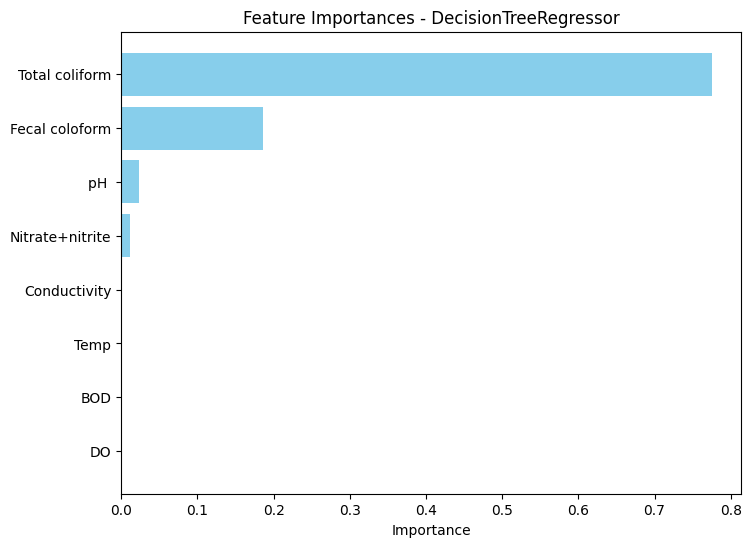

The following metrics are for the model with the best features:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 0.08735294117647058
> Mean Squared Error (MSE): 0.04140882352941176
> Root Mean Squared Error (RMSE): 0.20349158097919373
> R2 Score: 0.9598196827198178
> Cross Validation Score (CV): 0.8846730433624186
> Cross Validation Score - neg_mean_absolute_error: 0.17370588235294118
The tree without a max depth:


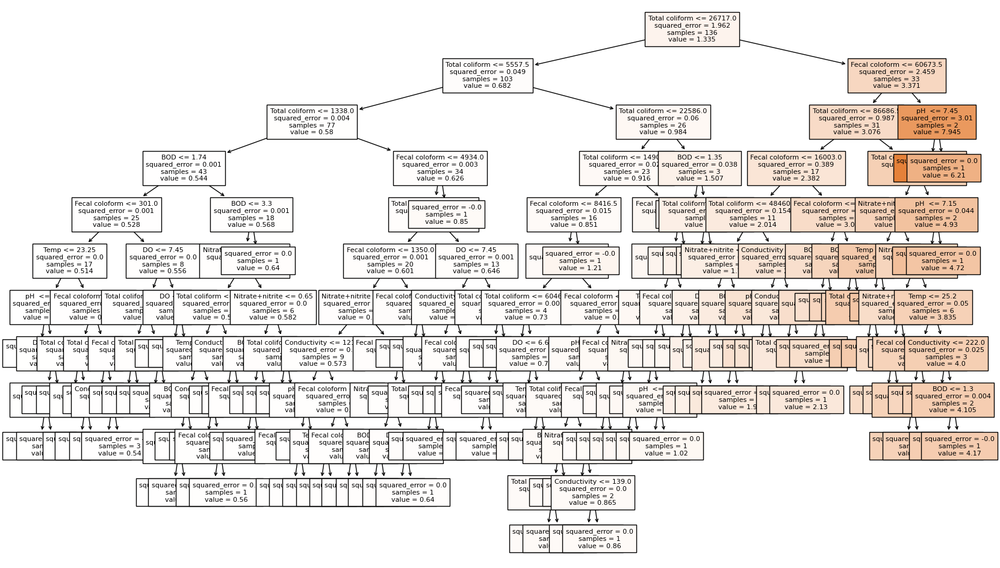

The tree with the best features:


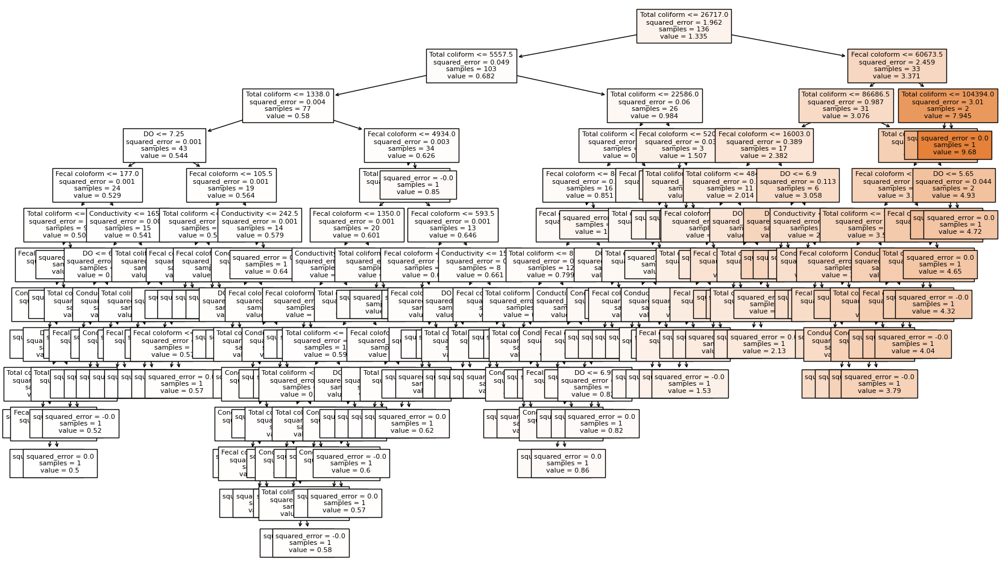

The tree with a max depth:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 0.14625077561327557
> Mean Squared Error (MSE): 0.08565064030860316
> Root Mean Squared Error (RMSE): 0.2926613064766218
> R2 Score: 0.9168904206996841
> Cross Validation Score (CV): 0.8375380158832539
> Cross Validation Score - neg_mean_absolute_error: 0.223932682778392


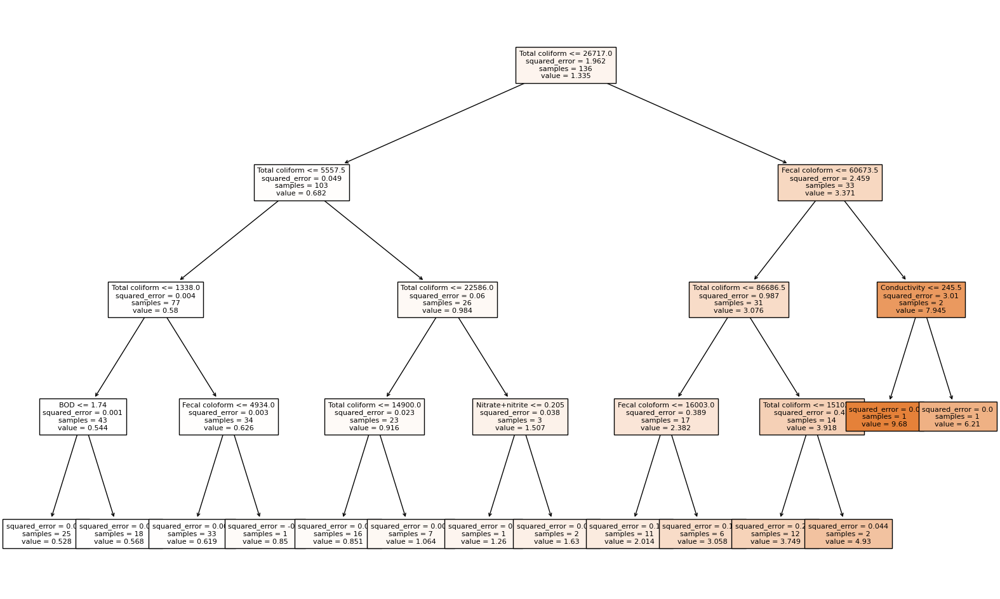

Training RandomForestRegressor model with all features
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 0.09268823529411757
> Mean Squared Error (MSE): 0.03603650058823523
> Root Mean Squared Error (RMSE): 0.1898328227368366
> R2 Score: 0.9650326209757127
> Cross Validation Score (CV): 0.8560675972137897
> Cross Validation Score - neg_mean_absolute_error: 0.1795817647058821
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestRegressor: ['Total coliform', 'Fecal coloform', 'BOD', 'Temp']
Selected features from Sequential Feature Selector for RandomForestRegressor: ['Total coliform', 'Fecal coloform', 'BOD', 'Temp', 'DO', 'Conductivity', 'pH ', 'Nitrate+nitrite']
--------------------------------------------------
RandomForestRegressor Feature Importances:
           Feature  Importance
7   Total coliform    0.805411
6   Fecal coloform    0.149034
0             Temp    0.017990
2     Conductivity    0.008098

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestRegressor Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.852607
6   Fecal coloform    0.100480
0             Temp    0.016110
2     Conductivity    0.011118
3               DO    0.005663
1              pH     0.005236
4              BOD    0.004812
5  Nitrate+nitrite    0.003974


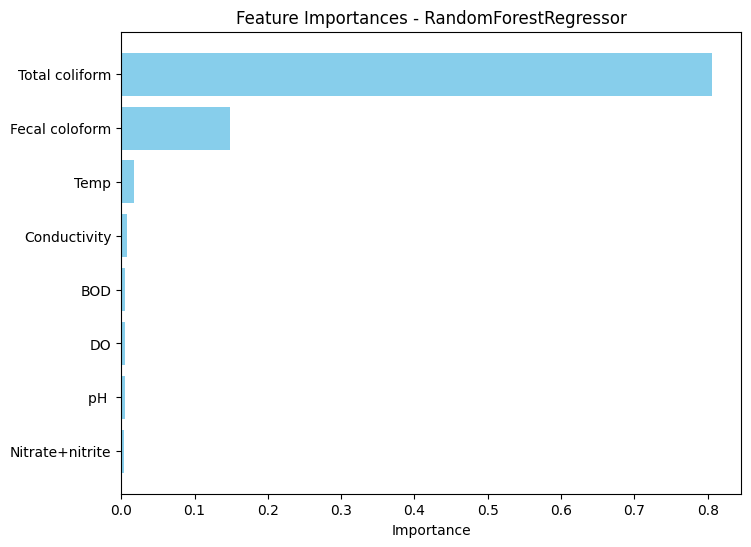

The following metrics are for the model with the best features:
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 0.08002352941176467
> Mean Squared Error (MSE): 0.02808287352941171
> Root Mean Squared Error (RMSE): 0.1675794543773541
> R2 Score: 0.972750281887397
> Cross Validation Score (CV): 0.8754207553896345
> Cross Validation Score - neg_mean_absolute_error: 0.1666005882352941
Training GradientBoostingRegressor model with all features
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 0.055379782313813464
> Mean Squared Error (MSE): 0.009290913167357867
> Root Mean Squared Error (RMSE): 0.09638938306347783
> R2 Score: 0.9909847272376162
> Cross Validation Score (CV): 0.920446052767909
> Cross Validation Score - neg_mean_absolute_error: 0.11860389964595552
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingRegressor: ['Fecal coloform', 'Total coliform', 'pH ', 'DO']
Selected features f

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingRegressor Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.822468
6   Fecal coloform    0.151430
0             Temp    0.008098
2     Conductivity    0.005407
3               DO    0.004705
4              BOD    0.003384
1              pH     0.002848
5  Nitrate+nitrite    0.001660


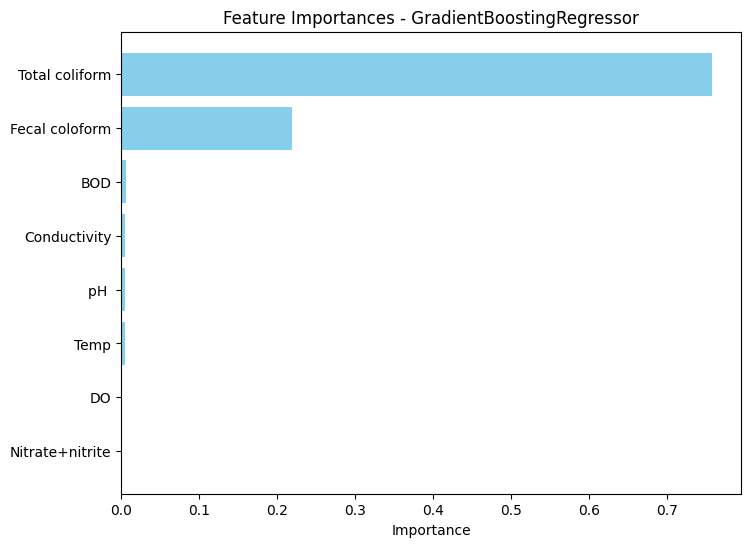

The following metrics are for the model with the best features:
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 0.049394126062833
> Mean Squared Error (MSE): 0.0069016788159620805
> Root Mean Squared Error (RMSE): 0.08307634329917321
> R2 Score: 0.9933030784032224
> Cross Validation Score (CV): 0.9281956373525262
> Cross Validation Score - neg_mean_absolute_error: 0.1089743835093265
Training LinearRegression model with all features
Model: LinearRegression
> Mean Absolute Error (MAE): 0.002491015986489867
> Mean Squared Error (MSE): 8.412437389560516e-06
> Root Mean Squared Error (RMSE): 0.00290042020913531
> R2 Score: 0.9999918371406236
> Cross Validation Score (CV): 0.999993362766002
> Cross Validation Score - neg_mean_absolute_error: 0.002675682913439658
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for LinearRegression: ['Total coliform', 'Fecal coloform', 'BOD', 'DO']
Selected features from Sequential Feat

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


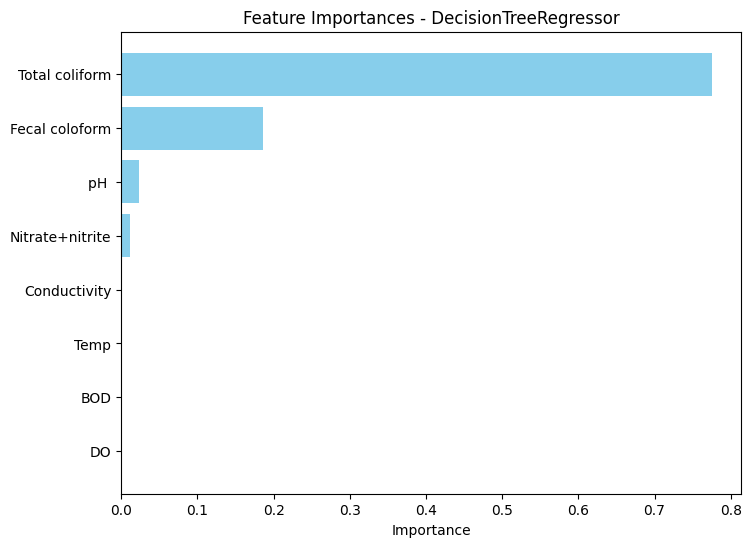

The following metrics are for the model with the best features:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 0.05676470588235294
> Mean Squared Error (MSE): 0.008332352941176471
> Root Mean Squared Error (RMSE): 0.0912817229305871
> R2 Score: 0.991914849147329
> Cross Validation Score (CV): 0.8192778191385406
> Cross Validation Score - neg_mean_absolute_error: 0.20670588235294113
The tree without a max depth:


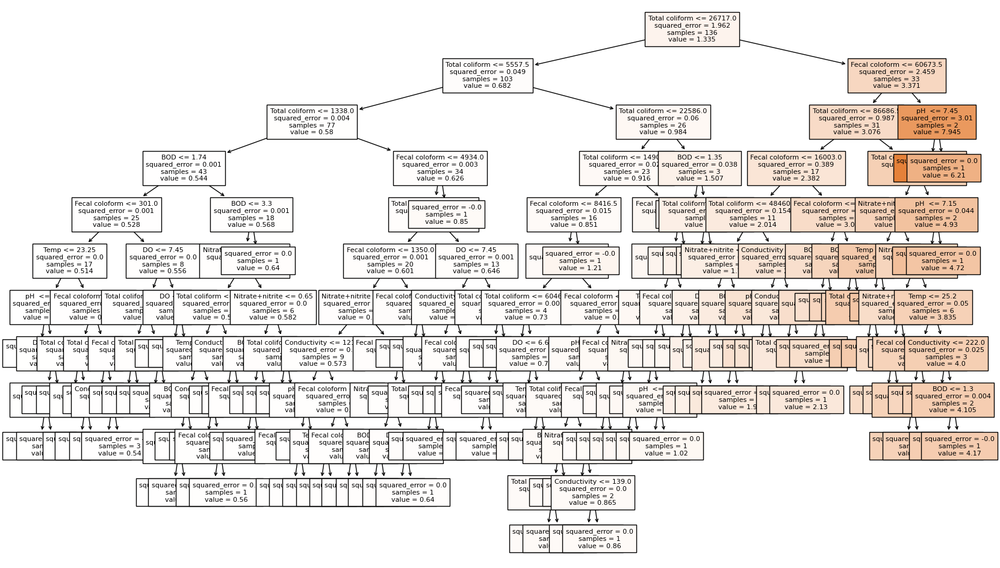

The tree with the best features:


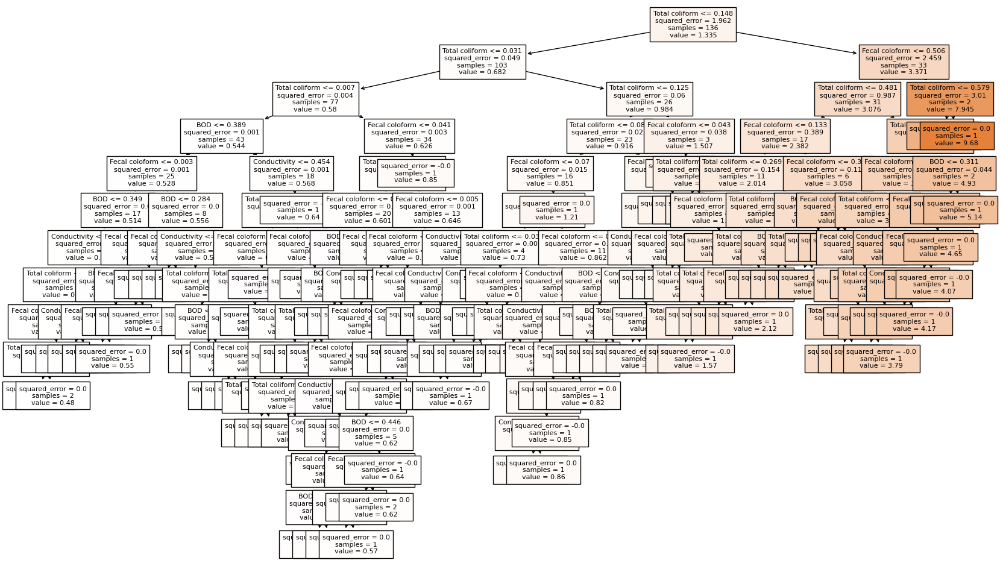

The tree with a max depth:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 0.14625077561327557
> Mean Squared Error (MSE): 0.08565064030860316
> Root Mean Squared Error (RMSE): 0.2926613064766218
> R2 Score: 0.9168904206996841
> Cross Validation Score (CV): 0.8375380158832539
> Cross Validation Score - neg_mean_absolute_error: 0.223932682778392


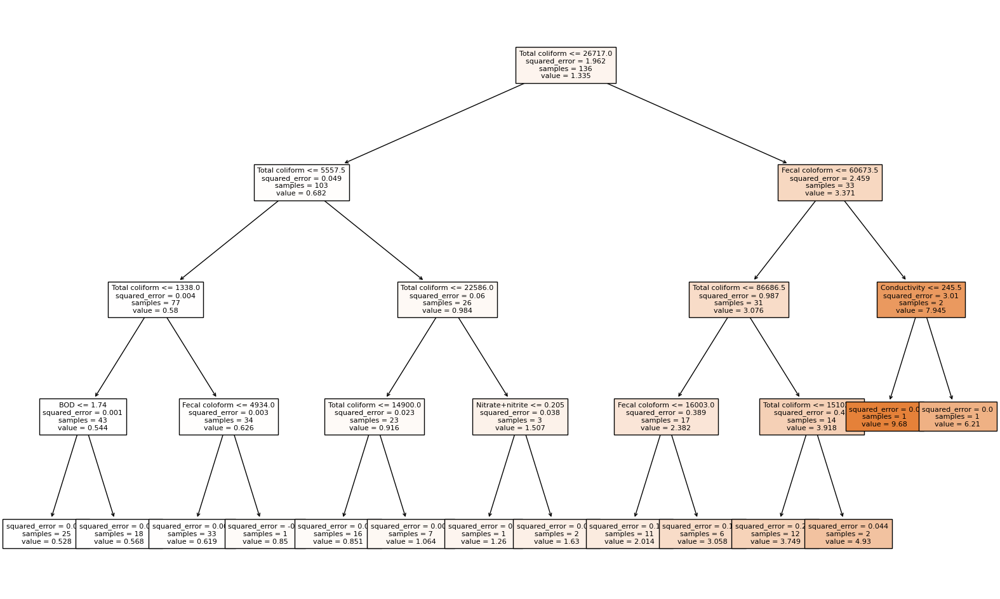

Training RandomForestRegressor model with all features
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 0.09268823529411757
> Mean Squared Error (MSE): 0.03603650058823523
> Root Mean Squared Error (RMSE): 0.1898328227368366
> R2 Score: 0.9650326209757127
> Cross Validation Score (CV): 0.8560675972137897
> Cross Validation Score - neg_mean_absolute_error: 0.1795817647058821
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestRegressor: ['Total coliform', 'Fecal coloform', 'BOD', 'pH ']
Selected features from Sequential Feature Selector for RandomForestRegressor: ['Total coliform', 'Fecal coloform', 'BOD', 'pH ', 'Temp', 'Nitrate+nitrite', 'DO', 'Conductivity']
--------------------------------------------------
RandomForestRegressor Feature Importances:
           Feature  Importance
7   Total coliform    0.805411
6   Fecal coloform    0.149034
0             Temp    0.017990
2     Conductivity    0.008098


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestRegressor Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.852607
6   Fecal coloform    0.100480
0             Temp    0.016110
2     Conductivity    0.011118
3               DO    0.005663
1              pH     0.005236
4              BOD    0.004812
5  Nitrate+nitrite    0.003974


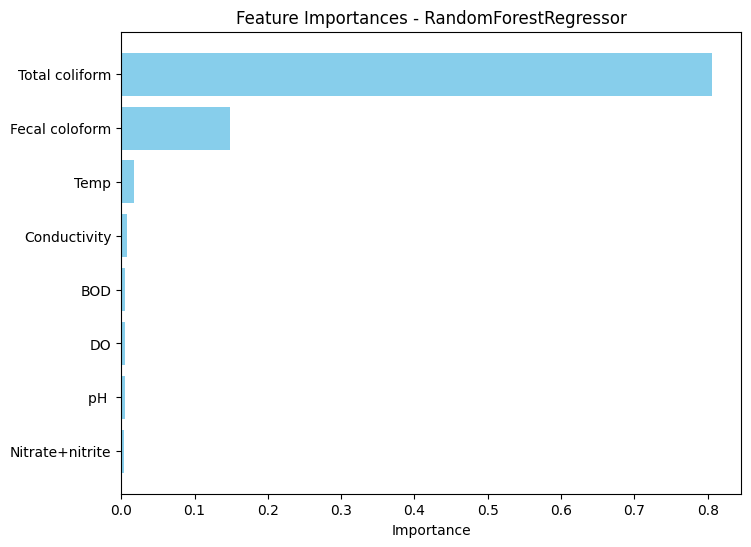

The following metrics are for the model with the best features:
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 0.07856764705882349
> Mean Squared Error (MSE): 0.026886113823529293
> Root Mean Squared Error (RMSE): 0.1639698564478523
> R2 Score: 0.9739115364363542
> Cross Validation Score (CV): 0.8663523449087904
> Cross Validation Score - neg_mean_absolute_error: 0.16967411764705867
Training GradientBoostingRegressor model with all features
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 0.055379782313813464
> Mean Squared Error (MSE): 0.009290913167357867
> Root Mean Squared Error (RMSE): 0.09638938306347783
> R2 Score: 0.9909847272376162
> Cross Validation Score (CV): 0.920446052767909
> Cross Validation Score - neg_mean_absolute_error: 0.11860389964595552
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingRegressor: ['Fecal coloform', 'Total coliform', 'pH ', 'DO']
Selected feature

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingRegressor Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.822468
6   Fecal coloform    0.151430
0             Temp    0.008098
2     Conductivity    0.005407
3               DO    0.004705
4              BOD    0.003384
1              pH     0.002848
5  Nitrate+nitrite    0.001660


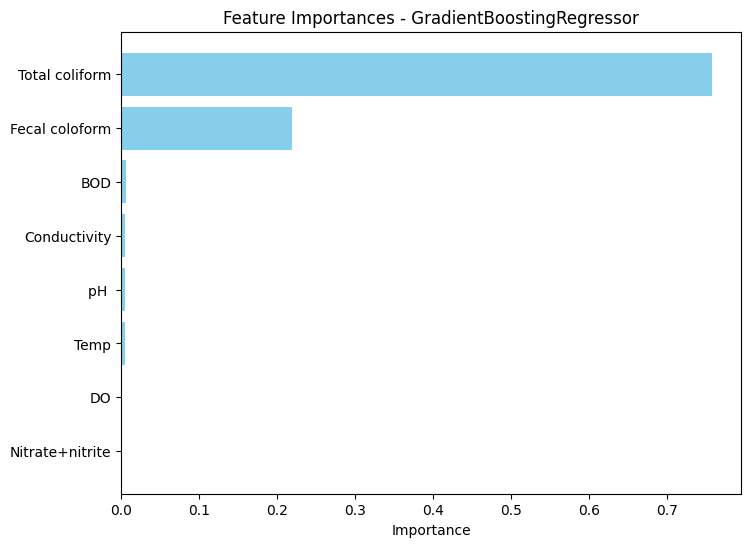

The following metrics are for the model with the best features:
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 0.049394126062833
> Mean Squared Error (MSE): 0.0069016788159620805
> Root Mean Squared Error (RMSE): 0.08307634329917321
> R2 Score: 0.9933030784032224
> Cross Validation Score (CV): 0.9285200820537014
> Cross Validation Score - neg_mean_absolute_error: 0.10796916286068958
Training LinearRegression model with all features
Model: LinearRegression
> Mean Absolute Error (MAE): 0.002491015986489867
> Mean Squared Error (MSE): 8.412437389560516e-06
> Root Mean Squared Error (RMSE): 0.00290042020913531
> R2 Score: 0.9999918371406236
> Cross Validation Score (CV): 0.999993362766002
> Cross Validation Score - neg_mean_absolute_error: 0.002675682913439658
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for LinearRegression: ['Total coliform', 'Fecal coloform', 'BOD', 'DO']
Selected features from Sequential Fea

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


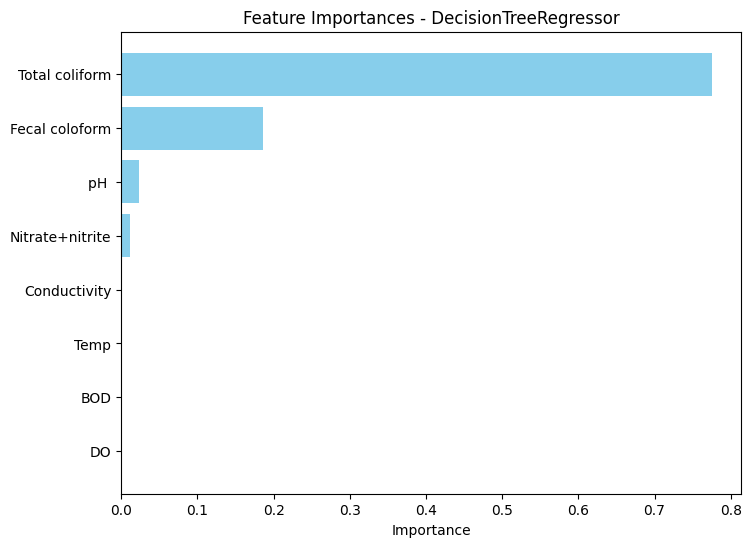

The following metrics are for the model with the best features:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 0.06176470588235293
> Mean Squared Error (MSE): 0.008129411764705885
> Root Mean Squared Error (RMSE): 0.09016325063298175
> R2 Score: 0.9921117695175493
> Cross Validation Score (CV): 0.8690313286794991
> Cross Validation Score - neg_mean_absolute_error: 0.19064705882352945
The tree without a max depth:


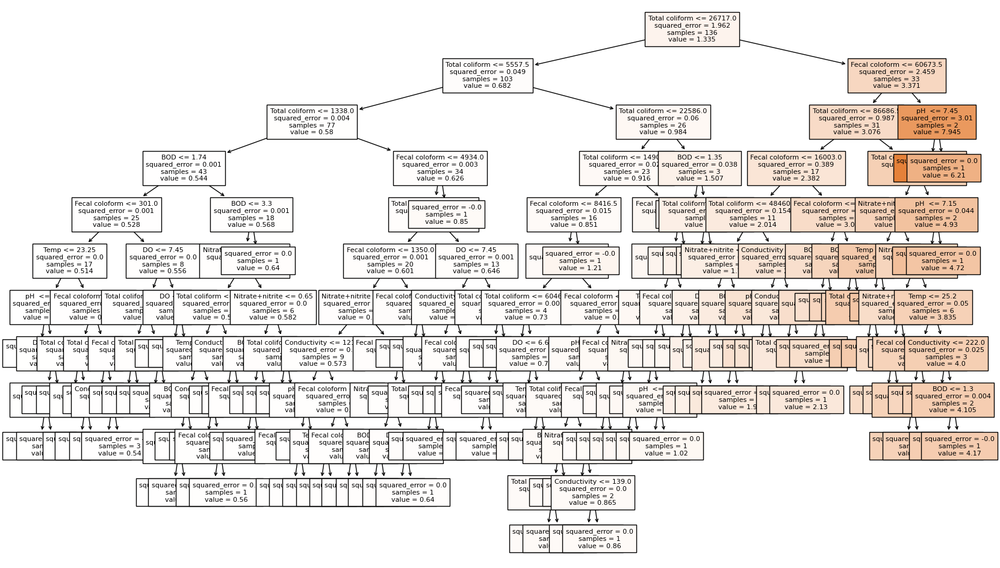

The tree with the best features:


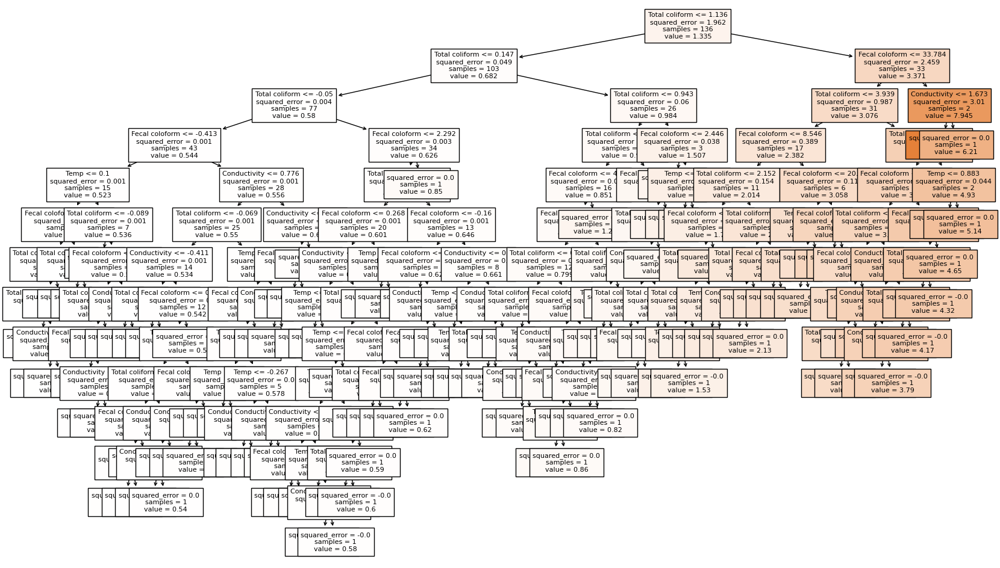

The tree with a max depth:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 0.14625077561327557
> Mean Squared Error (MSE): 0.08565064030860316
> Root Mean Squared Error (RMSE): 0.2926613064766218
> R2 Score: 0.9168904206996841
> Cross Validation Score (CV): 0.8375380158832539
> Cross Validation Score - neg_mean_absolute_error: 0.223932682778392


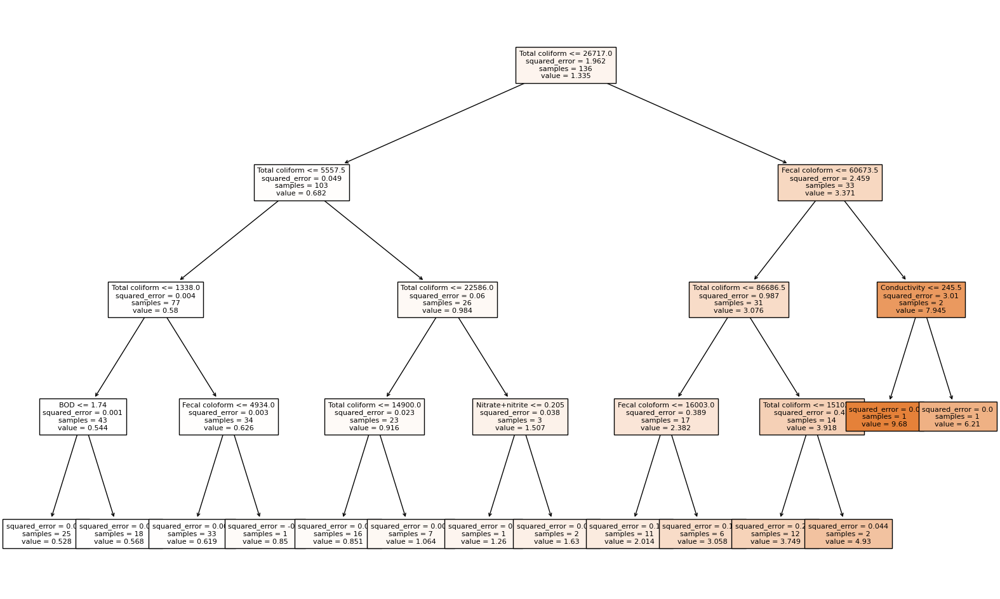

Training RandomForestRegressor model with all features
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 0.09268823529411757
> Mean Squared Error (MSE): 0.03603650058823523
> Root Mean Squared Error (RMSE): 0.1898328227368366
> R2 Score: 0.9650326209757127
> Cross Validation Score (CV): 0.8560675972137897
> Cross Validation Score - neg_mean_absolute_error: 0.1795817647058821
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestRegressor: ['Total coliform', 'Fecal coloform', 'BOD', 'Temp']
Selected features from Sequential Feature Selector for RandomForestRegressor: ['Total coliform', 'Fecal coloform', 'BOD', 'Temp', 'DO', 'Nitrate+nitrite', 'pH ', 'Conductivity']
--------------------------------------------------
RandomForestRegressor Feature Importances:
           Feature  Importance
7   Total coliform    0.805411
6   Fecal coloform    0.149034
0             Temp    0.017990
2     Conductivity    0.008098

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestRegressor Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.852607
6   Fecal coloform    0.100480
0             Temp    0.016110
2     Conductivity    0.011118
3               DO    0.005663
1              pH     0.005236
4              BOD    0.004812
5  Nitrate+nitrite    0.003974


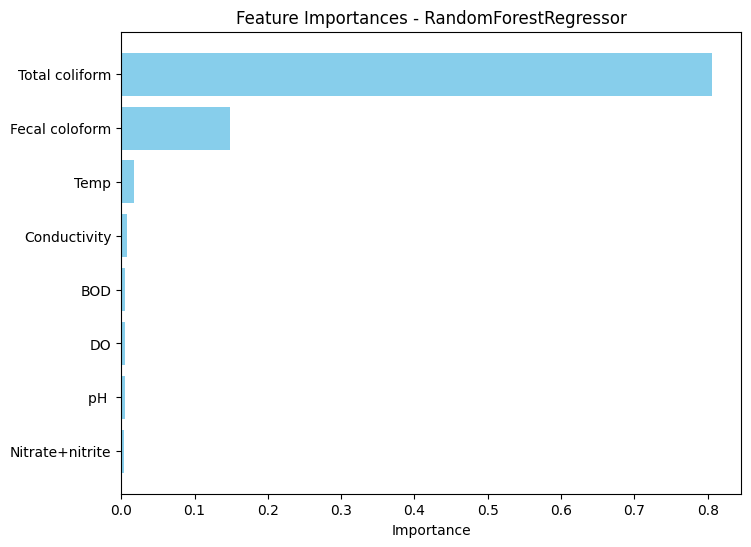

The following metrics are for the model with the best features:
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 0.07986176470588231
> Mean Squared Error (MSE): 0.028061322058823474
> Root Mean Squared Error (RMSE): 0.1675151397898813
> R2 Score: 0.9727711939745389
> Cross Validation Score (CV): 0.8757901083038682
> Cross Validation Score - neg_mean_absolute_error: 0.1657317647058823
Training GradientBoostingRegressor model with all features
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 0.055379782313813464
> Mean Squared Error (MSE): 0.009290913167357867
> Root Mean Squared Error (RMSE): 0.09638938306347783
> R2 Score: 0.9909847272376162
> Cross Validation Score (CV): 0.920446052767909
> Cross Validation Score - neg_mean_absolute_error: 0.11860389964595552
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingRegressor: ['Fecal coloform', 'Total coliform', 'pH ', 'DO']
Selected features

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingRegressor Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.822468
6   Fecal coloform    0.151430
0             Temp    0.008098
2     Conductivity    0.005407
3               DO    0.004705
4              BOD    0.003384
1              pH     0.002848
5  Nitrate+nitrite    0.001660


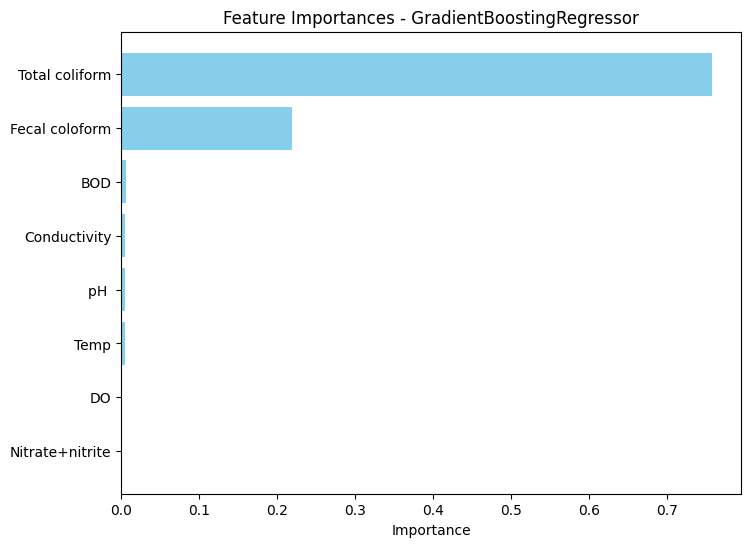

The following metrics are for the model with the best features:
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 0.049394126062833
> Mean Squared Error (MSE): 0.0069016788159620805
> Root Mean Squared Error (RMSE): 0.08307634329917321
> R2 Score: 0.9933030784032224
> Cross Validation Score (CV): 0.9281758836692156
> Cross Validation Score - neg_mean_absolute_error: 0.10894144385867495
Training LinearRegression model with all features
Model: LinearRegression
> Mean Absolute Error (MAE): 0.002491015986489867
> Mean Squared Error (MSE): 8.412437389560516e-06
> Root Mean Squared Error (RMSE): 0.00290042020913531
> R2 Score: 0.9999918371406236
> Cross Validation Score (CV): 0.999993362766002
> Cross Validation Score - neg_mean_absolute_error: 0.002675682913439658
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for LinearRegression: ['Total coliform', 'Fecal coloform', 'BOD', 'DO']
Selected features from Sequential Fea

In [16]:
CPIRegression = Model(cpi_classic_regression, 'CPI', 60, False, 5, False)

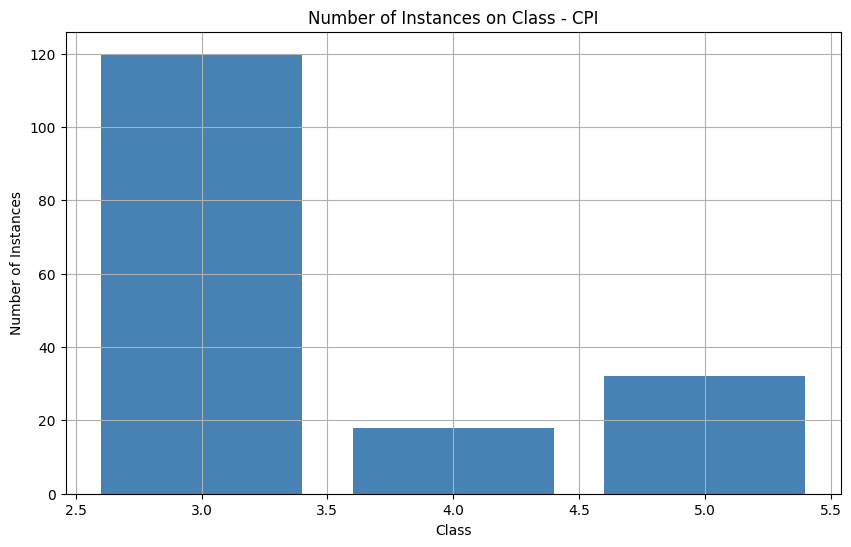

======================= Before balance without scale =======================
Training DecisionTreeClassifier model with all features
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'Temp']
Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'Temp', 'pH ', 'BOD', 'Conductivity', 'Nitrate+nitrite']
--------------------------------------------------
DecisionTreeClassifier Feature Importances:
           Feature  Importance
7   Total coliform    0.873141
6   Fecal coloform    0.095853
2     Conductivity    0.031007
0             Temp    0.000000
1              pH     0.000000
3               DO    0.000000
4              BOD    0.000000
5  Nitrate+nit

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


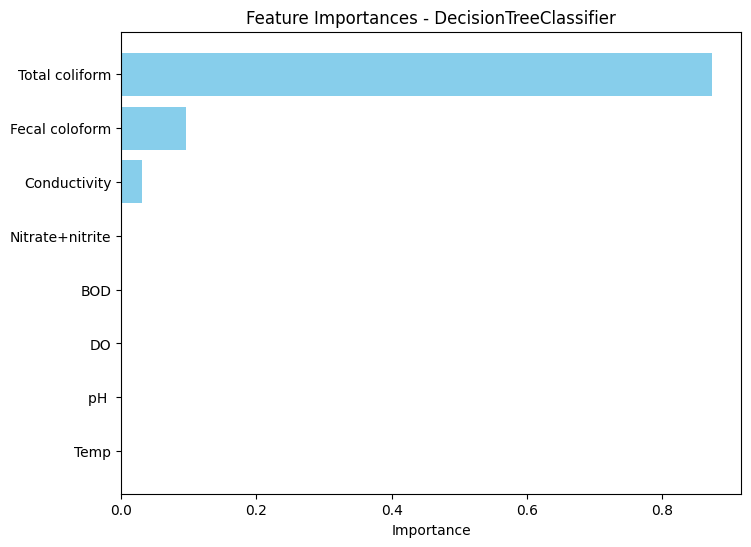

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9411764705882353
The tree without a max depth:


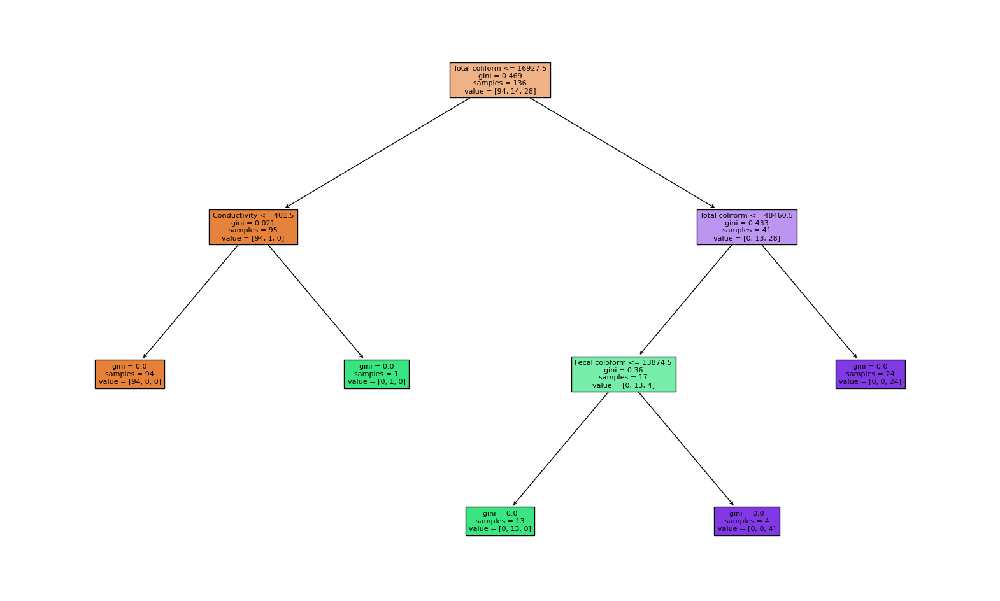

The tree with the best features:


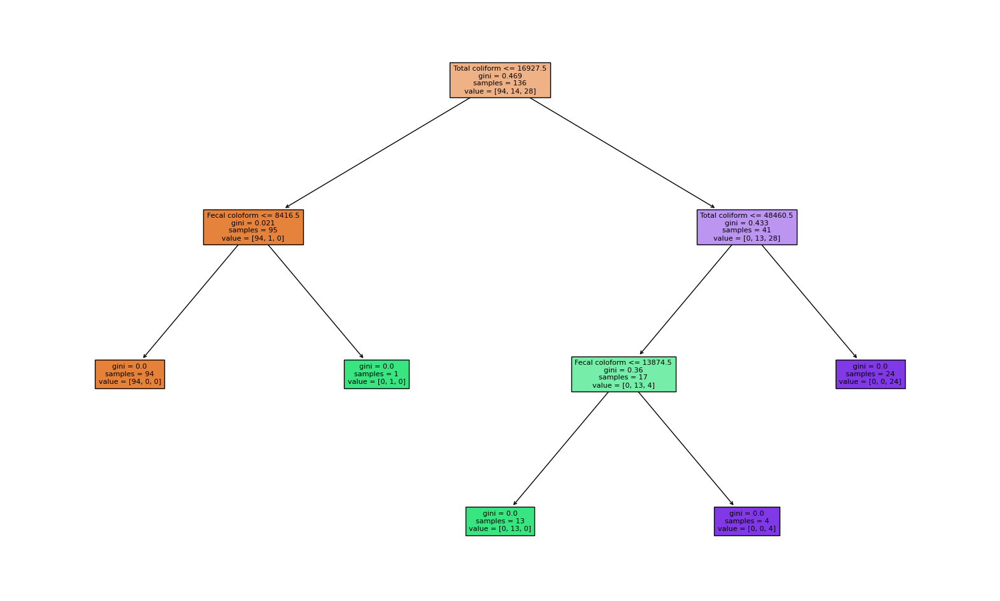

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117


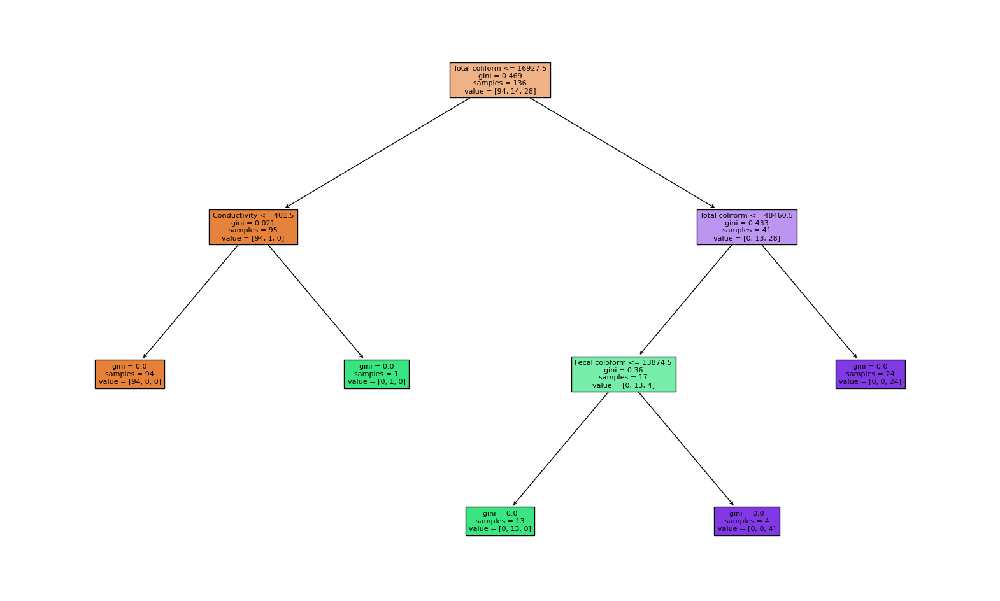

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.9705882352941176
> Precision: 0.9333333333333332
> Recall: 0.9166666666666666
> F1 Score: 0.9153439153439153
> Cross Validation Score (CV): 0.9411764705882353
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'BOD', 'Temp']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'BOD', 'Temp', 'pH ', 'Nitrate+nitrite', 'DO', 'Conductivity']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
7   Total coliform    0.478651
6   Fecal coloform    0.189338
0             Temp    0.060922
2     Conductivity    0.060414
4              BOD    0.057839
5  Nitrate+nitrite    0.052992
1              pH     0.050964
3               DO    0.048881

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.443317
6   Fecal coloform    0.232839
2     Conductivity    0.068218
4              BOD    0.055021
1              pH     0.053880
5  Nitrate+nitrite    0.050797
0             Temp    0.048390
3               DO    0.047540


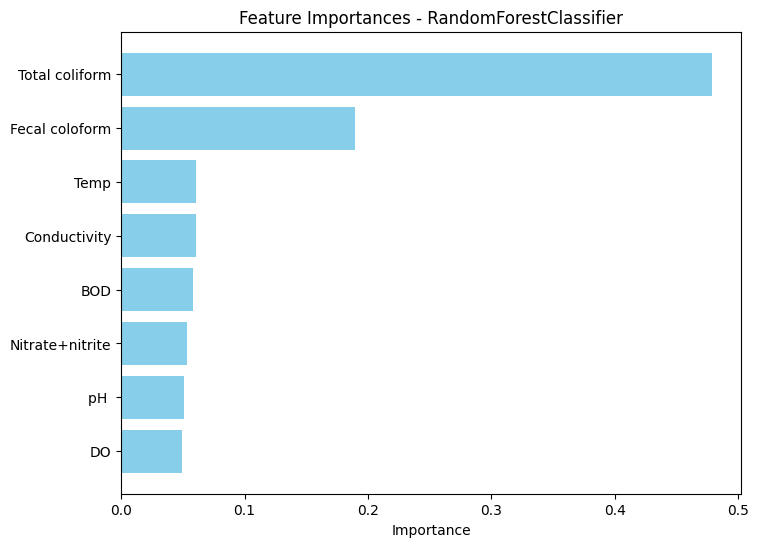

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9647058823529411
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'Temp']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'Temp', 'pH ', 'Conductivity', 'BOD', 'Nitrate+nitrite']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature    Importance
7   Total coliform  8.545001e-01
6   Fecal coloform  1.310062e-01
2     Conduct

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.895385
6   Fecal coloform    0.071776
2     Conductivity    0.013599
0             Temp    0.010559
3               DO    0.005285
5  Nitrate+nitrite    0.002206
4              BOD    0.001120
1              pH     0.000070


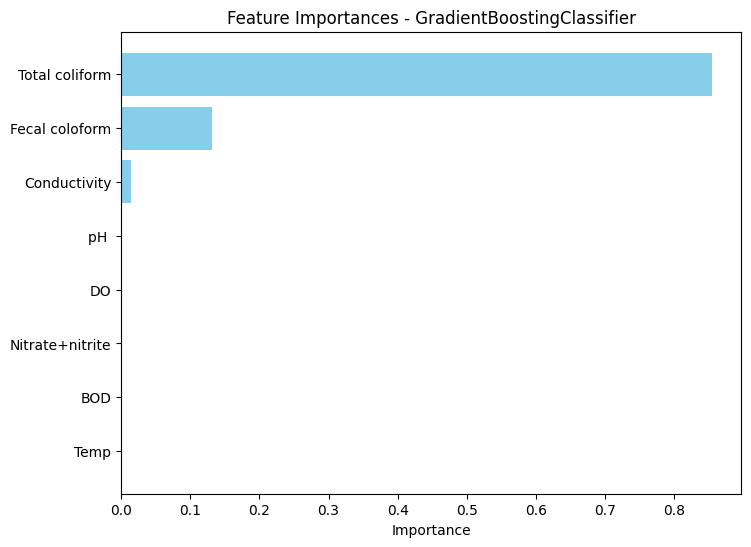

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
Training SVC model with all features
Model: SVC
> Accuracy: 0.9705882352941176
> Precision: 0.9876543209876543
> Recall: 0.9166666666666666
> F1 Score: 0.9460916442048517
> Cross Validation Score (CV): 0.9823529411764707
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ']
Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ', 'Conductivity', 'DO', 'BOD', 'Nitrate+nitrite']
--------------------------------------------------
           Feature  Importance_x  Importance_y    Importance
0             Temp      0.000000      0.060922  0.000000e+00
1              pH       0.000000      0.050964  1.709529e-16
2   

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


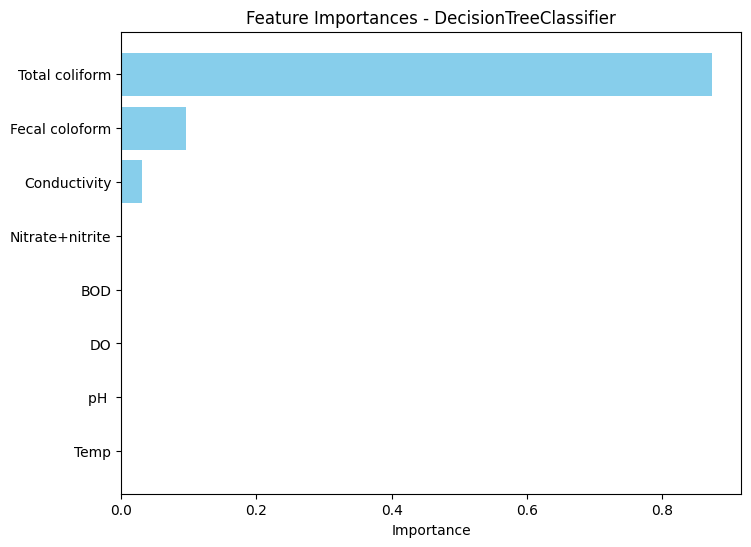

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9411764705882353
The tree without a max depth:


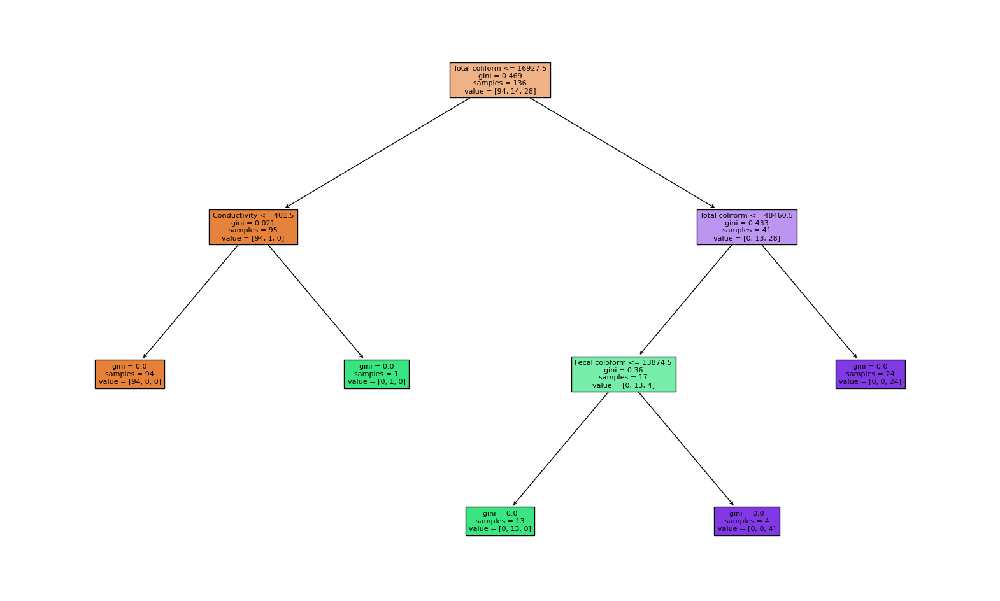

The tree with the best features:


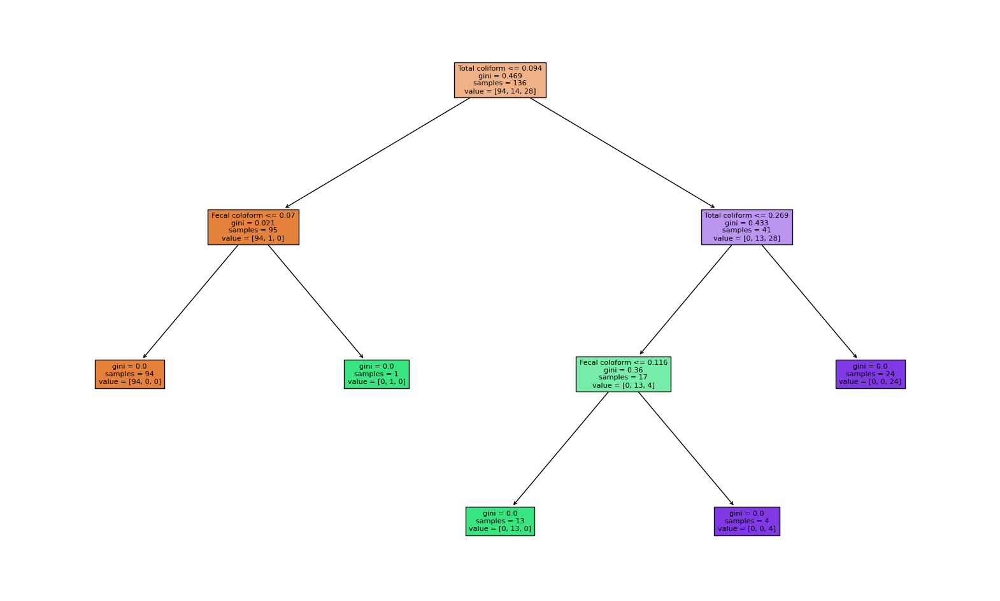

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117


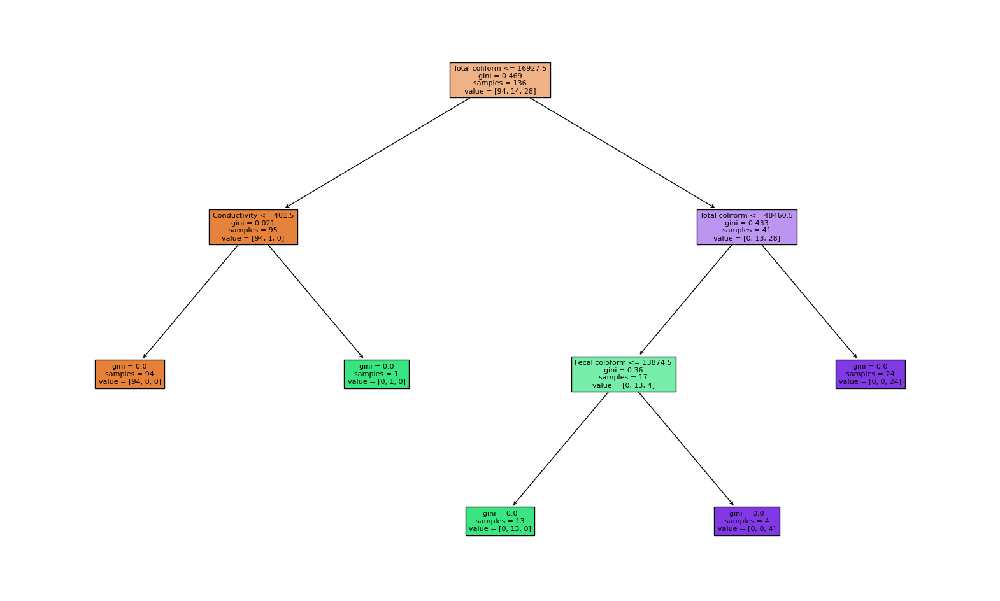

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.9705882352941176
> Precision: 0.9333333333333332
> Recall: 0.9166666666666666
> F1 Score: 0.9153439153439153
> Cross Validation Score (CV): 0.9411764705882353
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'BOD']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'BOD', 'Temp', 'Nitrate+nitrite', 'pH ', 'Conductivity']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
7   Total coliform    0.478651
6   Fecal coloform    0.189338
0             Temp    0.060922
2     Conductivity    0.060414
4              BOD    0.057839
5  Nitrate+nitrite    0.052992
1              pH     0.050964
3               DO    0.048881
-

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.443317
6   Fecal coloform    0.232839
2     Conductivity    0.068218
4              BOD    0.055021
1              pH     0.053880
5  Nitrate+nitrite    0.050797
0             Temp    0.048390
3               DO    0.047540


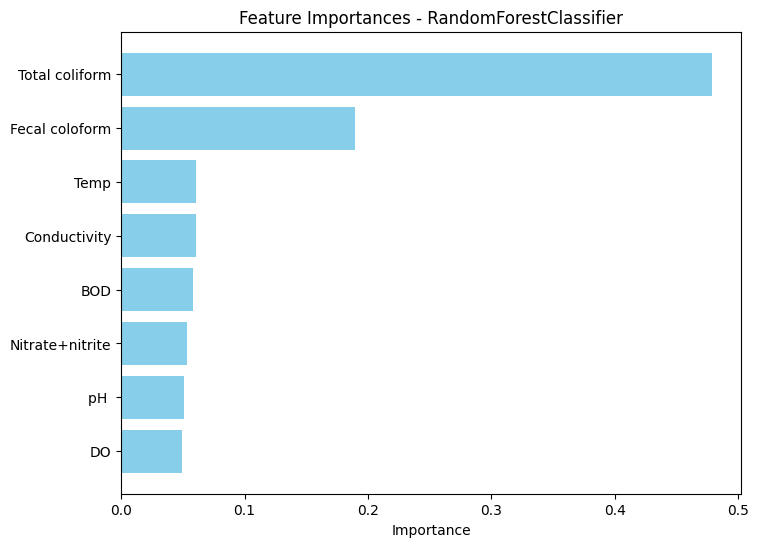

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.976470588235294
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'Temp']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'Temp', 'pH ', 'Conductivity', 'Nitrate+nitrite', 'BOD']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature    Importance
7   Total coliform  8.545001e-01
6   Fecal coloform  1.310062e-01
2     Conducti

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.895385
6   Fecal coloform    0.071776
2     Conductivity    0.013599
0             Temp    0.010559
3               DO    0.005285
5  Nitrate+nitrite    0.002206
4              BOD    0.001120
1              pH     0.000070


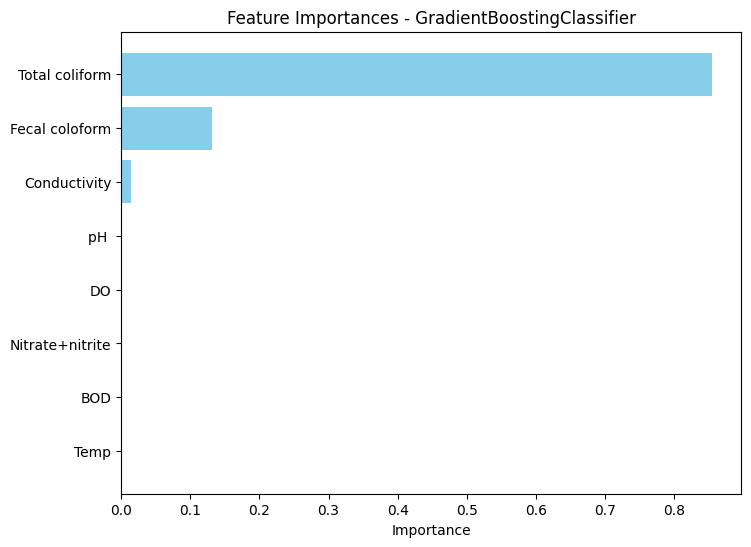

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
Training SVC model with all features
Model: SVC
> Accuracy: 0.9705882352941176
> Precision: 0.9876543209876543
> Recall: 0.9166666666666666
> F1 Score: 0.9460916442048517
> Cross Validation Score (CV): 0.9823529411764707
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'BOD', 'Conductivity']
Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'BOD', 'Conductivity', 'Temp', 'pH ', 'Nitrate+nitrite', 'DO']
--------------------------------------------------
           Feature  Importance_x  Importance_y    Importance
0             Temp      0.000000      0.060922  0.000000e+00
1              pH       0.000000      0.050964  1.709529e

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


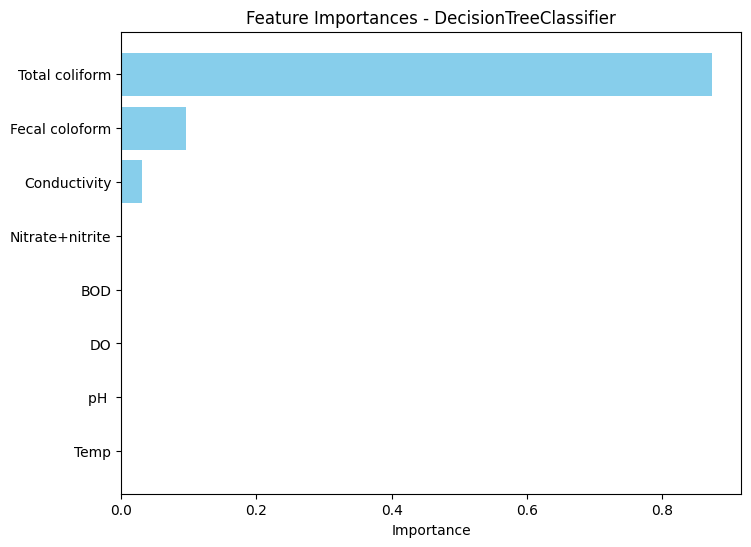

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9352941176470588
The tree without a max depth:


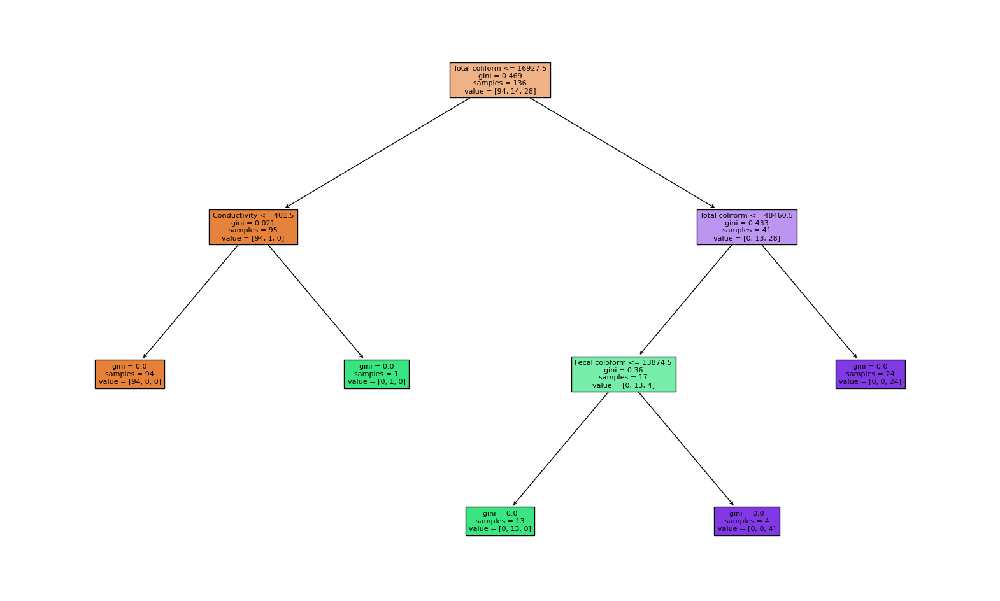

The tree with the best features:


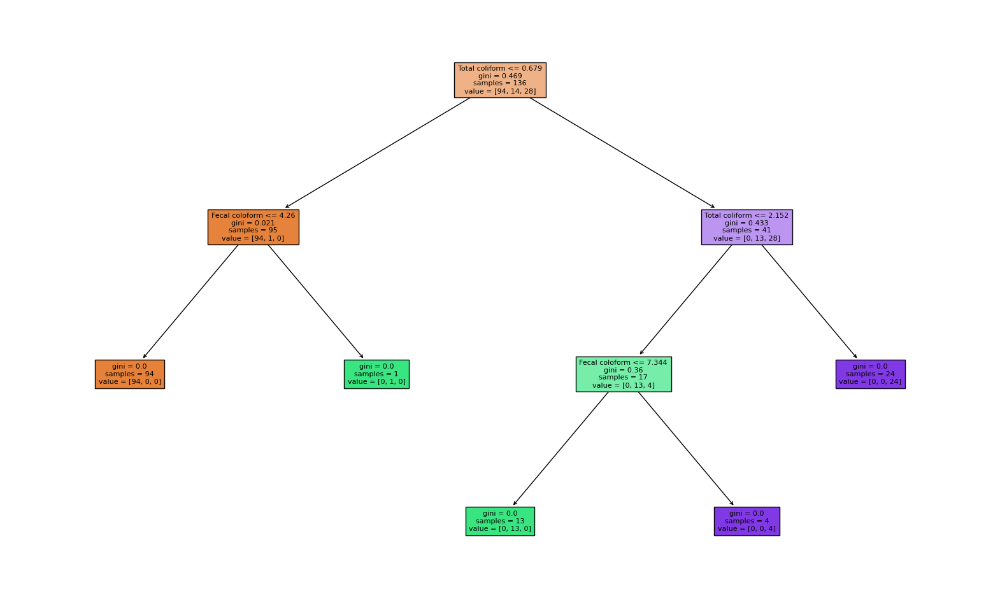

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117


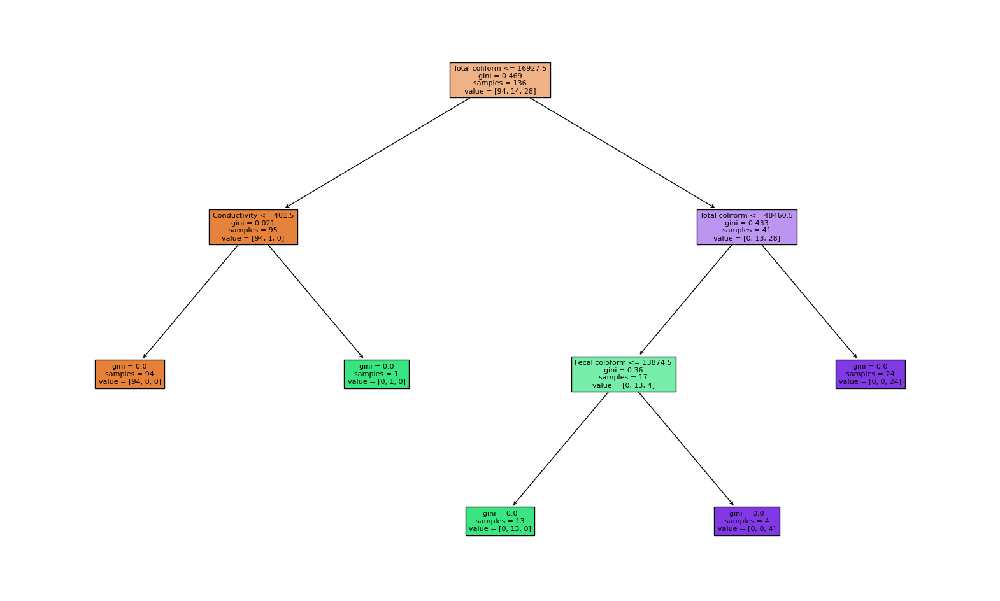

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.9705882352941176
> Precision: 0.9333333333333332
> Recall: 0.9166666666666666
> F1 Score: 0.9153439153439153
> Cross Validation Score (CV): 0.9411764705882353
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'DO', 'Temp']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'DO', 'Temp', 'BOD', 'pH ', 'Nitrate+nitrite', 'Conductivity']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
7   Total coliform    0.478651
6   Fecal coloform    0.189338
0             Temp    0.060922
2     Conductivity    0.060414
4              BOD    0.057839
5  Nitrate+nitrite    0.052992
1              pH     0.050964
3               DO    0.048881


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.443317
6   Fecal coloform    0.232839
2     Conductivity    0.068218
4              BOD    0.055021
1              pH     0.053880
5  Nitrate+nitrite    0.050797
0             Temp    0.048390
3               DO    0.047540


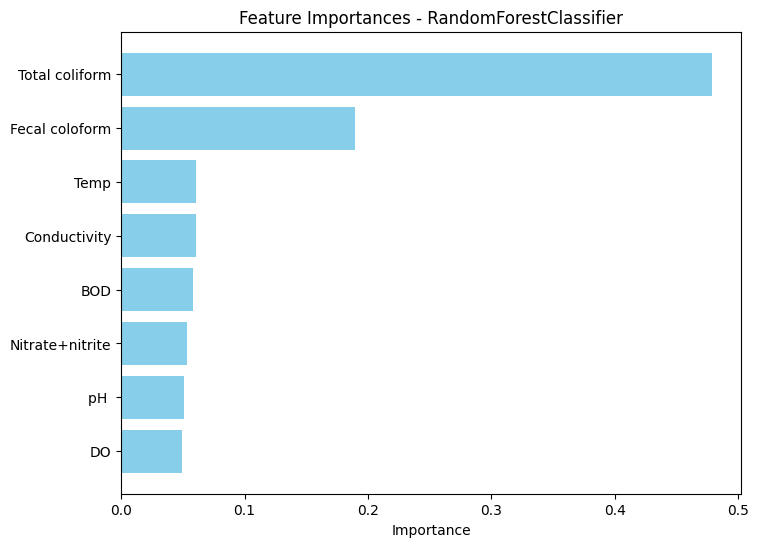

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9647058823529411
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'Temp']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'DO', 'Fecal coloform', 'Temp', 'pH ', 'Conductivity', 'BOD', 'Nitrate+nitrite']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature    Importance
7   Total coliform  8.545001e-01
6   Fecal coloform  1.310062e-01
2     Conduct

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.895385
6   Fecal coloform    0.071776
2     Conductivity    0.013599
0             Temp    0.010559
3               DO    0.005285
5  Nitrate+nitrite    0.002206
4              BOD    0.001120
1              pH     0.000070


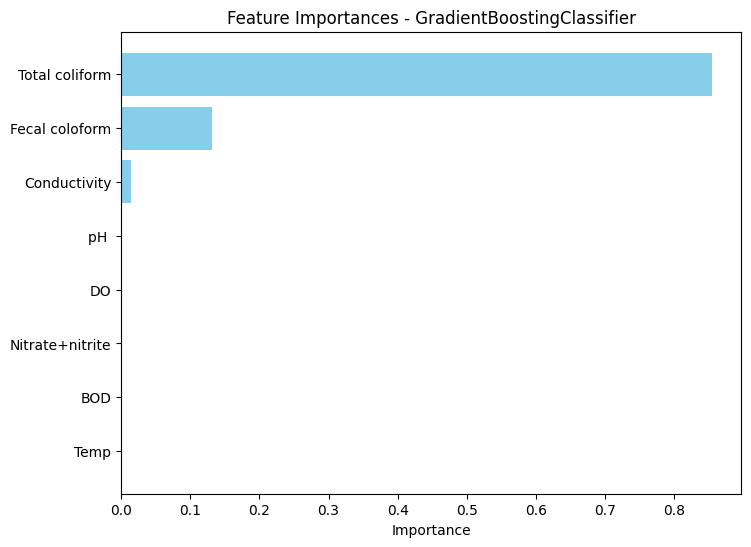

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
Training SVC model with all features
Model: SVC
> Accuracy: 0.9705882352941176
> Precision: 0.9876543209876543
> Recall: 0.9166666666666666
> F1 Score: 0.9460916442048517
> Cross Validation Score (CV): 0.9823529411764707
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'DO', 'BOD', 'Temp']
Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'DO', 'BOD', 'Temp', 'Nitrate+nitrite', 'pH ', 'Fecal coloform', 'Conductivity']
--------------------------------------------------
           Feature  Importance_x  Importance_y    Importance
0             Temp      0.000000      0.060922  0.000000e+00
1              pH       0.000000      0.050964  1.709529e-16
2     Conductivi

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


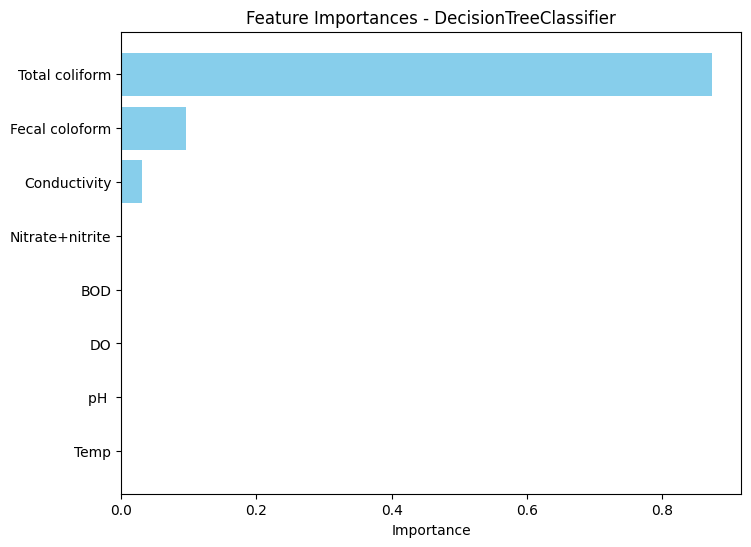

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.9444444444444444
> Precision: 0.9505494505494506
> Recall: 0.9505494505494506
> F1 Score: 0.9505494505494506
> Cross Validation Score (CV): 0.9722222222222221
The tree without a max depth:


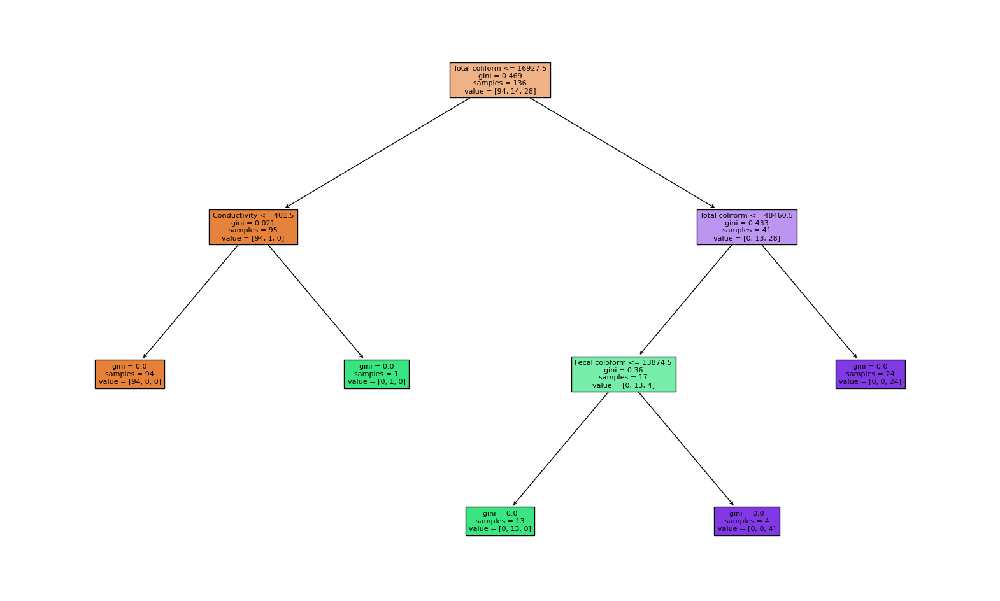

The tree with the best features:


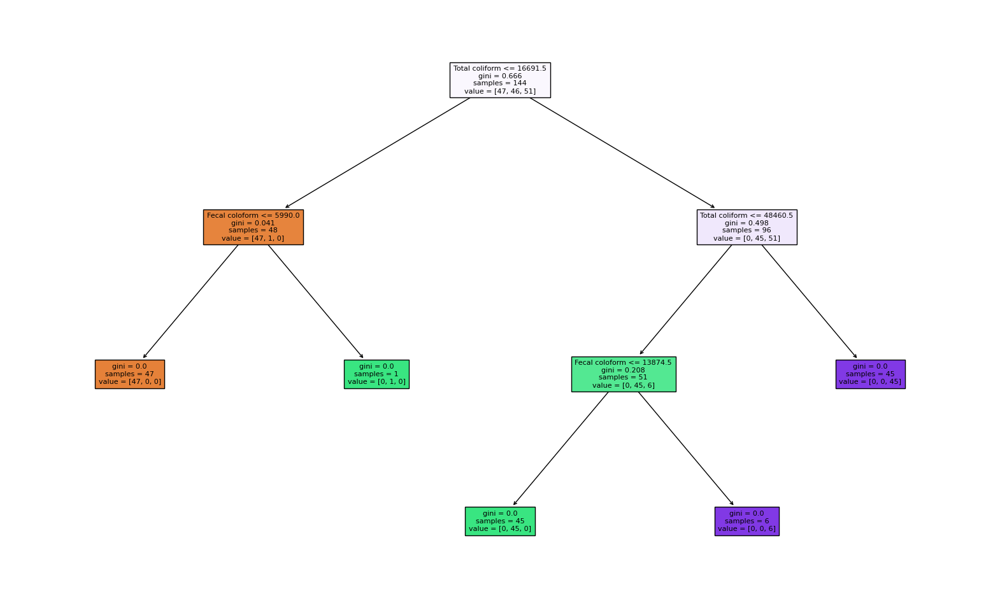

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117


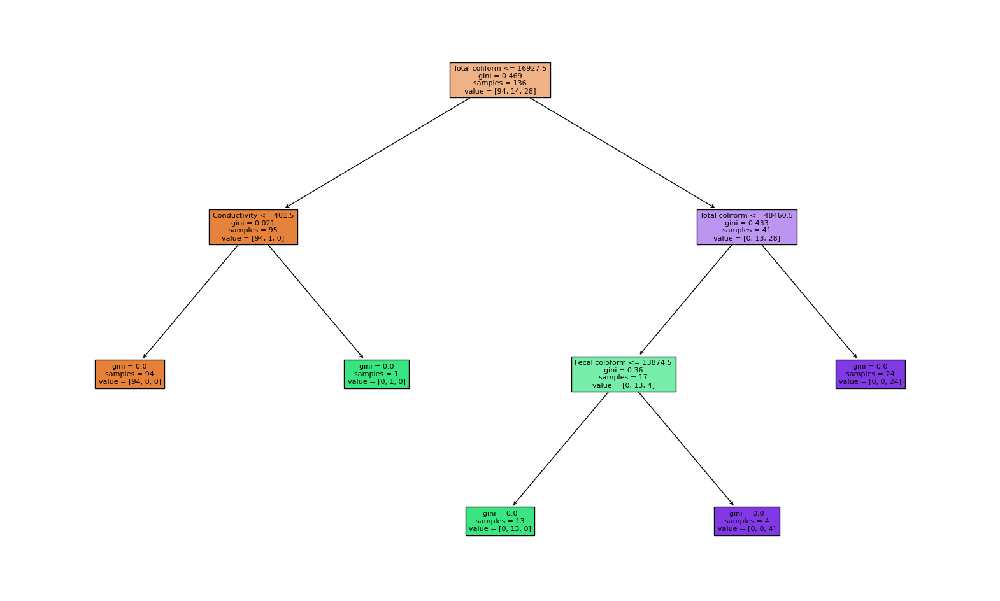

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.9705882352941176
> Precision: 0.9333333333333332
> Recall: 0.9166666666666666
> F1 Score: 0.9153439153439153
> Cross Validation Score (CV): 0.9411764705882353
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'pH ', 'Temp']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'pH ', 'Temp', 'Nitrate+nitrite', 'Conductivity', 'BOD', 'DO']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
7   Total coliform    0.478651
6   Fecal coloform    0.189338
0             Temp    0.060922
2     Conductivity    0.060414
4              BOD    0.057839
5  Nitrate+nitrite    0.052992
1              pH     0.050964
3               DO    0.048881

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.429516
6   Fecal coloform    0.217147
4              BOD    0.079844
1              pH     0.067906
0             Temp    0.054175
2     Conductivity    0.051290
3               DO    0.051285
5  Nitrate+nitrite    0.048838


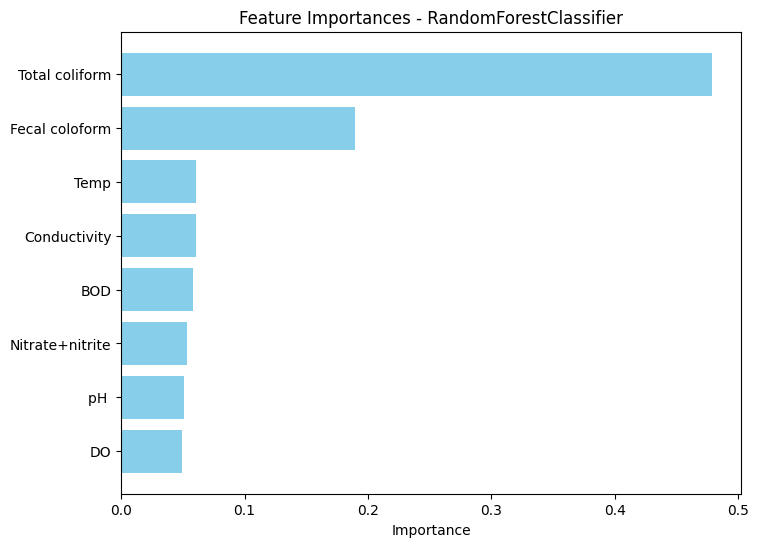

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9722222222222222
> Precision: 0.9777777777777779
> Recall: 0.9743589743589745
> F1 Score: 0.9751724137931035
> Cross Validation Score (CV): 0.9722222222222221
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ', 'Conductivity', 'DO', 'BOD', 'Nitrate+nitrite']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature    Importance
7   Total coliform

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.882393
6   Fecal coloform    0.102331
2     Conductivity    0.007131
1              pH     0.002615
3               DO    0.001887
0             Temp    0.001666
5  Nitrate+nitrite    0.001122
4              BOD    0.000857


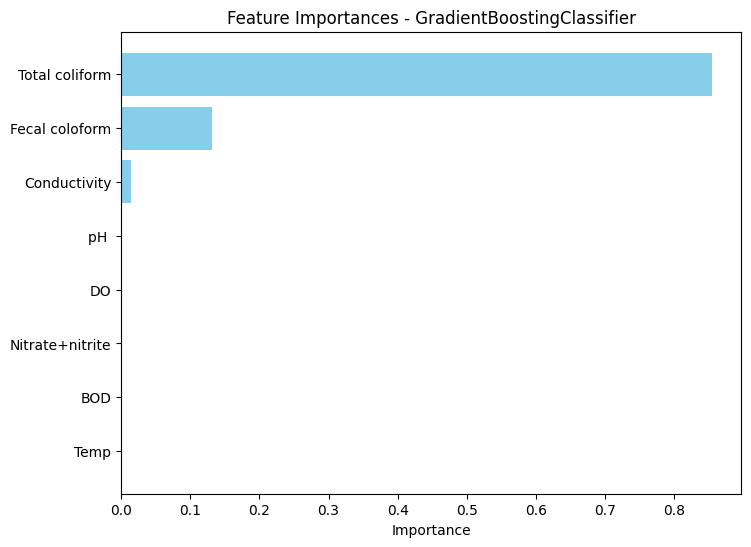

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.9444444444444444
> Precision: 0.9505494505494506
> Recall: 0.9505494505494506
> F1 Score: 0.9505494505494506
> Cross Validation Score (CV): 0.9722222222222221
Training SVC model with all features
Model: SVC
> Accuracy: 0.9705882352941176
> Precision: 0.9876543209876543
> Recall: 0.9166666666666666
> F1 Score: 0.9460916442048517
> Cross Validation Score (CV): 0.9823529411764707
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ']
Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ', 'Conductivity', 'DO', 'BOD', 'Nitrate+nitrite']
--------------------------------------------------
           Feature  Importance_x  Importance_y    Importance
0             Temp      0.000000      0.060922  0.000000e+00
1    

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


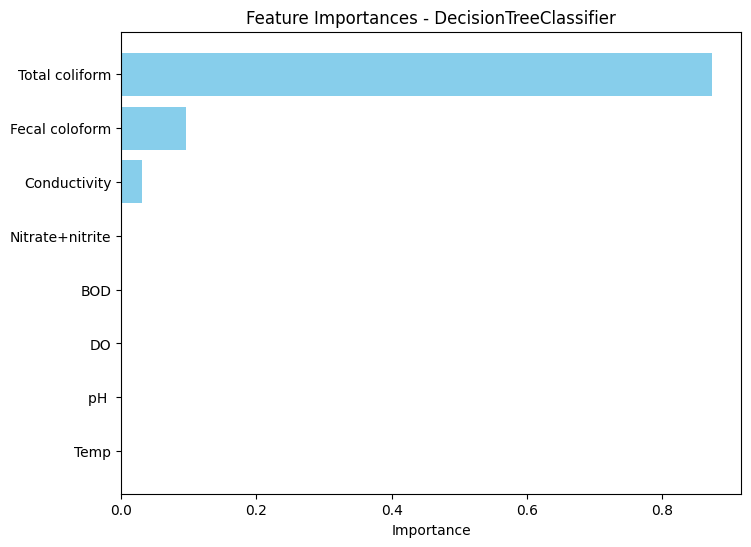

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.9444444444444444
> Precision: 0.9505494505494506
> Recall: 0.9505494505494506
> F1 Score: 0.9505494505494506
> Cross Validation Score (CV): 0.9722222222222221
The tree without a max depth:


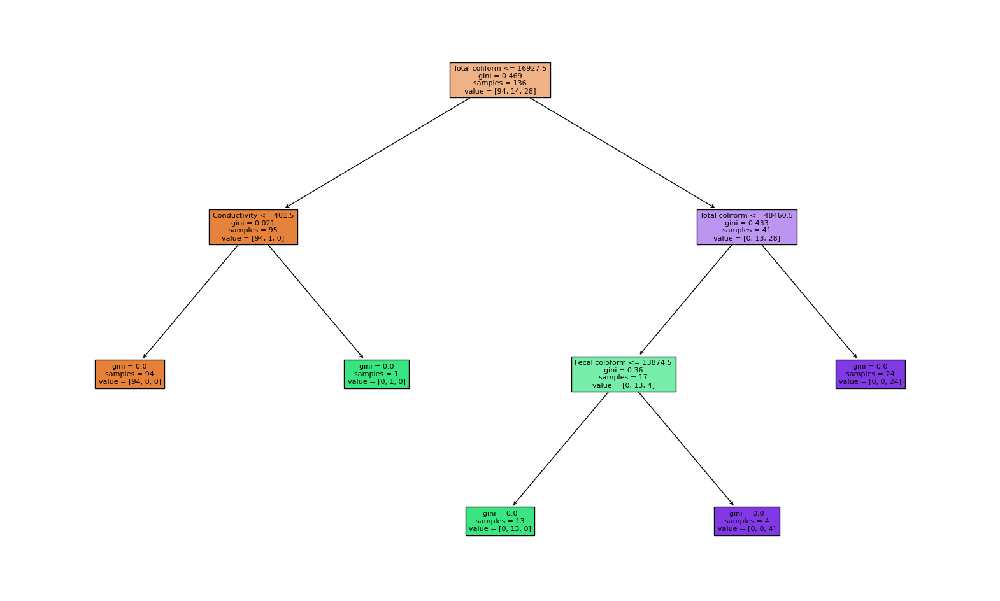

The tree with the best features:


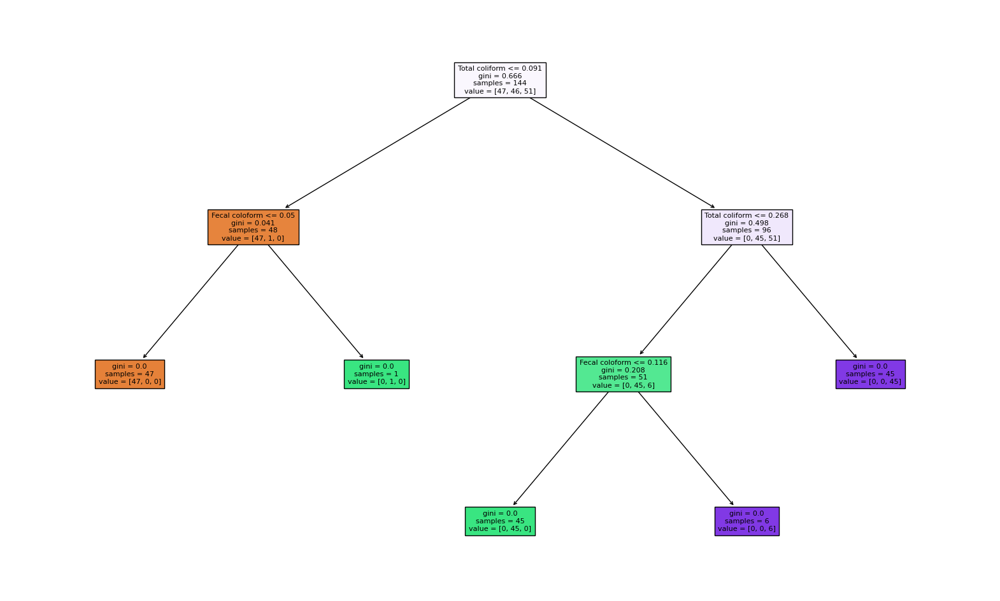

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117


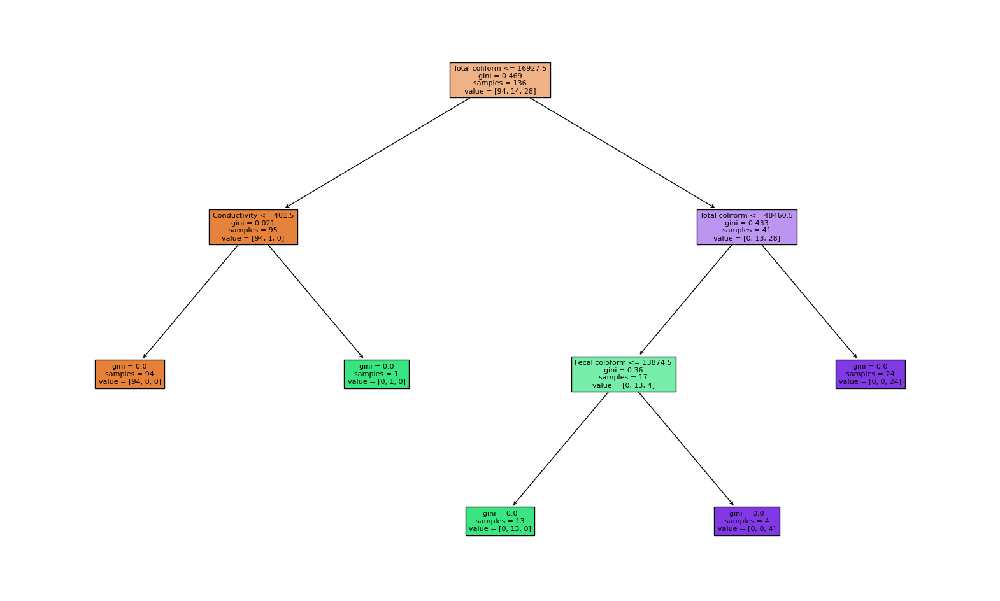

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.9705882352941176
> Precision: 0.9333333333333332
> Recall: 0.9166666666666666
> F1 Score: 0.9153439153439153
> Cross Validation Score (CV): 0.9411764705882353
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'Conductivity', 'Temp']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'Conductivity', 'Temp', 'pH ', 'DO', 'Nitrate+nitrite', 'BOD']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
7   Total coliform    0.478651
6   Fecal coloform    0.189338
0             Temp    0.060922
2     Conductivity    0.060414
4              BOD    0.057839
5  Nitrate+nitrite    0.052992
1              pH     0.050964
3               DO   

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.429516
6   Fecal coloform    0.217147
4              BOD    0.079844
1              pH     0.067906
0             Temp    0.054175
2     Conductivity    0.051290
3               DO    0.051285
5  Nitrate+nitrite    0.048838


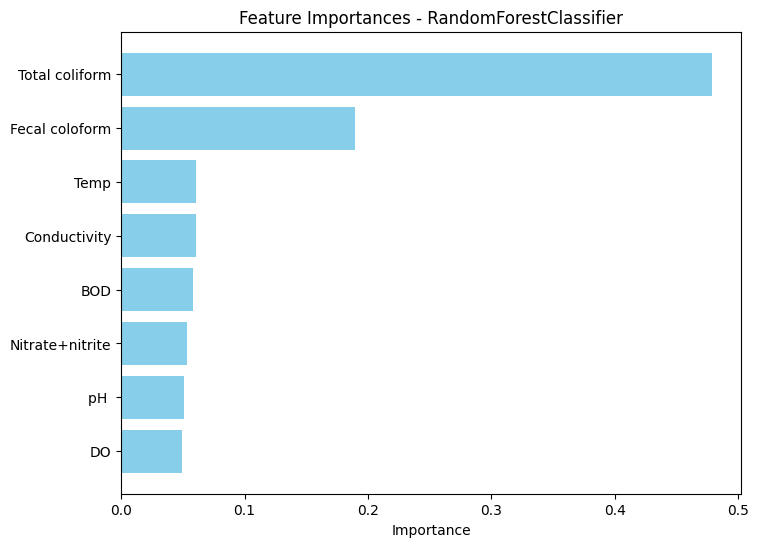

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9722222222222222
> Precision: 0.9777777777777779
> Recall: 0.9743589743589745
> F1 Score: 0.9751724137931035
> Cross Validation Score (CV): 0.9722222222222221
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ', 'Conductivity', 'DO', 'BOD', 'Nitrate+nitrite']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature    Importance
7   Total coliform

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.882393
6   Fecal coloform    0.102331
2     Conductivity    0.007131
1              pH     0.002615
3               DO    0.001887
0             Temp    0.001666
5  Nitrate+nitrite    0.001122
4              BOD    0.000857


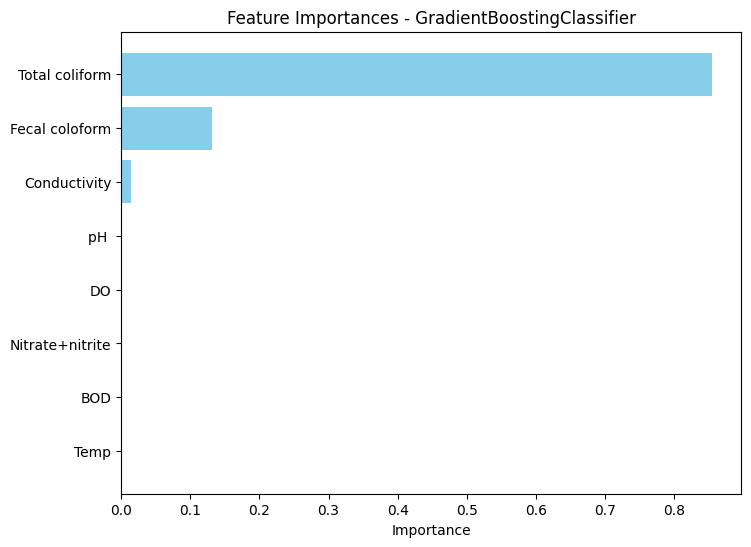

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.9444444444444444
> Precision: 0.9505494505494506
> Recall: 0.9505494505494506
> F1 Score: 0.9505494505494506
> Cross Validation Score (CV): 0.9722222222222221
Training SVC model with all features
Model: SVC
> Accuracy: 0.9705882352941176
> Precision: 0.9876543209876543
> Recall: 0.9166666666666666
> F1 Score: 0.9460916442048517
> Cross Validation Score (CV): 0.9823529411764707
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'Conductivity', 'BOD']
Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'Conductivity', 'BOD', 'pH ', 'Temp', 'Nitrate+nitrite', 'DO']
--------------------------------------------------
           Feature  Importance_x  Importance_y    Importance
0             Temp      0.000000      0.060922  0.000000e+

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


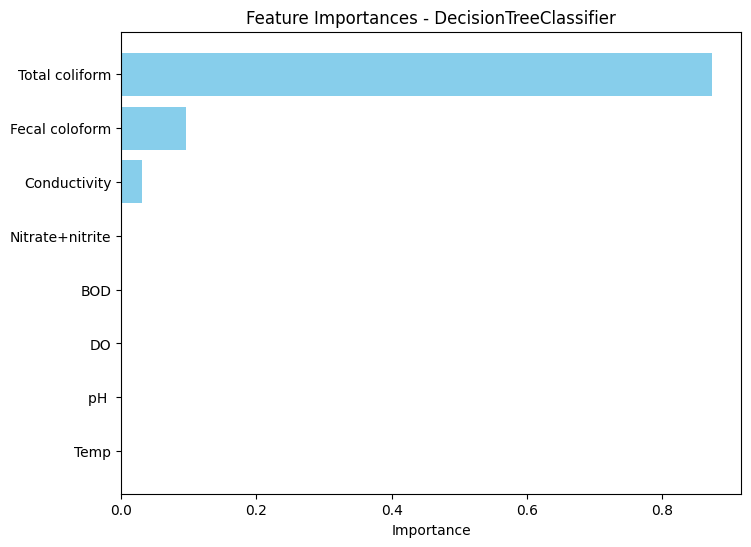

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.9444444444444444
> Precision: 0.9505494505494506
> Recall: 0.9505494505494506
> F1 Score: 0.9505494505494506
> Cross Validation Score (CV): 0.9722222222222221
The tree without a max depth:


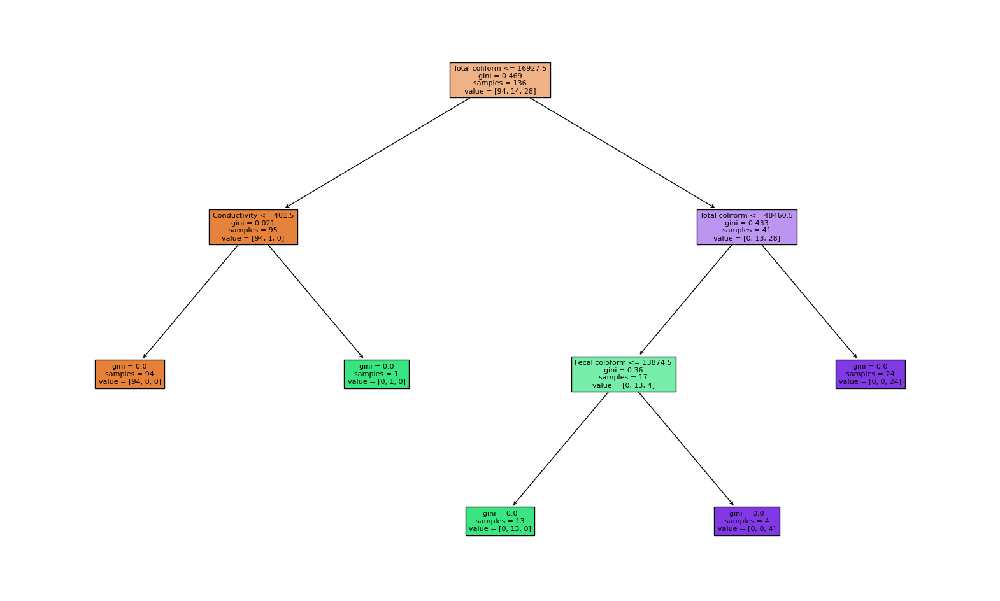

The tree with the best features:


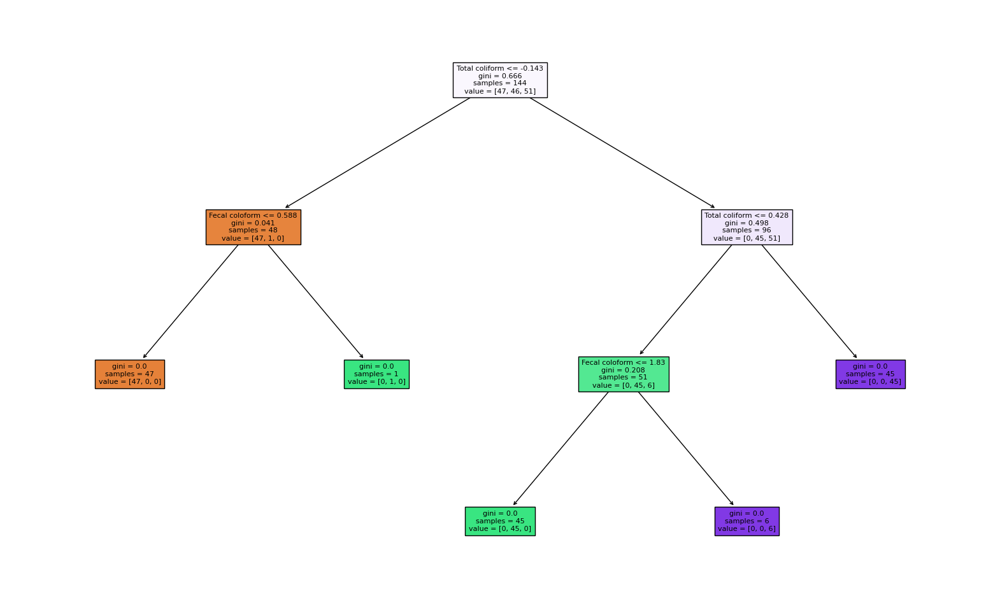

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117


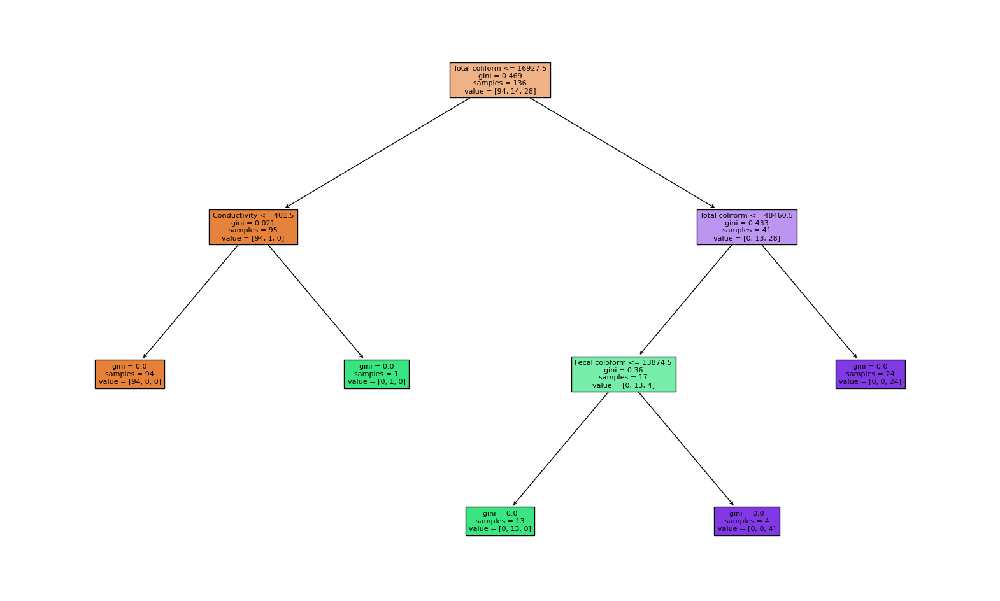

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.9705882352941176
> Precision: 0.9333333333333332
> Recall: 0.9166666666666666
> F1 Score: 0.9153439153439153
> Cross Validation Score (CV): 0.9411764705882353
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'Conductivity', 'Temp']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['Total coliform', 'Fecal coloform', 'Conductivity', 'Temp', 'pH ', 'DO', 'Nitrate+nitrite', 'BOD']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
7   Total coliform    0.478651
6   Fecal coloform    0.189338
0             Temp    0.060922
2     Conductivity    0.060414
4              BOD    0.057839
5  Nitrate+nitrite    0.052992
1              pH     0.050964
3               DO   

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.429516
6   Fecal coloform    0.217147
4              BOD    0.079844
1              pH     0.067906
0             Temp    0.054175
2     Conductivity    0.051290
3               DO    0.051285
5  Nitrate+nitrite    0.048838


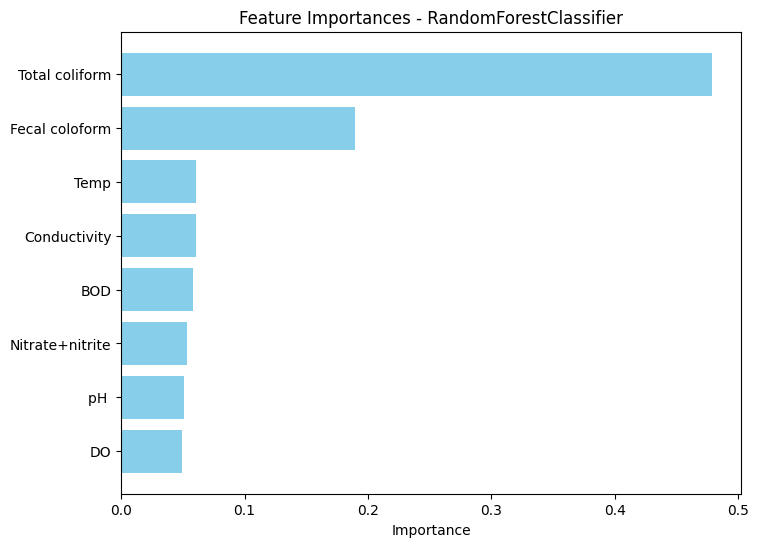

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9722222222222222
> Precision: 0.9777777777777779
> Recall: 0.9743589743589745
> F1 Score: 0.9751724137931035
> Cross Validation Score (CV): 0.9722222222222221
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 1.0
> Precision: 1.0
> Recall: 1.0
> F1 Score: 1.0
> Cross Validation Score (CV): 0.9470588235294117
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['Total coliform', 'Fecal coloform', 'Temp', 'pH ', 'Conductivity', 'DO', 'BOD', 'Nitrate+nitrite']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature    Importance
7   Total coliform

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
7   Total coliform    0.882393
6   Fecal coloform    0.102317
2     Conductivity    0.007124
1              pH     0.002635
3               DO    0.001900
0             Temp    0.001666
5  Nitrate+nitrite    0.001121
4              BOD    0.000845


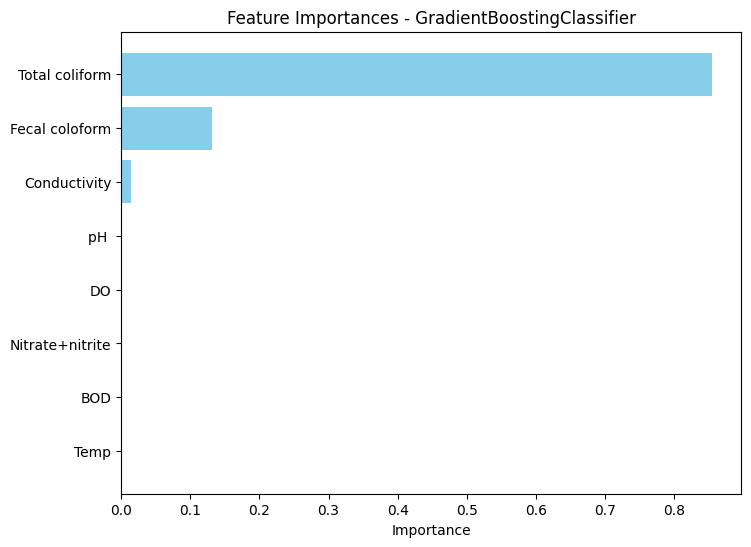

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.9444444444444444
> Precision: 0.9505494505494506
> Recall: 0.9505494505494506
> F1 Score: 0.9505494505494506
> Cross Validation Score (CV): 0.9722222222222221
Training SVC model with all features
Model: SVC
> Accuracy: 0.9705882352941176
> Precision: 0.9876543209876543
> Recall: 0.9166666666666666
> F1 Score: 0.9460916442048517
> Cross Validation Score (CV): 0.9823529411764707
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'BOD', 'Temp']
Selected features from Sequential Feature Selector for SVC: ['Total coliform', 'Fecal coloform', 'BOD', 'Temp', 'pH ', 'DO', 'Conductivity', 'Nitrate+nitrite']
--------------------------------------------------
           Feature  Importance_x  Importance_y    Importance
0             Temp      0.000000      0.060922  0.000000e+00
1    

In [36]:
CPIClassification = Model(cpi_classic_classification, 'CPI', 60, True, 5, False)

======================= Before balance without scale =======================
Training DecisionTreeRegressor model with all features
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 2.479411764705882
> Mean Squared Error (MSE): 12.772041176470584
> Root Mean Squared Error (RMSE): 3.573799263594779
> R2 Score: 0.7833363703997249
> Cross Validation Score (CV): 0.5135476517422404
> Cross Validation Score - neg_mean_absolute_error: 3.6415294117647057
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeRegressor: ['BOD', 'pH ', 'Temp', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for DecisionTreeRegressor: ['BOD', 'pH ', 'Temp', 'Nitrate+nitrite', 'Conductivity', 'Fecal coloform', 'DO', 'Total coliform']
--------------------------------------------------
DecisionTreeRegressor Feature Importances:
           Feature  Importance
4              BOD    0.730868
3               DO    0.15334

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


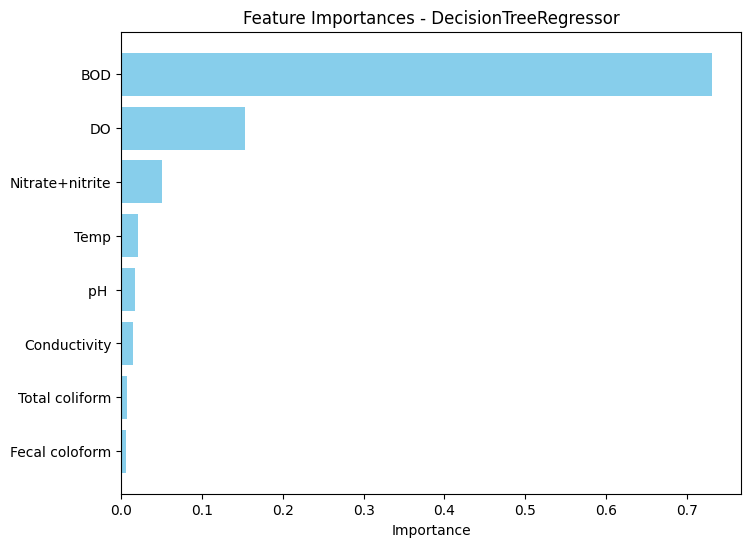

The following metrics are for the model with the best features:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 3.3323529411764703
> Mean Squared Error (MSE): 26.402952941176462
> Root Mean Squared Error (RMSE): 5.138380381129492
> R2 Score: 0.5521029460084027
> Cross Validation Score (CV): 0.5575356677596917
> Cross Validation Score - neg_mean_absolute_error: 3.6302352941176474
The tree without a max depth:


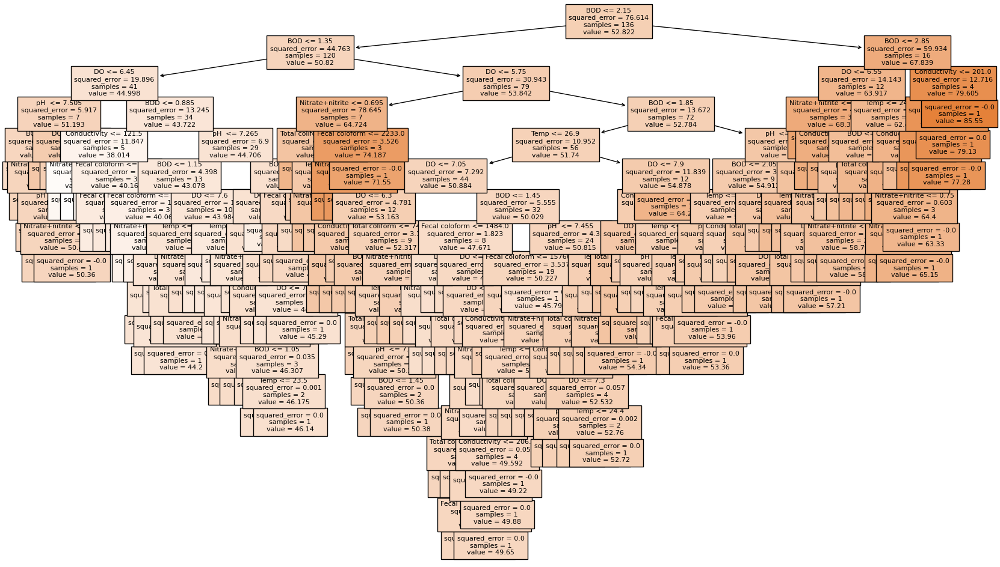

The tree with the best features:


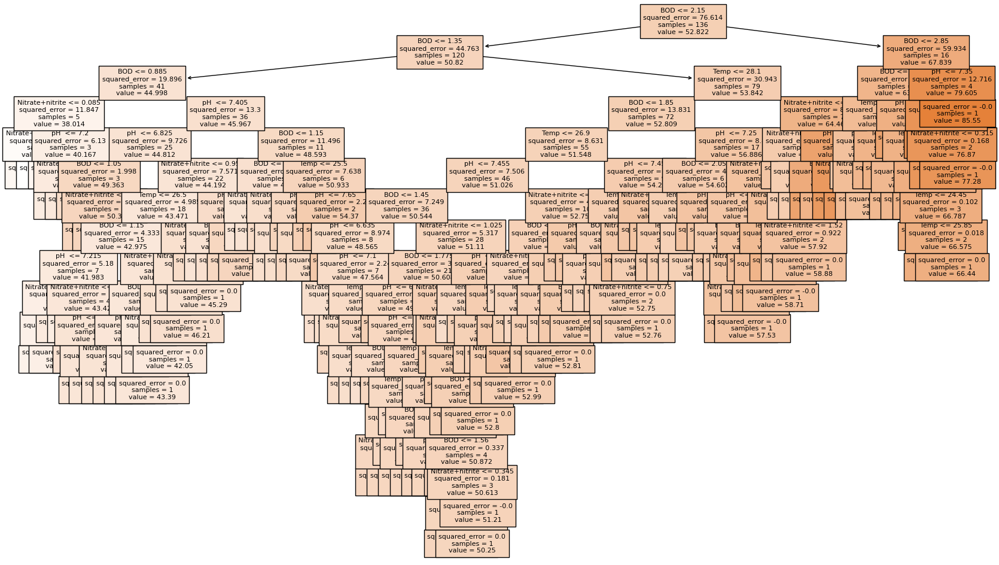

The tree with a max depth:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 2.703222689075629
> Mean Squared Error (MSE): 14.765140326451602
> Root Mean Squared Error (RMSE): 3.842543470990485
> R2 Score: 0.7495256356846147
> Cross Validation Score (CV): 0.5462579101308979
> Cross Validation Score - neg_mean_absolute_error: 3.5388584722790823


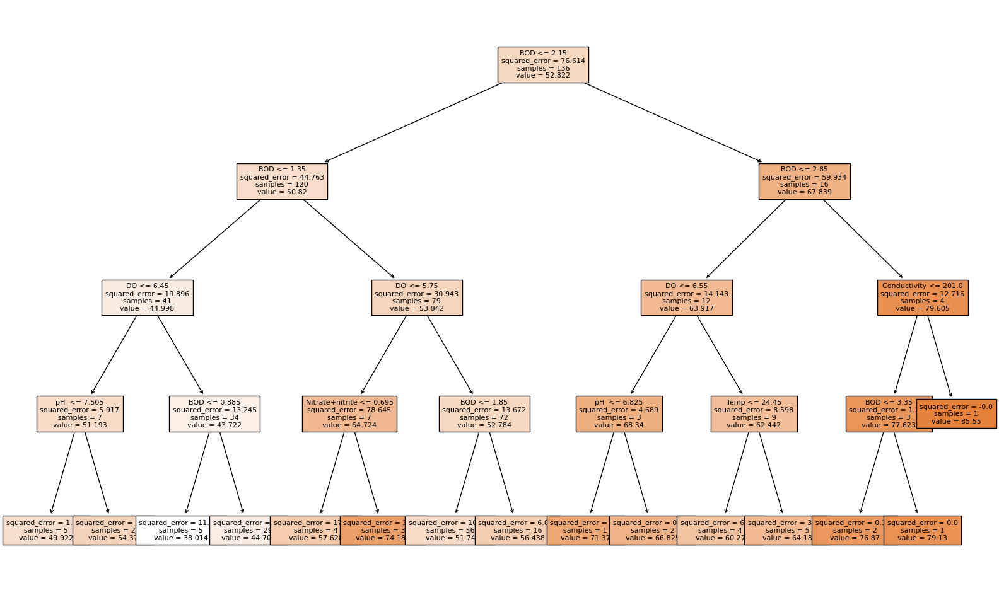

Training RandomForestRegressor model with all features
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.248979411764709
> Mean Squared Error (MSE): 12.182389742647073
> Root Mean Squared Error (RMSE): 3.490328027943373
> R2 Score: 0.793339158371202
> Cross Validation Score (CV): 0.8006934149345065
> Cross Validation Score - neg_mean_absolute_error: 2.4482547058823534
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'pH ', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'pH ', 'Nitrate+nitrite', 'Temp', 'Fecal coloform', 'Conductivity', 'Total coliform']
--------------------------------------------------
RandomForestRegressor Feature Importances:
           Feature  Importance
4              BOD    0.726096
3               DO    0.104700
0             Temp    0.070397
1              pH     0.024248
7   Total colifo

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.719541
3               DO    0.112498
0             Temp    0.058459
7   Total coliform    0.026756
1              pH     0.026236
5  Nitrate+nitrite    0.024545
2     Conductivity    0.017352
6   Fecal coloform    0.014612


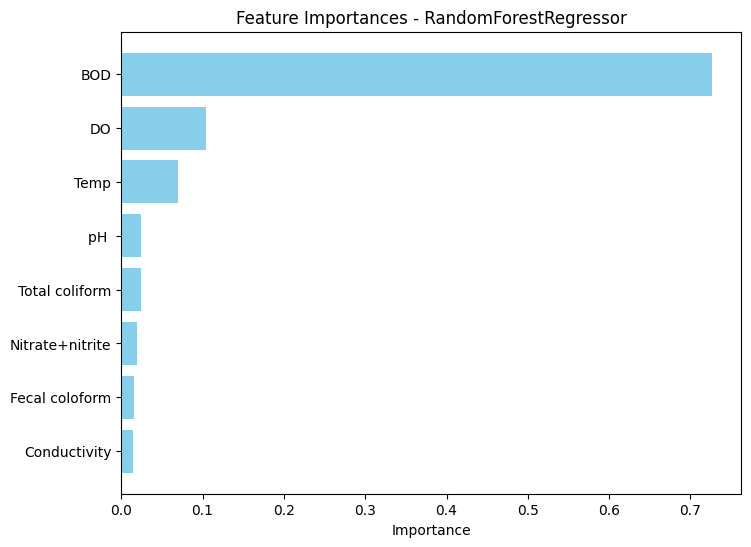

The following metrics are for the model with the best features:
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.0214352941176448
> Mean Squared Error (MSE): 10.448128803529427
> Root Mean Squared Error (RMSE): 3.232356540285961
> R2 Score: 0.8227589875552357
> Cross Validation Score (CV): 0.7908090824328818
> Cross Validation Score - neg_mean_absolute_error: 2.4144588235294115
Training GradientBoostingRegressor model with all features
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.9846240542953888
> Mean Squared Error (MSE): 10.909706715694917
> Root Mean Squared Error (RMSE): 3.302984516417677
> R2 Score: 0.8149288260006886
> Cross Validation Score (CV): 0.8107967329301561
> Cross Validation Score - neg_mean_absolute_error: 2.1677677412313665
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingRegressor: ['BOD', 'Temp', 'pH ', 'DO']
Selected features from Sequential Feature Select

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.714114
3               DO    0.137095
0             Temp    0.063130
1              pH     0.030024
5  Nitrate+nitrite    0.029157
7   Total coliform    0.013682
2     Conductivity    0.006980
6   Fecal coloform    0.005819


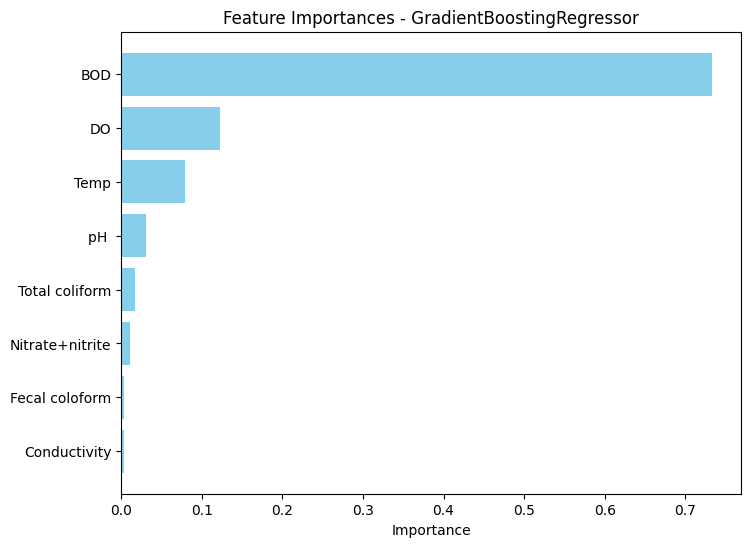

The following metrics are for the model with the best features:
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.9171934606511438
> Mean Squared Error (MSE): 10.416490025464974
> Root Mean Squared Error (RMSE): 3.227458756586205
> R2 Score: 0.8232957046231536
> Cross Validation Score (CV): 0.7315673687983046
> Cross Validation Score - neg_mean_absolute_error: 2.4072206159837393
Training LinearRegression model with all features
Model: LinearRegression
> Mean Absolute Error (MAE): 1.5425551275296214
> Mean Squared Error (MSE): 6.835225338484227
> Root Mean Squared Error (RMSE): 2.6144263880408314
> R2 Score: 0.8840479207270294
> Cross Validation Score (CV): 0.8371567500793186
> Cross Validation Score - neg_mean_absolute_error: 1.9982581804617194
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for LinearRegression: ['BOD', 'DO', 'pH ', 'Total coliform']
Selected features from Sequential Feature Selector for Linear

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


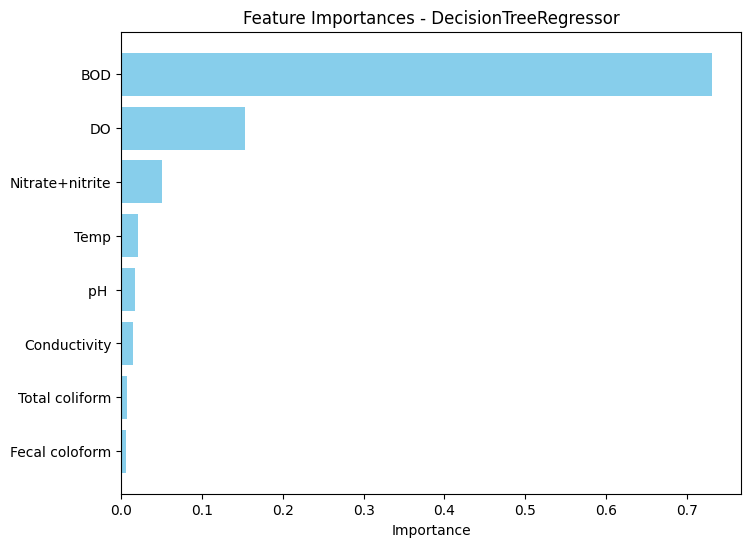

The following metrics are for the model with the best features:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 3.33735294117647
> Mean Squared Error (MSE): 26.417302941176466
> Root Mean Squared Error (RMSE): 5.139776545840925
> R2 Score: 0.5518595140430804
> Cross Validation Score (CV): 0.5839563022952753
> Cross Validation Score - neg_mean_absolute_error: 3.5502941176470584
The tree without a max depth:


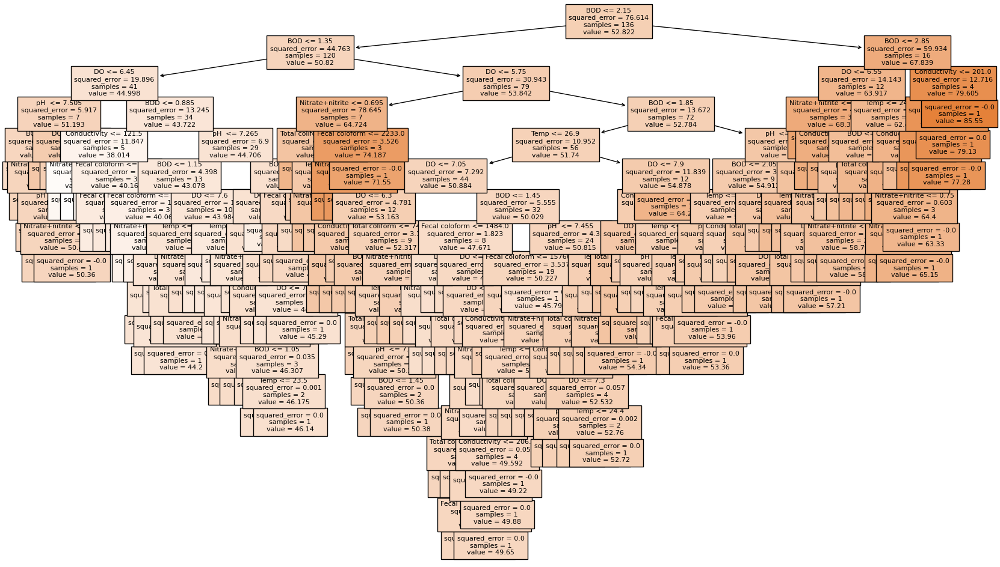

The tree with the best features:


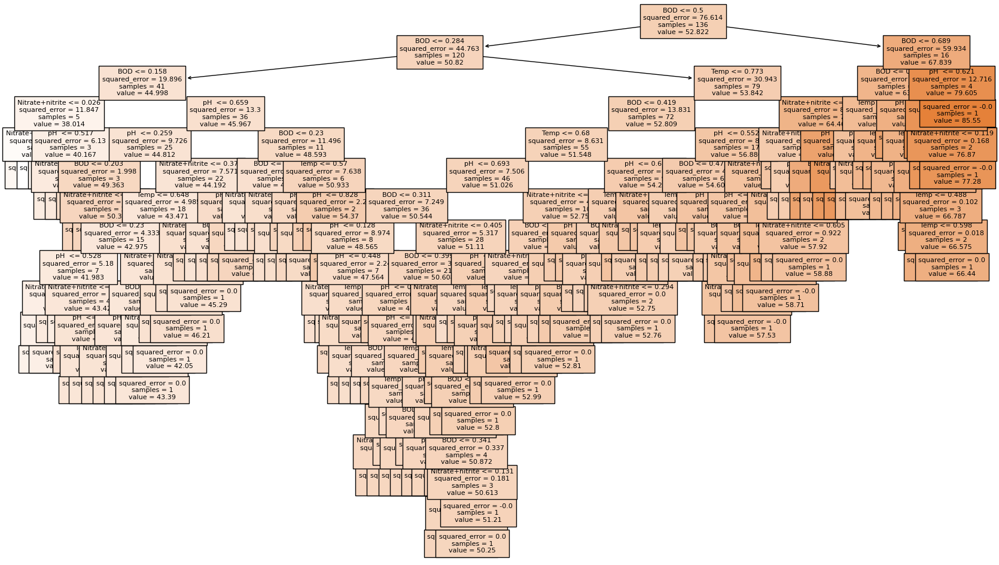

The tree with a max depth:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 2.703222689075629
> Mean Squared Error (MSE): 14.765140326451602
> Root Mean Squared Error (RMSE): 3.842543470990485
> R2 Score: 0.7495256356846147
> Cross Validation Score (CV): 0.5462579101308979
> Cross Validation Score - neg_mean_absolute_error: 3.5388584722790823


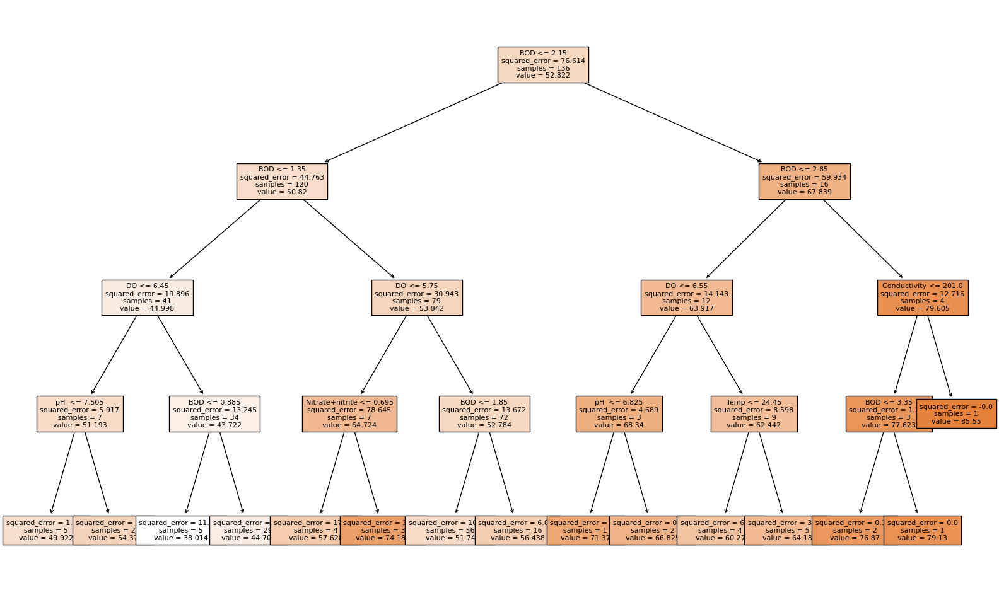

Training RandomForestRegressor model with all features
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.248979411764709
> Mean Squared Error (MSE): 12.182389742647073
> Root Mean Squared Error (RMSE): 3.490328027943373
> R2 Score: 0.793339158371202
> Cross Validation Score (CV): 0.8006934149345065
> Cross Validation Score - neg_mean_absolute_error: 2.4482547058823534
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'Nitrate+nitrite', 'pH ']
Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'Nitrate+nitrite', 'pH ', 'Temp', 'Conductivity', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
RandomForestRegressor Feature Importances:
           Feature  Importance
4              BOD    0.726096
3               DO    0.104700
0             Temp    0.070397
1              pH     0.024248
7   Total colifo

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.719541
3               DO    0.112498
0             Temp    0.058459
7   Total coliform    0.026756
1              pH     0.026236
5  Nitrate+nitrite    0.024545
2     Conductivity    0.017352
6   Fecal coloform    0.014612


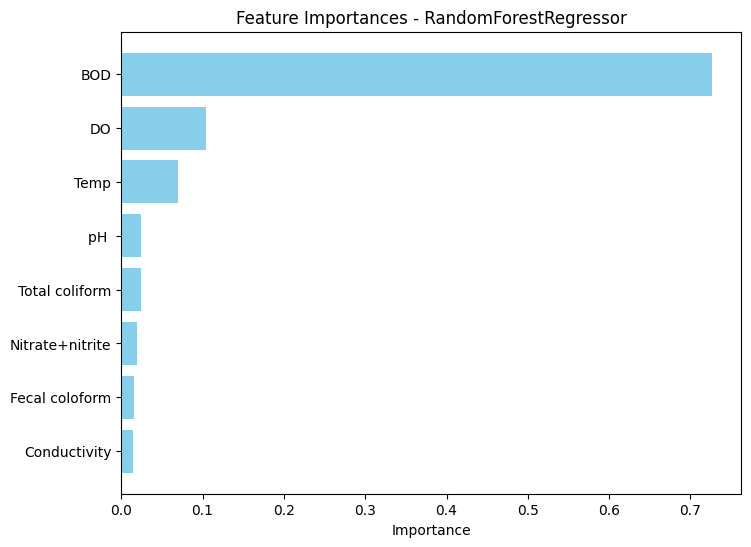

The following metrics are for the model with the best features:
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.0577323529411764
> Mean Squared Error (MSE): 10.595884250294134
> Root Mean Squared Error (RMSE): 3.2551319866165387
> R2 Score: 0.8202524789285466
> Cross Validation Score (CV): 0.7973847134687903
> Cross Validation Score - neg_mean_absolute_error: 2.3625570588235276
Training GradientBoostingRegressor model with all features
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.9846240542953888
> Mean Squared Error (MSE): 10.909706715694917
> Root Mean Squared Error (RMSE): 3.302984516417677
> R2 Score: 0.8149288260006886
> Cross Validation Score (CV): 0.8107967329301561
> Cross Validation Score - neg_mean_absolute_error: 2.1677677412313665
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingRegressor: ['BOD', 'DO', 'Nitrate+nitrite', 'pH ']
Selected features from Sequential Fe

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.714114
3               DO    0.137095
0             Temp    0.063130
1              pH     0.030024
5  Nitrate+nitrite    0.029157
7   Total coliform    0.013682
2     Conductivity    0.006980
6   Fecal coloform    0.005819


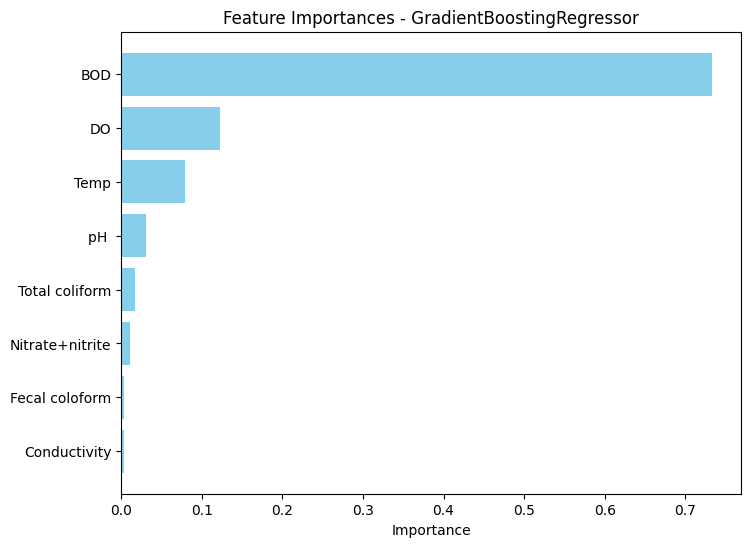

The following metrics are for the model with the best features:
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.8500405950923597
> Mean Squared Error (MSE): 8.681672192734325
> Root Mean Squared Error (RMSE): 2.9464677484632893
> R2 Score: 0.8527249808947616
> Cross Validation Score (CV): 0.8051454488666592
> Cross Validation Score - neg_mean_absolute_error: 2.220713975325377
Training LinearRegression model with all features
Model: LinearRegression
> Mean Absolute Error (MAE): 1.5425551275296214
> Mean Squared Error (MSE): 6.835225338484227
> Root Mean Squared Error (RMSE): 2.6144263880408314
> R2 Score: 0.8840479207270294
> Cross Validation Score (CV): 0.8371567500793186
> Cross Validation Score - neg_mean_absolute_error: 1.9982581804617194
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for LinearRegression: ['BOD', 'DO', 'pH ', 'Total coliform']
Selected features from Sequential Feature Selector for LinearR

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


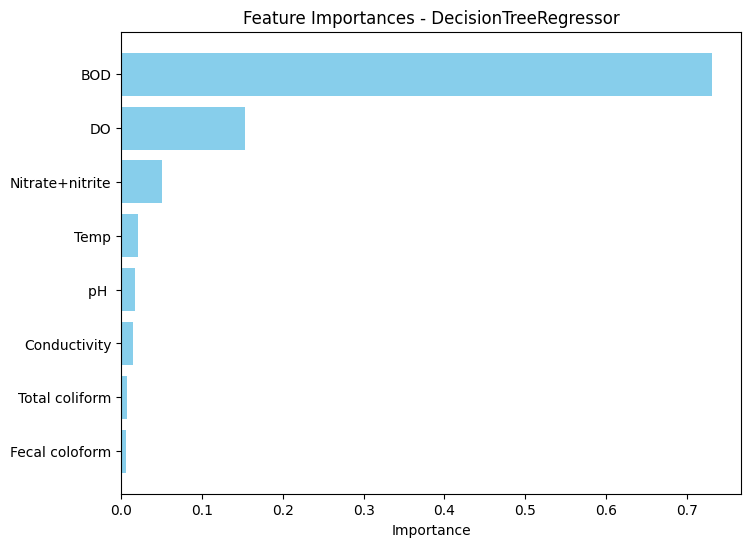

The following metrics are for the model with the best features:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 3.355294117647059
> Mean Squared Error (MSE): 22.489694117647048
> Root Mean Squared Error (RMSE): 4.7423300304435845
> R2 Score: 0.61848707745273
> Cross Validation Score (CV): 0.48318080945289044
> Cross Validation Score - neg_mean_absolute_error: 3.9068823529411767
The tree without a max depth:


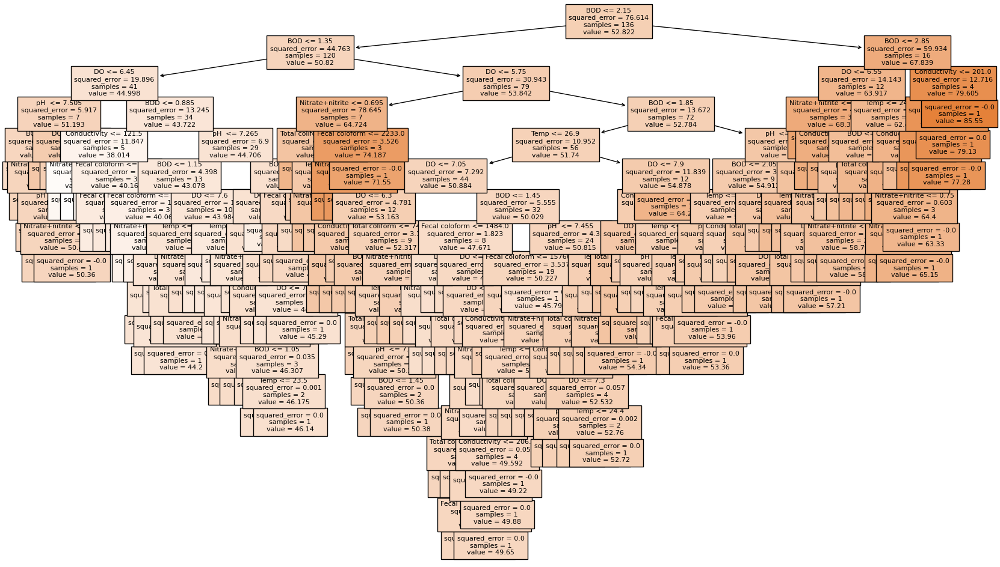

The tree with the best features:


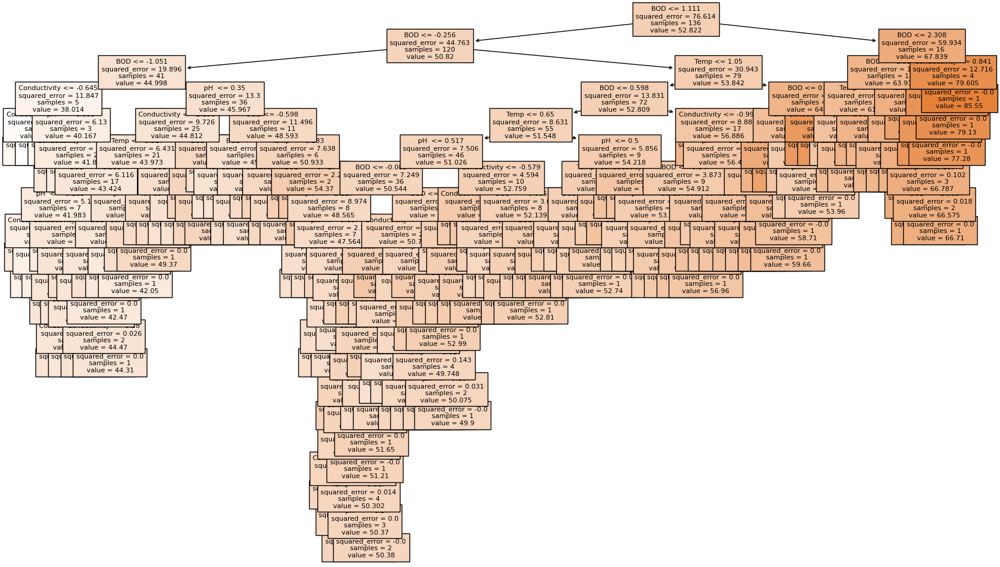

The tree with a max depth:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 2.703222689075629
> Mean Squared Error (MSE): 14.765140326451602
> Root Mean Squared Error (RMSE): 3.842543470990485
> R2 Score: 0.7495256356846147
> Cross Validation Score (CV): 0.5462579101308979
> Cross Validation Score - neg_mean_absolute_error: 3.5388584722790823


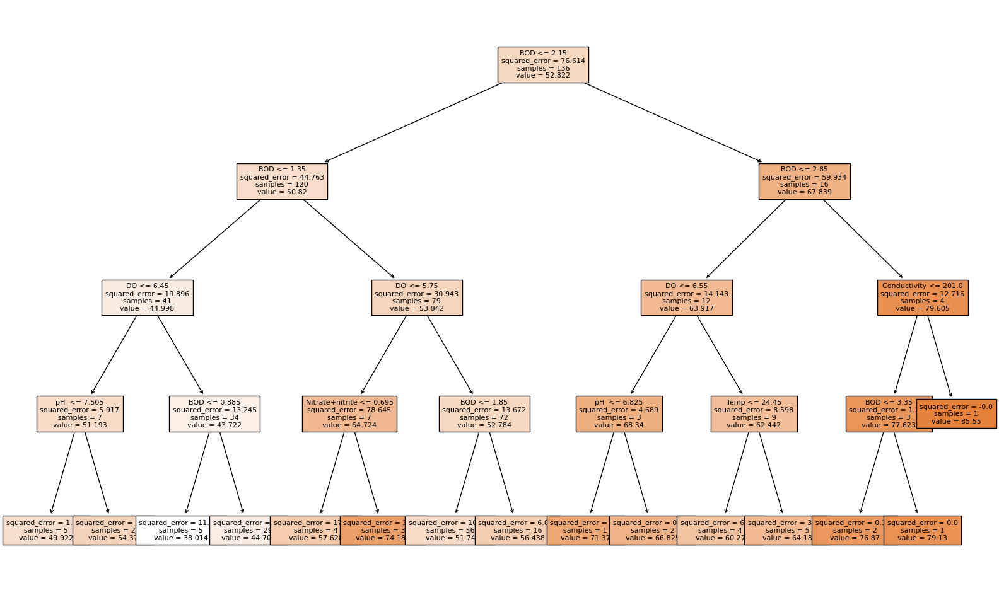

Training RandomForestRegressor model with all features
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.248979411764709
> Mean Squared Error (MSE): 12.182389742647073
> Root Mean Squared Error (RMSE): 3.490328027943373
> R2 Score: 0.793339158371202
> Cross Validation Score (CV): 0.8006934149345065
> Cross Validation Score - neg_mean_absolute_error: 2.4482547058823534
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'Nitrate+nitrite', 'pH ']
Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'Nitrate+nitrite', 'pH ', 'Temp', 'Conductivity', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
RandomForestRegressor Feature Importances:
           Feature  Importance
4              BOD    0.726096
3               DO    0.104700
0             Temp    0.070397
1              pH     0.024248
7   Total colifo

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.719541
3               DO    0.112498
0             Temp    0.058459
7   Total coliform    0.026756
1              pH     0.026236
5  Nitrate+nitrite    0.024545
2     Conductivity    0.017352
6   Fecal coloform    0.014612


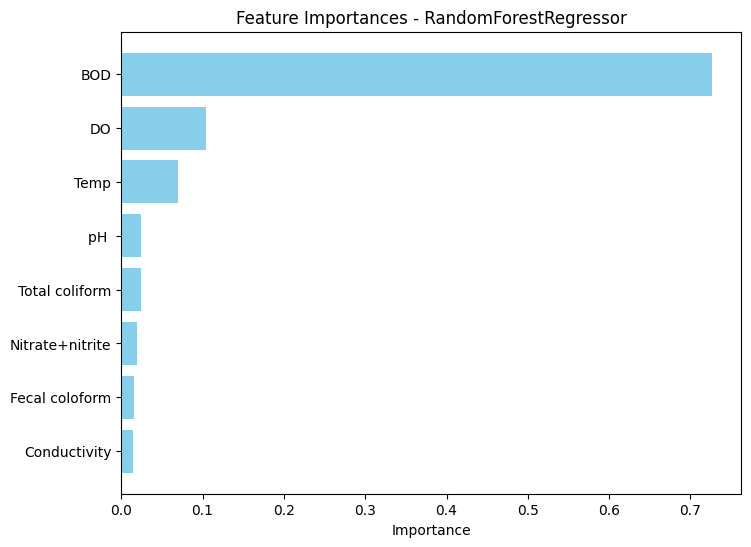

The following metrics are for the model with the best features:
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.0401558823529413
> Mean Squared Error (MSE): 10.52504238500002
> Root Mean Squared Error (RMSE): 3.244232171870568
> R2 Score: 0.8214542332488
> Cross Validation Score (CV): 0.7892069985055925
> Cross Validation Score - neg_mean_absolute_error: 2.4098929411764716
Training GradientBoostingRegressor model with all features
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.9846240542953888
> Mean Squared Error (MSE): 10.909706715694917
> Root Mean Squared Error (RMSE): 3.302984516417677
> R2 Score: 0.8149288260006886
> Cross Validation Score (CV): 0.8107967329301561
> Cross Validation Score - neg_mean_absolute_error: 2.1677677412313665
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingRegressor: ['BOD', 'Temp', 'pH ', 'DO']
Selected features from Sequential Feature Selector f

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.714114
3               DO    0.137095
0             Temp    0.063130
1              pH     0.030024
5  Nitrate+nitrite    0.029157
7   Total coliform    0.013682
2     Conductivity    0.006980
6   Fecal coloform    0.005819


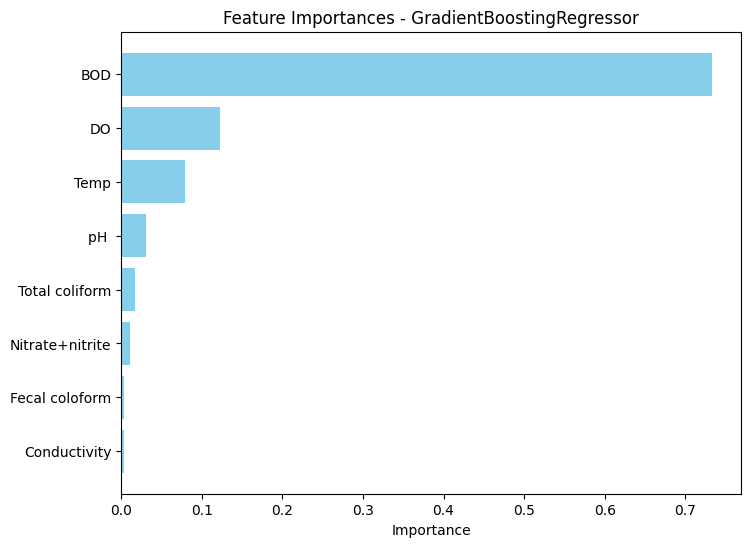

The following metrics are for the model with the best features:
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.9248644063452511
> Mean Squared Error (MSE): 10.458266892538362
> Root Mean Squared Error (RMSE): 3.2339243795330717
> R2 Score: 0.8225870060268694
> Cross Validation Score (CV): 0.6755870141946997
> Cross Validation Score - neg_mean_absolute_error: 2.4919437977265892
Training LinearRegression model with all features
Model: LinearRegression
> Mean Absolute Error (MAE): 1.5425551275296214
> Mean Squared Error (MSE): 6.835225338484227
> Root Mean Squared Error (RMSE): 2.6144263880408314
> R2 Score: 0.8840479207270294
> Cross Validation Score (CV): 0.8371567500793186
> Cross Validation Score - neg_mean_absolute_error: 1.9982581804617194
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for LinearRegression: ['BOD', 'DO', 'pH ', 'Total coliform']
Selected features from Sequential Feature Selector for Linea

In [37]:
BCWQIReggression_not_removed = Model(bcwqi_classic_regression, 'Index1', 60, False, 5, False)

======================= Before balance without scale =======================
Training DecisionTreeRegressor model with all features
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 2.479411764705882
> Mean Squared Error (MSE): 12.772041176470584
> Root Mean Squared Error (RMSE): 3.573799263594779
> R2 Score: 0.7833363703997249
> Cross Validation Score (CV): 0.5135476517422404
> Cross Validation Score - neg_mean_absolute_error: 3.6415294117647057
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeRegressor: ['BOD', 'pH ', 'Temp', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for DecisionTreeRegressor: ['BOD', 'pH ', 'Temp', 'Nitrate+nitrite', 'Conductivity', 'Fecal coloform', 'Total coliform', 'DO']
--------------------------------------------------
DecisionTreeRegressor Feature Importances:
           Feature  Importance
4              BOD    0.730868
3               DO    0.15334

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


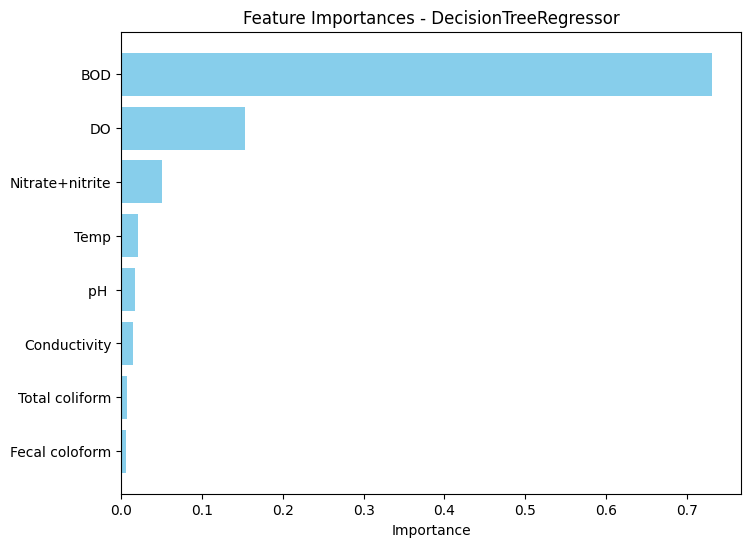

The following metrics are for the model with the best features:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 3.3323529411764703
> Mean Squared Error (MSE): 26.402952941176462
> Root Mean Squared Error (RMSE): 5.138380381129492
> R2 Score: 0.5521029460084027
> Cross Validation Score (CV): 0.5575356677596917
> Cross Validation Score - neg_mean_absolute_error: 3.6302352941176474
The tree without a max depth:


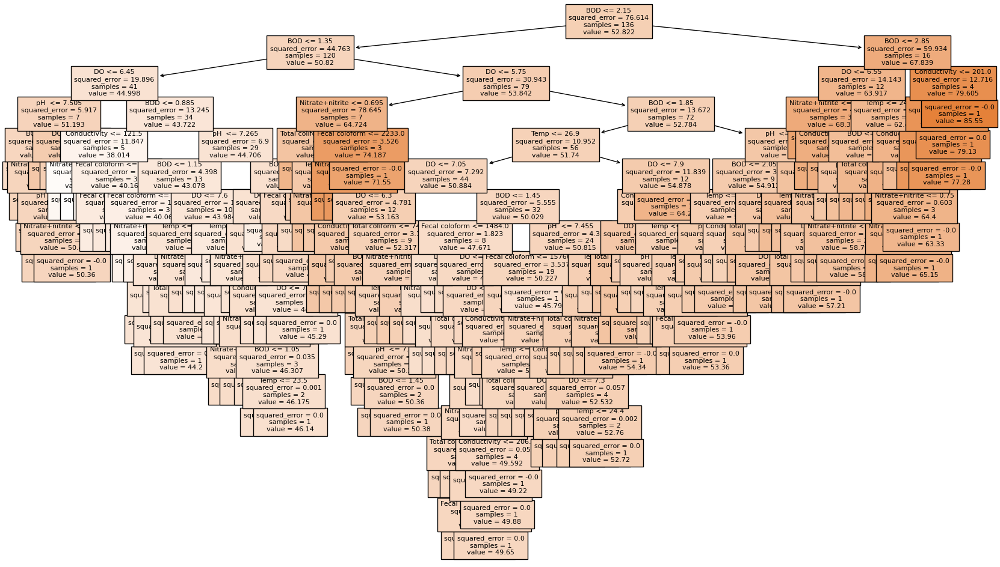

The tree with the best features:


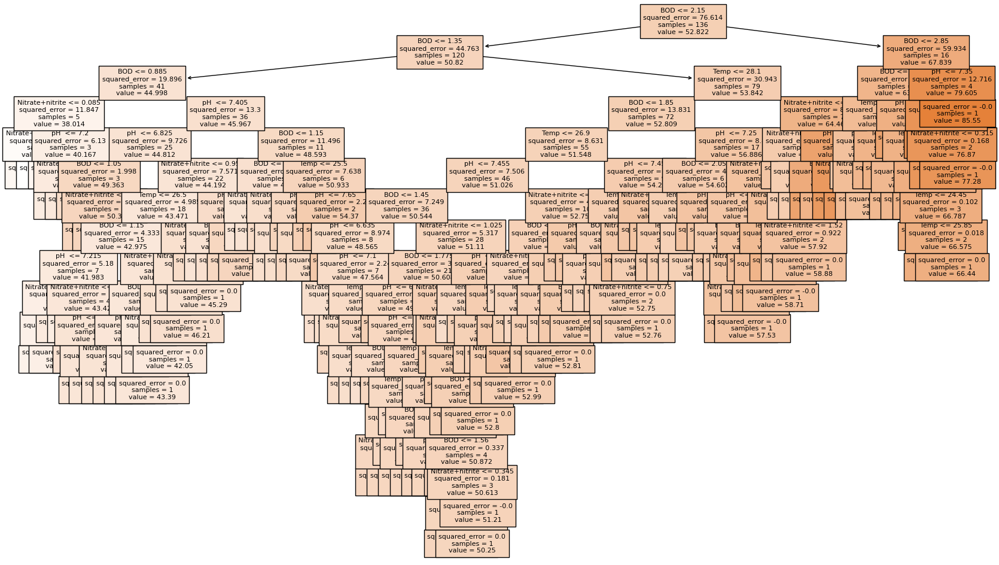

The tree with a max depth:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 2.703222689075629
> Mean Squared Error (MSE): 14.765140326451602
> Root Mean Squared Error (RMSE): 3.842543470990485
> R2 Score: 0.7495256356846147
> Cross Validation Score (CV): 0.5462579101308979
> Cross Validation Score - neg_mean_absolute_error: 3.5388584722790823


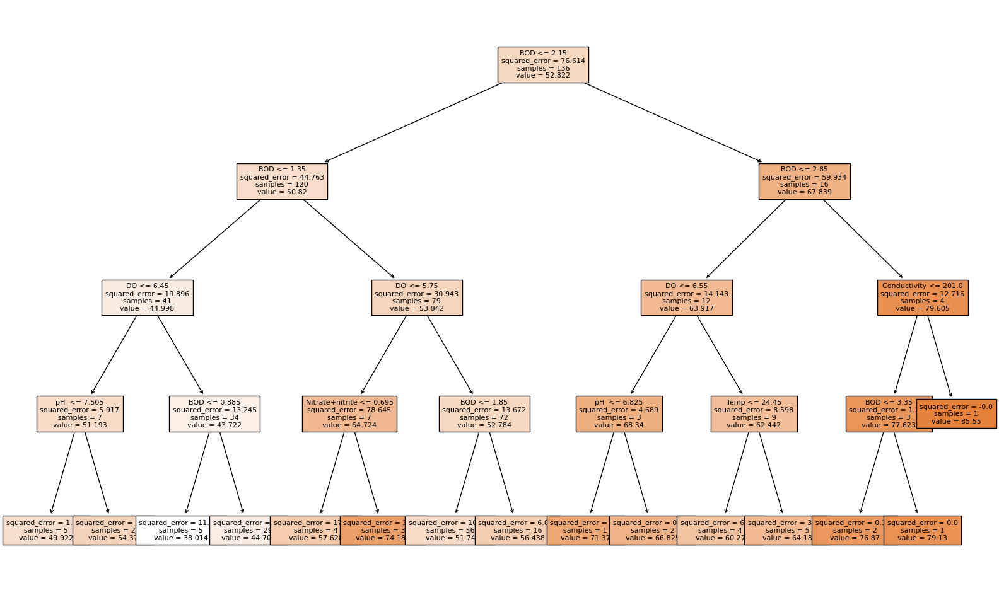

Training RandomForestRegressor model with all features
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.248979411764709
> Mean Squared Error (MSE): 12.182389742647073
> Root Mean Squared Error (RMSE): 3.490328027943373
> R2 Score: 0.793339158371202
> Cross Validation Score (CV): 0.8006934149345065
> Cross Validation Score - neg_mean_absolute_error: 2.4482547058823534
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'pH ', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'pH ', 'Nitrate+nitrite', 'Temp', 'Conductivity', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
RandomForestRegressor Feature Importances:
           Feature  Importance
4              BOD    0.726096
3               DO    0.104700
0             Temp    0.070397
1              pH     0.024248
7   Total colifo

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.719541
3               DO    0.112498
0             Temp    0.058459
7   Total coliform    0.026756
1              pH     0.026236
5  Nitrate+nitrite    0.024545
2     Conductivity    0.017352
6   Fecal coloform    0.014612


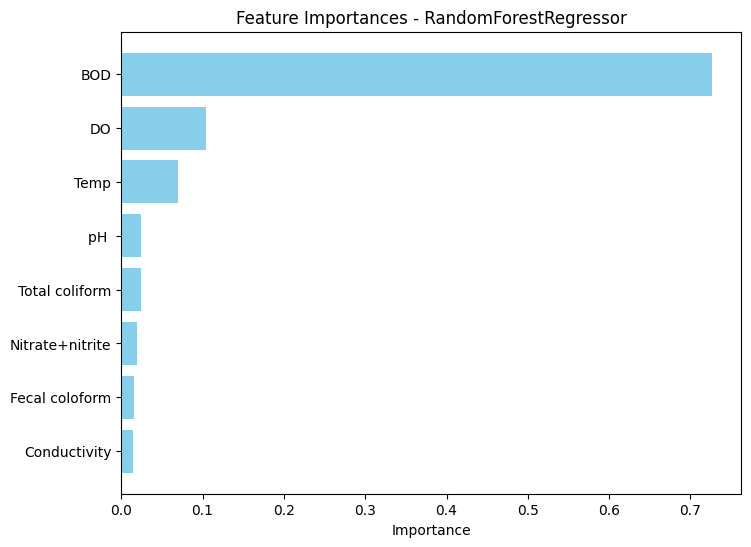

The following metrics are for the model with the best features:
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.0214352941176448
> Mean Squared Error (MSE): 10.448128803529427
> Root Mean Squared Error (RMSE): 3.232356540285961
> R2 Score: 0.8227589875552357
> Cross Validation Score (CV): 0.7908090824328818
> Cross Validation Score - neg_mean_absolute_error: 2.4144588235294115
Training GradientBoostingRegressor model with all features
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.9846240542953888
> Mean Squared Error (MSE): 10.909706715694917
> Root Mean Squared Error (RMSE): 3.302984516417677
> R2 Score: 0.8149288260006886
> Cross Validation Score (CV): 0.8107967329301561
> Cross Validation Score - neg_mean_absolute_error: 2.1677677412313665
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingRegressor: ['BOD', 'DO', 'Nitrate+nitrite', 'pH ']
Selected features from Sequential Fea

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.714114
3               DO    0.137095
0             Temp    0.063130
1              pH     0.030024
5  Nitrate+nitrite    0.029157
7   Total coliform    0.013682
2     Conductivity    0.006980
6   Fecal coloform    0.005819


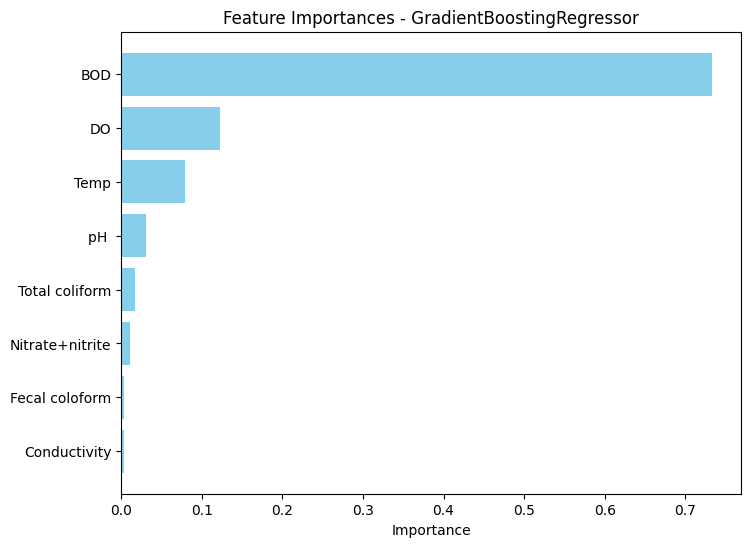

The following metrics are for the model with the best features:
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.8752249039121796
> Mean Squared Error (MSE): 8.743391667256171
> Root Mean Squared Error (RMSE): 2.9569226684606025
> R2 Score: 0.8516779778995347
> Cross Validation Score (CV): 0.805255086926223
> Cross Validation Score - neg_mean_absolute_error: 2.225278369457891
Training LinearRegression model with all features
Model: LinearRegression
> Mean Absolute Error (MAE): 1.5425551275296214
> Mean Squared Error (MSE): 6.835225338484227
> Root Mean Squared Error (RMSE): 2.6144263880408314
> R2 Score: 0.8840479207270294
> Cross Validation Score (CV): 0.8371567500793186
> Cross Validation Score - neg_mean_absolute_error: 1.9982581804617194
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for LinearRegression: ['BOD', 'DO', 'pH ', 'Total coliform']
Selected features from Sequential Feature Selector for LinearRe

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


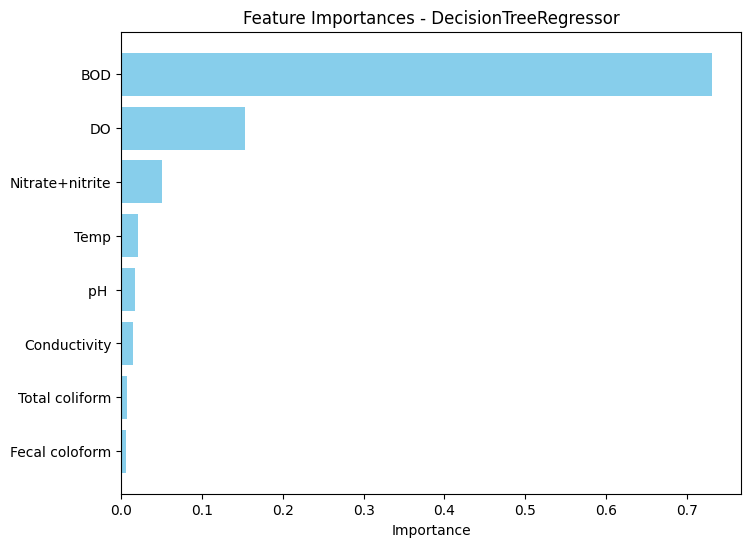

The following metrics are for the model with the best features:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 3.33735294117647
> Mean Squared Error (MSE): 26.417302941176466
> Root Mean Squared Error (RMSE): 5.139776545840925
> R2 Score: 0.5518595140430804
> Cross Validation Score (CV): 0.5839563022952753
> Cross Validation Score - neg_mean_absolute_error: 3.5502941176470584
The tree without a max depth:


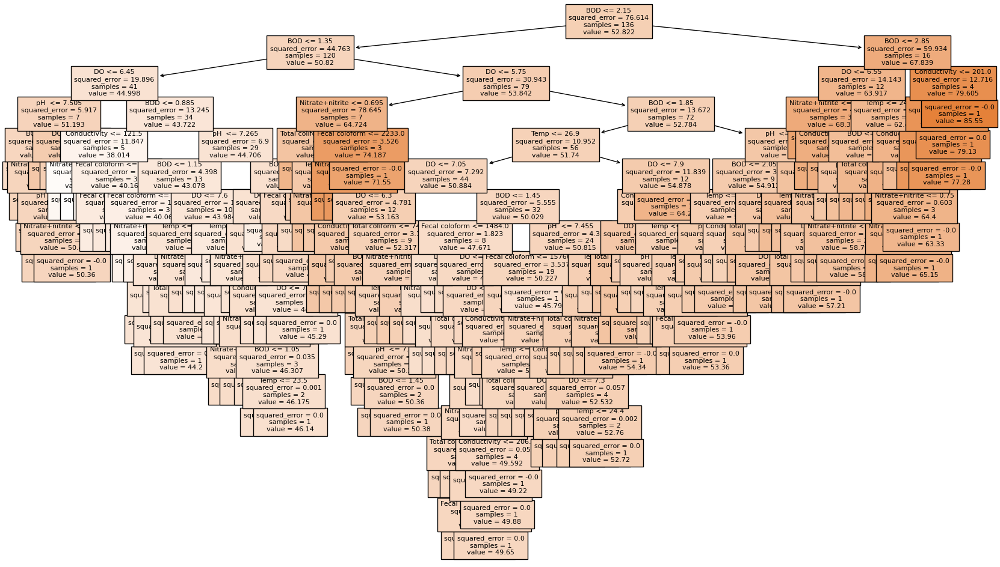

The tree with the best features:


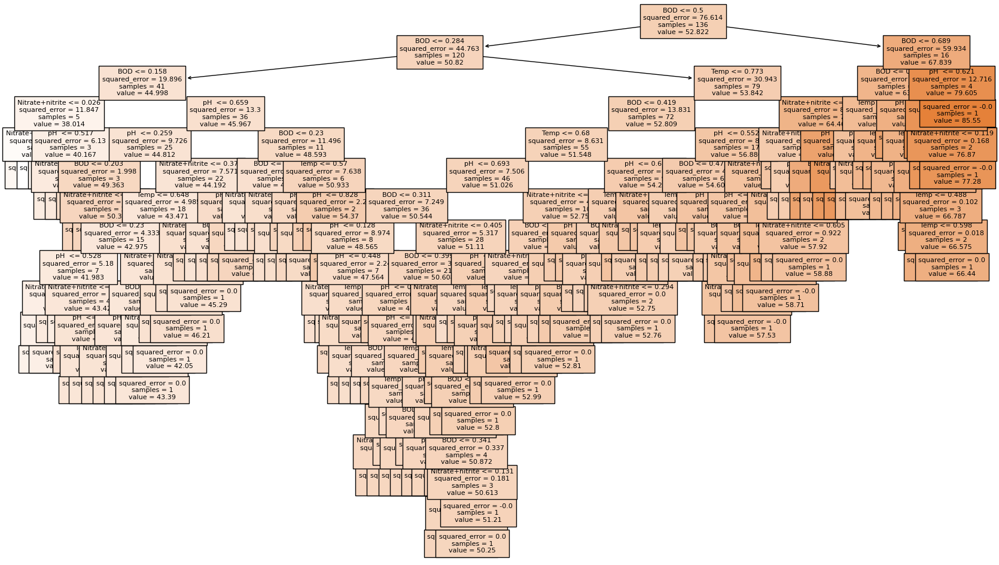

The tree with a max depth:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 2.703222689075629
> Mean Squared Error (MSE): 14.765140326451602
> Root Mean Squared Error (RMSE): 3.842543470990485
> R2 Score: 0.7495256356846147
> Cross Validation Score (CV): 0.5462579101308979
> Cross Validation Score - neg_mean_absolute_error: 3.5388584722790823


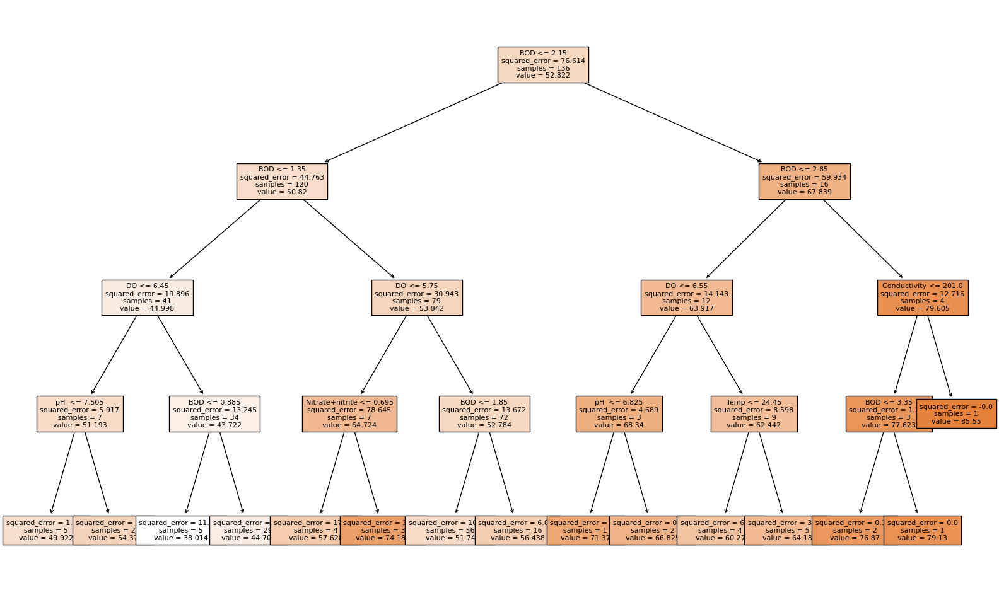

Training RandomForestRegressor model with all features
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.248979411764709
> Mean Squared Error (MSE): 12.182389742647073
> Root Mean Squared Error (RMSE): 3.490328027943373
> R2 Score: 0.793339158371202
> Cross Validation Score (CV): 0.8006934149345065
> Cross Validation Score - neg_mean_absolute_error: 2.4482547058823534
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'pH ', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'pH ', 'Nitrate+nitrite', 'Temp', 'Conductivity', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
RandomForestRegressor Feature Importances:
           Feature  Importance
4              BOD    0.726096
3               DO    0.104700
0             Temp    0.070397
1              pH     0.024248
7   Total colifo

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.719541
3               DO    0.112498
0             Temp    0.058459
7   Total coliform    0.026756
1              pH     0.026236
5  Nitrate+nitrite    0.024545
2     Conductivity    0.017352
6   Fecal coloform    0.014612


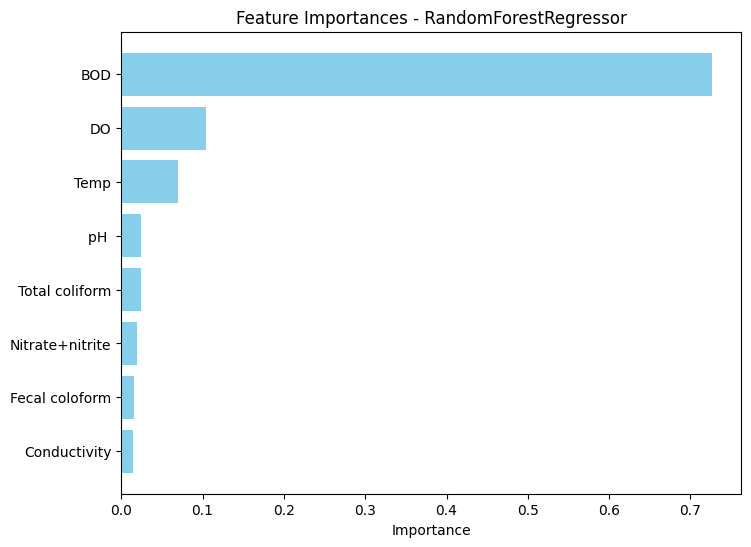

The following metrics are for the model with the best features:
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.0879558823529405
> Mean Squared Error (MSE): 10.686627929705905
> Root Mean Squared Error (RMSE): 3.269040827170243
> R2 Score: 0.818713112223336
> Cross Validation Score (CV): 0.7930111143955598
> Cross Validation Score - neg_mean_absolute_error: 2.3830105882352925
Training GradientBoostingRegressor model with all features
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.9846240542953888
> Mean Squared Error (MSE): 10.909706715694917
> Root Mean Squared Error (RMSE): 3.302984516417677
> R2 Score: 0.8149288260006886
> Cross Validation Score (CV): 0.8107967329301561
> Cross Validation Score - neg_mean_absolute_error: 2.1677677412313665
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingRegressor: ['BOD', 'Temp', 'pH ', 'DO']
Selected features from Sequential Feature Selecto

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.714114
3               DO    0.137095
0             Temp    0.063130
1              pH     0.030024
5  Nitrate+nitrite    0.029157
7   Total coliform    0.013682
2     Conductivity    0.006980
6   Fecal coloform    0.005819


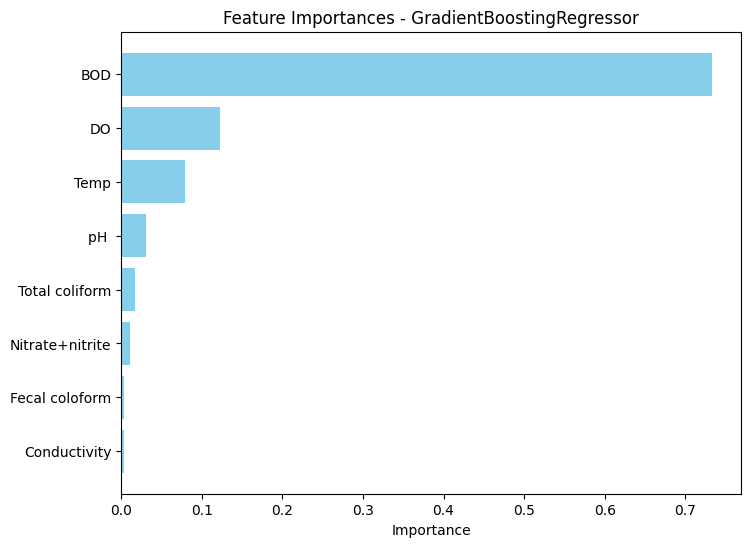

The following metrics are for the model with the best features:
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.8949526780164538
> Mean Squared Error (MSE): 10.31798297146043
> Root Mean Squared Error (RMSE): 3.212161728721085
> R2 Score: 0.8249667684387929
> Cross Validation Score (CV): 0.7314710917481275
> Cross Validation Score - neg_mean_absolute_error: 2.398675991700716
Training LinearRegression model with all features
Model: LinearRegression
> Mean Absolute Error (MAE): 1.5425551275296214
> Mean Squared Error (MSE): 6.835225338484227
> Root Mean Squared Error (RMSE): 2.6144263880408314
> R2 Score: 0.8840479207270294
> Cross Validation Score (CV): 0.8371567500793186
> Cross Validation Score - neg_mean_absolute_error: 1.9982581804617194
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for LinearRegression: ['BOD', 'DO', 'pH ', 'Total coliform']
Selected features from Sequential Feature Selector for LinearRe

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


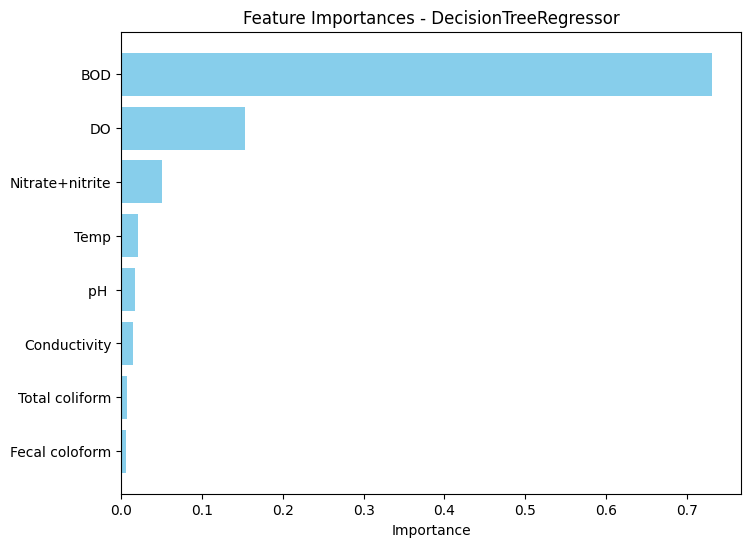

The following metrics are for the model with the best features:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 3.3323529411764703
> Mean Squared Error (MSE): 26.402952941176462
> Root Mean Squared Error (RMSE): 5.138380381129492
> R2 Score: 0.5521029460084027
> Cross Validation Score (CV): 0.5783767576877796
> Cross Validation Score - neg_mean_absolute_error: 3.54735294117647
The tree without a max depth:


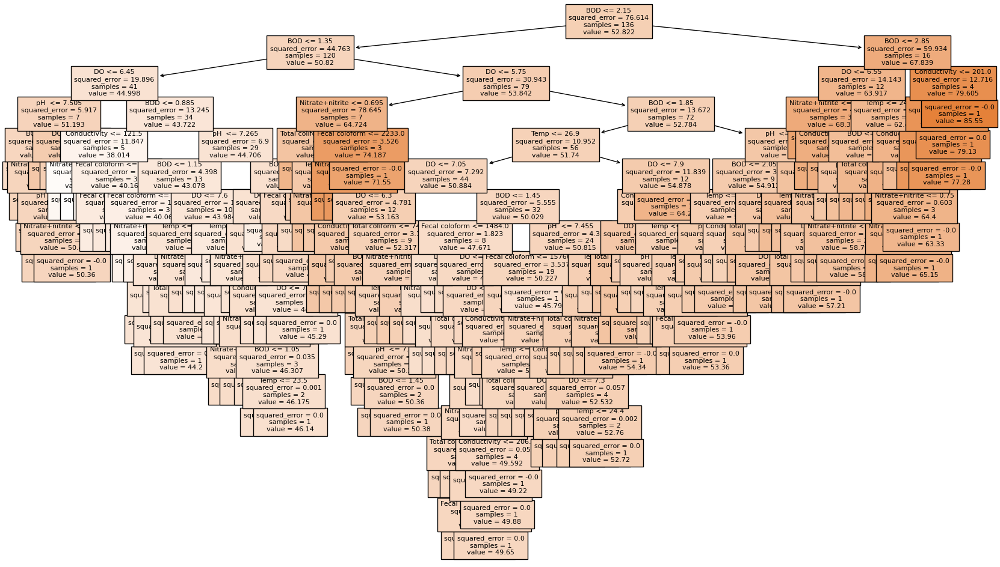

The tree with the best features:


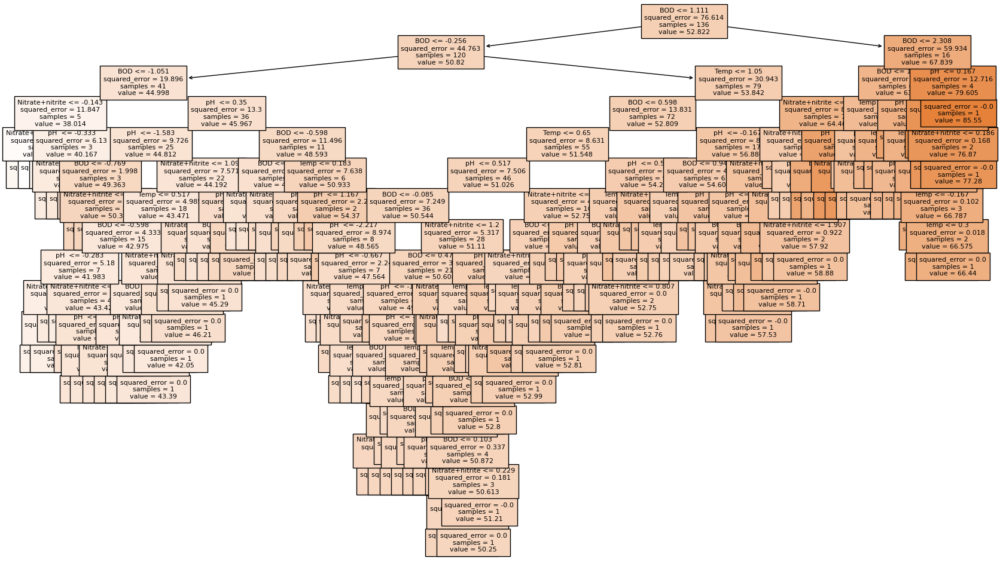

The tree with a max depth:
Model: DecisionTreeRegressor
> Mean Absolute Error (MAE): 2.703222689075629
> Mean Squared Error (MSE): 14.765140326451602
> Root Mean Squared Error (RMSE): 3.842543470990485
> R2 Score: 0.7495256356846147
> Cross Validation Score (CV): 0.5462579101308979
> Cross Validation Score - neg_mean_absolute_error: 3.5388584722790823


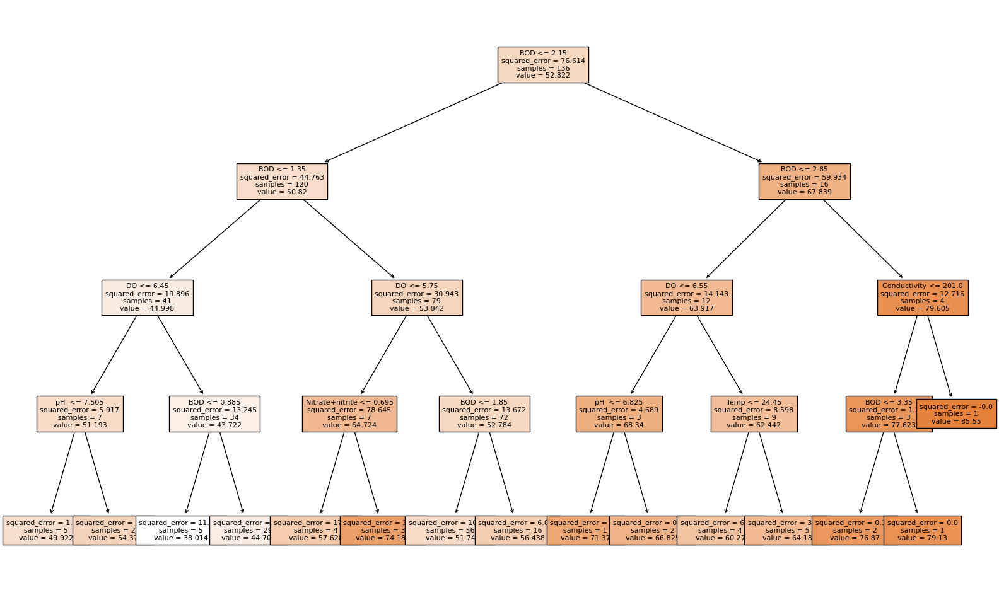

Training RandomForestRegressor model with all features
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.248979411764709
> Mean Squared Error (MSE): 12.182389742647073
> Root Mean Squared Error (RMSE): 3.490328027943373
> R2 Score: 0.793339158371202
> Cross Validation Score (CV): 0.8006934149345065
> Cross Validation Score - neg_mean_absolute_error: 2.4482547058823534
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'Nitrate+nitrite', 'pH ']
Selected features from Sequential Feature Selector for RandomForestRegressor: ['BOD', 'DO', 'Nitrate+nitrite', 'pH ', 'Temp', 'Conductivity', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
RandomForestRegressor Feature Importances:
           Feature  Importance
4              BOD    0.726096
3               DO    0.104700
0             Temp    0.070397
1              pH     0.024248
7   Total colifo

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.719541
3               DO    0.112498
0             Temp    0.058459
7   Total coliform    0.026756
1              pH     0.026236
5  Nitrate+nitrite    0.024545
2     Conductivity    0.017352
6   Fecal coloform    0.014612


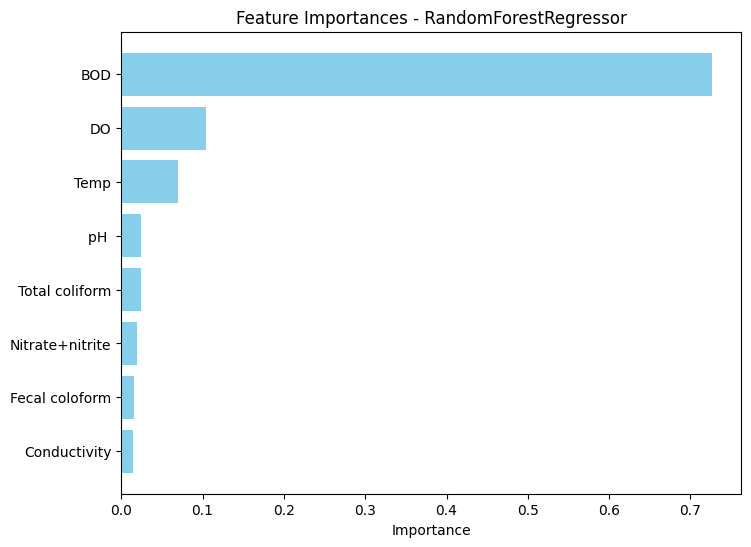

The following metrics are for the model with the best features:
Model: RandomForestRegressor
> Mean Absolute Error (MAE): 2.0401558823529413
> Mean Squared Error (MSE): 10.52504238500002
> Root Mean Squared Error (RMSE): 3.244232171870568
> R2 Score: 0.8214542332488
> Cross Validation Score (CV): 0.7892069985055925
> Cross Validation Score - neg_mean_absolute_error: 2.4098929411764716
Training GradientBoostingRegressor model with all features
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.9846240542953888
> Mean Squared Error (MSE): 10.909706715694917
> Root Mean Squared Error (RMSE): 3.302984516417677
> R2 Score: 0.8149288260006886
> Cross Validation Score (CV): 0.8107967329301561
> Cross Validation Score - neg_mean_absolute_error: 2.1677677412313665
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingRegressor: ['BOD', 'Temp', 'pH ', 'DO']
Selected features from Sequential Feature Selector f

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingRegressor Bagging Feature Importances:
           Feature  Importance
4              BOD    0.714114
3               DO    0.137095
0             Temp    0.063130
1              pH     0.030024
5  Nitrate+nitrite    0.029157
7   Total coliform    0.013682
2     Conductivity    0.006980
6   Fecal coloform    0.005819


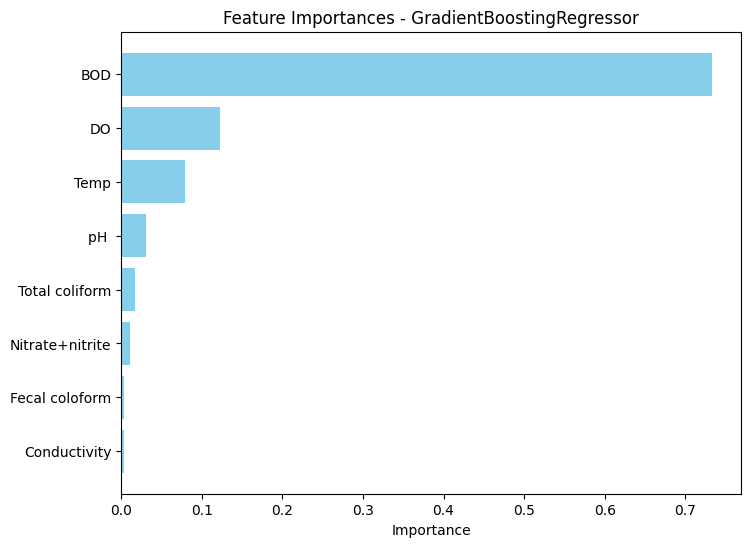

The following metrics are for the model with the best features:
Model: GradientBoostingRegressor
> Mean Absolute Error (MAE): 1.9248644063452511
> Mean Squared Error (MSE): 10.458266892538362
> Root Mean Squared Error (RMSE): 3.2339243795330717
> R2 Score: 0.8225870060268694
> Cross Validation Score (CV): 0.6755870141946997
> Cross Validation Score - neg_mean_absolute_error: 2.4919437977265892
Training LinearRegression model with all features
Model: LinearRegression
> Mean Absolute Error (MAE): 1.5425551275296214
> Mean Squared Error (MSE): 6.835225338484227
> Root Mean Squared Error (RMSE): 2.6144263880408314
> R2 Score: 0.8840479207270294
> Cross Validation Score (CV): 0.8371567500793186
> Cross Validation Score - neg_mean_absolute_error: 1.9982581804617194
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for LinearRegression: ['BOD', 'DO', 'pH ', 'Total coliform']
Selected features from Sequential Feature Selector for Linea

In [38]:
BCWQIReggression_removed = Model(bcwqi_classic_regression, 'Index1', 60, False, 5, True)

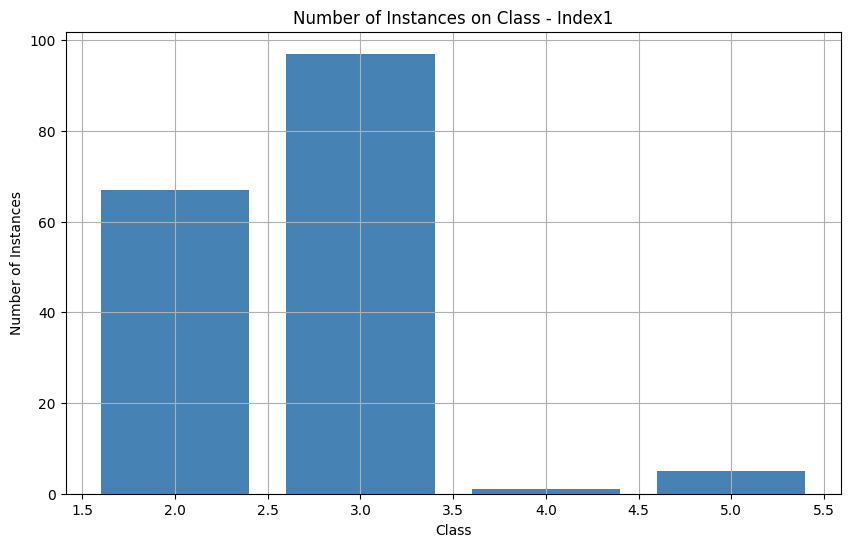

The data has less than 5 instances, so we will duplicate the data.
======================= Before balance without scale =======================
Training DecisionTreeClassifier model with all features
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.7938311688311688
> Recall: 0.9017857142857143
> F1 Score: 0.8266045548654244
> Cross Validation Score (CV): 0.7901587301587301
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'Nitrate+nitrite', 'pH']
Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'Nitrate+nitrite', 'pH', 'Total coliform', 'Conductivity', 'Temp', 'Fecal coloform']
--------------------------------------------------
DecisionTreeClassifier Feature Importances:
           Feature  Importance
4              BOD    0.437969
3               DO    0.359901
1               pH    0.066927
0             Temp    0.

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


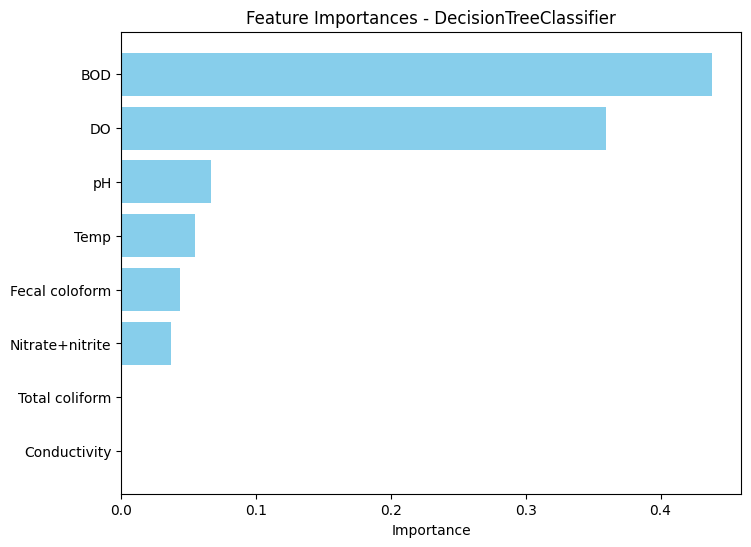

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8888888888888888
> Precision: 0.8284632034632035
> Recall: 0.9345238095238095
> F1 Score: 0.8602484472049688
> Cross Validation Score (CV): 0.8422222222222221
The tree without a max depth:


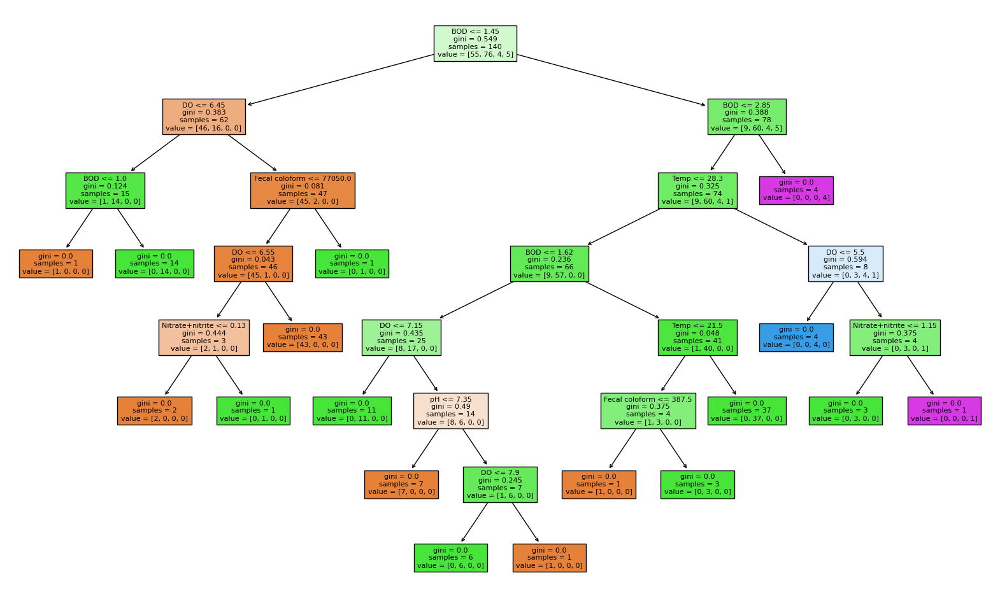

The tree with the best features:


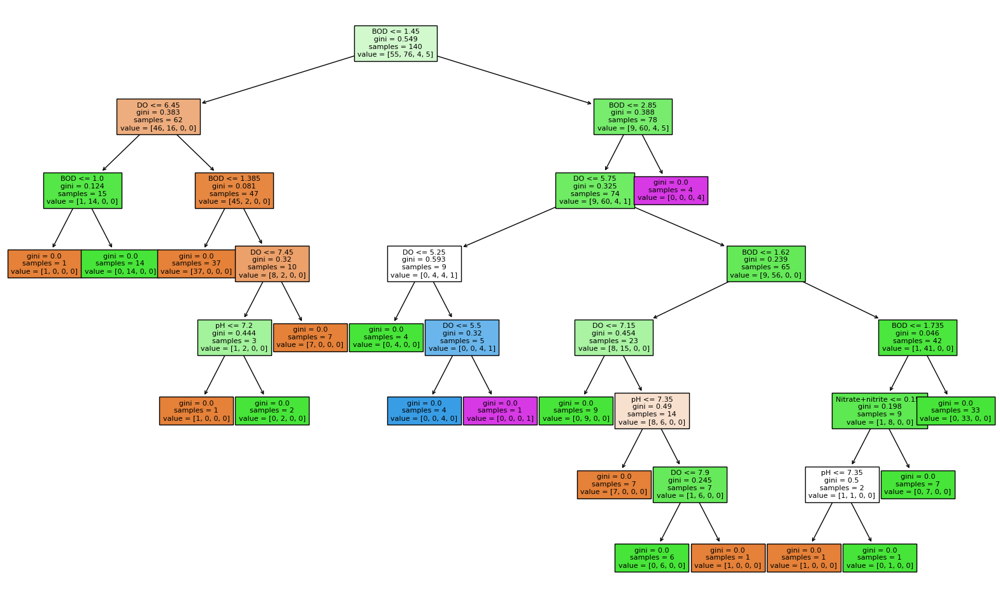

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.803743961352657
> Recall: 0.8928571428571428
> F1 Score: 0.823051948051948
> Cross Validation Score (CV): 0.8184126984126984


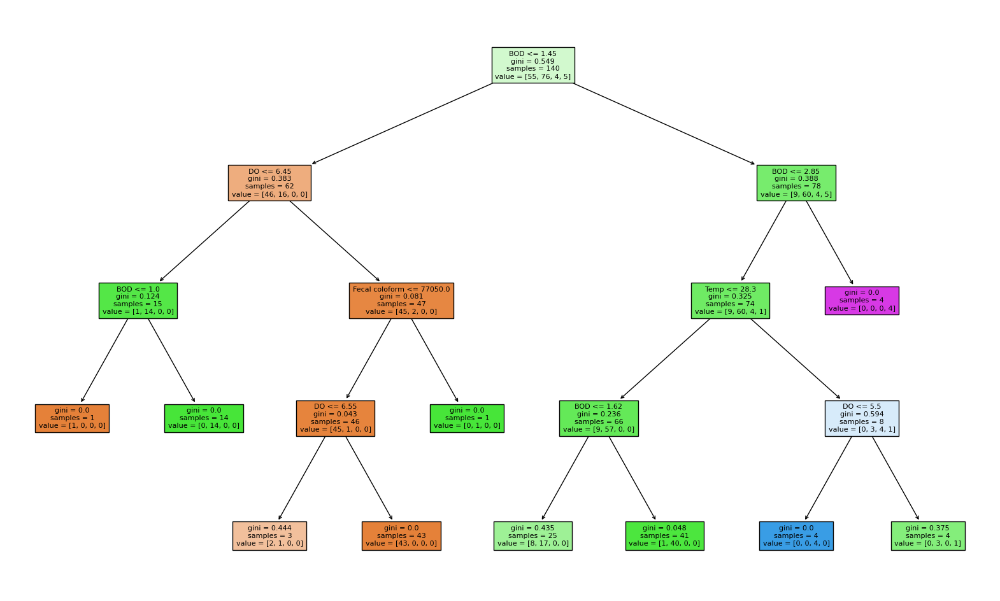

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.8863636363636364
> Recall: 0.8809523809523809
> F1 Score: 0.8832153690596563
> Cross Validation Score (CV): 0.8582539682539683
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity', 'Total coliform', 'Nitrate+nitrite', 'Temp', 'Fecal coloform']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.336863
3               DO    0.169382
7   Total coliform    0.107241
0             Temp    0.096869
2     Conductivity    0.095618
6   Fecal coloform    0.081076
5  Nitrate+nitrite    0.058747
1               pH    0.054205
----------------

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.293187
3               DO    0.174675
7   Total coliform    0.107568
0             Temp    0.102902
6   Fecal coloform    0.099842
2     Conductivity    0.084967
1               pH    0.071657
5  Nitrate+nitrite    0.065202


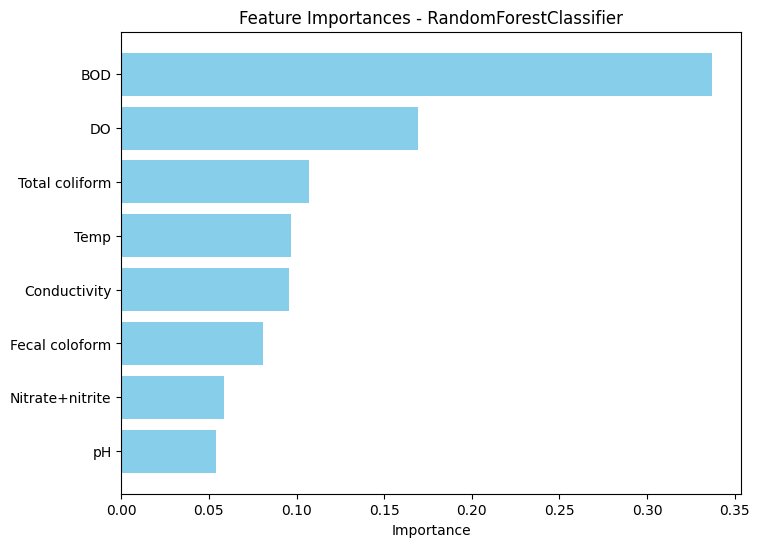

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9166666666666666
> Precision: 0.9545454545454546
> Recall: 0.9464285714285714
> F1 Score: 0.9499494438827099
> Cross Validation Score (CV): 0.8926984126984128
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.7757936507936508
> Recall: 0.8988095238095238
> F1 Score: 0.814102564102564
> Cross Validation Score (CV): 0.8642857142857142
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH', 'Conductivity', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Featur

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.454202
3               DO    0.341675
0             Temp    0.081288
6   Fecal coloform    0.040842
7   Total coliform    0.028062
2     Conductivity    0.021284
1               pH    0.017897
5  Nitrate+nitrite    0.014749


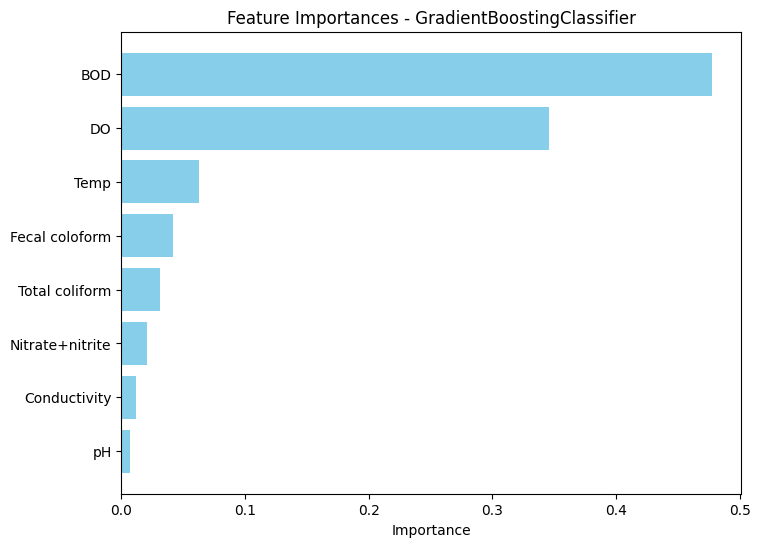

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.7938311688311688
> Recall: 0.9017857142857143
> F1 Score: 0.8266045548654244
> Cross Validation Score (CV): 0.8984126984126984
Training SVC model with all features
Model: SVC
> Accuracy: 0.5833333333333334
> Precision: 0.2734375
> Recall: 0.26785714285714285
> F1 Score: 0.24174528301886794
> Cross Validation Score (CV): 0.6252380952380951


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Nitrate+nitrite', 'Total coliform', 'Temp', 'Conductivity', 'Fecal coloform']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.054433      0.096869    0.062570
1               pH      0.066927      0.054205    0.007167
2     Conductivity      0.000000      0.095618    0.012321
3               DO      0.359901      0.169382    0.345723
4              BOD      0.437969      0.336863    0.477259
5  Nitrate+nitrite      0.036872      0.058747    0.021056
6   Fecal coloform      0.043898      0.081076    0.042232
7   Total coliform      0.000000      0.107241    0.031672
======================== Before balance using scale ========================
Training DecisionTreeClas

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


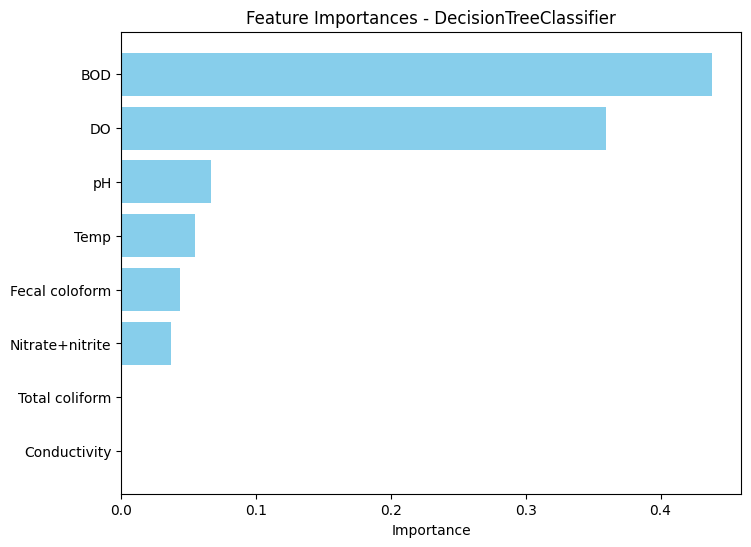

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8611111111111112
> Precision: 0.8083333333333333
> Recall: 0.9226190476190477
> F1 Score: 0.8445121951219512
> Cross Validation Score (CV): 0.8642857142857142
The tree without a max depth:


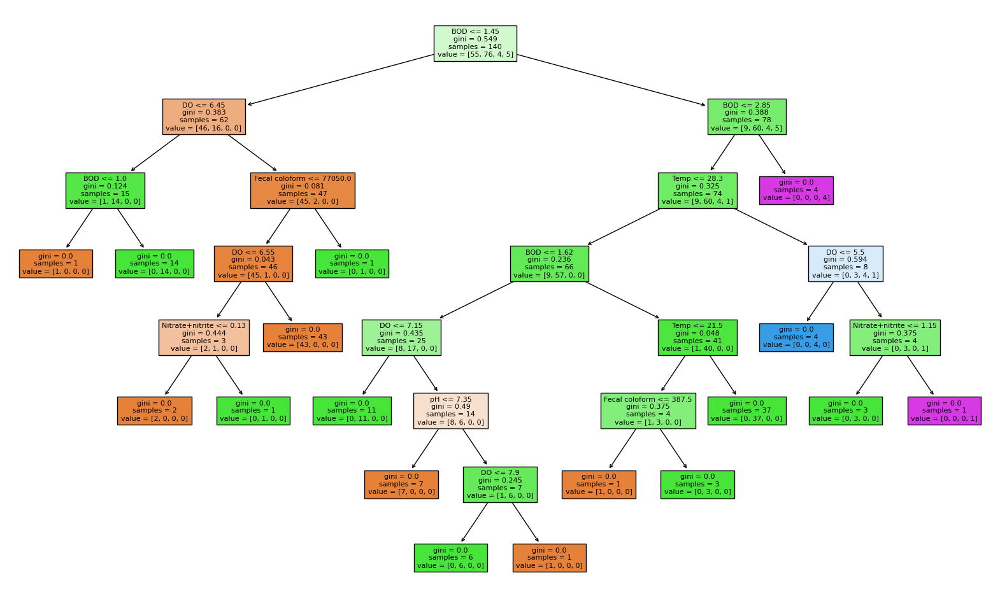

The tree with the best features:


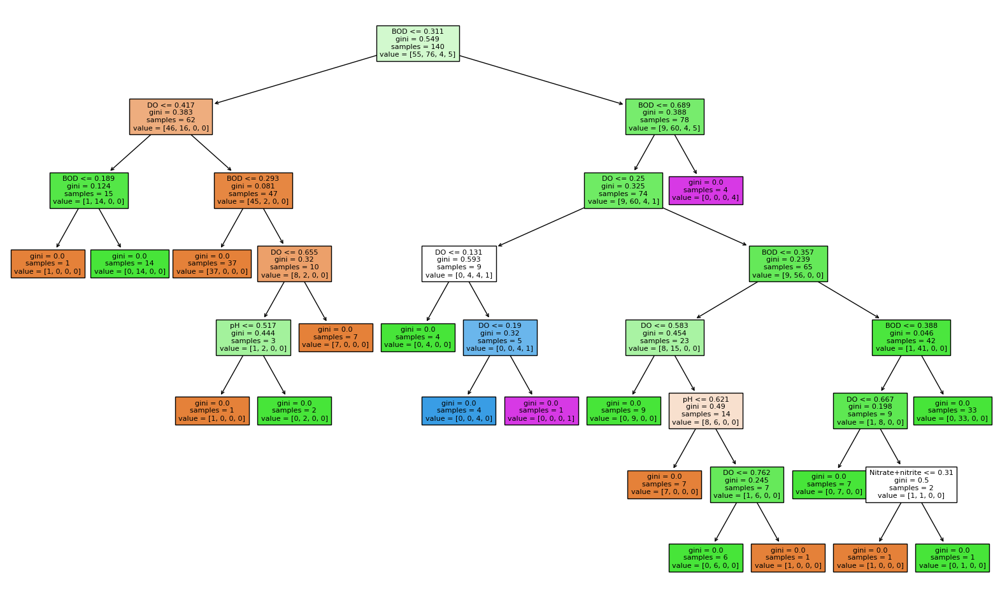

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.803743961352657
> Recall: 0.8928571428571428
> F1 Score: 0.823051948051948
> Cross Validation Score (CV): 0.8184126984126984


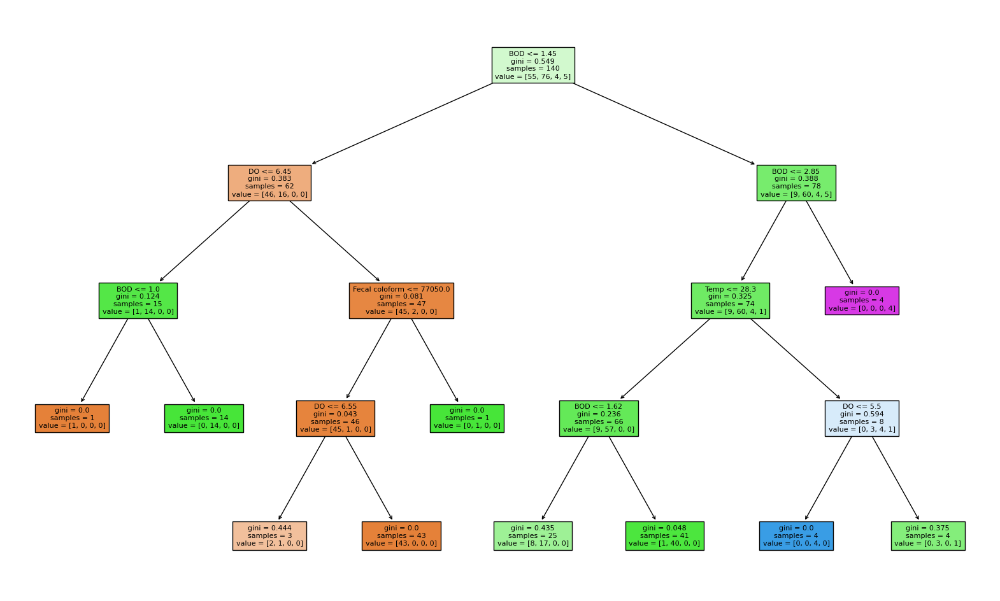

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.8863636363636364
> Recall: 0.8809523809523809
> F1 Score: 0.8832153690596563
> Cross Validation Score (CV): 0.8582539682539683
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity', 'Total coliform', 'Nitrate+nitrite', 'Fecal coloform', 'Temp']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.336863
3               DO    0.169382
7   Total coliform    0.107241
0             Temp    0.096869
2     Conductivity    0.095618
6   Fecal coloform    0.081076
5  Nitrate+nitrite    0.058747
1               pH    0.054205
----------------

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.293187
3               DO    0.174675
7   Total coliform    0.107568
0             Temp    0.102902
6   Fecal coloform    0.099842
2     Conductivity    0.084967
1               pH    0.071657
5  Nitrate+nitrite    0.065202


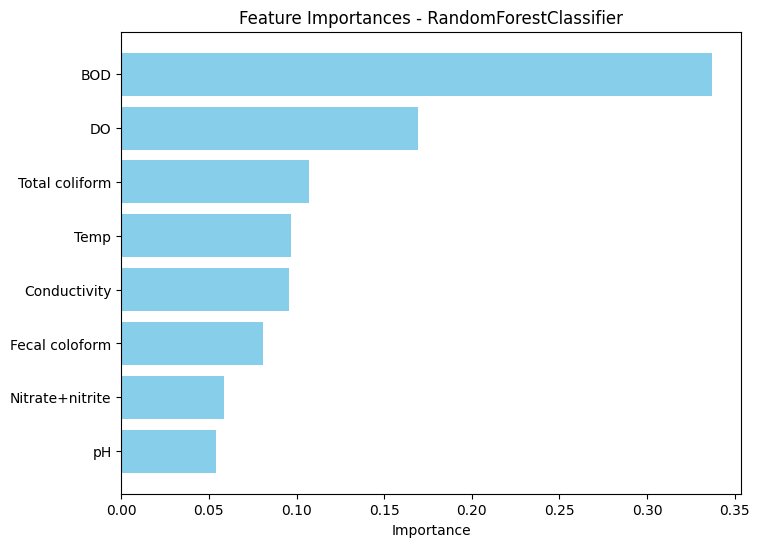

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9166666666666666
> Precision: 0.9545454545454546
> Recall: 0.9464285714285714
> F1 Score: 0.9499494438827099
> Cross Validation Score (CV): 0.886984126984127
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.7757936507936508
> Recall: 0.8988095238095238
> F1 Score: 0.814102564102564
> Cross Validation Score (CV): 0.8642857142857142
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH', 'Conductivity', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.454216
3               DO    0.341708
0             Temp    0.081253
6   Fecal coloform    0.040851
7   Total coliform    0.028068
2     Conductivity    0.021285
1               pH    0.017864
5  Nitrate+nitrite    0.014755


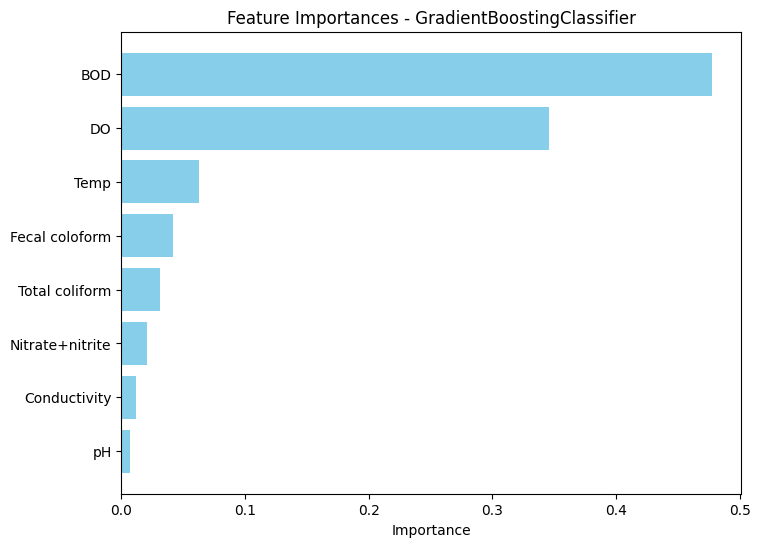

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.7938311688311688
> Recall: 0.9017857142857143
> F1 Score: 0.8266045548654244
> Cross Validation Score (CV): 0.8984126984126984
Training SVC model with all features
Model: SVC
> Accuracy: 0.5833333333333334
> Precision: 0.2734375
> Recall: 0.26785714285714285
> F1 Score: 0.24174528301886794
> Cross Validation Score (CV): 0.6252380952380951


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Nitrate+nitrite', 'Temp', 'Fecal coloform', 'Conductivity', 'Total coliform']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.054433      0.096869    0.062570
1               pH      0.066927      0.054205    0.007167
2     Conductivity      0.000000      0.095618    0.012321
3               DO      0.359901      0.169382    0.345723
4              BOD      0.437969      0.336863    0.477259
5  Nitrate+nitrite      0.036872      0.058747    0.021056
6   Fecal coloform      0.043898      0.081076    0.042232
7   Total coliform      0.000000      0.107241    0.031672
Training DecisionTreeClassifier model with all features
Model: DecisionTreeClassifier
> Accuracy: 0.83

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


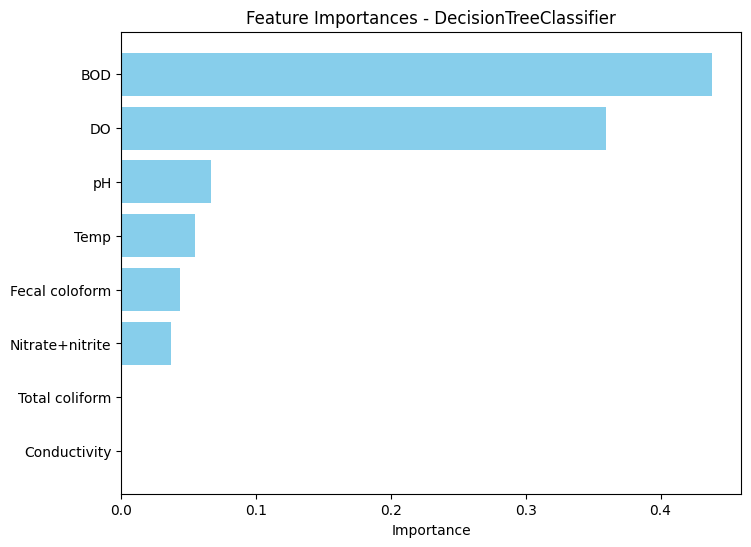

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8611111111111112
> Precision: 0.8083333333333333
> Recall: 0.9226190476190477
> F1 Score: 0.8445121951219512
> Cross Validation Score (CV): 0.8642857142857142
The tree without a max depth:


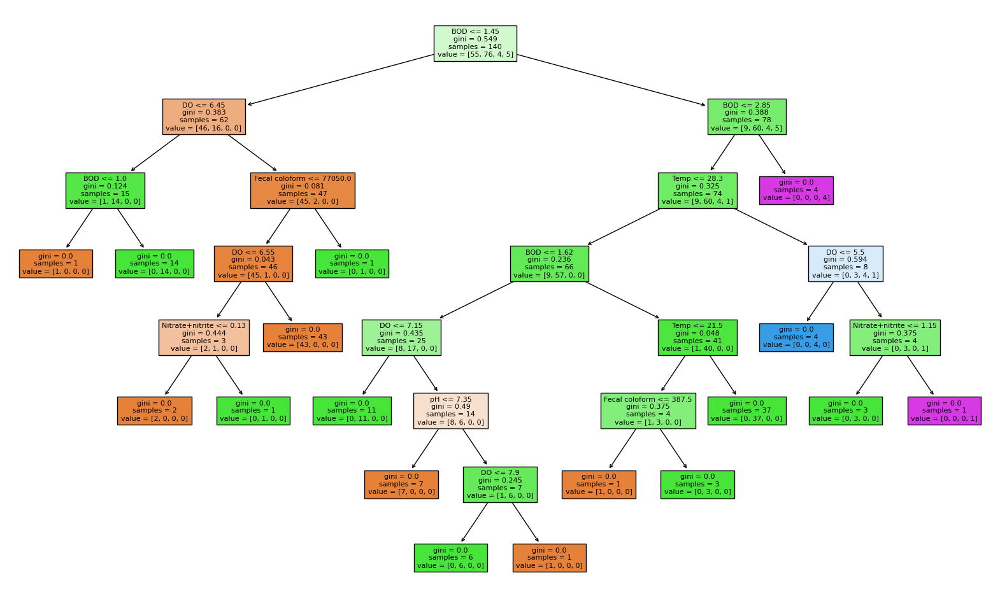

The tree with the best features:


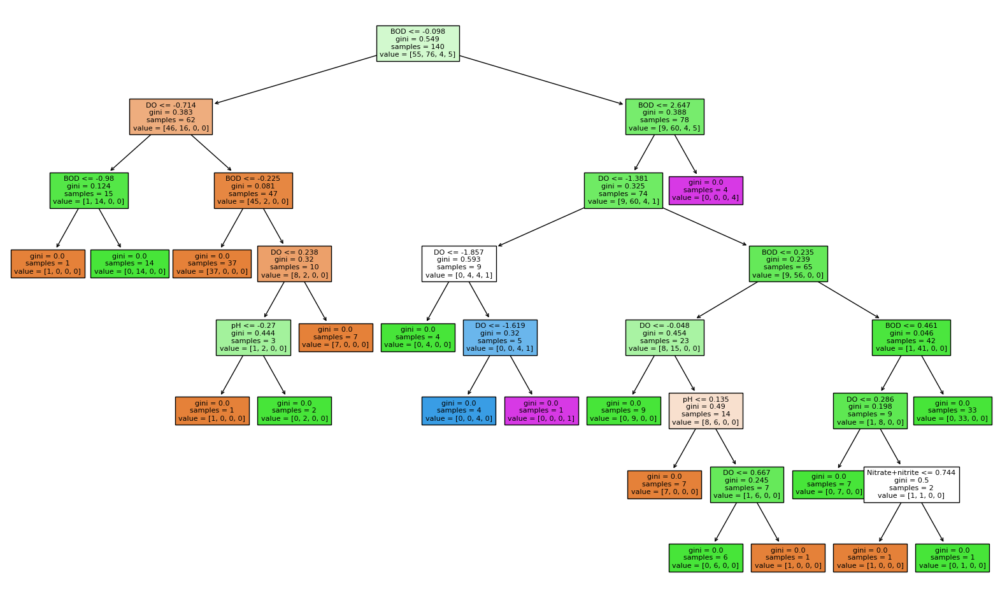

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.803743961352657
> Recall: 0.8928571428571428
> F1 Score: 0.823051948051948
> Cross Validation Score (CV): 0.8184126984126984


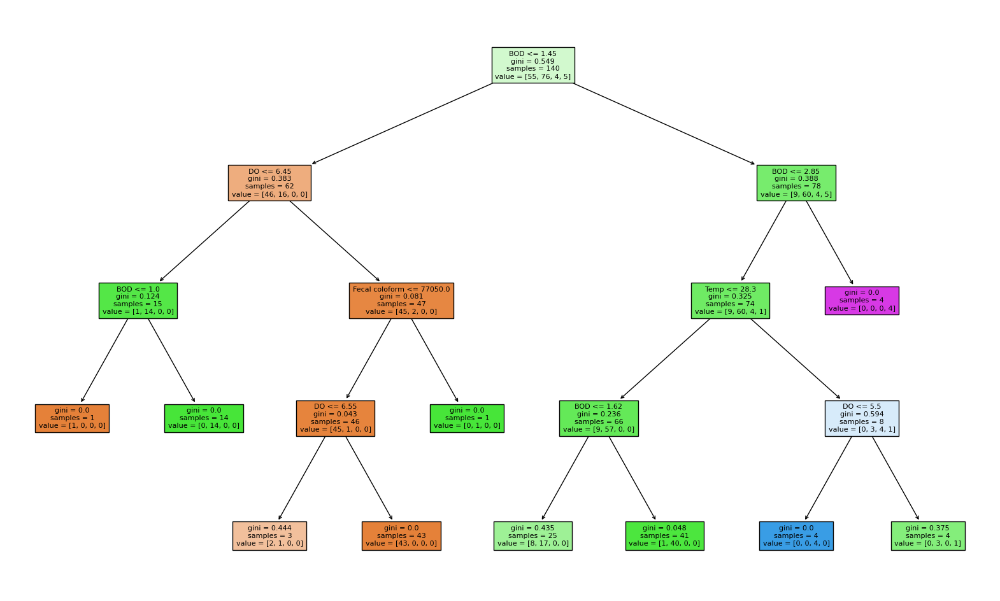

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.8863636363636364
> Recall: 0.8809523809523809
> F1 Score: 0.8832153690596563
> Cross Validation Score (CV): 0.8582539682539683
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity', 'Temp', 'Total coliform', 'Nitrate+nitrite', 'Fecal coloform']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.336863
3               DO    0.169382
7   Total coliform    0.107241
0             Temp    0.096869
2     Conductivity    0.095618
6   Fecal coloform    0.081076
5  Nitrate+nitrite    0.058747
1               pH    0.054205
----------------

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.293187
3               DO    0.174675
7   Total coliform    0.107568
0             Temp    0.102902
6   Fecal coloform    0.099842
2     Conductivity    0.084967
1               pH    0.071657
5  Nitrate+nitrite    0.065202


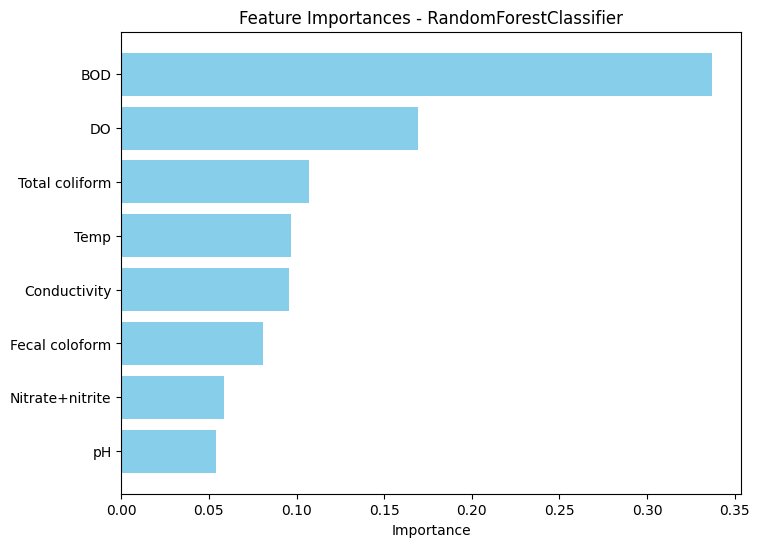

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9166666666666666
> Precision: 0.9545454545454546
> Recall: 0.9464285714285714
> F1 Score: 0.9499494438827099
> Cross Validation Score (CV): 0.886984126984127
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.7757936507936508
> Recall: 0.8988095238095238
> F1 Score: 0.814102564102564
> Cross Validation Score (CV): 0.8642857142857142
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH', 'Conductivity', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.454208
3               DO    0.341680
0             Temp    0.081286
6   Fecal coloform    0.040852
7   Total coliform    0.028074
2     Conductivity    0.021284
1               pH    0.017864
5  Nitrate+nitrite    0.014752


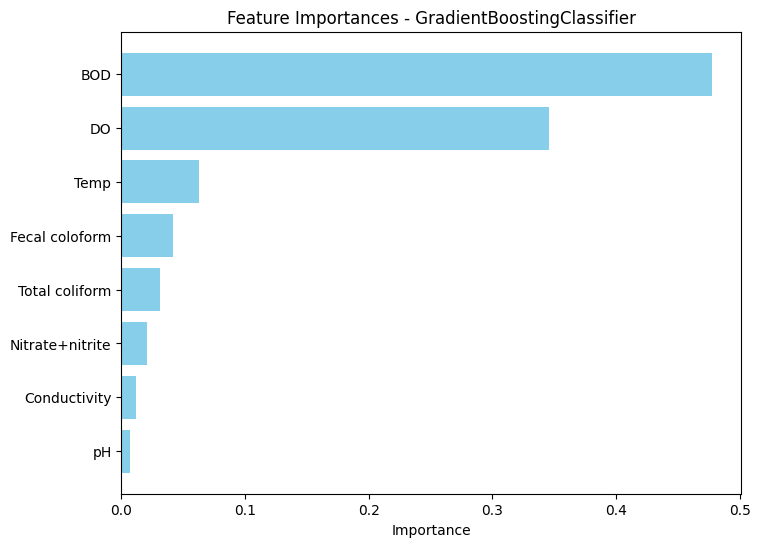

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.7938311688311688
> Recall: 0.9017857142857143
> F1 Score: 0.8266045548654244
> Cross Validation Score (CV): 0.8984126984126984
Training SVC model with all features
Model: SVC
> Accuracy: 0.5833333333333334
> Precision: 0.2734375
> Recall: 0.26785714285714285
> F1 Score: 0.24174528301886794
> Cross Validation Score (CV): 0.6252380952380951
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Temp', 'Nitrate+nitrite', 'Conductivity', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.054433      0.096869    0.062570
1               pH      0.066927      0.0

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Before balance:
Index1
3    97
2    67
5     6
4     6
Name: count, dtype: int64
After balance:
Index1
2    60
3    60
4    60
5    60
Name: count, dtype: int64
Training DecisionTreeClassifier model with all features
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.7938311688311688
> Recall: 0.9017857142857143
> F1 Score: 0.8266045548654244
> Cross Validation Score (CV): 0.7901587301587301
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'Nitrate+nitrite', 'Conductivity']
Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'Nitrate+nitrite', 'Conductivity', 'pH', 'Total coliform', 'Fecal coloform', 'Temp']
--------------------------------------------------
DecisionTreeClassifier Feature Importances:
           Feature  Importance
4              BOD    0.437969
3               DO    0.359901
1               pH    0.0669

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


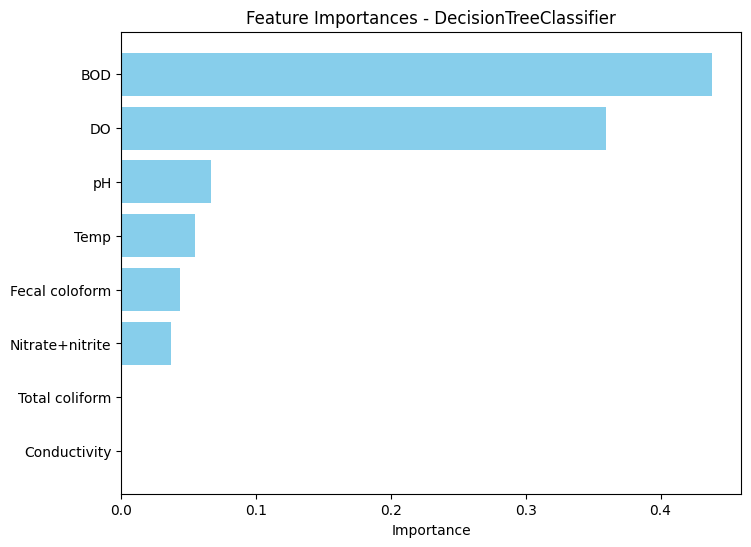

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.9583333333333334
> Precision: 0.9615384615384616
> Recall: 0.9615384615384616
> F1 Score: 0.9583333333333333
> Cross Validation Score (CV): 0.9083333333333334
The tree without a max depth:


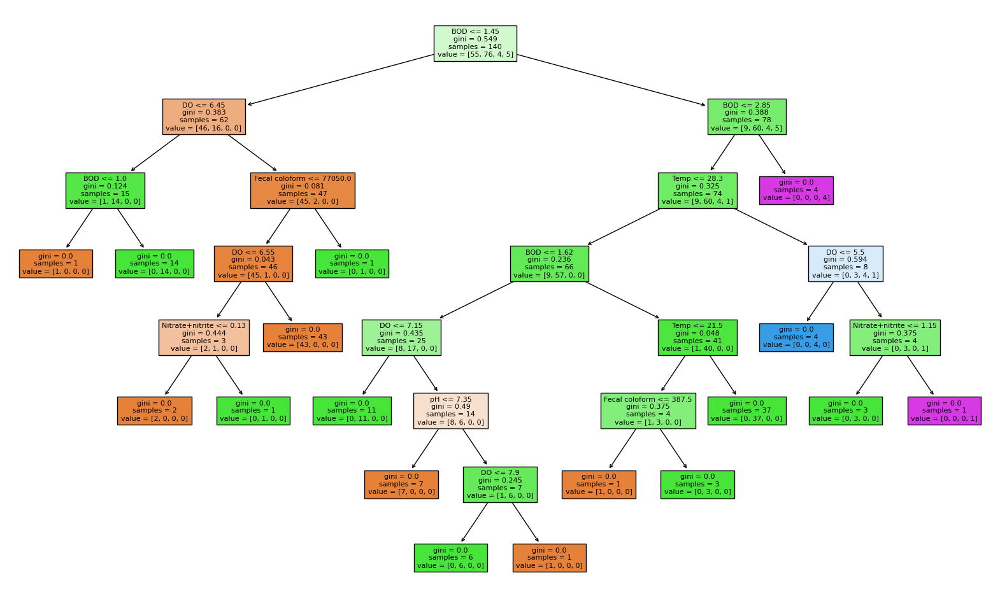

The tree with the best features:


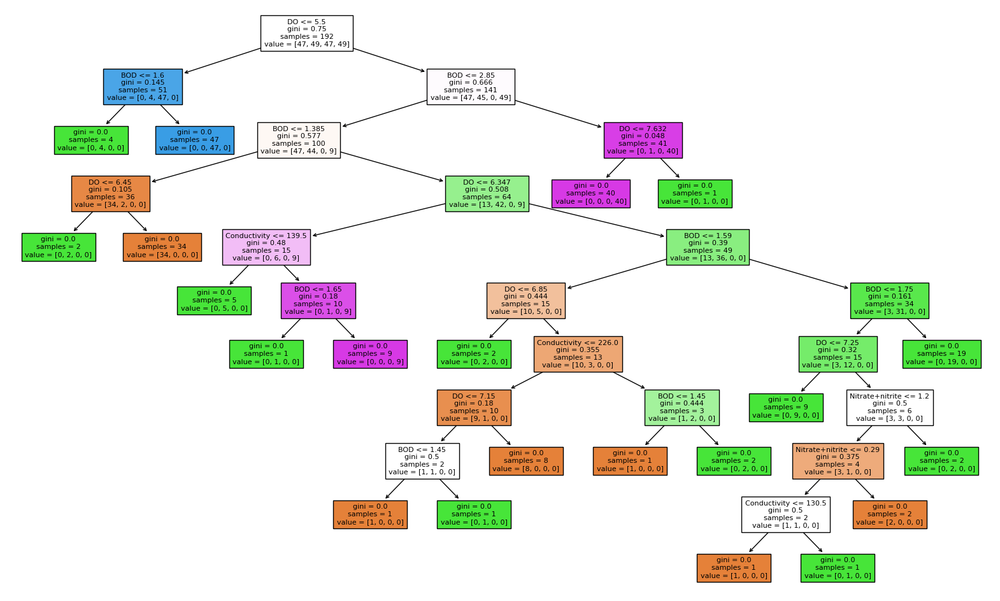

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.803743961352657
> Recall: 0.8928571428571428
> F1 Score: 0.823051948051948
> Cross Validation Score (CV): 0.8184126984126984


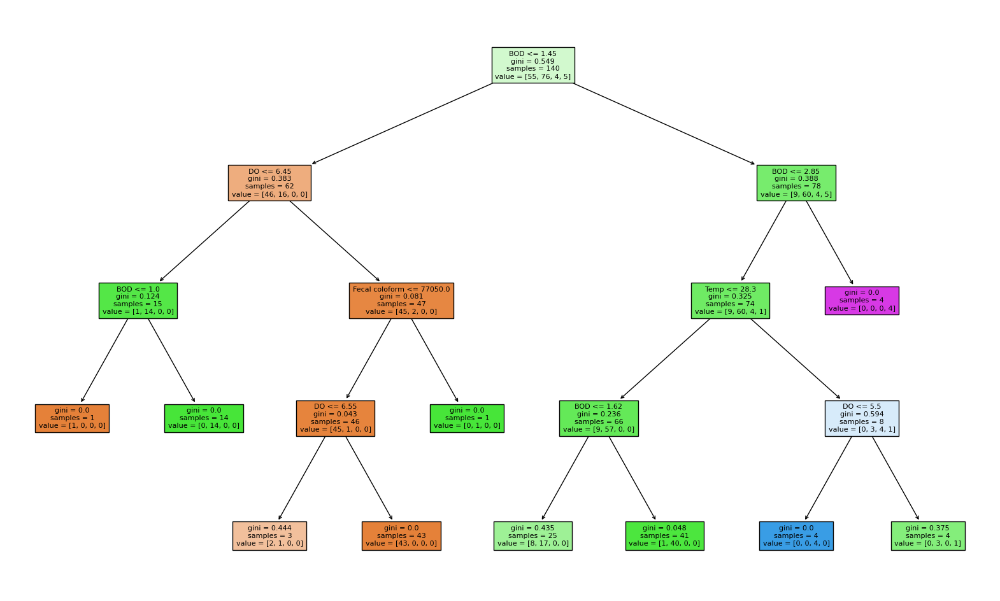

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.8863636363636364
> Recall: 0.8809523809523809
> F1 Score: 0.8832153690596563
> Cross Validation Score (CV): 0.8582539682539683
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'Nitrate+nitrite', 'Fecal coloform']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform', 'pH', 'Conductivity', 'Temp']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.336863
3               DO    0.169382
7   Total coliform    0.107241
0             Temp    0.096869
2     Conductivity    0.095618
6   Fecal coloform    0.081076
5  Nitrate+nitrite    0.058747
1               pH    0.054205
-

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.270856
3               DO    0.186369
0             Temp    0.133619
5  Nitrate+nitrite    0.103886
1               pH    0.092961
7   Total coliform    0.088003
6   Fecal coloform    0.071725
2     Conductivity    0.052580


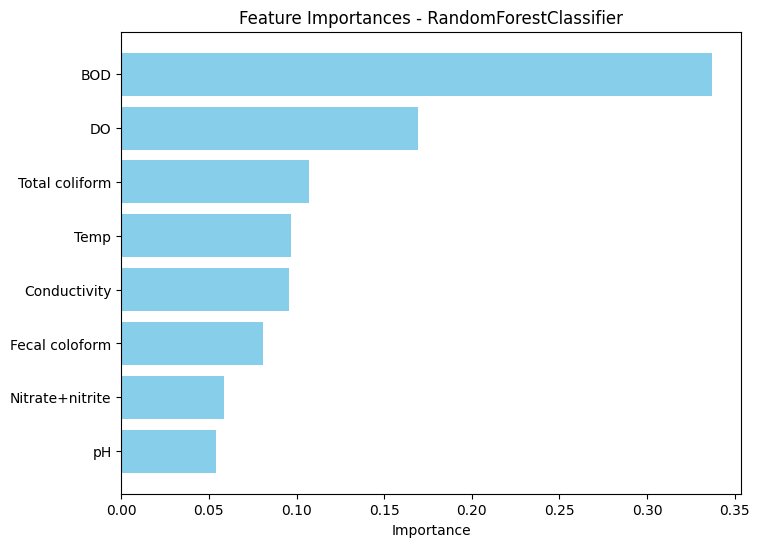

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9166666666666666
> Precision: 0.921474358974359
> Recall: 0.916083916083916
> F1 Score: 0.9164285714285714
> Cross Validation Score (CV): 0.9375
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.7757936507936508
> Recall: 0.8988095238095238
> F1 Score: 0.814102564102564
> Cross Validation Score (CV): 0.8642857142857142
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH', 'Conductivity', 'Total coliform', 'Nitrate+nitrite', 'Fecal coloform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature  Importance


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.451405
3               DO    0.256395
0             Temp    0.116530
7   Total coliform    0.063777
6   Fecal coloform    0.036395
2     Conductivity    0.032972
5  Nitrate+nitrite    0.029240
1               pH    0.013286


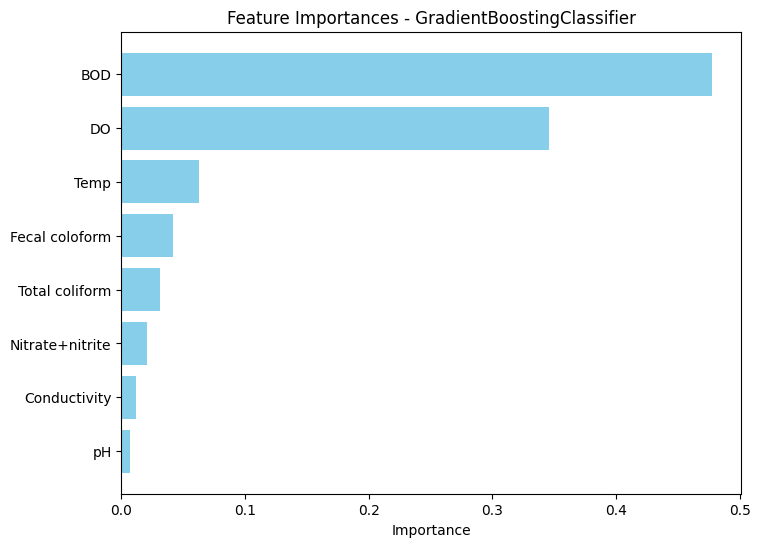

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.9375
> Precision: 0.9436813186813187
> Recall: 0.9388111888111889
> F1 Score: 0.9371693121693121
> Cross Validation Score (CV): 0.9208333333333332
Training SVC model with all features
Model: SVC
> Accuracy: 0.5833333333333334
> Precision: 0.2734375
> Recall: 0.26785714285714285
> F1 Score: 0.24174528301886794
> Cross Validation Score (CV): 0.6252380952380951


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Nitrate+nitrite', 'Temp', 'Total coliform', 'Fecal coloform', 'Conductivity']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.054433      0.096869    0.062570
1               pH      0.066927      0.054205    0.007167
2     Conductivity      0.000000      0.095618    0.012321
3               DO      0.359901      0.169382    0.345723
4              BOD      0.437969      0.336863    0.477259
5  Nitrate+nitrite      0.036872      0.058747    0.021056
6   Fecal coloform      0.043898      0.081076    0.042232
7   Total coliform      0.000000      0.107241    0.031672
========================= After balance using scale =========================
Training DecisionTreeCla

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


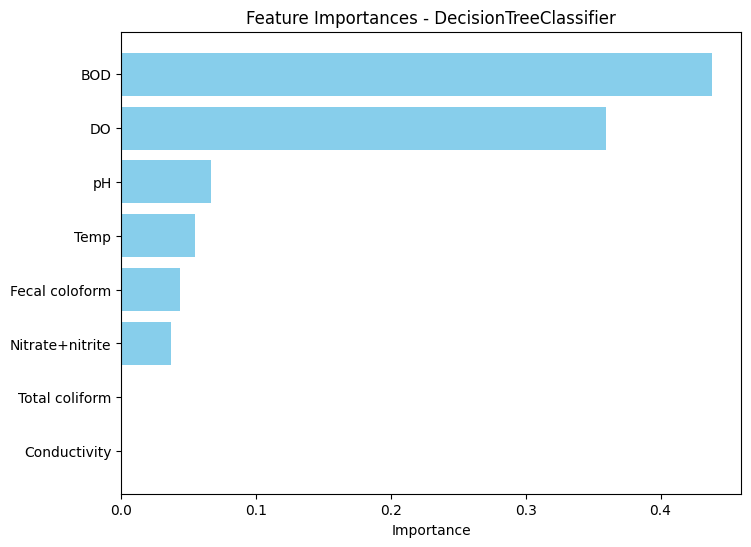

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8958333333333334
> Precision: 0.8990384615384616
> Recall: 0.8933566433566433
> F1 Score: 0.895285873546743
> Cross Validation Score (CV): 0.9125
The tree without a max depth:


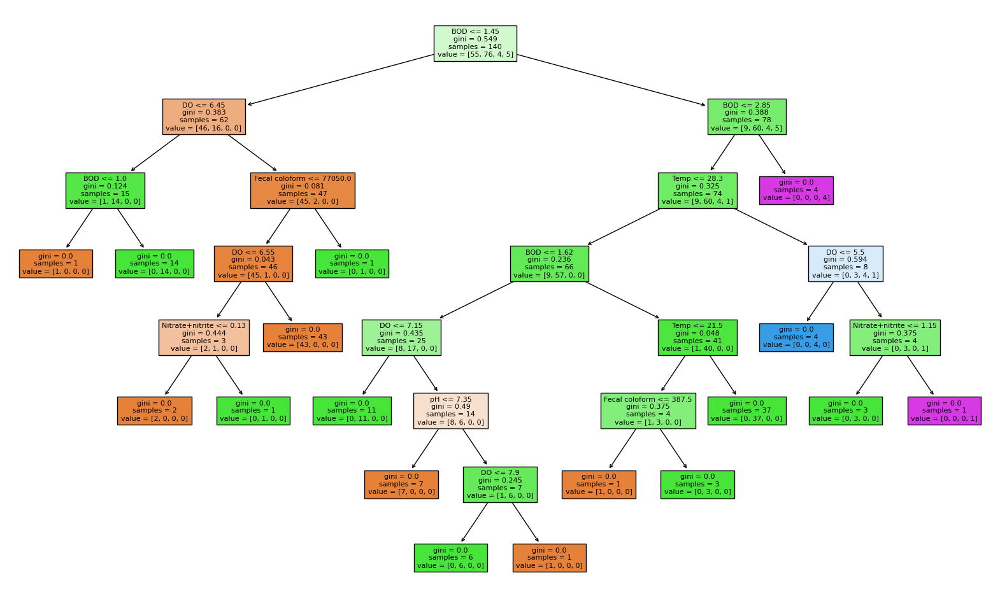

The tree with the best features:


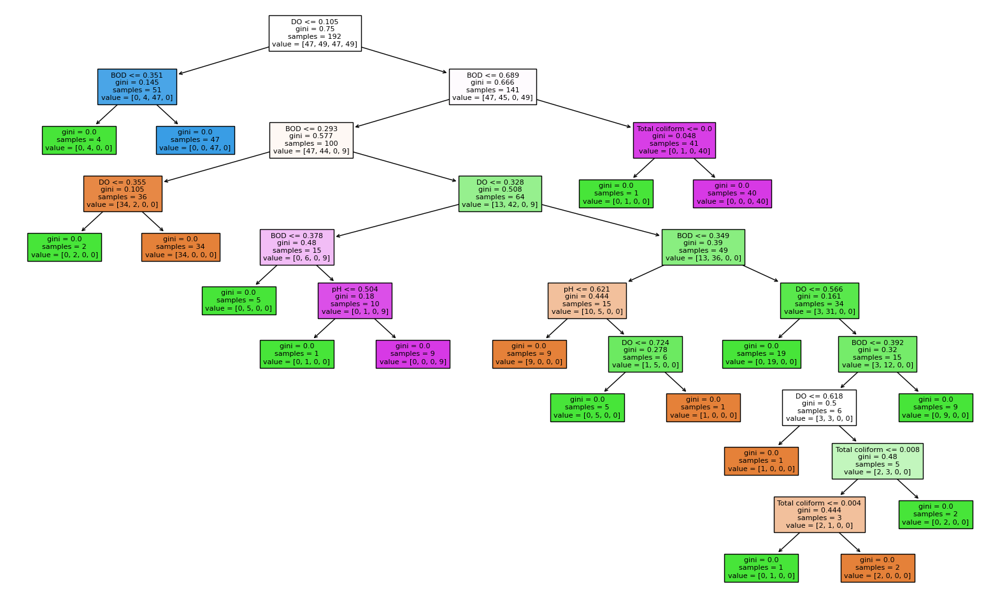

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.803743961352657
> Recall: 0.8928571428571428
> F1 Score: 0.823051948051948
> Cross Validation Score (CV): 0.8184126984126984


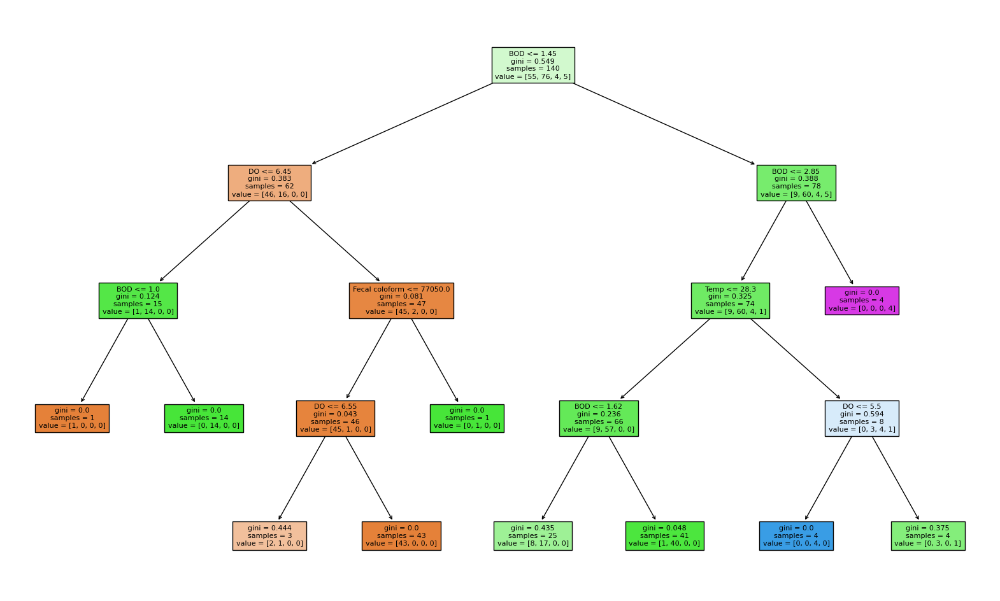

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.8863636363636364
> Recall: 0.8809523809523809
> F1 Score: 0.8832153690596563
> Cross Validation Score (CV): 0.8582539682539683
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Fecal coloform']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Fecal coloform', 'Conductivity', 'Total coliform', 'Temp', 'Nitrate+nitrite']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.336863
3               DO    0.169382
7   Total coliform    0.107241
0             Temp    0.096869
2     Conductivity    0.095618
6   Fecal coloform    0.081076
5  Nitrate+nitrite    0.058747
1               pH    0.054205
--------------

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.270856
3               DO    0.186369
0             Temp    0.133619
5  Nitrate+nitrite    0.103886
1               pH    0.092961
7   Total coliform    0.088003
6   Fecal coloform    0.071725
2     Conductivity    0.052580


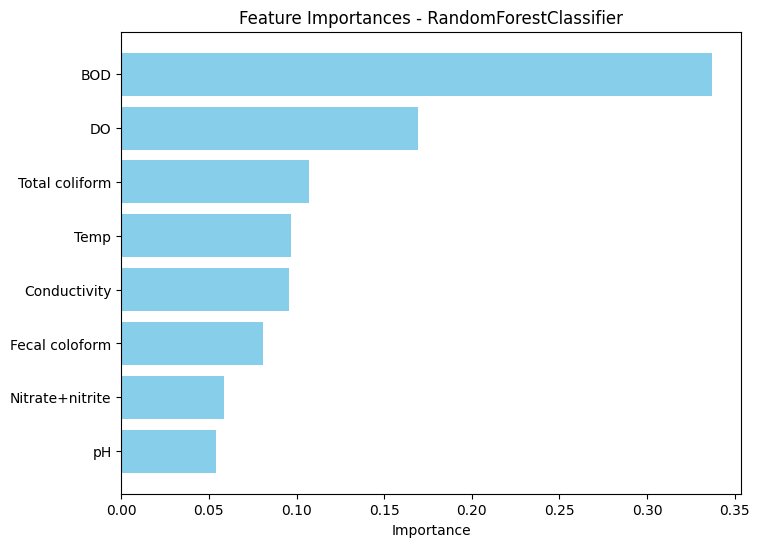

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9583333333333334
> Precision: 0.9615384615384616
> Recall: 0.9615384615384616
> F1 Score: 0.9583333333333333
> Cross Validation Score (CV): 0.9416666666666667
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.7757936507936508
> Recall: 0.8988095238095238
> F1 Score: 0.814102564102564
> Cross Validation Score (CV): 0.8642857142857142
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Conductivity']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Conductivity', 'Temp', 'Total coliform', 'Nitrate+nitrite', 'Fecal coloform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
         

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.451371
3               DO    0.256385
0             Temp    0.116538
7   Total coliform    0.063780
6   Fecal coloform    0.036396
2     Conductivity    0.032970
5  Nitrate+nitrite    0.029229
1               pH    0.013331


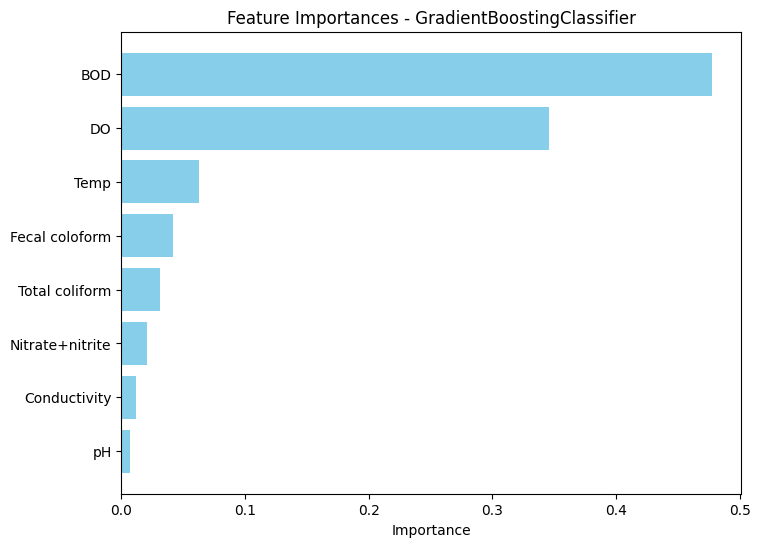

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.9375
> Precision: 0.9464285714285714
> Recall: 0.9388111888111889
> F1 Score: 0.9372619047619049
> Cross Validation Score (CV): 0.925
Training SVC model with all features
Model: SVC
> Accuracy: 0.5833333333333334
> Precision: 0.2734375
> Recall: 0.26785714285714285
> F1 Score: 0.24174528301886794
> Cross Validation Score (CV): 0.6252380952380951


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'Conductivity', 'pH']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'Conductivity', 'pH', 'Temp', 'Nitrate+nitrite', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.054433      0.096869    0.062570
1               pH      0.066927      0.054205    0.007167
2     Conductivity      0.000000      0.095618    0.012321
3               DO      0.359901      0.169382    0.345723
4              BOD      0.437969      0.336863    0.477259
5  Nitrate+nitrite      0.036872      0.058747    0.021056
6   Fecal coloform      0.043898      0.081076    0.042232
7   Total coliform      0.000000      0.107241    0.031672
Training DecisionTreeClassifier model with all features
Model: DecisionTreeClassifier
> Accuracy: 0.83333

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


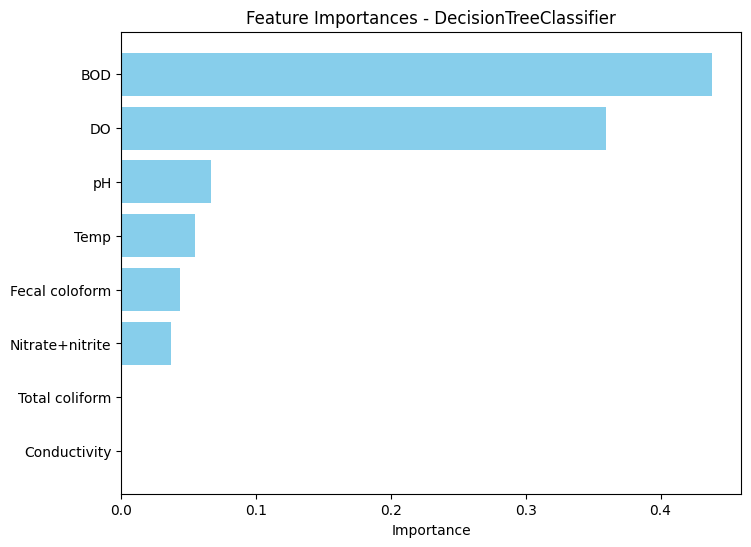

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.9375
> Precision: 0.9375
> Recall: 0.9388111888111887
> F1 Score: 0.937391304347826
> Cross Validation Score (CV): 0.9083333333333334
The tree without a max depth:


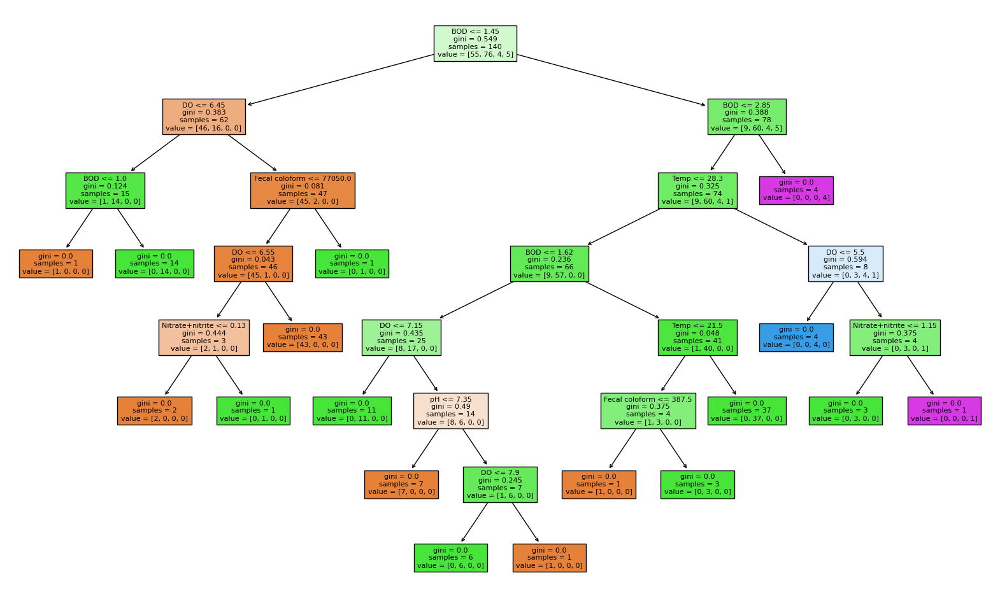

The tree with the best features:


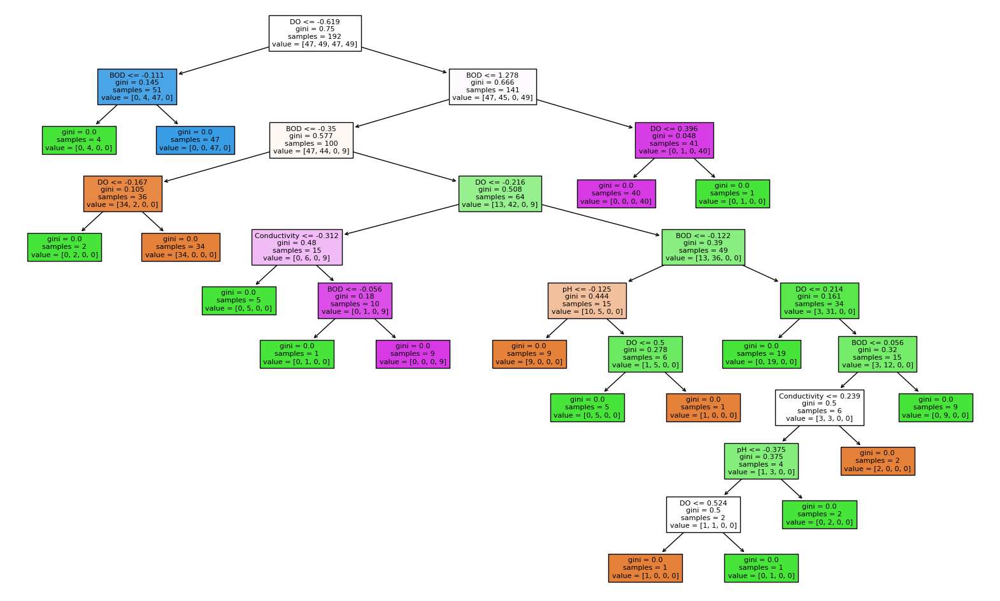

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.803743961352657
> Recall: 0.8928571428571428
> F1 Score: 0.823051948051948
> Cross Validation Score (CV): 0.8184126984126984


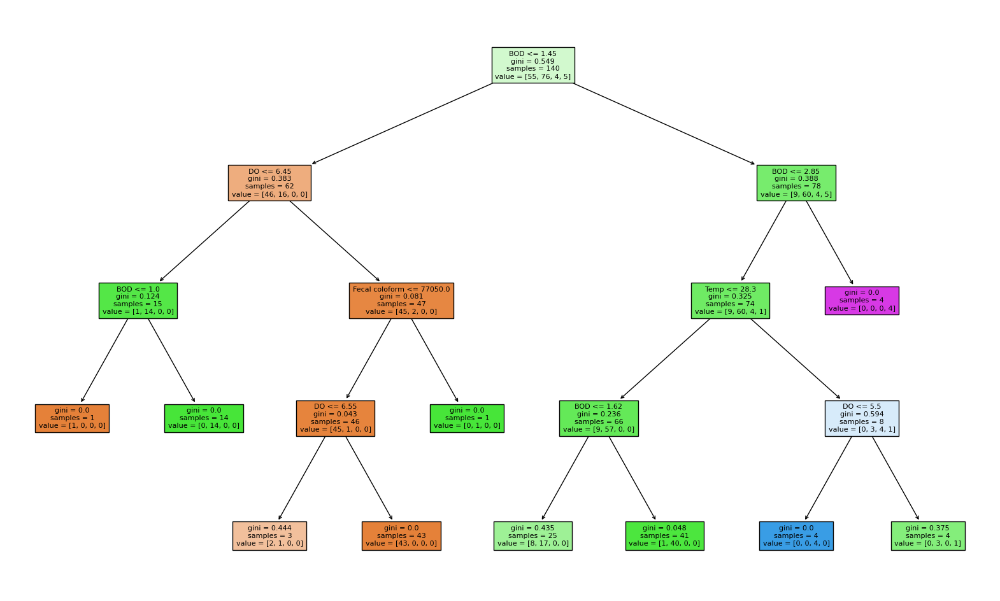

Training RandomForestClassifier model with all features
Model: RandomForestClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.8863636363636364
> Recall: 0.8809523809523809
> F1 Score: 0.8832153690596563
> Cross Validation Score (CV): 0.8582539682539683
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity', 'Nitrate+nitrite', 'Temp', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.336863
3               DO    0.169382
7   Total coliform    0.107241
0             Temp    0.096869
2     Conductivity    0.095618
6   Fecal coloform    0.081076
5  Nitrate+nitrite    0.058747
1               pH    0.054205
----------------

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.270856
3               DO    0.186369
0             Temp    0.133619
5  Nitrate+nitrite    0.103886
1               pH    0.092961
7   Total coliform    0.088003
6   Fecal coloform    0.071725
2     Conductivity    0.052580


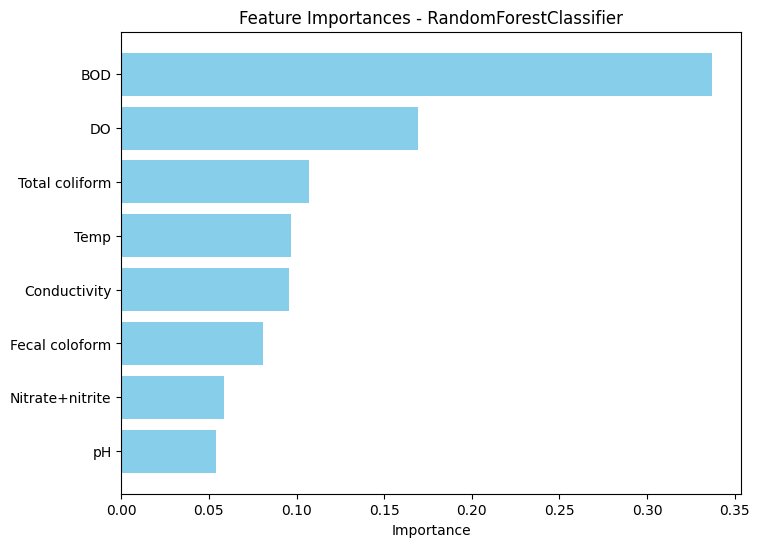

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9583333333333334
> Precision: 0.9615384615384616
> Recall: 0.9615384615384616
> F1 Score: 0.9583333333333333
> Cross Validation Score (CV): 0.95
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8055555555555556
> Precision: 0.7757936507936508
> Recall: 0.8988095238095238
> F1 Score: 0.814102564102564
> Cross Validation Score (CV): 0.8642857142857142
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Conductivity']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Conductivity', 'Temp', 'Total coliform', 'Nitrate+nitrite', 'Fecal coloform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature  Imp

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.451405
3               DO    0.256395
0             Temp    0.116530
7   Total coliform    0.063777
6   Fecal coloform    0.036395
2     Conductivity    0.032972
5  Nitrate+nitrite    0.029240
1               pH    0.013286


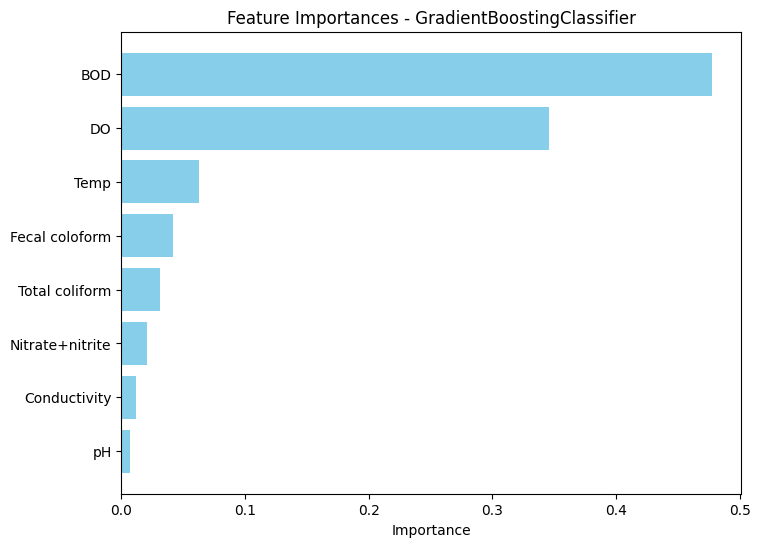

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.9375
> Precision: 0.9464285714285714
> Recall: 0.9388111888111889
> F1 Score: 0.9372619047619049
> Cross Validation Score (CV): 0.925
Training SVC model with all features
Model: SVC
> Accuracy: 0.5833333333333334
> Precision: 0.2734375
> Recall: 0.26785714285714285
> F1 Score: 0.24174528301886794
> Cross Validation Score (CV): 0.6252380952380951


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Temp', 'Conductivity', 'Nitrate+nitrite', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.054433      0.096869    0.062570
1               pH      0.066927      0.054205    0.007167
2     Conductivity      0.000000      0.095618    0.012321
3               DO      0.359901      0.169382    0.345723
4              BOD      0.437969      0.336863    0.477259
5  Nitrate+nitrite      0.036872      0.058747    0.021056
6   Fecal coloform      0.043898      0.081076    0.042232
7   Total coliform      0.000000      0.107241    0.031672
Results without scale
                                       Model  Accuracy  Precision    Recall  \
0       Deci

In [39]:
BCWQIClassification_not_removed = Model(bcwqi_classic_classification, 'Index1', 60, True, 5, False)

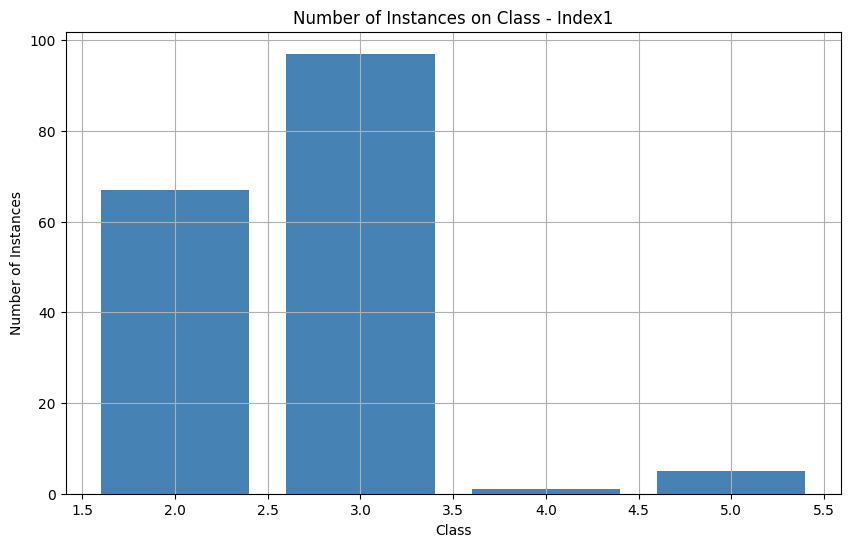

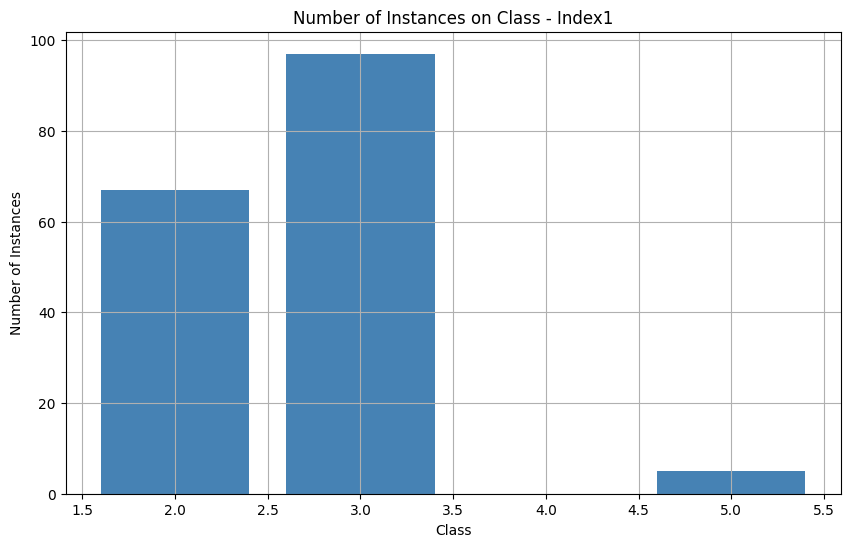

======================= Before balance without scale =======================
Training DecisionTreeClassifier model with all features
Model: DecisionTreeClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.8538011695906432
> Recall: 0.9338624338624338
> F1 Score: 0.8806652806652807
> Cross Validation Score (CV): 0.7862745098039216
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'Nitrate+nitrite', 'pH']
Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'Nitrate+nitrite', 'pH', 'Temp', 'Conductivity', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
DecisionTreeClassifier Feature Importances:
           Feature  Importance
4              BOD    0.502785
3               DO    0.296807
1               pH    0.084255
2     Conductivity    0.035348
0             Temp    0.032469
6   Fecal coloform    0.02624

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


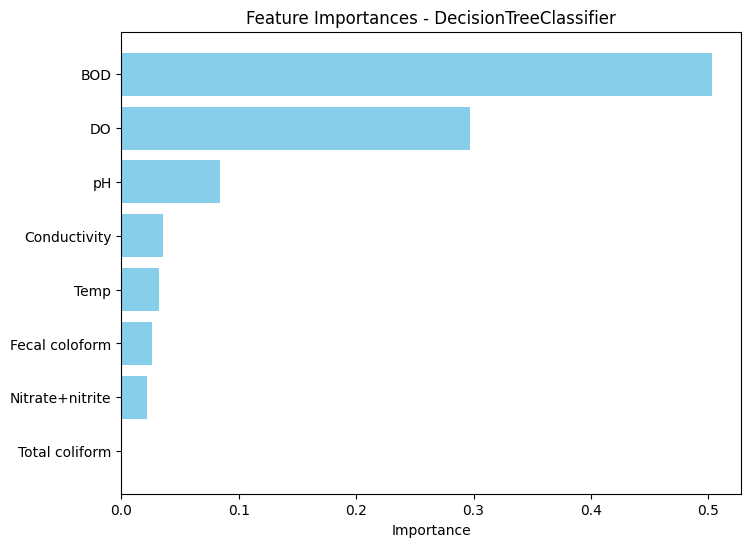

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.8262108262108262
> Recall: 0.9153439153439153
> F1 Score: 0.8592592592592592
> Cross Validation Score (CV): 0.8286987522281638
The tree without a max depth:


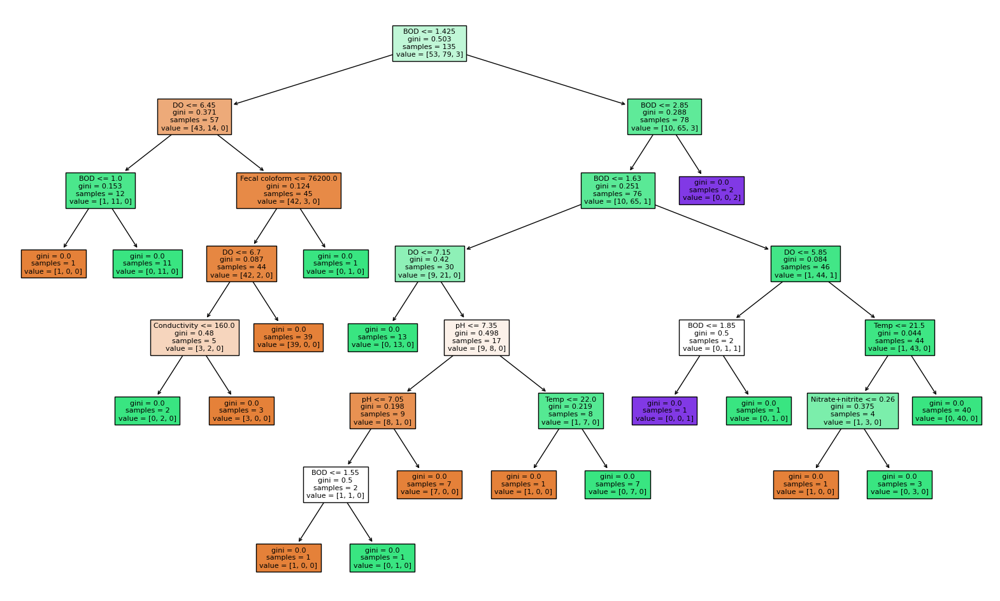

The tree with the best features:


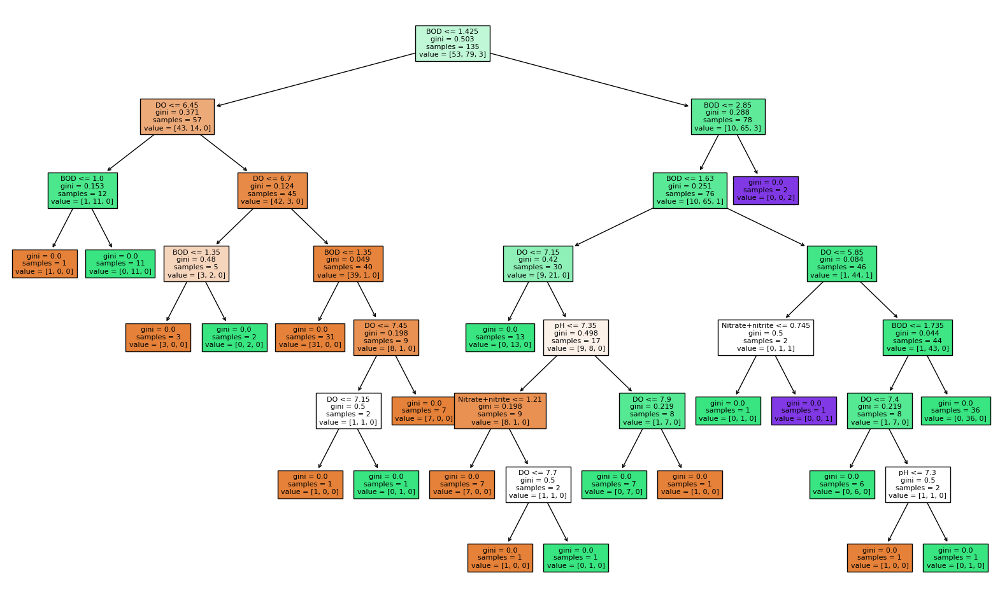

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.8538011695906432
> Recall: 0.9338624338624338
> F1 Score: 0.8806652806652807
> Cross Validation Score (CV): 0.7864527629233512


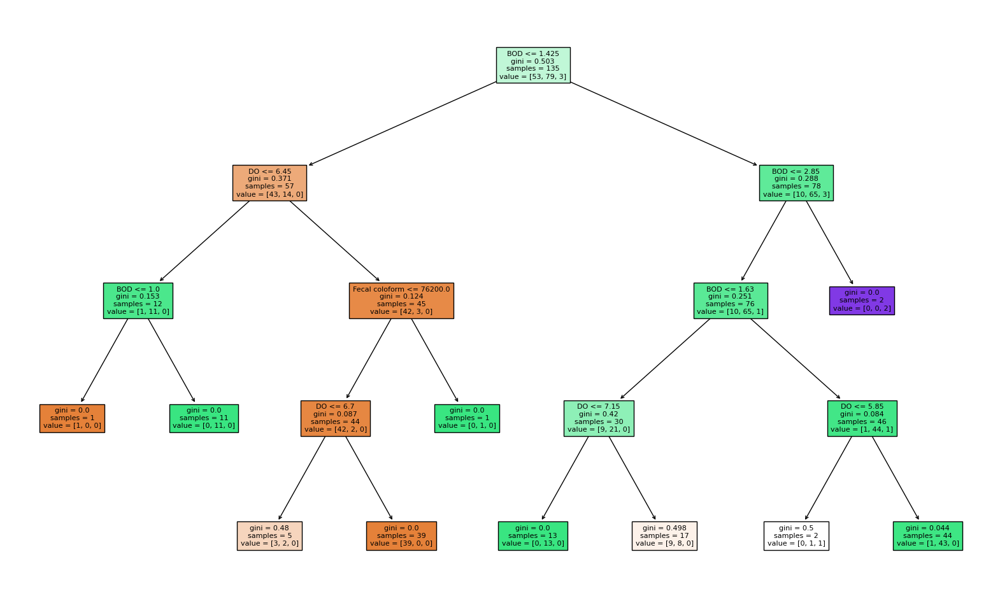

Training RandomForestClassifier model with all features


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: RandomForestClassifier
> Accuracy: 0.8529411764705882
> Precision: 0.5942028985507246
> Recall: 0.5952380952380952
> F1 Score: 0.5860162601626017
> Cross Validation Score (CV): 0.8575757575757574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Total coliform']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Total coliform', 'Nitrate+nitrite', 'Conductivity', 'Temp', 'Fecal coloform']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.353678
3               DO    0.178532
2     Conductivity    0.104728
7   Total coliform    0.088283
6   Fecal coloform    0.085649
0             Temp    0.071471
5  Nitrate+nitrite    0.063552
1               pH    0.054107
--------------------------------------------------


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.318281
3               DO    0.176163
7   Total coliform    0.111283
6   Fecal coloform    0.095822
2     Conductivity    0.088673
0             Temp    0.085764
5  Nitrate+nitrite    0.063260
1               pH    0.060755


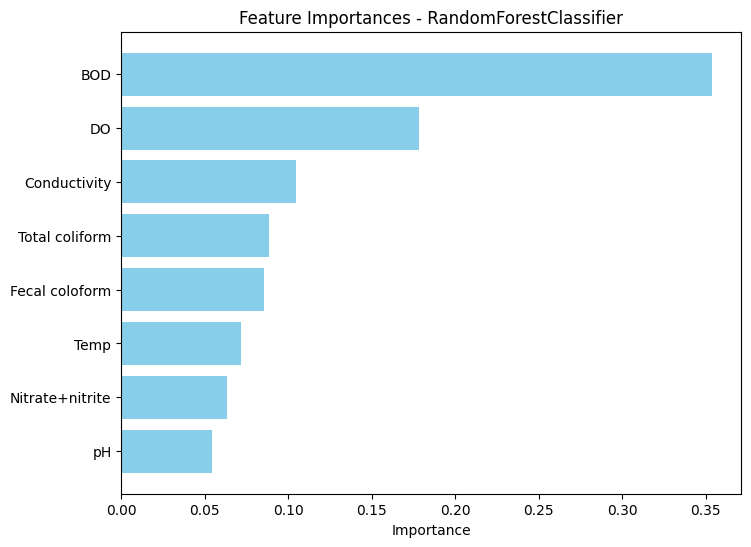

The following metrics are for the model with the best features:


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: RandomForestClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.6060606060606061
> Recall: 0.6190476190476191
> F1 Score: 0.6076923076923076
> Cross Validation Score (CV): 0.8757575757575757
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.8262108262108262
> Recall: 0.9153439153439153
> F1 Score: 0.8592592592592592
> Cross Validation Score (CV): 0.8754010695187165
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Total coliform', 'pH']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Total coliform', 'pH', 'Conductivity', 'Fecal coloform', 'Temp', 'Nitrate+nitrite']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Feature  Importance
4              BOD    0.512099
3       

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.493654
3               DO    0.346872
0             Temp    0.044960
6   Fecal coloform    0.036402
7   Total coliform    0.028648
2     Conductivity    0.019688
5  Nitrate+nitrite    0.017367
1               pH    0.012410


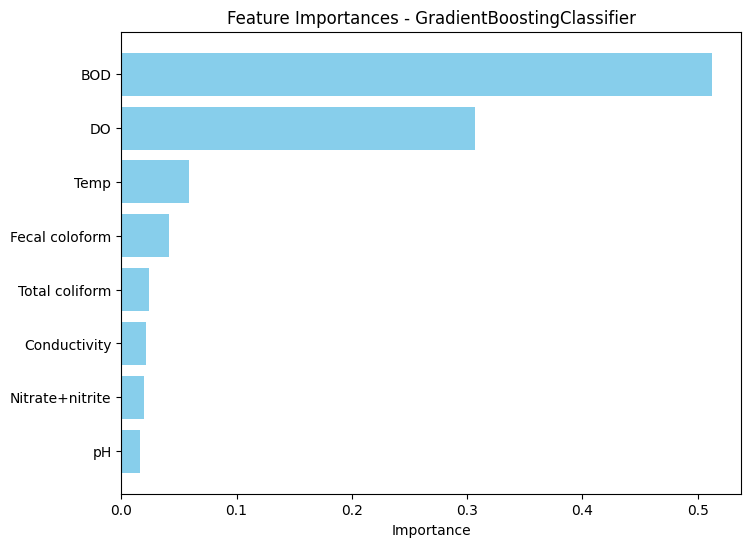

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.7941176470588235
> Precision: 0.707936507936508
> Recall: 0.8597883597883597
> F1 Score: 0.7388167388167388
> Cross Validation Score (CV): 0.8639928698752227
Training SVC model with all features
Model: SVC
> Accuracy: 0.5882352941176471
> Precision: 0.4388888888888889
> Recall: 0.3862433862433862
> F1 Score: 0.34722222222222227
> Cross Validation Score (CV): 0.650445632798574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Nitrate+nitrite', 'Total coliform', 'Fecal coloform', 'Temp', 'Conductivity']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.032469      0.071471    0.058399
1               pH      

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: DecisionTreeClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.8538011695906432
> Recall: 0.9338624338624338
> F1 Score: 0.8806652806652807
> Cross Validation Score (CV): 0.7862745098039216
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'pH', 'Temp', 'Total coliform', 'Conductivity', 'Nitrate+nitrite', 'Fecal coloform']
--------------------------------------------------
DecisionTreeClassifier Feature Importances:
           Feature  Importance
4              BOD    0.502785
3               DO    0.296807
1               pH    0.084255
2     Conductivity    0.035348
0             Temp    0.032469
6   Fecal coloform    0.026243
5  Nitrate+nitrite    0.022093
7   Total coliform    0.000000
--------------------------------------------------
DecisionTreeClassifier Baggin

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


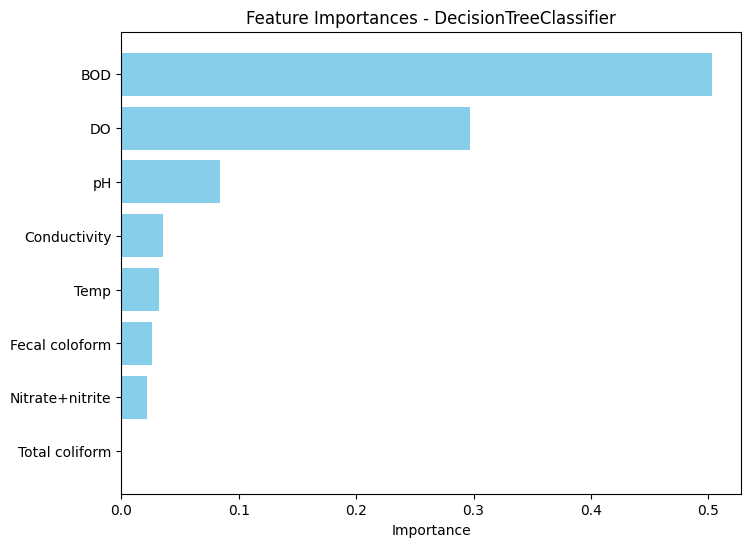

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8529411764705882
> Precision: 0.8020541549953314
> Recall: 0.8968253968253969
> F1 Score: 0.8380952380952381
> Cross Validation Score (CV): 0.8581105169340463
The tree without a max depth:


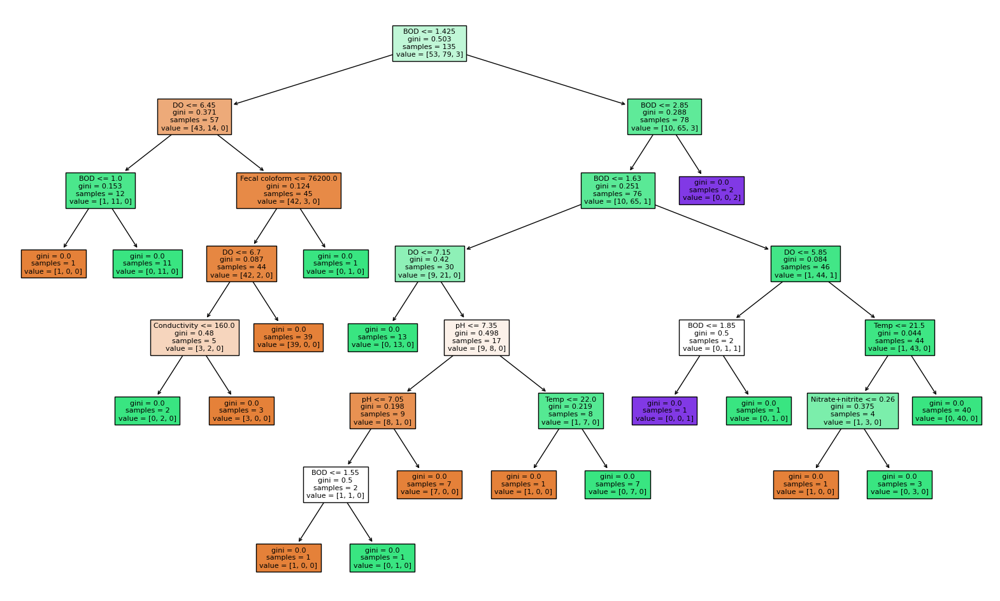

The tree with the best features:


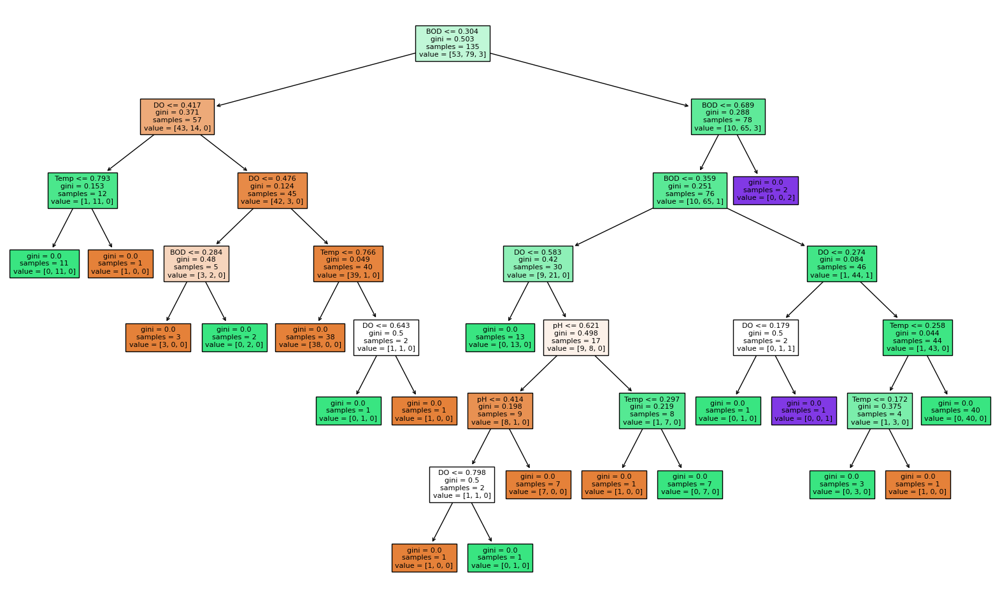

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.8538011695906432
> Recall: 0.9338624338624338
> F1 Score: 0.8806652806652807
> Cross Validation Score (CV): 0.7864527629233512


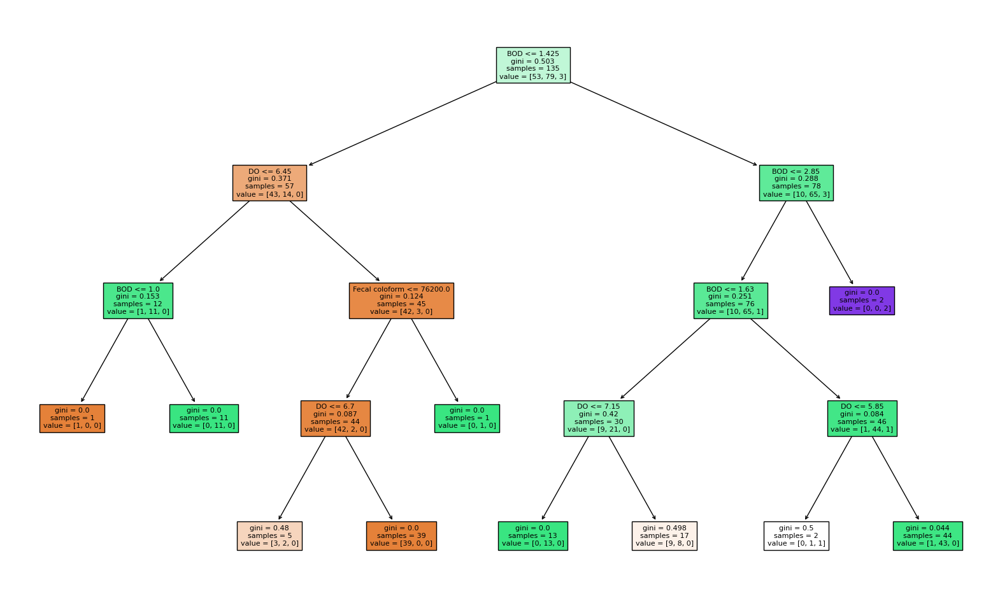

Training RandomForestClassifier model with all features


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: RandomForestClassifier
> Accuracy: 0.8529411764705882
> Precision: 0.5942028985507246
> Recall: 0.5952380952380952
> F1 Score: 0.5860162601626017
> Cross Validation Score (CV): 0.8575757575757574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Temp', 'Fecal coloform', 'Conductivity', 'Total coliform', 'Nitrate+nitrite']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.353678
3               DO    0.178532
2     Conductivity    0.104728
7   Total coliform    0.088283
6   Fecal coloform    0.085649
0             Temp    0.071471
5  Nitrate+nitrite    0.063552
1               pH    0.054107
--------------------------------------------------


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.318281
3               DO    0.176163
7   Total coliform    0.111283
6   Fecal coloform    0.095822
2     Conductivity    0.088673
0             Temp    0.085764
5  Nitrate+nitrite    0.063260
1               pH    0.060755


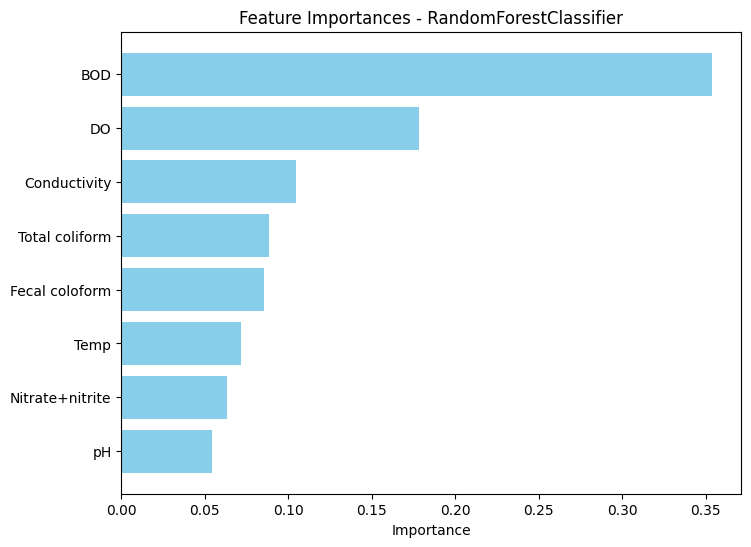

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.9393939393939394
> Recall: 0.7619047619047619
> F1 Score: 0.8155555555555556
> Cross Validation Score (CV): 0.8638146167557933
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.8262108262108262
> Recall: 0.9153439153439153
> F1 Score: 0.8592592592592592
> Cross Validation Score (CV): 0.8754010695187165
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Temp', 'Conductivity', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Featu

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.493666
3               DO    0.346858
0             Temp    0.044922
6   Fecal coloform    0.036378
7   Total coliform    0.028668
2     Conductivity    0.019688
5  Nitrate+nitrite    0.017410
1               pH    0.012409


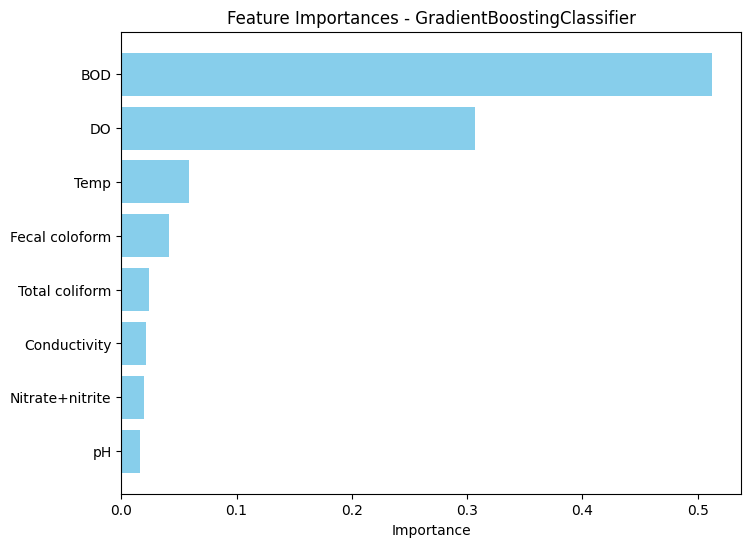

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.7962962962962963
> Recall: 0.9153439153439153
> F1 Score: 0.8262108262108261
> Cross Validation Score (CV): 0.8698752228163993
Training SVC model with all features
Model: SVC
> Accuracy: 0.5882352941176471
> Precision: 0.4388888888888889
> Recall: 0.3862433862433862
> F1 Score: 0.34722222222222227
> Cross Validation Score (CV): 0.650445632798574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Total coliform']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Total coliform', 'Fecal coloform', 'Nitrate+nitrite', 'Conductivity', 'Temp']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.032469      0.071471    0.058399
1               pH      

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'pH', 'Temp', 'Total coliform', 'Fecal coloform', 'Nitrate+nitrite', 'Conductivity']
--------------------------------------------------
DecisionTreeClassifier Feature Importances:
           Feature  Importance
4              BOD    0.502785
3               DO    0.296807
1               pH    0.084255
2     Conductivity    0.035348
0             Temp    0.032469
6   Fecal coloform    0.026243
5  Nitrate+nitrite    0.022093
7   Total coliform    0.000000
--------------------------------------------------
DecisionTreeClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.471171
3               DO    0.346609
0             Temp    0.057370
6   Fecal coloform    0.033714
1               pH    0.0

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


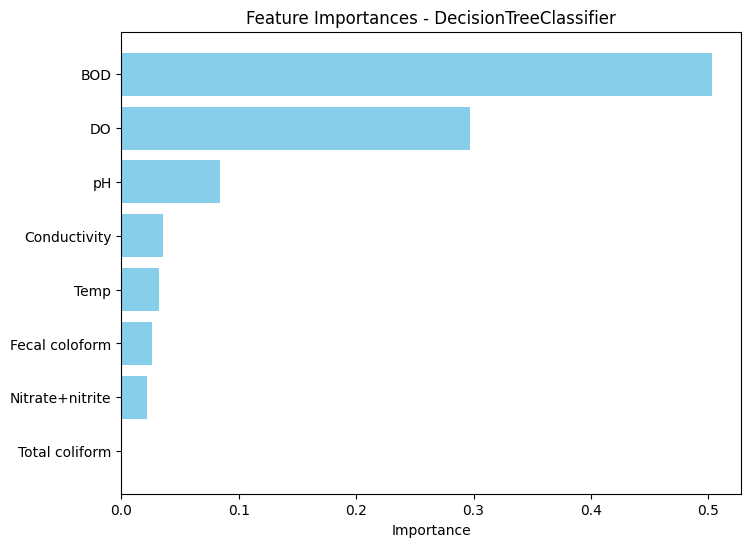

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8529411764705882
> Precision: 0.8020541549953314
> Recall: 0.8968253968253969
> F1 Score: 0.8380952380952381
> Cross Validation Score (CV): 0.8520499108734402
The tree without a max depth:


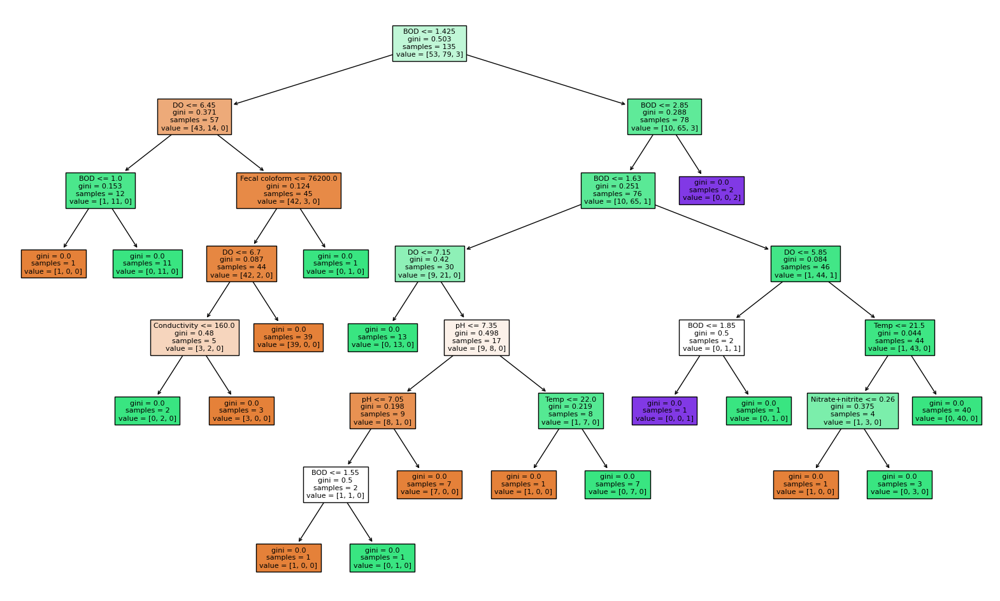

The tree with the best features:


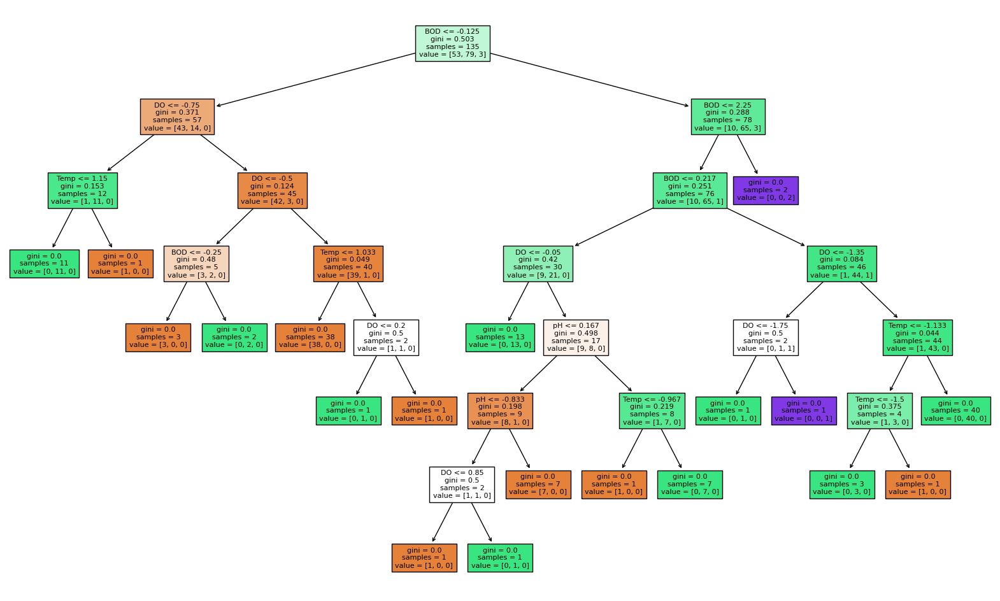

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.8538011695906432
> Recall: 0.9338624338624338
> F1 Score: 0.8806652806652807
> Cross Validation Score (CV): 0.7864527629233512


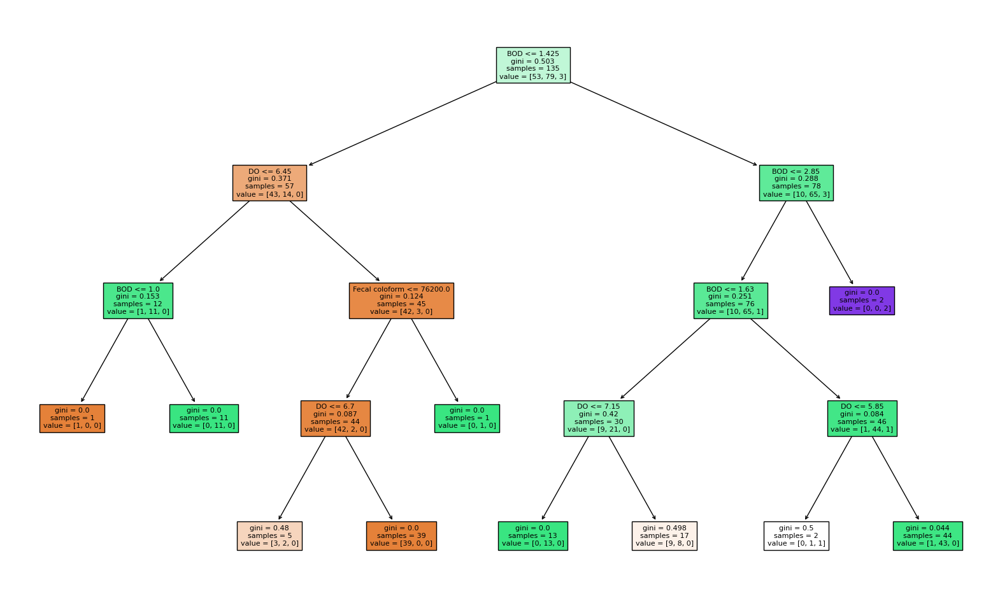

Training RandomForestClassifier model with all features


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: RandomForestClassifier
> Accuracy: 0.8529411764705882
> Precision: 0.5942028985507246
> Recall: 0.5952380952380952
> F1 Score: 0.5860162601626017
> Cross Validation Score (CV): 0.8575757575757574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Temp', 'Conductivity', 'Total coliform', 'Nitrate+nitrite', 'Fecal coloform']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.353678
3               DO    0.178532
2     Conductivity    0.104728
7   Total coliform    0.088283
6   Fecal coloform    0.085649
0             Temp    0.071471
5  Nitrate+nitrite    0.063552
1               pH    0.054107
--------------------------------------------------


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.318281
3               DO    0.176163
7   Total coliform    0.111283
6   Fecal coloform    0.095822
2     Conductivity    0.088673
0             Temp    0.085764
5  Nitrate+nitrite    0.063260
1               pH    0.060755


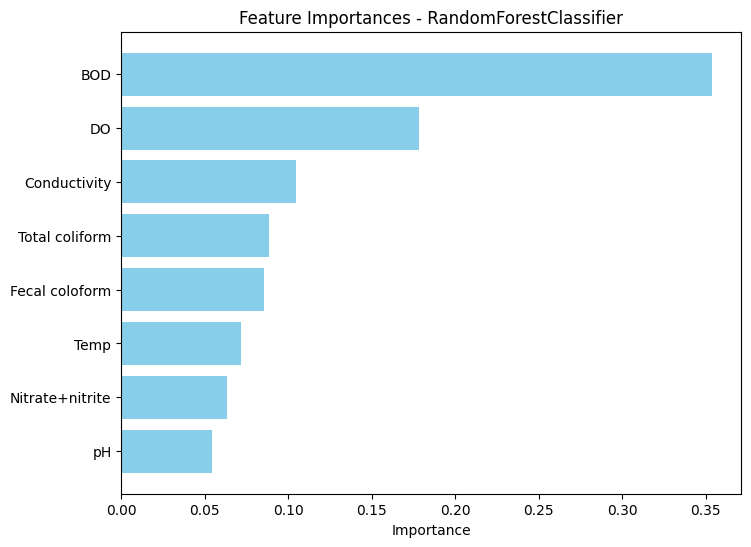

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.9523809523809524
> Recall: 0.7857142857142857
> F1 Score: 0.8376068376068376
> Cross Validation Score (CV): 0.8638146167557933
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.8262108262108262
> Recall: 0.9153439153439153
> F1 Score: 0.8592592592592592
> Cross Validation Score (CV): 0.8754010695187165
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Temp', 'Conductivity', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Featu

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.493620
3               DO    0.346998
0             Temp    0.044915
6   Fecal coloform    0.036284
7   Total coliform    0.028645
2     Conductivity    0.019687
5  Nitrate+nitrite    0.017409
1               pH    0.012442


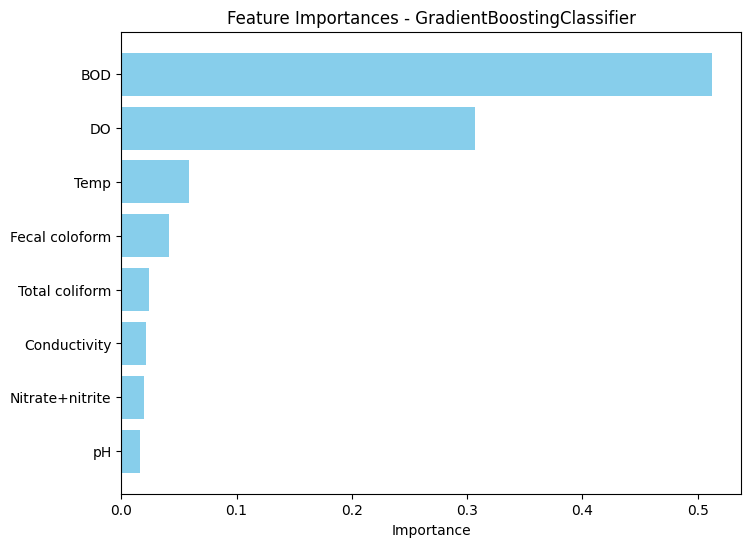

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.7962962962962963
> Recall: 0.9153439153439153
> F1 Score: 0.8262108262108261
> Cross Validation Score (CV): 0.8698752228163993
Training SVC model with all features
Model: SVC
> Accuracy: 0.5882352941176471
> Precision: 0.4388888888888889
> Recall: 0.3862433862433862
> F1 Score: 0.34722222222222227
> Cross Validation Score (CV): 0.650445632798574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Temp', 'Nitrate+nitrite', 'Total coliform', 'Conductivity', 'Fecal coloform']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.032469      0.071471    0.058399
1               pH      0.084255  

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: DecisionTreeClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.8538011695906432
> Recall: 0.9338624338624338
> F1 Score: 0.8806652806652807
> Cross Validation Score (CV): 0.7862745098039216
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'pH', 'Temp', 'Fecal coloform', 'Nitrate+nitrite', 'Total coliform', 'Conductivity']
--------------------------------------------------
DecisionTreeClassifier Feature Importances:
           Feature  Importance
4              BOD    0.502785
3               DO    0.296807
1               pH    0.084255
2     Conductivity    0.035348
0             Temp    0.032469
6   Fecal coloform    0.026243
5  Nitrate+nitrite    0.022093
7   Total coliform    0.000000
--------------------------------------------------
DecisionTreeClassifier Baggin

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


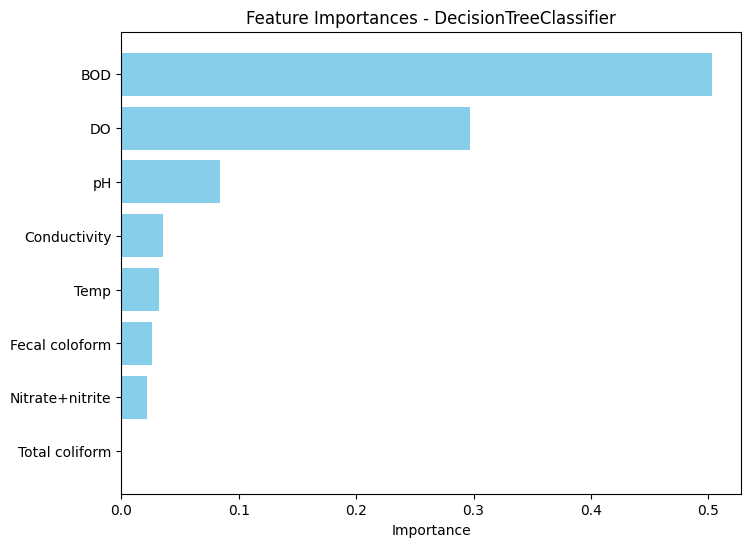

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8611111111111112
> Precision: 0.8690476190476191
> Recall: 0.8624708624708625
> F1 Score: 0.8584169453734671
> Cross Validation Score (CV): 0.8722222222222221
The tree without a max depth:


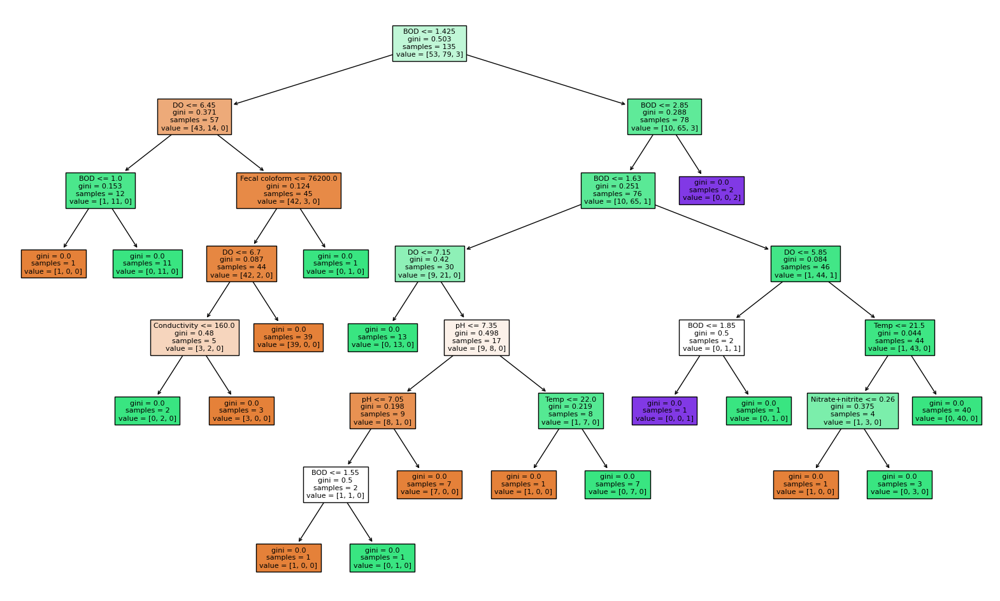

The tree with the best features:


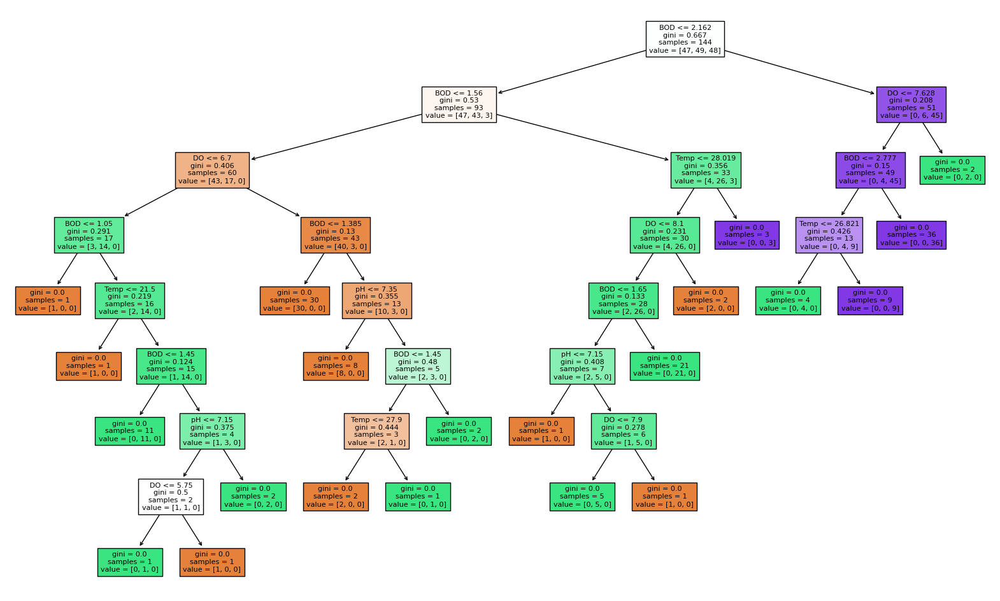

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.8538011695906432
> Recall: 0.9338624338624338
> F1 Score: 0.8806652806652807
> Cross Validation Score (CV): 0.7864527629233512


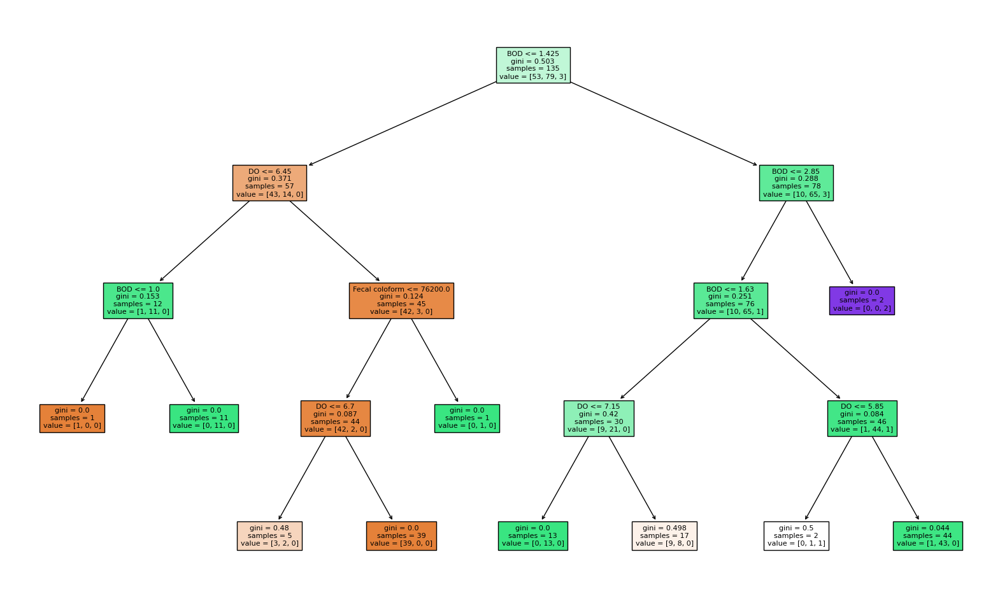

Training RandomForestClassifier model with all features


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: RandomForestClassifier
> Accuracy: 0.8529411764705882
> Precision: 0.5942028985507246
> Recall: 0.5952380952380952
> F1 Score: 0.5860162601626017
> Cross Validation Score (CV): 0.8575757575757574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Nitrate+nitrite', 'Conductivity', 'Temp', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.353678
3               DO    0.178532
2     Conductivity    0.104728
7   Total coliform    0.088283
6   Fecal coloform    0.085649
0             Temp    0.071471
5  Nitrate+nitrite    0.063552
1               pH    0.054107
--------------------------------------------------


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.348321
3               DO    0.142194
7   Total coliform    0.112535
5  Nitrate+nitrite    0.105999
6   Fecal coloform    0.093821
0             Temp    0.078985
2     Conductivity    0.070693
1               pH    0.047451


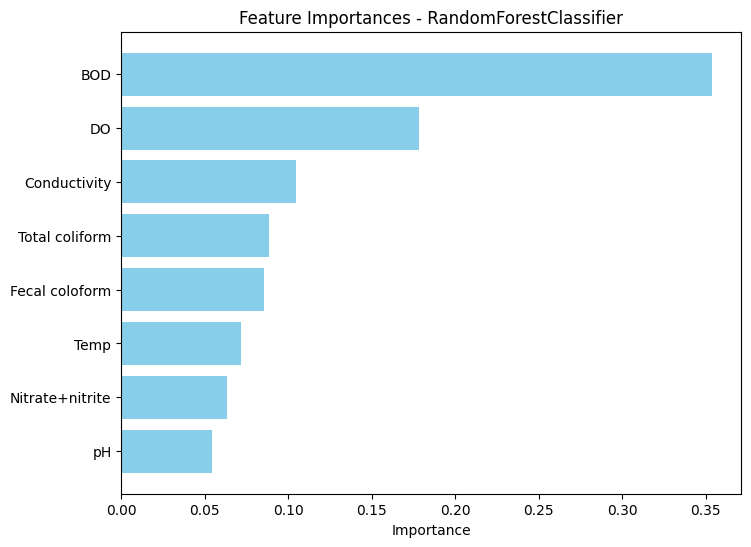

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.8611111111111112
> Precision: 0.8653846153846154
> Recall: 0.8603341103341103
> F1 Score: 0.8617614269788184
> Cross Validation Score (CV): 0.8944444444444445
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.8262108262108262
> Recall: 0.9153439153439153
> F1 Score: 0.8592592592592592
> Cross Validation Score (CV): 0.8754010695187165
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH', 'Conductivity', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Featu

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.631305
3               DO    0.155421
5  Nitrate+nitrite    0.056022
6   Fecal coloform    0.045051
2     Conductivity    0.033880
7   Total coliform    0.032786
0             Temp    0.028565
1               pH    0.016969


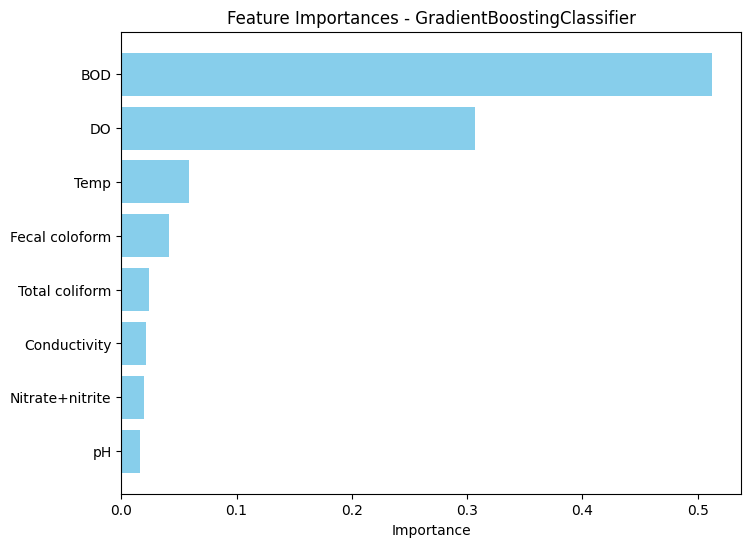

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.8611111111111112
> Precision: 0.8611111111111112
> Recall: 0.8624708624708625
> F1 Score: 0.8608695652173912
> Cross Validation Score (CV): 0.8777777777777777
Training SVC model with all features
Model: SVC
> Accuracy: 0.5882352941176471
> Precision: 0.4388888888888889
> Recall: 0.3862433862433862
> F1 Score: 0.34722222222222227
> Cross Validation Score (CV): 0.650445632798574


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'Nitrate+nitrite', 'pH']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'Nitrate+nitrite', 'pH', 'Temp', 'Total coliform', 'Fecal coloform', 'Conductivity']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.032469      0.071471    0.058399
1               pH      0.084255      0.054107    0.016371
2     Conductivity      0.035348      0.104728    0.021628
3               DO      0.296807      0.178532    0.306472
4              BOD      0.502785      0.353678    0.512099
5  Nitrate+nitrite      0.022093      0.063552    0.019454
6   Fecal coloform      0.026243      0.085649    0.041406
7   Total coliform      0.000000      0.088283    0.024171
========================= After balance using scale =========================
Training DecisionTreeCla

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


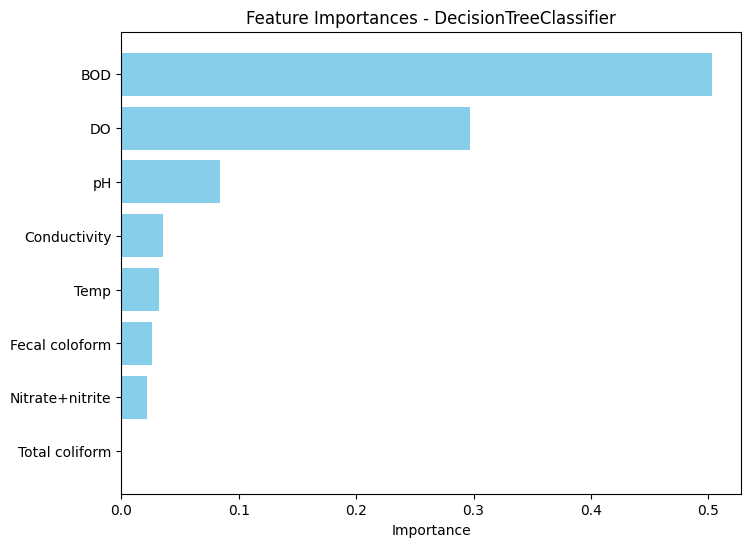

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.8311688311688311
> Recall: 0.8321678321678322
> F1 Score: 0.8278943278943278
> Cross Validation Score (CV): 0.8722222222222221
The tree without a max depth:


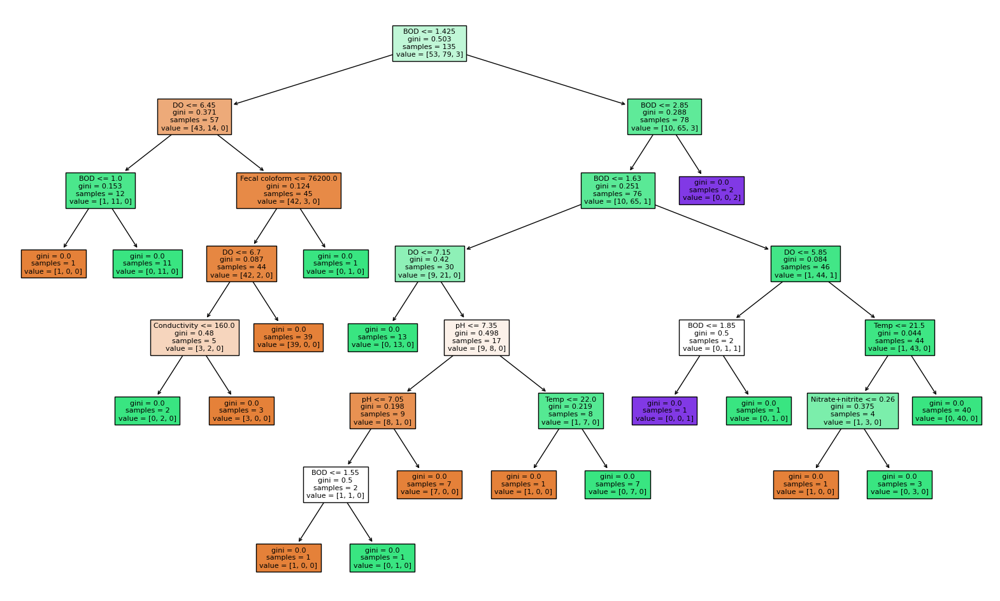

The tree with the best features:


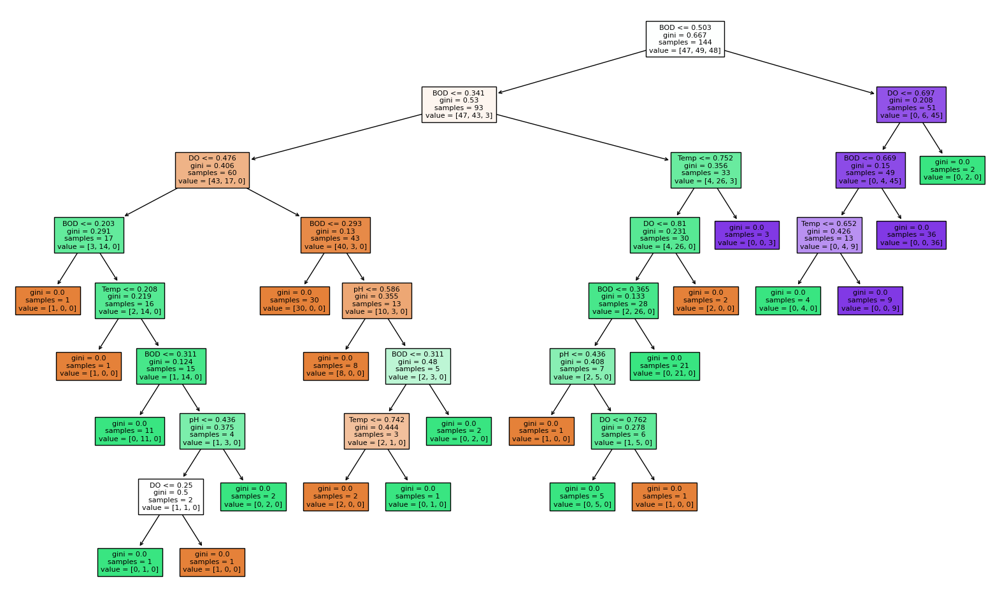

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.8538011695906432
> Recall: 0.9338624338624338
> F1 Score: 0.8806652806652807
> Cross Validation Score (CV): 0.7864527629233512


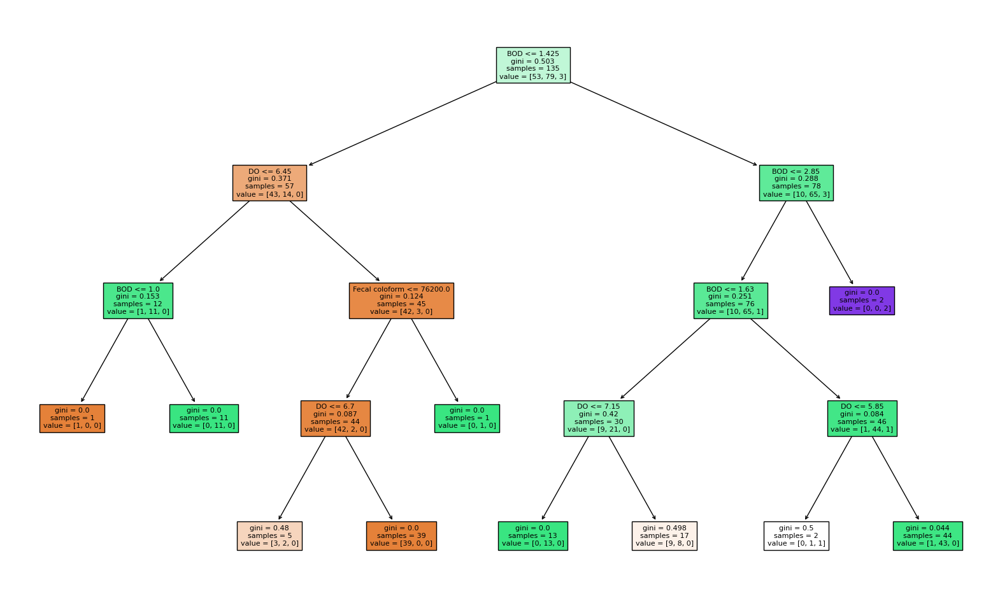

Training RandomForestClassifier model with all features


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: RandomForestClassifier
> Accuracy: 0.8529411764705882
> Precision: 0.5942028985507246
> Recall: 0.5952380952380952
> F1 Score: 0.5860162601626017
> Cross Validation Score (CV): 0.8575757575757574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Conductivity', 'Nitrate+nitrite', 'Temp', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.353678
3               DO    0.178532
2     Conductivity    0.104728
7   Total coliform    0.088283
6   Fecal coloform    0.085649
0             Temp    0.071471
5  Nitrate+nitrite    0.063552
1               pH    0.054107
--------------------------------------------------


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.348321
3               DO    0.142194
7   Total coliform    0.112535
5  Nitrate+nitrite    0.105999
6   Fecal coloform    0.093821
0             Temp    0.078985
2     Conductivity    0.070693
1               pH    0.047451


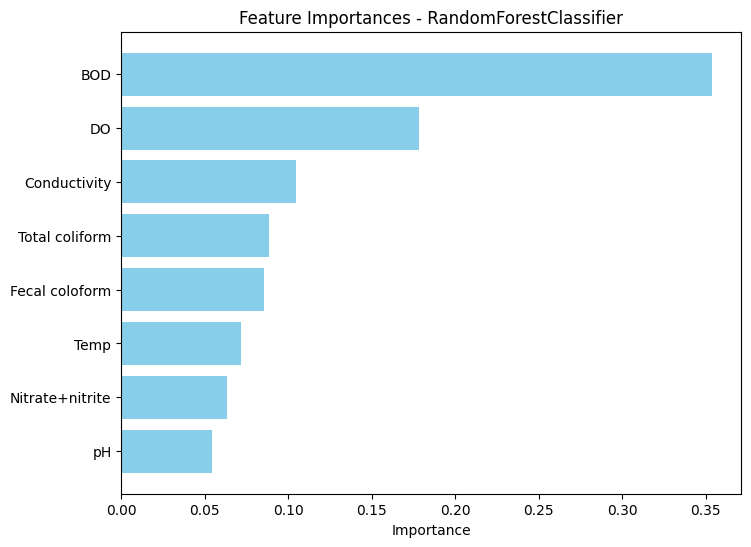

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.8888888888888888
> Precision: 0.8927738927738927
> Recall: 0.8927738927738927
> F1 Score: 0.8888888888888888
> Cross Validation Score (CV): 0.8944444444444445
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.8262108262108262
> Recall: 0.9153439153439153
> F1 Score: 0.8592592592592592
> Cross Validation Score (CV): 0.8754010695187165
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'Temp', 'pH', 'Conductivity', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Featu

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.631255
3               DO    0.155413
5  Nitrate+nitrite    0.056054
6   Fecal coloform    0.045043
2     Conductivity    0.033848
7   Total coliform    0.032783
0             Temp    0.028626
1               pH    0.016978


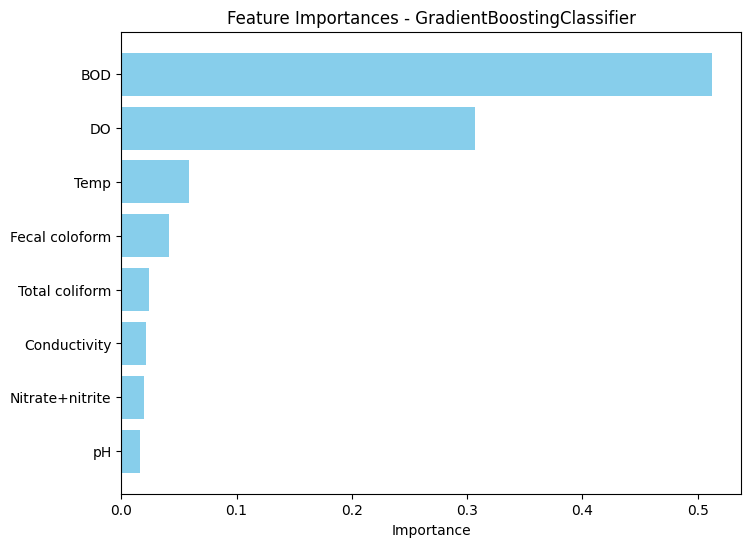

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.8611111111111112
> Precision: 0.8611111111111112
> Recall: 0.8624708624708625
> F1 Score: 0.8608695652173912
> Cross Validation Score (CV): 0.8777777777777777
Training SVC model with all features
Model: SVC
> Accuracy: 0.5882352941176471
> Precision: 0.4388888888888889
> Recall: 0.3862433862433862
> F1 Score: 0.34722222222222227
> Cross Validation Score (CV): 0.650445632798574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Fecal coloform']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Fecal coloform', 'Total coliform', 'Temp', 'Nitrate+nitrite', 'Conductivity']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.032469      0.071471    0.058399
1               pH      

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for DecisionTreeClassifier: ['BOD', 'DO', 'pH', 'Temp', 'Fecal coloform', 'Conductivity', 'Nitrate+nitrite', 'Total coliform']
--------------------------------------------------
DecisionTreeClassifier Feature Importances:
           Feature  Importance
4              BOD    0.502785
3               DO    0.296807
1               pH    0.084255
2     Conductivity    0.035348
0             Temp    0.032469
6   Fecal coloform    0.026243
5  Nitrate+nitrite    0.022093
7   Total coliform    0.000000
--------------------------------------------------
DecisionTreeClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.598650
3               DO    0.165275
5  Nitrate+nitrite    0.079152
6   Fecal coloform    0.049592
0             Temp    0.0

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


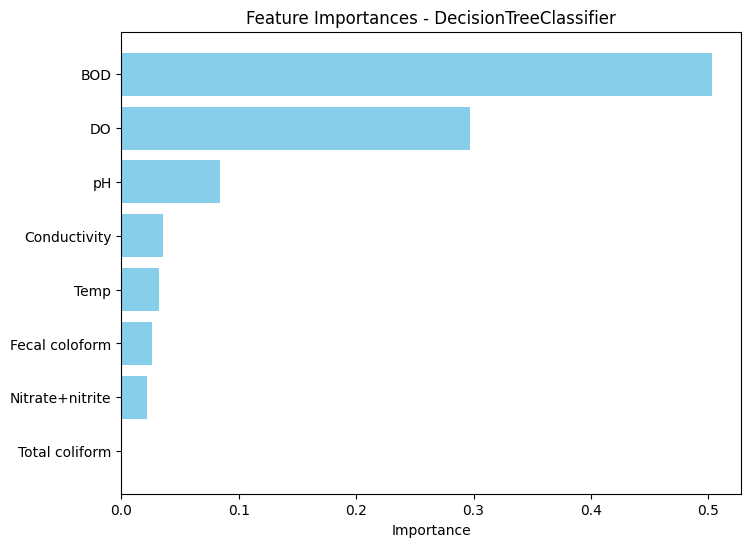

The following metrics are for the model with the best features:
Model: DecisionTreeClassifier
> Accuracy: 0.8333333333333334
> Precision: 0.8311688311688311
> Recall: 0.8321678321678322
> F1 Score: 0.8278943278943278
> Cross Validation Score (CV): 0.8722222222222221
The tree without a max depth:


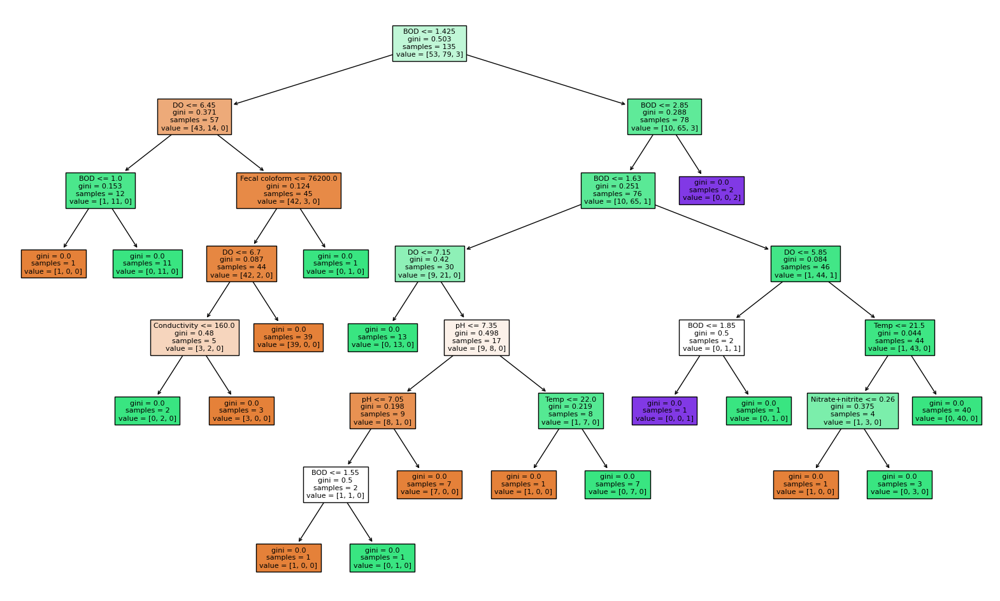

The tree with the best features:


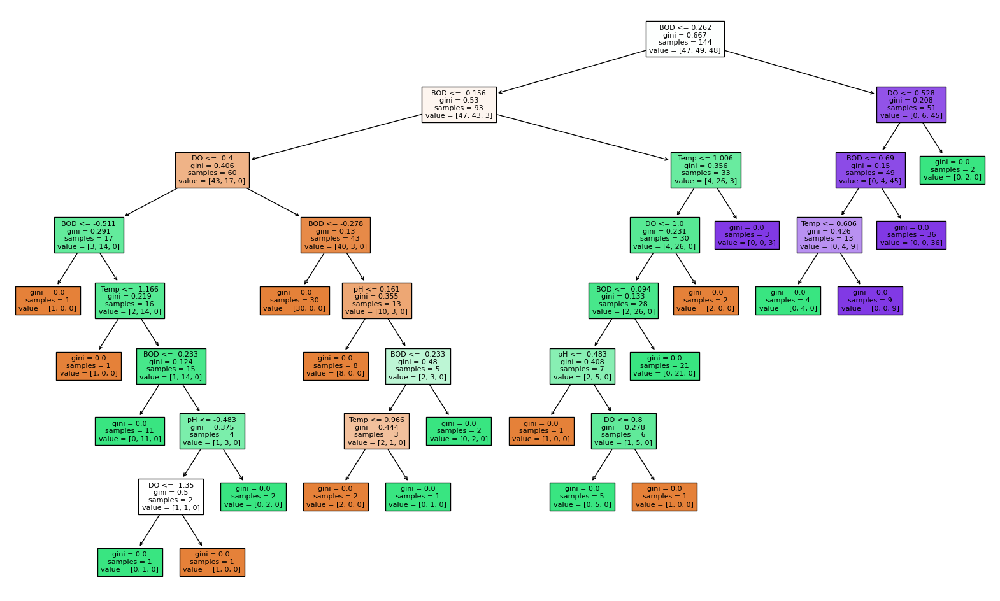

The tree with a max depth:
Model: DecisionTreeClassifier
> Accuracy: 0.9117647058823529
> Precision: 0.8538011695906432
> Recall: 0.9338624338624338
> F1 Score: 0.8806652806652807
> Cross Validation Score (CV): 0.7864527629233512


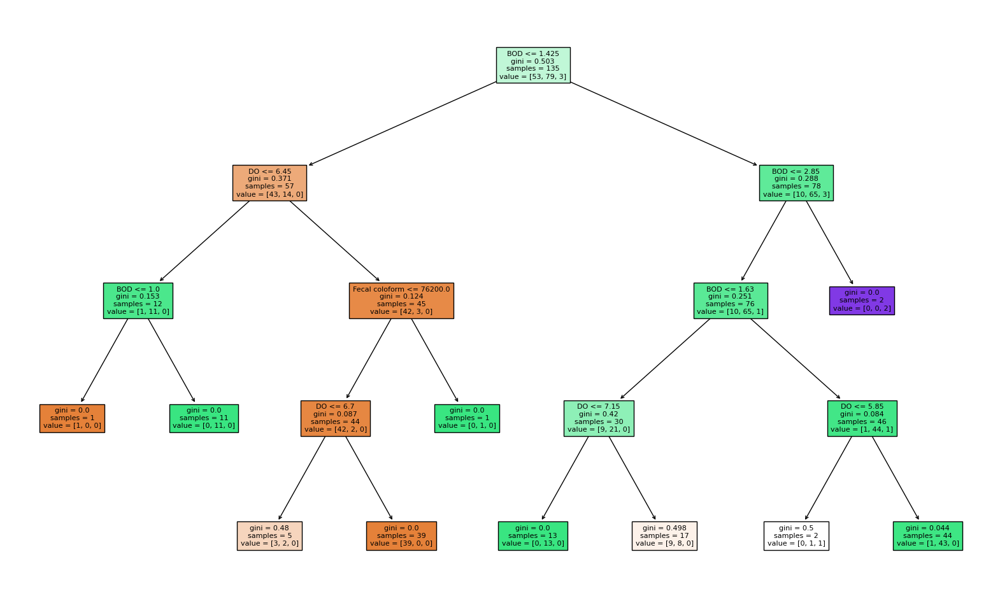

Training RandomForestClassifier model with all features


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Model: RandomForestClassifier
> Accuracy: 0.8529411764705882
> Precision: 0.5942028985507246
> Recall: 0.5952380952380952
> F1 Score: 0.5860162601626017
> Cross Validation Score (CV): 0.8575757575757574
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Nitrate+nitrite']
Selected features from Sequential Feature Selector for RandomForestClassifier: ['BOD', 'DO', 'pH', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform', 'Conductivity', 'Temp']
--------------------------------------------------
RandomForestClassifier Feature Importances:
           Feature  Importance
4              BOD    0.353678
3               DO    0.178532
2     Conductivity    0.104728
7   Total coliform    0.088283
6   Fecal coloform    0.085649
0             Temp    0.071471
5  Nitrate+nitrite    0.063552
1               pH    0.054107
--------------------------------------------------


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


RandomForestClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.348321
3               DO    0.142194
7   Total coliform    0.112535
5  Nitrate+nitrite    0.105999
6   Fecal coloform    0.093821
0             Temp    0.078985
2     Conductivity    0.070693
1               pH    0.047451


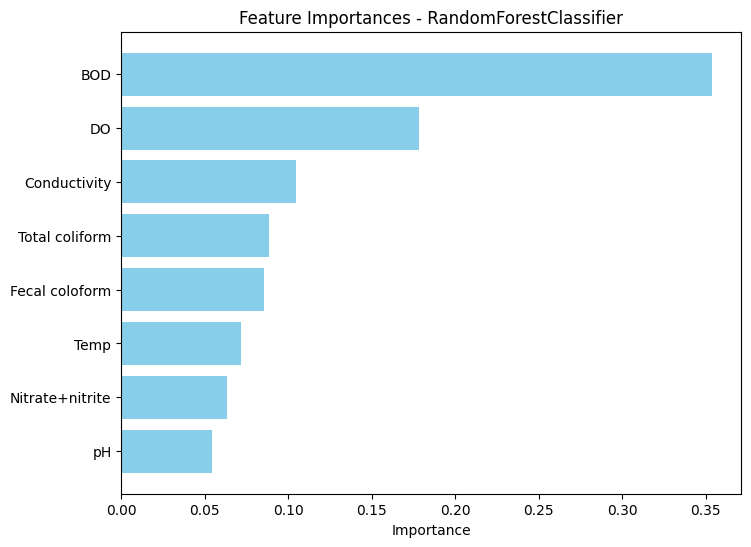

The following metrics are for the model with the best features:
Model: RandomForestClassifier
> Accuracy: 0.8611111111111112
> Precision: 0.8653846153846154
> Recall: 0.8603341103341103
> F1 Score: 0.8617614269788184
> Cross Validation Score (CV): 0.888888888888889
Training GradientBoostingClassifier model with all features
Model: GradientBoostingClassifier
> Accuracy: 0.8823529411764706
> Precision: 0.8262108262108262
> Recall: 0.9153439153439153
> F1 Score: 0.8592592592592592
> Cross Validation Score (CV): 0.8754010695187165
--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for GradientBoostingClassifier: ['BOD', 'DO', 'pH', 'Temp', 'Conductivity', 'Nitrate+nitrite', 'Fecal coloform', 'Total coliform']
--------------------------------------------------
GradientBoostingClassifier Feature Importances:
           Featur

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


GradientBoostingClassifier Bagging Feature Importances:
           Feature  Importance
4              BOD    0.631255
3               DO    0.155413
5  Nitrate+nitrite    0.056055
6   Fecal coloform    0.045043
2     Conductivity    0.033849
7   Total coliform    0.032783
0             Temp    0.028626
1               pH    0.016978


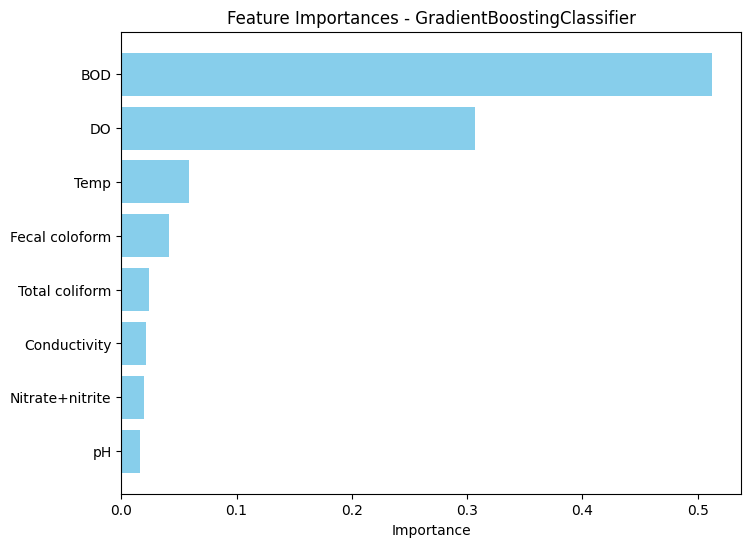

The following metrics are for the model with the best features:
Model: GradientBoostingClassifier
> Accuracy: 0.8611111111111112
> Precision: 0.8611111111111112
> Recall: 0.8624708624708625
> F1 Score: 0.8608695652173912
> Cross Validation Score (CV): 0.888888888888889
Training SVC model with all features
Model: SVC
> Accuracy: 0.5882352941176471
> Precision: 0.4388888888888889
> Recall: 0.3862433862433862
> F1 Score: 0.34722222222222227
> Cross Validation Score (CV): 0.650445632798574


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--------------------------------------------------
Best 4 Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Temp']
Selected features from Sequential Feature Selector for SVC: ['BOD', 'DO', 'pH', 'Temp', 'Nitrate+nitrite', 'Conductivity', 'Total coliform', 'Fecal coloform']
--------------------------------------------------
           Feature  Importance_x  Importance_y  Importance
0             Temp      0.032469      0.071471    0.058399
1               pH      0.084255      0.054107    0.016371
2     Conductivity      0.035348      0.104728    0.021628
3               DO      0.296807      0.178532    0.306472
4              BOD      0.502785      0.353678    0.512099
5  Nitrate+nitrite      0.022093      0.063552    0.019454
6   Fecal coloform      0.026243      0.085649    0.041406
7   Total coliform      0.000000      0.088283    0.024171
Results without scale
                                       Model  Accuracy  Precision    Recall  \
0       Deci

In [40]:
BCWQIClassification_removed = Model(bcwqi_classic_classification, 'Index1', 60, True, 4, True)

### CPI Regression

In [41]:
print("Results without scale")
print(pd.DataFrame(CPIRegression.results))

print("Results with scale")
print(pd.DataFrame(CPIRegression.resultsScaled))
print("Results after balance without scale")
print(pd.DataFrame(CPIRegression.resultsBalanced))
print("Results after balance with scale")
print(pd.DataFrame(CPIRegression.resultsBalancedScaled))

Results without scale
                                      Model       MAE       MSE  R2 Score
0       DecisionTreeRegressor(All Features)  0.101176  0.039006  0.962151
1      DecisionTreeRegressor(Best Features)  0.061765  0.008129  0.992112
2          DecisionTreeRegressor(Max Depth)  0.146251  0.085651  0.916890
3       RandomForestRegressor(All Features)  0.092688  0.036037  0.965033
4      RandomForestRegressor(Best Features)  0.076982  0.029748  0.971134
5   GradientBoostingRegressor(All Features)  0.055380  0.009291  0.990985
6  GradientBoostingRegressor(Best Features)  0.049394  0.006902  0.993303
7            LinearRegression(All Features)  0.002491  0.000008  0.999992
8                         SVR(All Features)  0.036986  0.001999  0.998060
Results with scale
                                       Model       MAE       MSE  R2 Score
0                               MinMaxScaler       NaN       NaN       NaN
1        DecisionTreeRegressor(All Features)  0.101176  0.039006  0.9

### CPI Classification

In [42]:
print("Results without scale")
print(pd.DataFrame(CPIClassification.results))
print("Results with scale")
print(pd.DataFrame(CPIClassification.resultsScaled))
print("Results after balance without scale")
print(pd.DataFrame(CPIClassification.resultsBalanced))
print("Results after balance with scale")
print(pd.DataFrame(CPIClassification.resultsBalancedScaled))

Results without scale
                                       Model  Accuracy  Precision    Recall  \
0       DecisionTreeClassifier(All Features)  1.000000   1.000000  1.000000   
1      DecisionTreeClassifier(Best Features)  1.000000   1.000000  1.000000   
2          DecisionTreeClassifier(Max Depth)  1.000000   1.000000  1.000000   
3       RandomForestClassifier(All Features)  0.970588   0.933333  0.916667   
4      RandomForestClassifier(Best Features)  1.000000   1.000000  1.000000   
5   GradientBoostingClassifier(All Features)  1.000000   1.000000  1.000000   
6  GradientBoostingClassifier(Best Features)  1.000000   1.000000  1.000000   
7                          SVC(All Features)  0.970588   0.987654  0.916667   

   F1 Score  CV Score  
0  1.000000  0.947059  
1  1.000000  0.941176  
2  1.000000  0.947059  
3  0.915344  0.941176  
4  1.000000  0.964706  
5  1.000000  0.947059  
6  1.000000  0.947059  
7  0.946092  0.982353  
Results with scale
                               

### BCWQI Regression with minority class (duplicated rows)

In [43]:
print("Results without scale")
print(pd.DataFrame(BCWQIReggression_not_removed.results))
print("Results with scale")
print(pd.DataFrame(BCWQIReggression_not_removed.resultsScaled))
print("Results after balance without scale")
print(pd.DataFrame(BCWQIReggression_not_removed.resultsBalanced))
print("Results after balance with scale")
print(pd.DataFrame(BCWQIReggression_not_removed.resultsBalancedScaled))

Results without scale
                                      Model       MAE        MSE  R2 Score
0       DecisionTreeRegressor(All Features)  2.479412  12.772041  0.783336
1      DecisionTreeRegressor(Best Features)  3.332353  26.402953  0.552103
2          DecisionTreeRegressor(Max Depth)  2.703223  14.765140  0.749526
3       RandomForestRegressor(All Features)  2.248979  12.182390  0.793339
4      RandomForestRegressor(Best Features)  2.021435  10.448129  0.822759
5   GradientBoostingRegressor(All Features)  1.984624  10.909707  0.814929
6  GradientBoostingRegressor(Best Features)  1.917193  10.416490  0.823296
7            LinearRegression(All Features)  1.542555   6.835225  0.884048
8                         SVR(All Features)  5.597865  53.683083  0.089326
Results with scale
                                       Model       MAE        MSE  R2 Score
0                               MinMaxScaler       NaN        NaN       NaN
1        DecisionTreeRegressor(All Features)  2.479412  1

### BCWQI Regression without minority class

In [44]:
print("Results without scale")
print(pd.DataFrame(BCWQIReggression_removed.results))
print("Results with scale")
print(pd.DataFrame(BCWQIReggression_removed.resultsScaled))
print("Results after balance without scale")
print(pd.DataFrame(BCWQIReggression_removed.resultsBalanced))
print("Results after balance with scale")
print(pd.DataFrame(BCWQIReggression_removed.resultsBalancedScaled))

Results without scale
                                      Model       MAE        MSE  R2 Score
0       DecisionTreeRegressor(All Features)  2.479412  12.772041  0.783336
1      DecisionTreeRegressor(Best Features)  3.332353  26.402953  0.552103
2          DecisionTreeRegressor(Max Depth)  2.703223  14.765140  0.749526
3       RandomForestRegressor(All Features)  2.248979  12.182390  0.793339
4      RandomForestRegressor(Best Features)  2.021435  10.448129  0.822759
5   GradientBoostingRegressor(All Features)  1.984624  10.909707  0.814929
6  GradientBoostingRegressor(Best Features)  1.875225   8.743392  0.851678
7            LinearRegression(All Features)  1.542555   6.835225  0.884048
8                         SVR(All Features)  5.597865  53.683083  0.089326
Results with scale
                                       Model       MAE        MSE  R2 Score
0                               MinMaxScaler       NaN        NaN       NaN
1        DecisionTreeRegressor(All Features)  2.479412  1

### BCWQI Classification without minority class

In [45]:
print("Results without scale")
print(pd.DataFrame(BCWQIClassification_not_removed.results))
print("Results with scale")
print(pd.DataFrame(BCWQIClassification_not_removed.resultsScaled))
print("Results after balance without scale")
print(pd.DataFrame(BCWQIClassification_not_removed.resultsBalanced))
print("Results after balance with scale")
print(pd.DataFrame(BCWQIClassification_not_removed.resultsBalancedScaled))

Results without scale
                                       Model  Accuracy  Precision    Recall  \
0       DecisionTreeClassifier(All Features)  0.833333   0.793831  0.901786   
1      DecisionTreeClassifier(Best Features)  0.888889   0.828463  0.934524   
2          DecisionTreeClassifier(Max Depth)  0.833333   0.803744  0.892857   
3       RandomForestClassifier(All Features)  0.805556   0.886364  0.880952   
4      RandomForestClassifier(Best Features)  0.916667   0.954545  0.946429   
5   GradientBoostingClassifier(All Features)  0.805556   0.775794  0.898810   
6  GradientBoostingClassifier(Best Features)  0.833333   0.793831  0.901786   
7                          SVC(All Features)  0.583333   0.273438  0.267857   

   F1 Score  CV Score  
0  0.826605  0.790159  
1  0.860248  0.842222  
2  0.823052  0.818413  
3  0.883215  0.858254  
4  0.949949  0.892698  
5  0.814103  0.864286  
6  0.826605  0.898413  
7  0.241745  0.625238  
Results with scale
                               

### BCWQI Classification with minority class (duplicated rows)

In [46]:
print("Results without scale")
print(pd.DataFrame(BCWQIClassification_removed.results))
print("Results with scale")
print(pd.DataFrame(BCWQIClassification_removed.resultsScaled))
print("Results after balance without scale")
print(pd.DataFrame(BCWQIClassification_removed.resultsBalanced))
print("Results after balance with scale")
print(pd.DataFrame(BCWQIClassification_removed.resultsBalancedScaled))

Results without scale
                                       Model  Accuracy  Precision    Recall  \
0       DecisionTreeClassifier(All Features)  0.911765   0.853801  0.933862   
1      DecisionTreeClassifier(Best Features)  0.882353   0.826211  0.915344   
2          DecisionTreeClassifier(Max Depth)  0.911765   0.853801  0.933862   
3       RandomForestClassifier(All Features)  0.852941   0.594203  0.595238   
4      RandomForestClassifier(Best Features)  0.882353   0.606061  0.619048   
5   GradientBoostingClassifier(All Features)  0.882353   0.826211  0.915344   
6  GradientBoostingClassifier(Best Features)  0.794118   0.707937  0.859788   
7                          SVC(All Features)  0.588235   0.438889  0.386243   

   F1 Score  CV Score  
0  0.880665  0.786275  
1  0.859259  0.828699  
2  0.880665  0.786453  
3  0.586016  0.857576  
4  0.607692  0.875758  
5  0.859259  0.875401  
6  0.738817  0.863993  
7  0.347222  0.650446  
Results with scale
                               

### CPI Clustering

Apelare DBSCAN Raw
DBSCAN Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


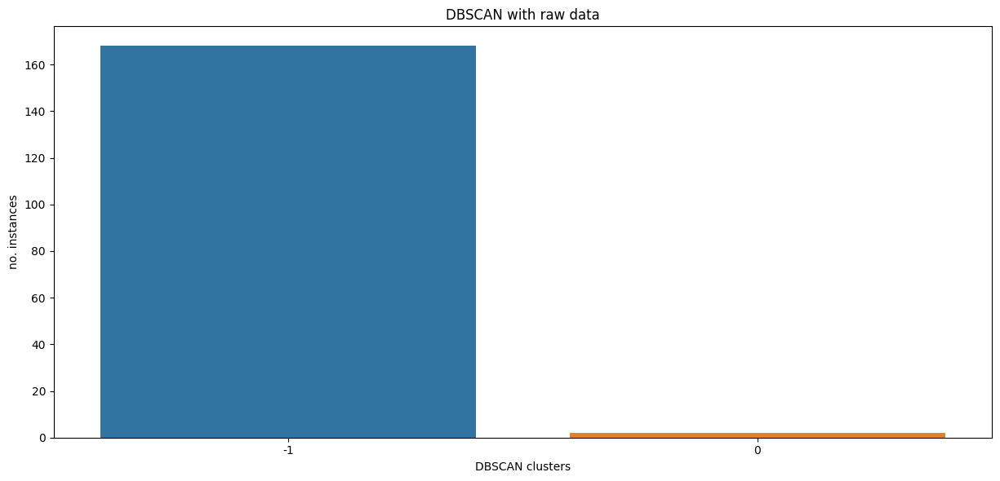

CPI                   3   4   5
DBSCAN Cluster Raw             
-1                  120  18  30
 0                    0   0   2


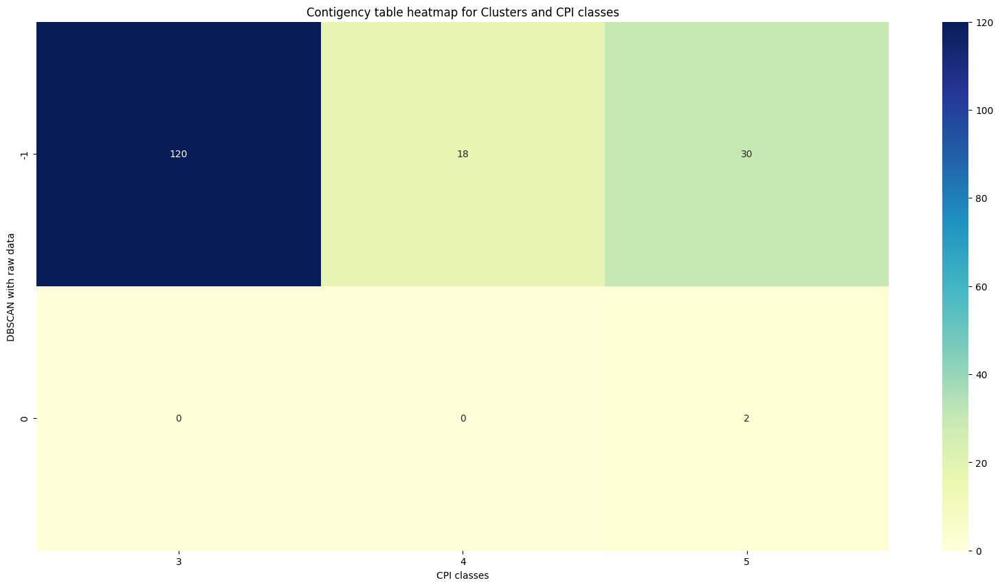

['Cluster 1 (o)']


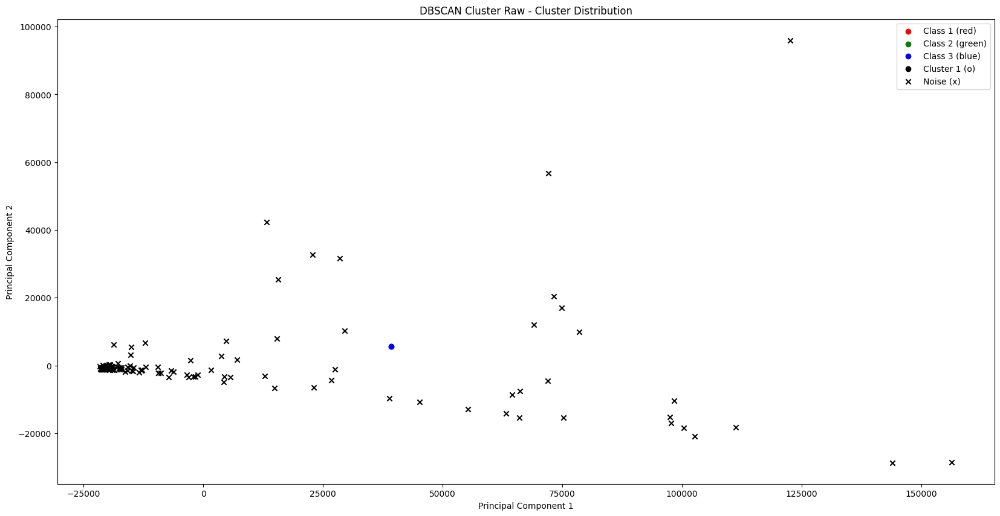

Apelare DBSCAN Standardized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
DBSCAN Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


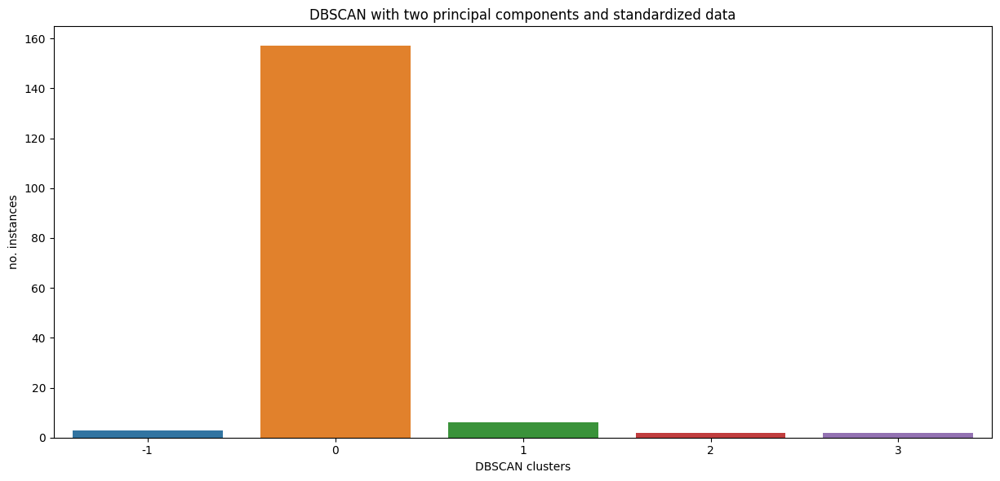

CPI                            3   4   5
DBSCAN Cluster Standardized             
-1                             0   0   3
 0                           117  15  25
 1                             3   3   0
 2                             0   0   2
 3                             0   0   2


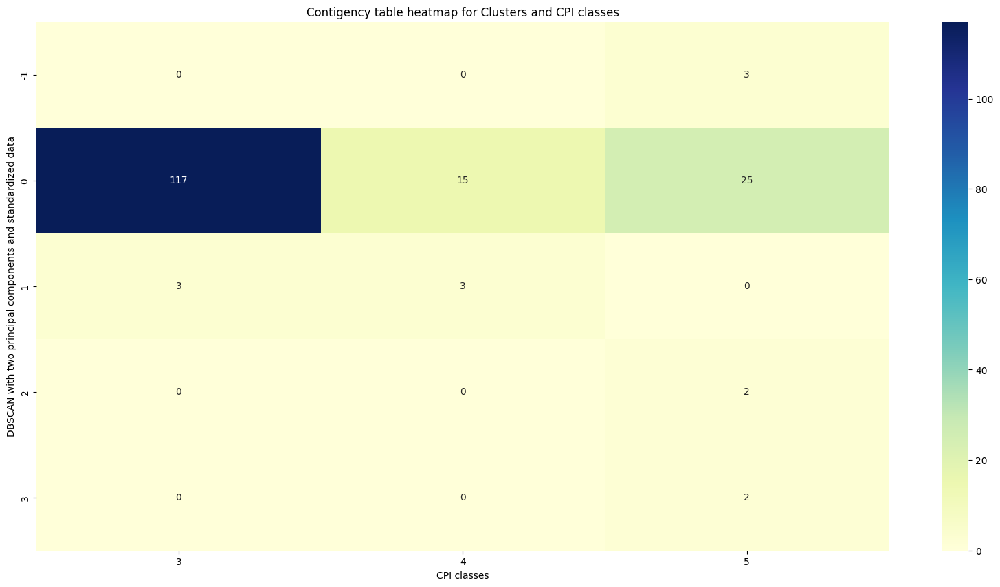

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']


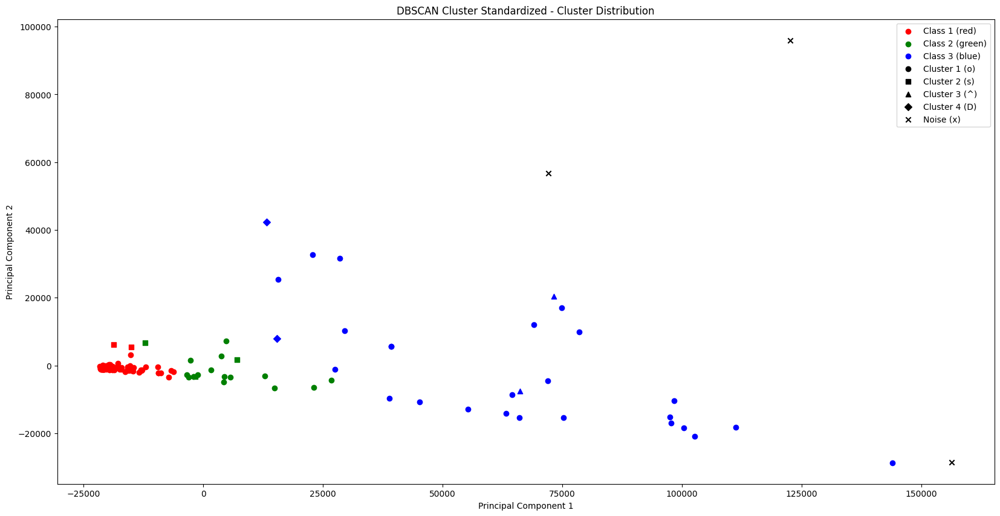

Apelare DBSCAN Standardized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare DBSCAN Normalized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
DBSCAN Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


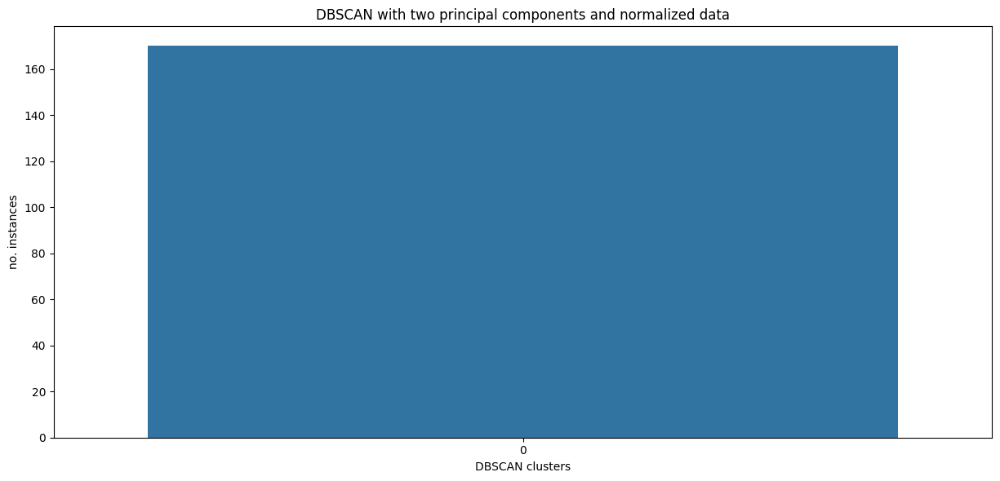

CPI                          3   4   5
DBSCAN Cluster Normalized             
0                          120  18  32


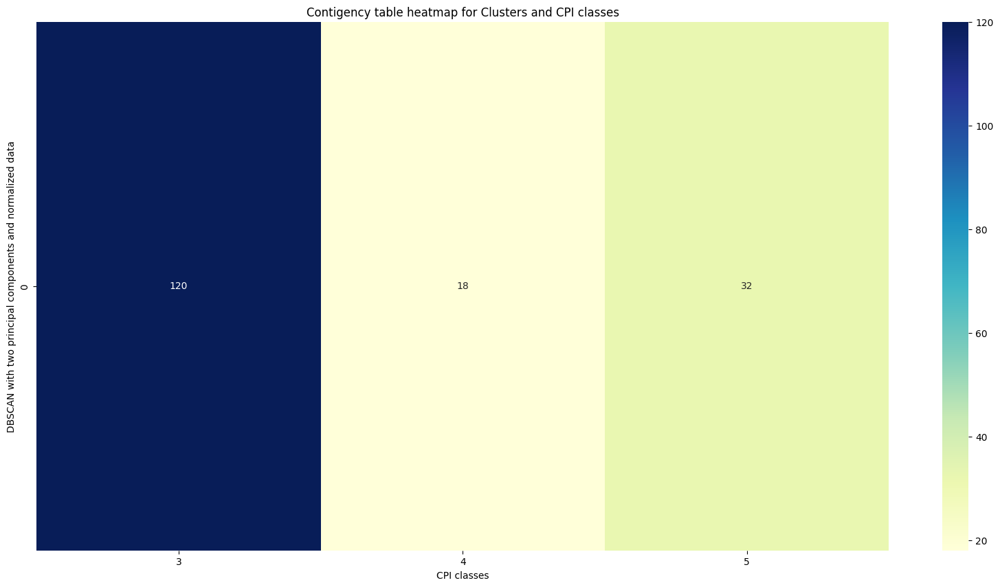

Apelare DBSCAN Normalized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare OPTICS Raw
OPTICS Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


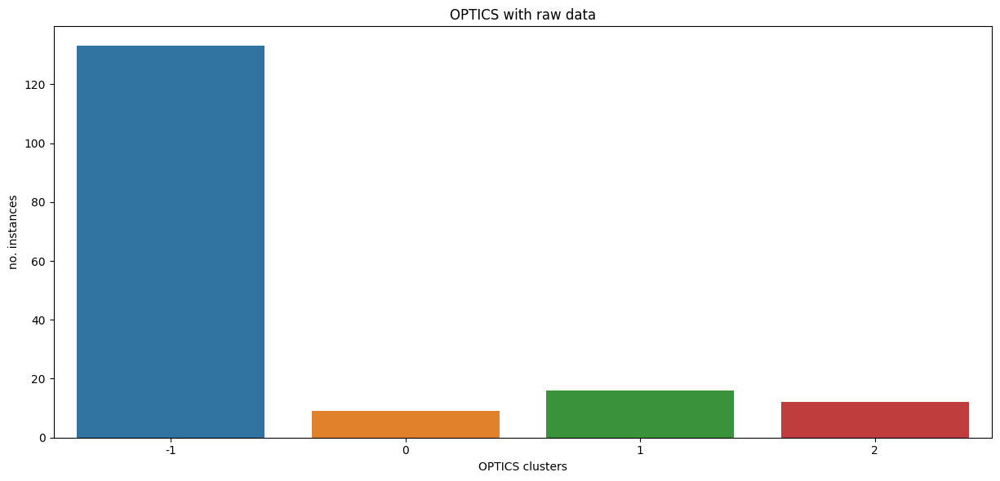

CPI                  3   4   5
OPTICS Cluster Raw            
-1                  83  18  32
 0                   9   0   0
 1                  16   0   0
 2                  12   0   0


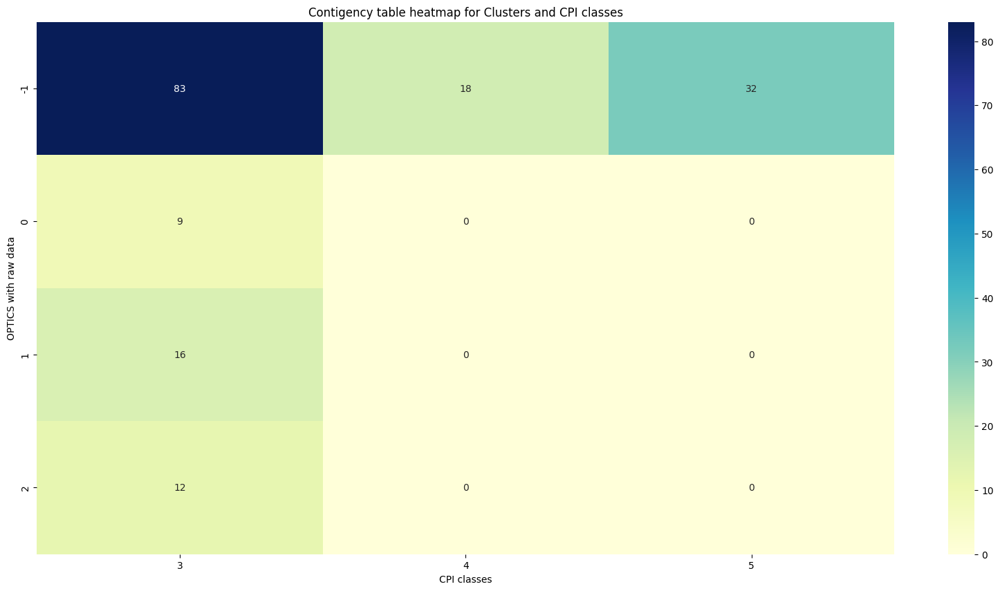

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']


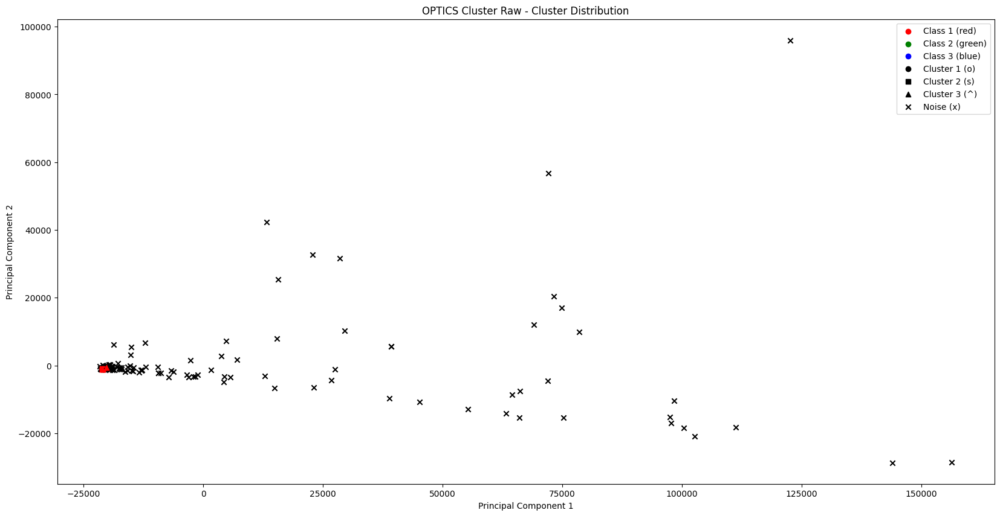

Apelare OPTICS Standardized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
OPTICS Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


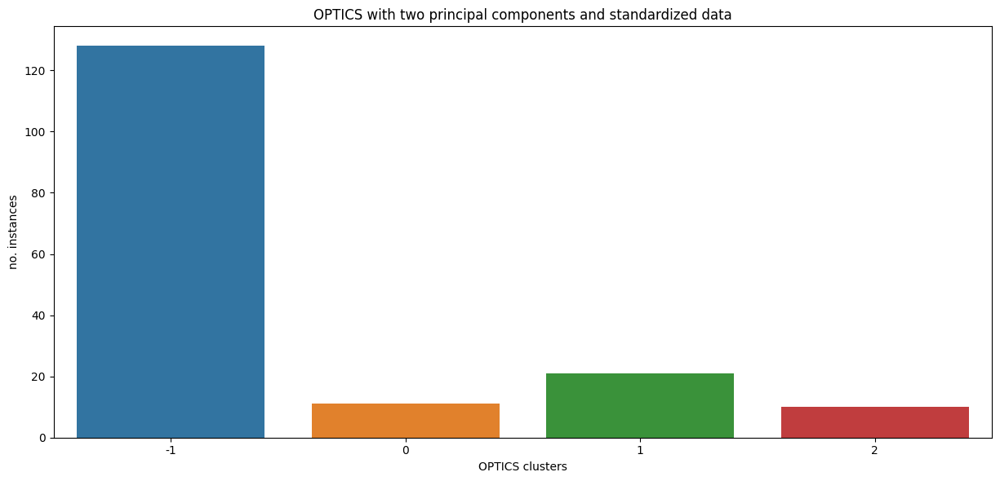

CPI                           3   4   5
OPTICS Cluster Standardized            
-1                           81  15  32
 0                           11   0   0
 1                           20   1   0
 2                            8   2   0


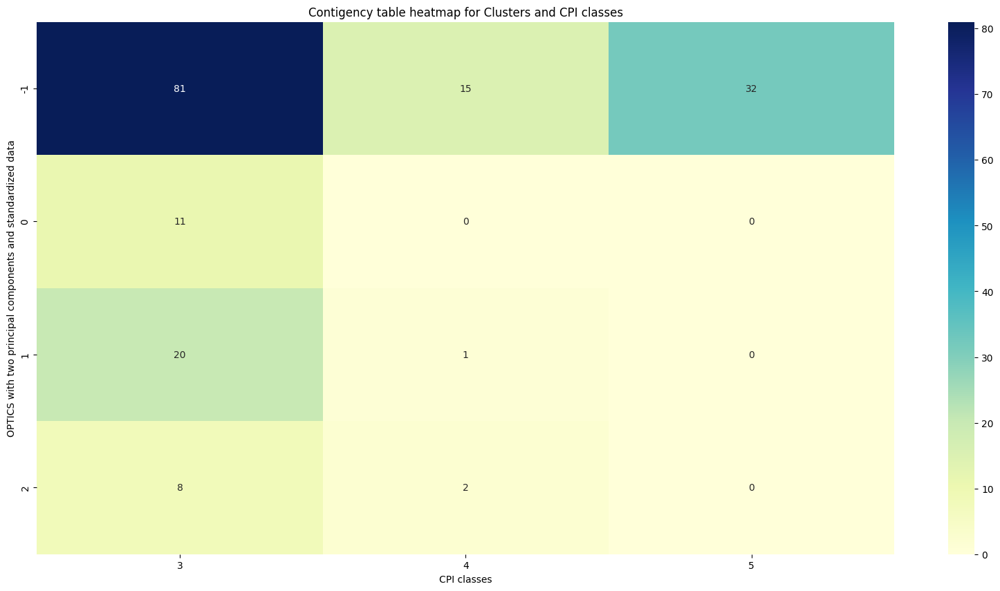

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']


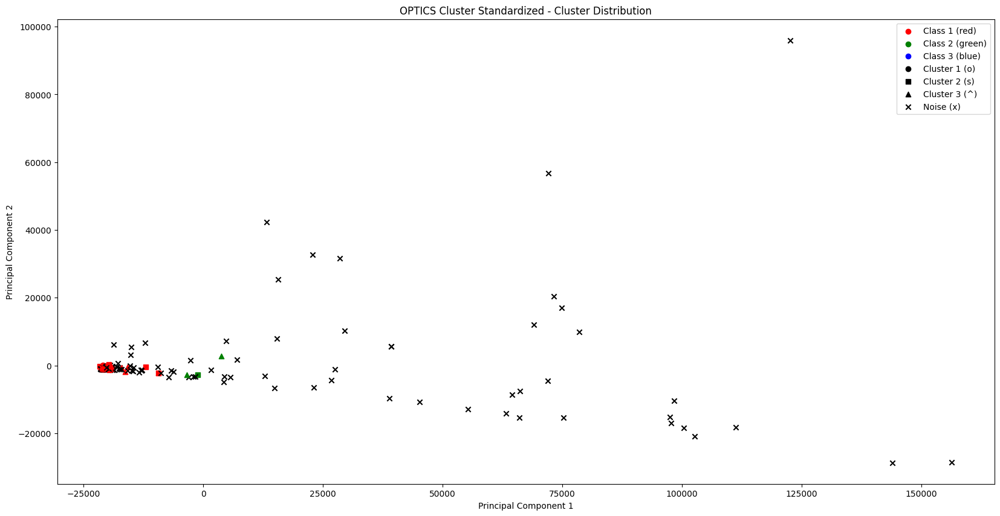

Apelare OPTICS Standardized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare OPTICS Normalized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
OPTICS Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


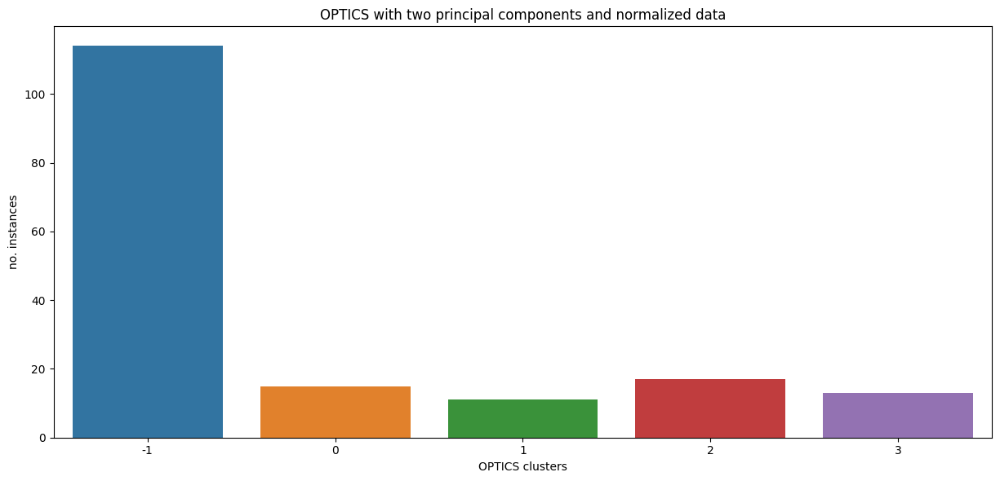

CPI                         3   4   5
OPTICS Cluster Normalized            
-1                         72  15  27
 0                         10   0   5
 1                         10   1   0
 2                         16   1   0
 3                         12   1   0


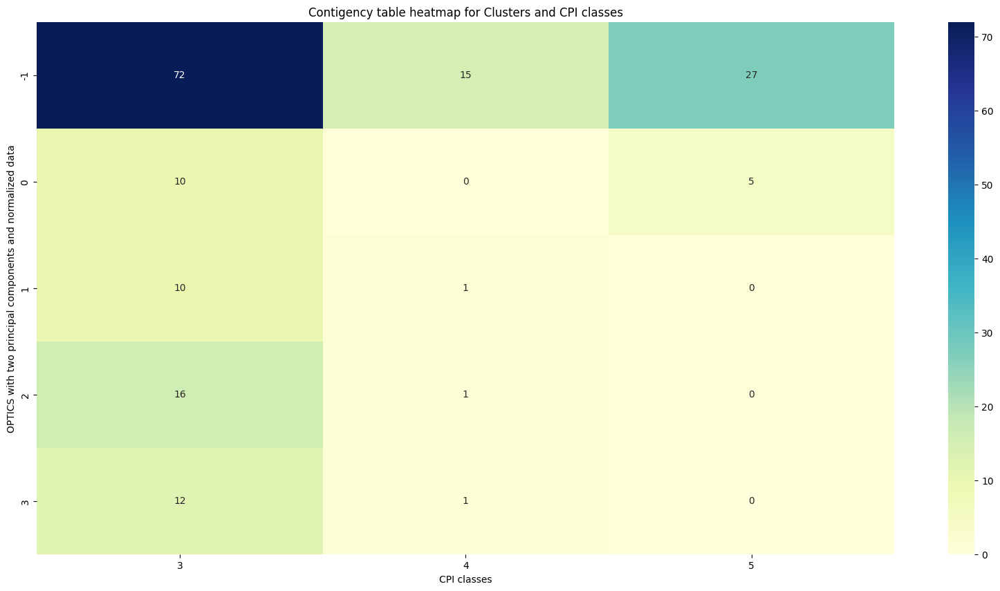

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']


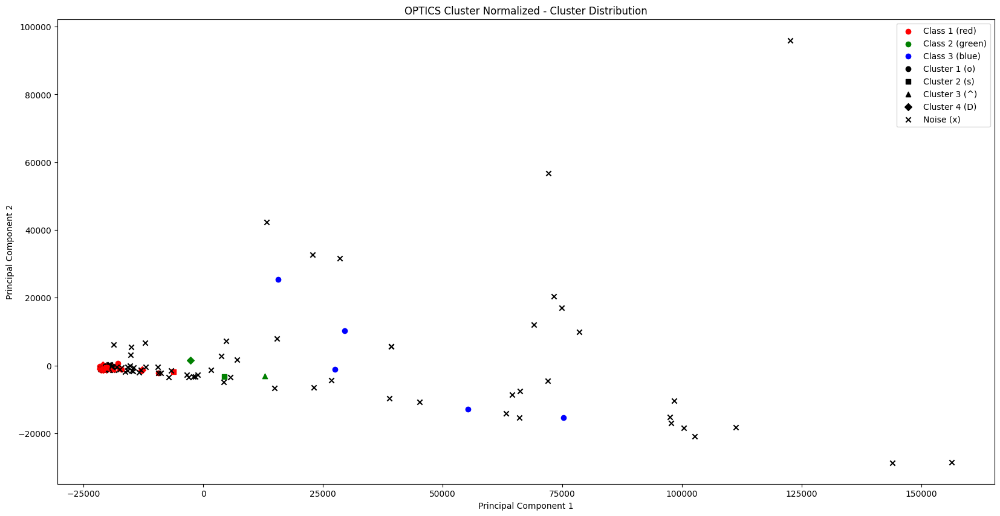

Apelare OPTICS Normalized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare AffinityPropagation Raw
AffinityPropagation Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


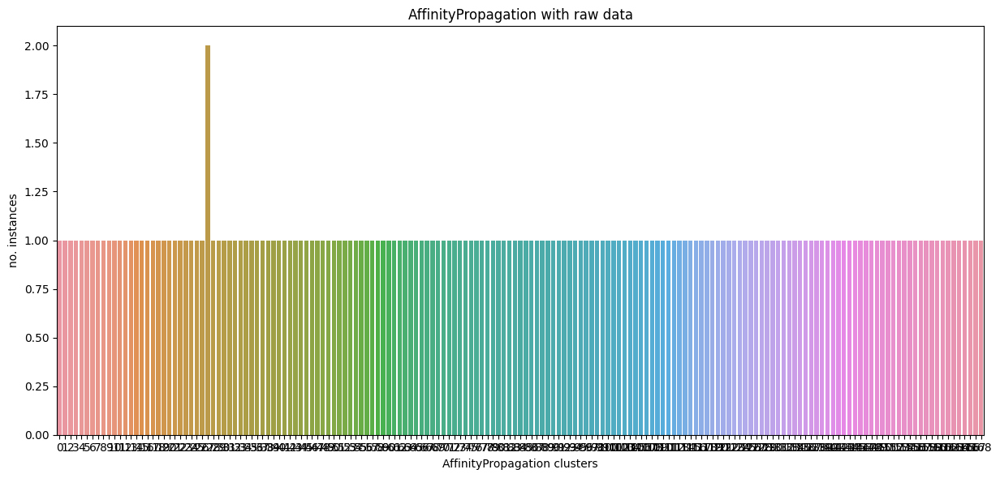

CPI                              3  4  5
AffinityPropagation Cluster Raw         
0                                1  0  0
1                                1  0  0
2                                0  1  0
3                                1  0  0
4                                0  0  1
...                             .. .. ..
164                              1  0  0
165                              0  0  1
166                              1  0  0
167                              0  0  1
168                              1  0  0

[169 rows x 3 columns]


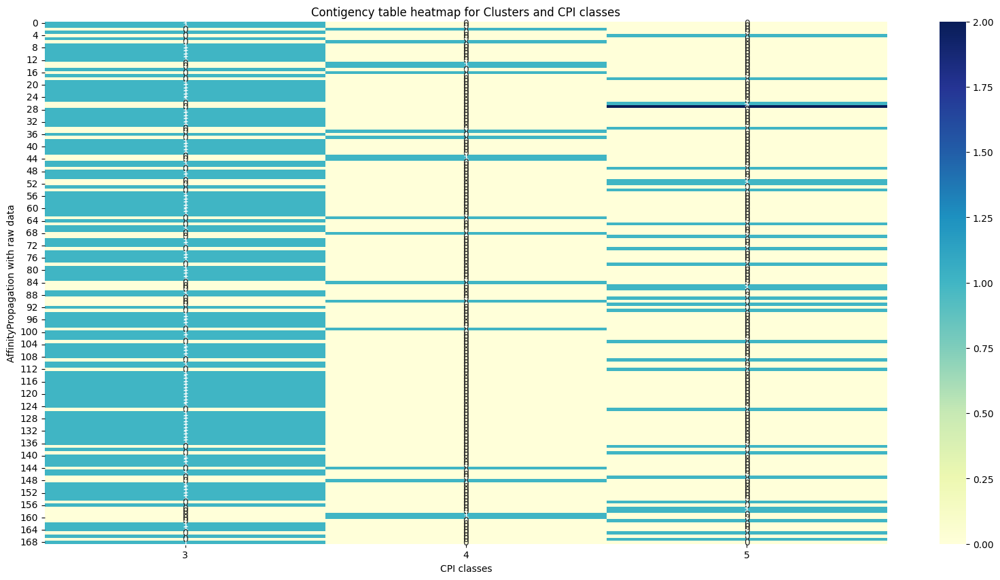

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


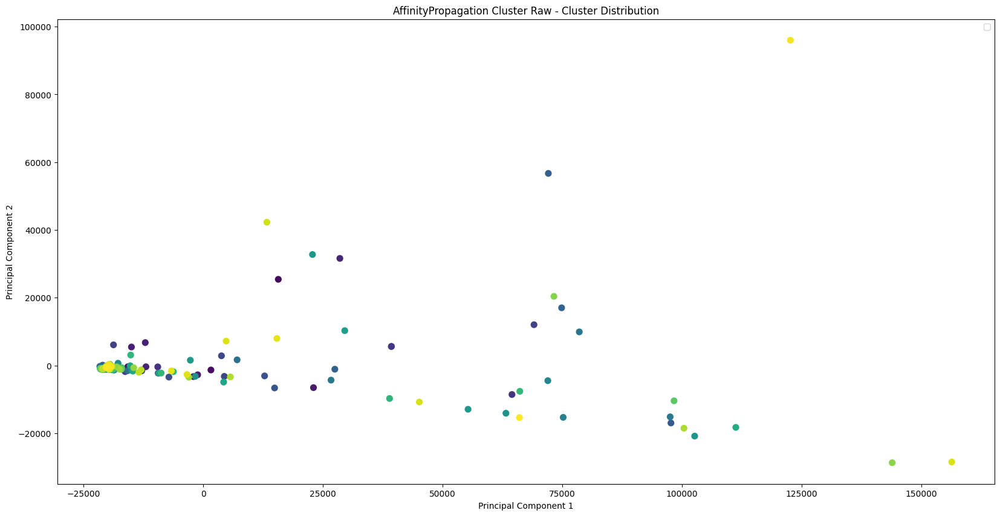

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


Apelare AffinityPropagation Standardized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
AffinityPropagation Cluster Standardized Cluster size distribution


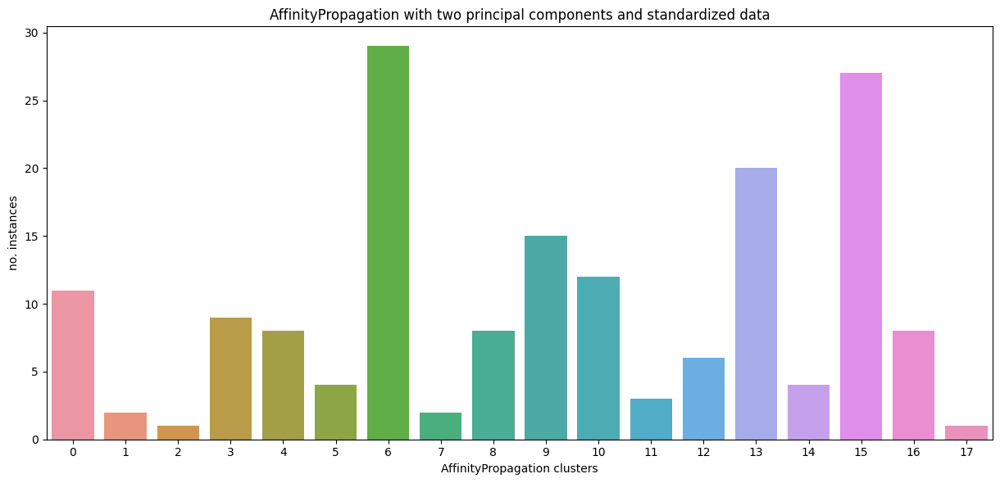

CPI                                        3  4  5
AffinityPropagation Cluster Standardized          
0                                         11  0  0
1                                          2  0  0
2                                          0  0  1
3                                          0  0  9
4                                          0  0  8
5                                          1  3  0
6                                         26  3  0
7                                          0  0  2
8                                          8  0  0
9                                         13  2  0
10                                        10  2  0
11                                         0  0  3
12                                         5  1  0
13                                        19  1  0
14                                         0  0  4
15                                        25  2  0
16                                         0  4  4
17                             

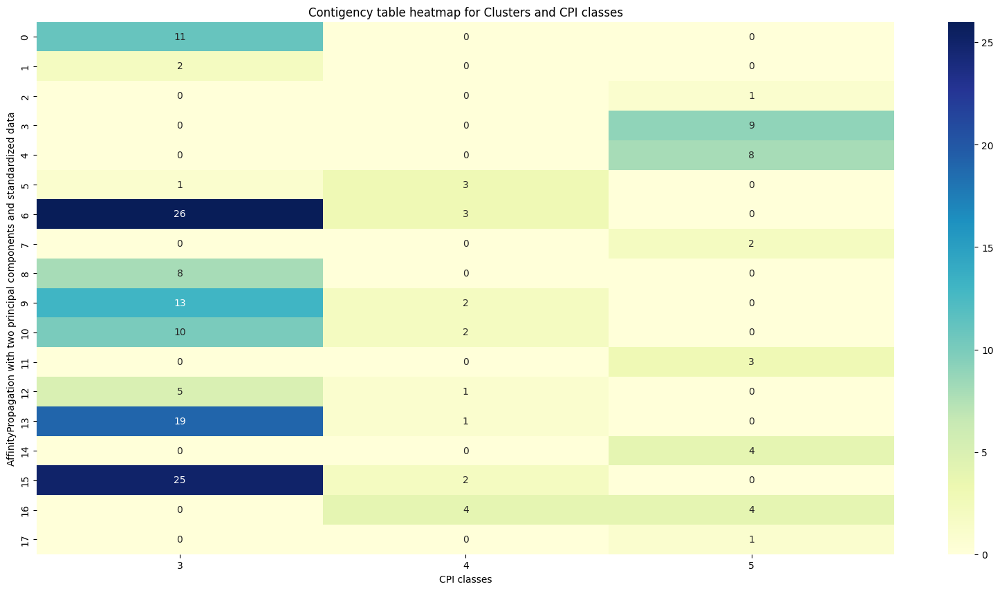

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


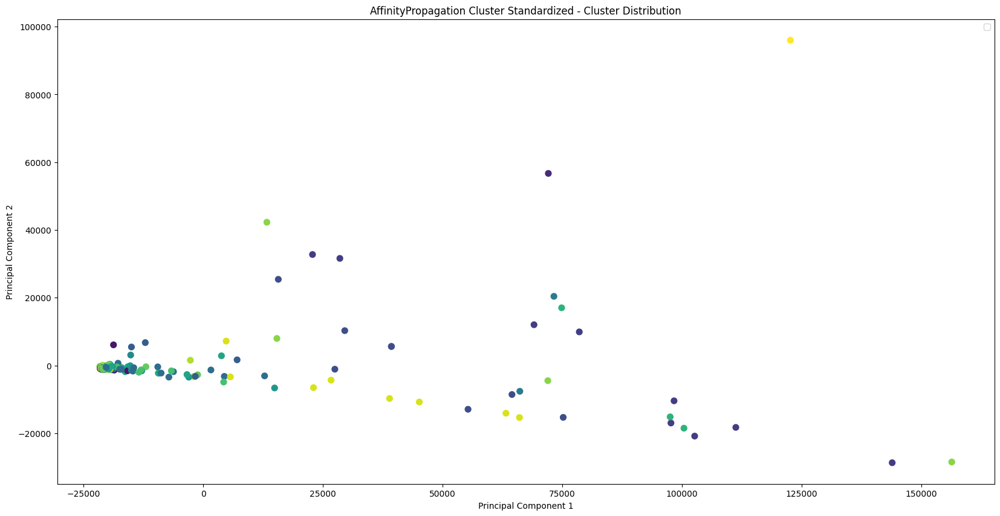

Apelare AffinityPropagation Standardized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare AffinityPropagation Normalized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
AffinityPropagation Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


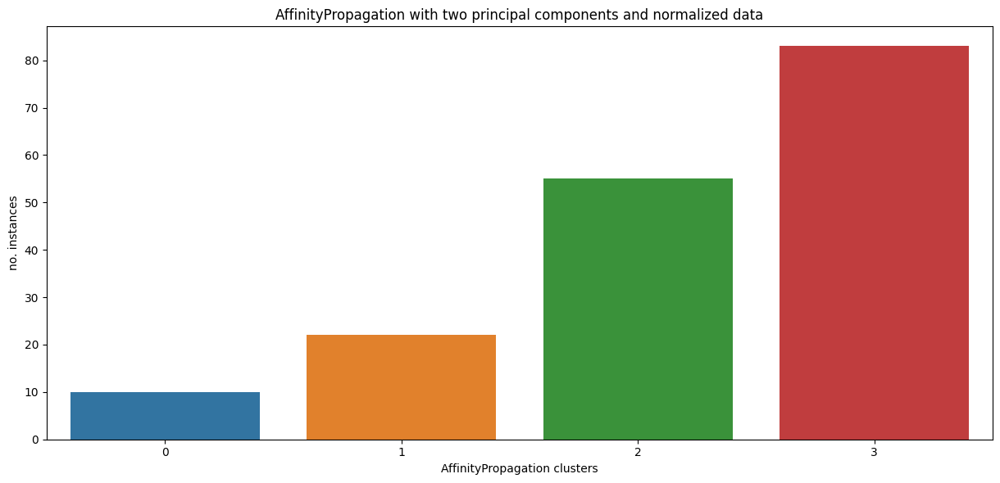

CPI                                      3  4   5
AffinityPropagation Cluster Normalized           
0                                        3  3   4
1                                        9  3  10
2                                       35  7  13
3                                       73  5   5


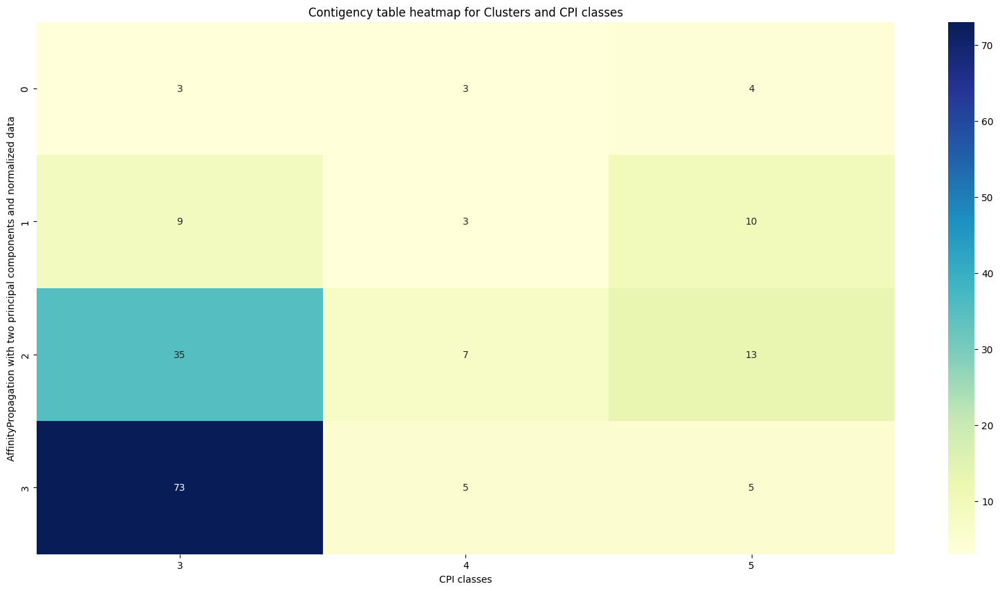

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


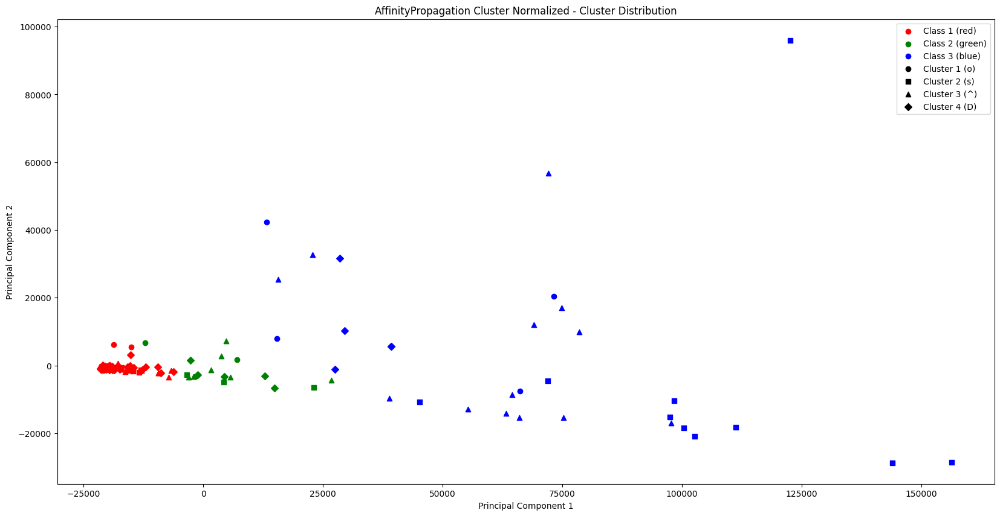

Apelare AffinityPropagation Normalized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare MeanShift Raw


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


MeanShift Cluster Raw Cluster size distribution


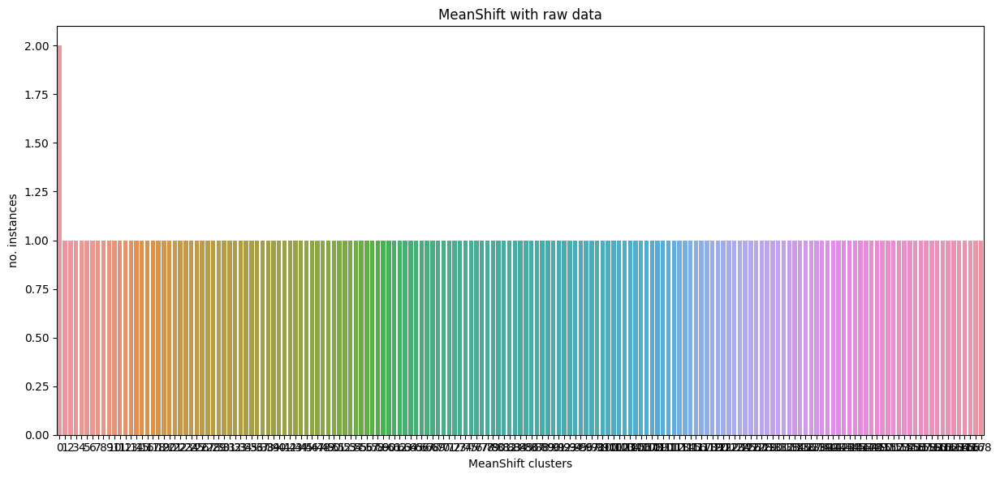

CPI                    3  4  5
MeanShift Cluster Raw         
0                      0  0  2
1                      1  0  0
2                      0  0  1
3                      1  0  0
4                      0  0  1
...                   .. .. ..
164                    0  0  1
165                    1  0  0
166                    0  1  0
167                    1  0  0
168                    1  0  0

[169 rows x 3 columns]


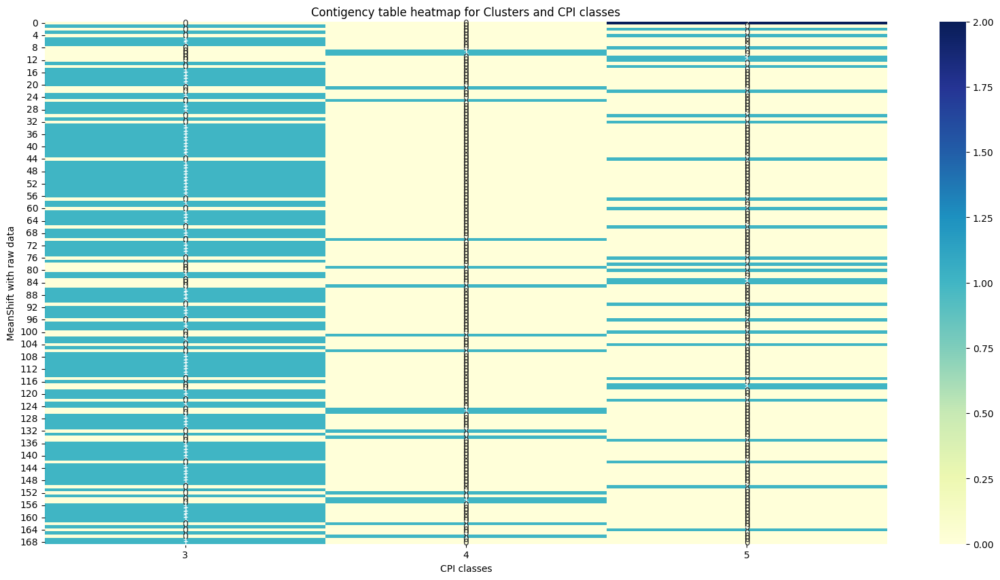

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


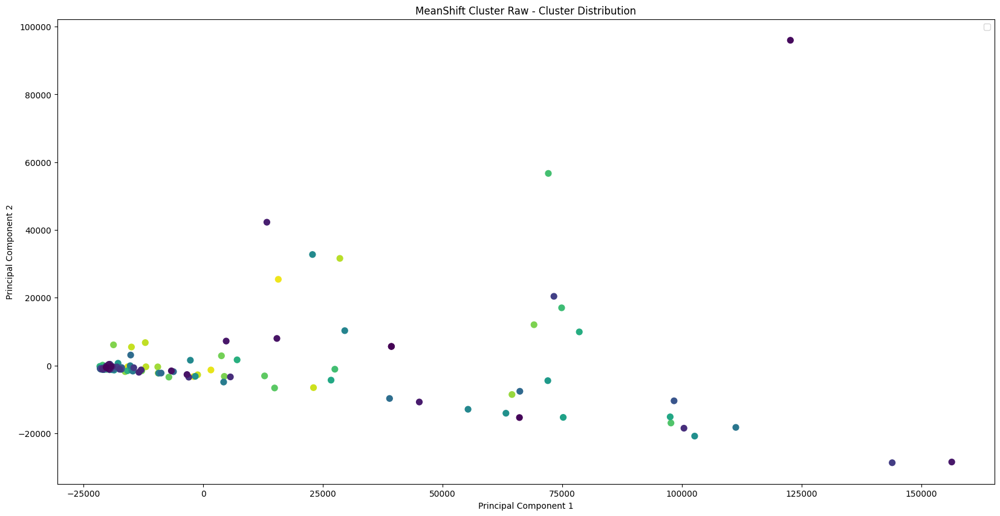

Apelare MeanShift Standardized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
MeanShift Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


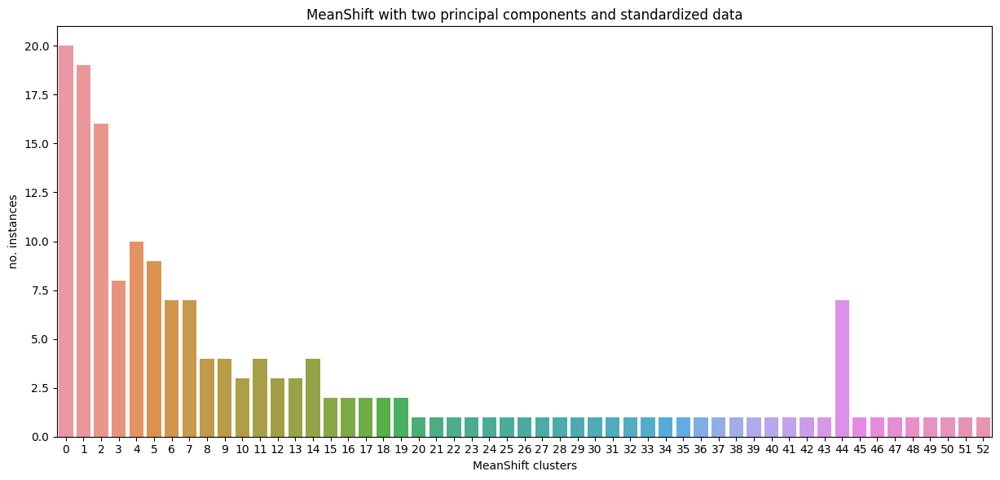

CPI                              3  4  5
MeanShift Cluster Standardized          
0                               17  3  0
1                               18  1  0
2                               15  1  0
3                                8  0  0
4                                8  2  0
5                                8  1  0
6                                7  0  0
7                                7  0  0
8                                0  3  1
9                                0  1  3
10                               3  0  0
11                               2  1  1
12                               0  0  3
13                               2  1  0
14                               4  0  0
15                               2  0  0
16                               1  1  0
17                               0  0  2
18                               2  0  0
19                               0  0  2
20                               0  0  1
21                               0  0  1
22              

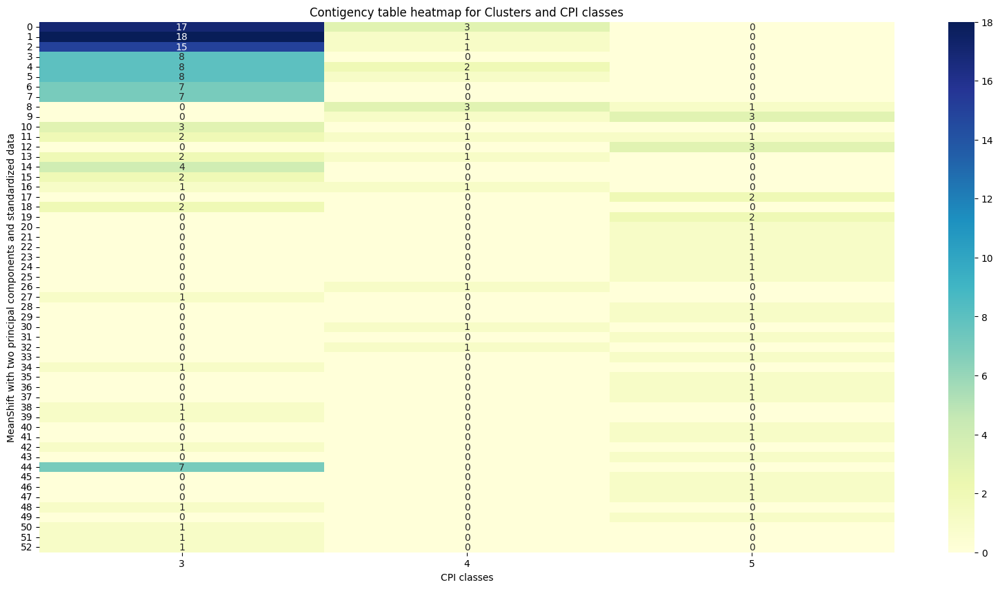

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


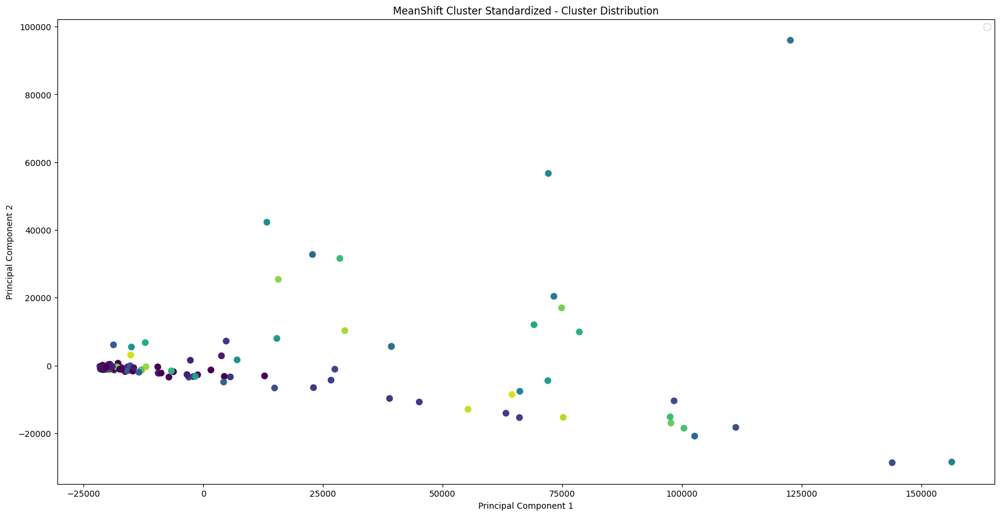

Apelare MeanShift Standardized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare MeanShift Normalized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
MeanShift Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


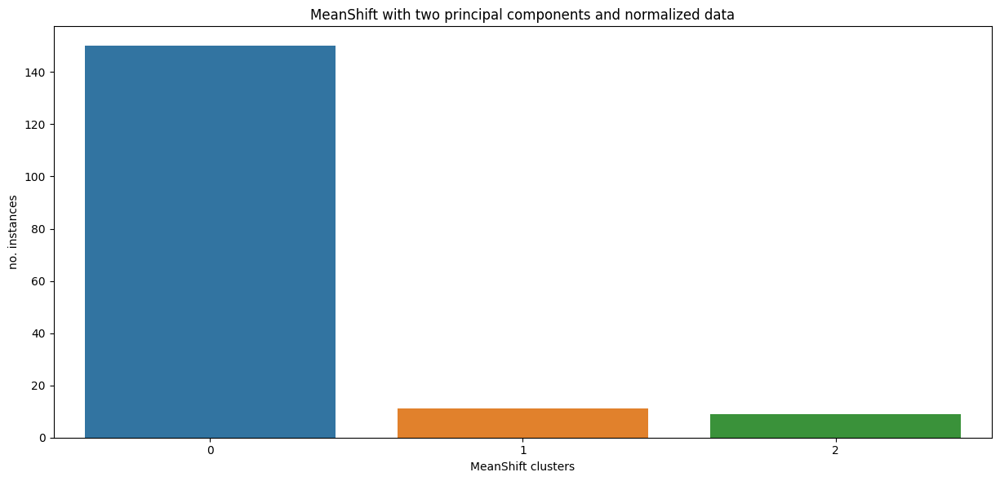

CPI                             3   4   5
MeanShift Cluster Normalized             
0                             114  14  22
1                               4   3   4
2                               2   1   6


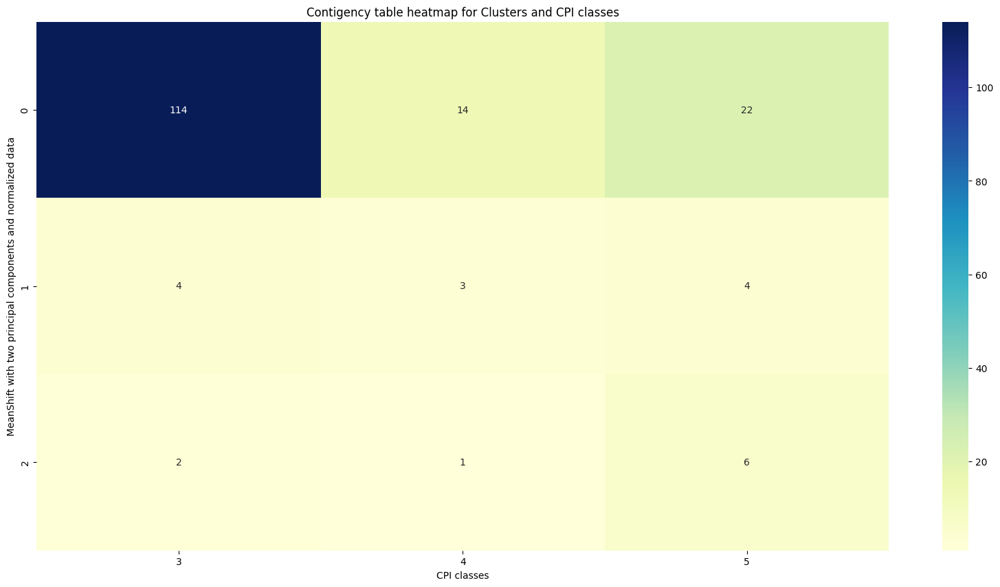

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


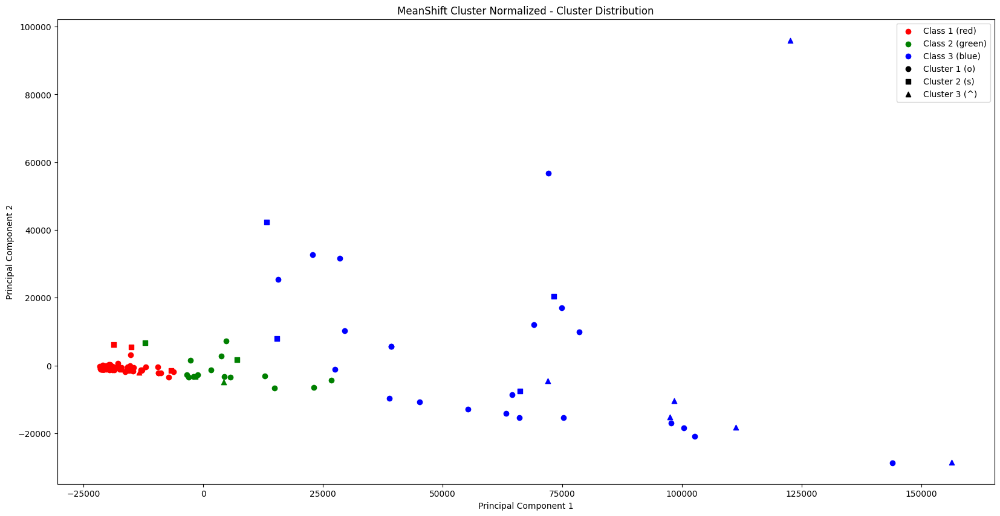

Apelare MeanShift Normalized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare KMeans with 3 clusters Raw
KMeans with 3 clusters Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: Futu

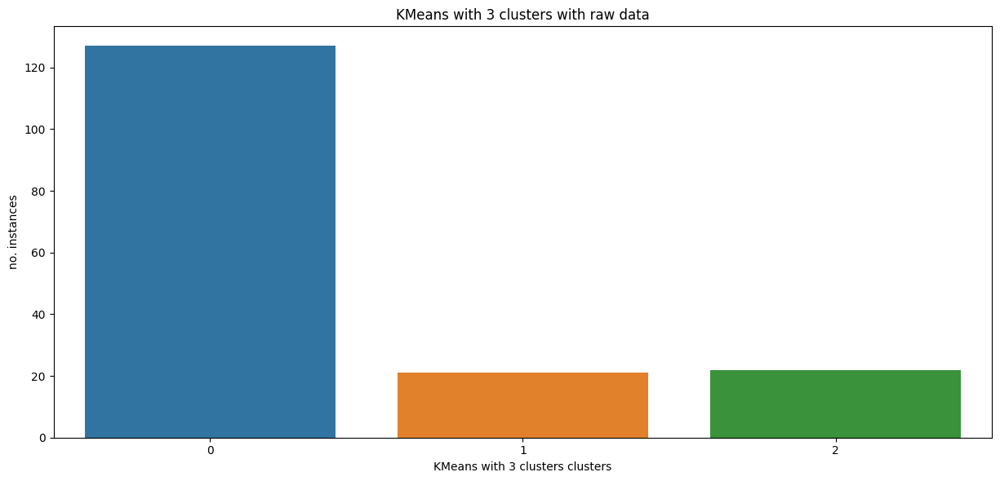

CPI                                   3   4   5
KMeans with 3 clusters Cluster Raw             
0                                   120   7   0
1                                     0   0  21
2                                     0  11  11


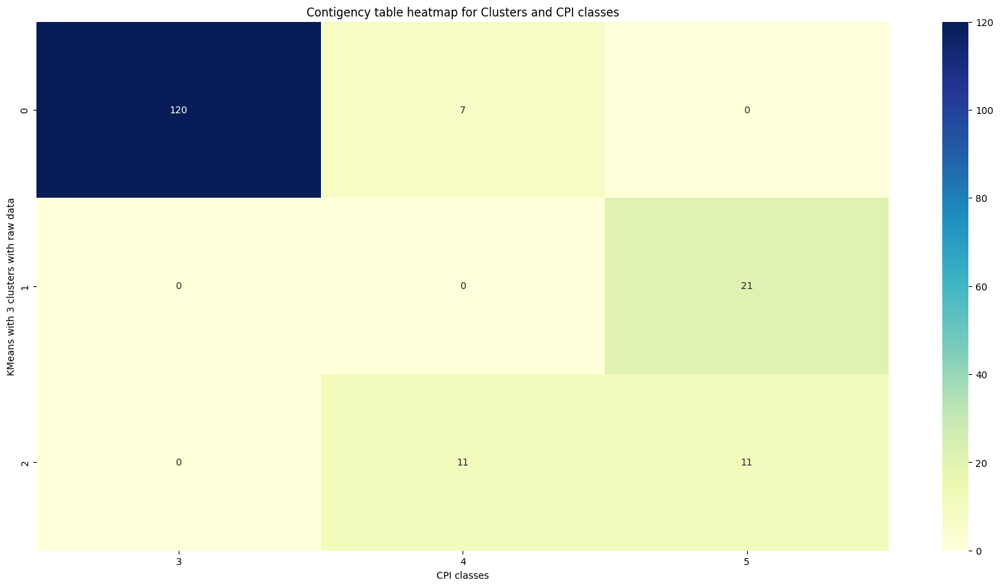

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


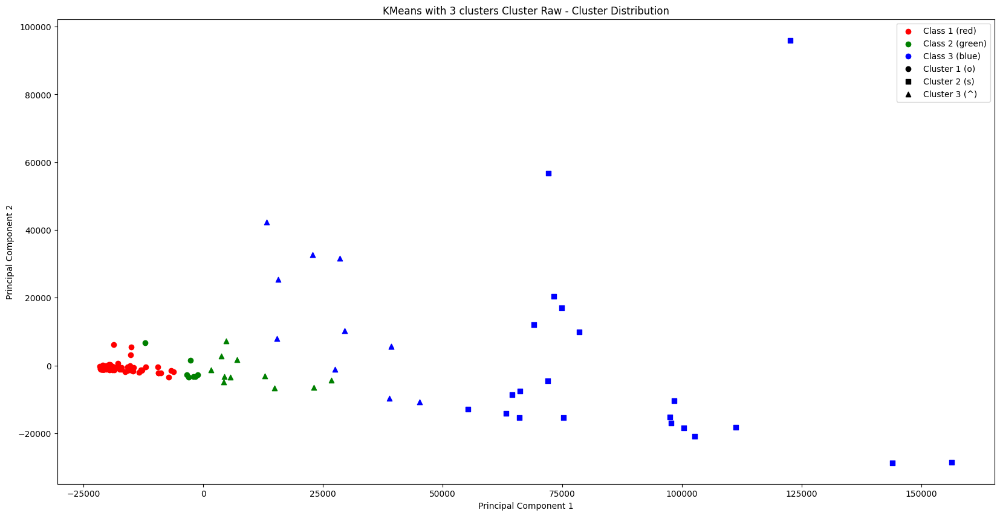

Apelare KMeans with 3 clusters Standardized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
KMeans with 3 clusters Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: Futu

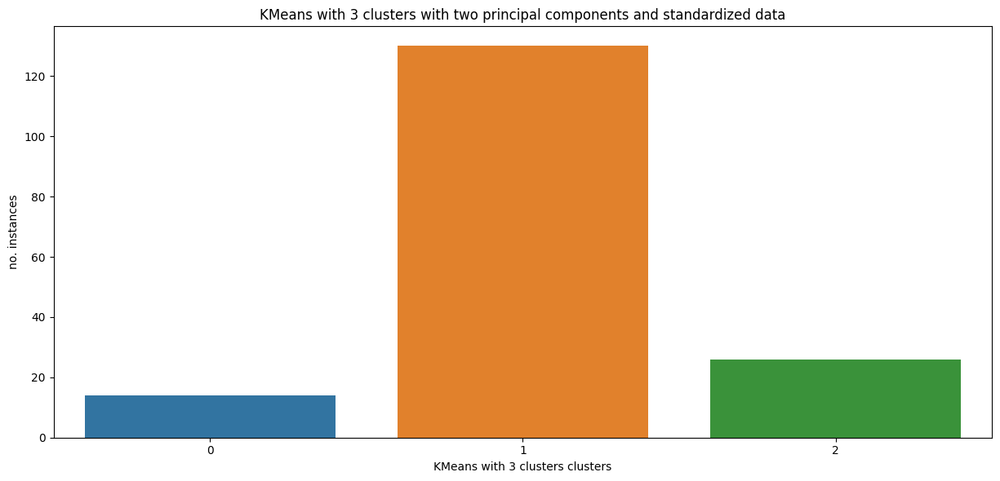

CPI                                            3   4   5
KMeans with 3 clusters Cluster Standardized             
0                                              5   4   5
1                                            115  14   1
2                                              0   0  26


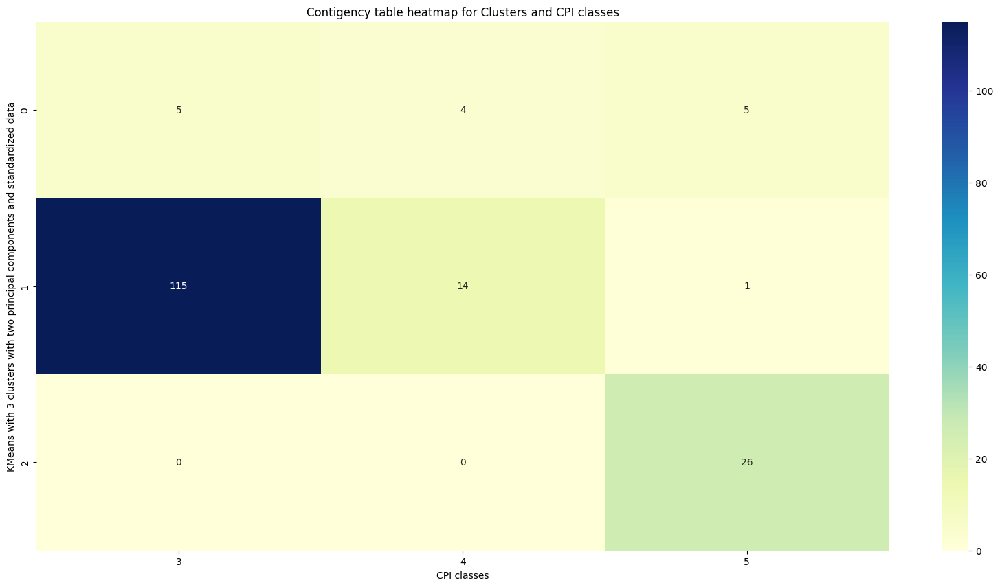

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


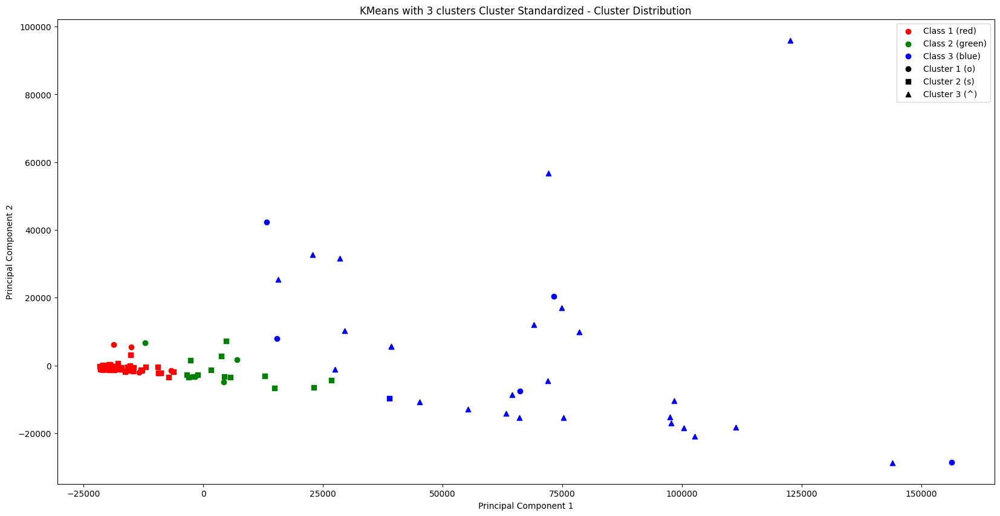

Apelare KMeans with 3 clusters Standardized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare KMeans with 3 clusters Normalized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
KMeans with 3 clusters Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_ol

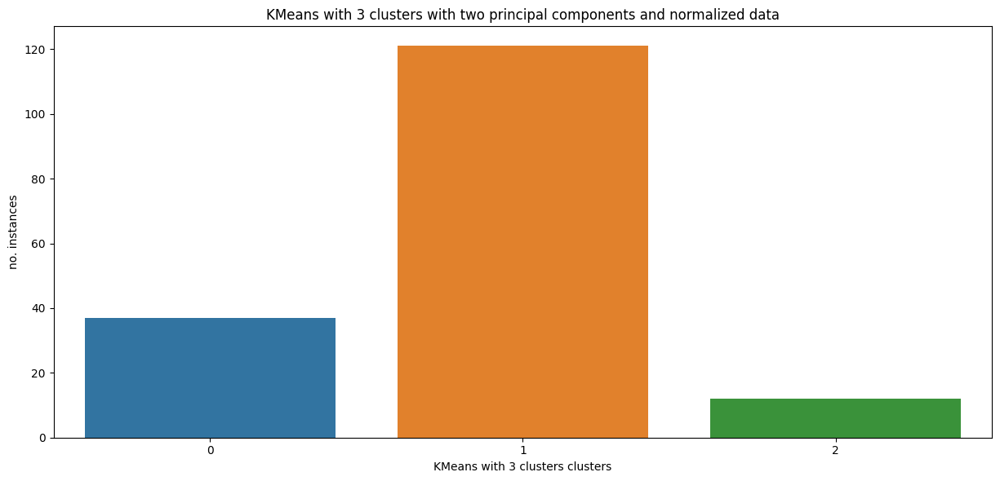

CPI                                         3   4   5
KMeans with 3 clusters Cluster Normalized            
0                                          22   5  10
1                                          94  10  17
2                                           4   3   5


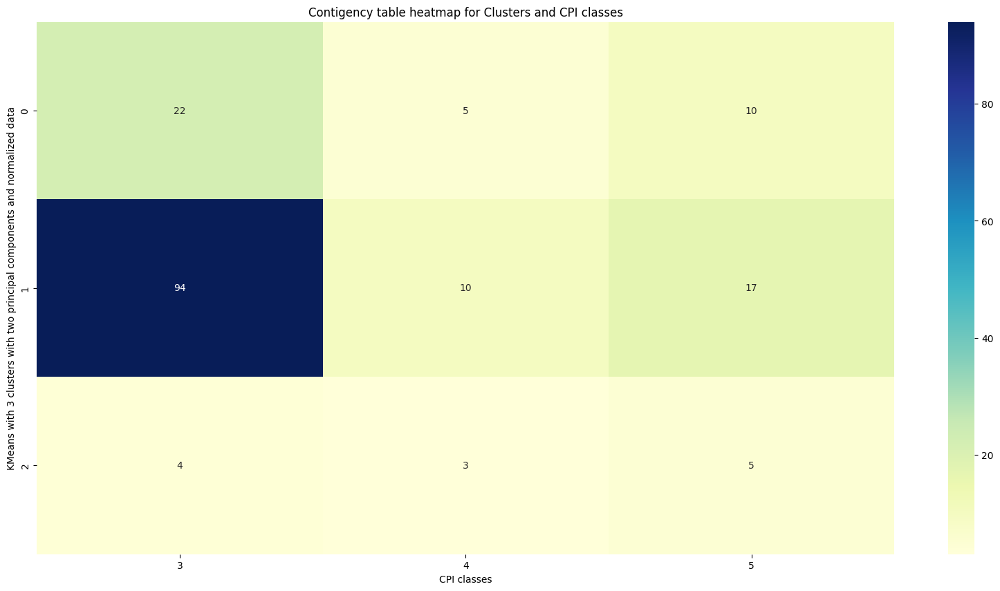

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


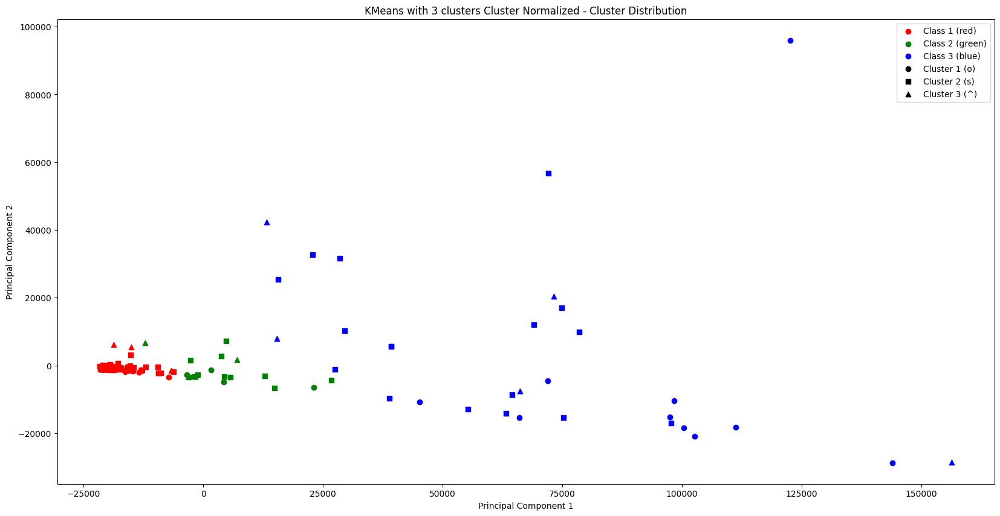

Apelare KMeans with 3 clusters Normalized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare KMeans with 4 clusters Raw
KMeans with 4 clusters Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_ol

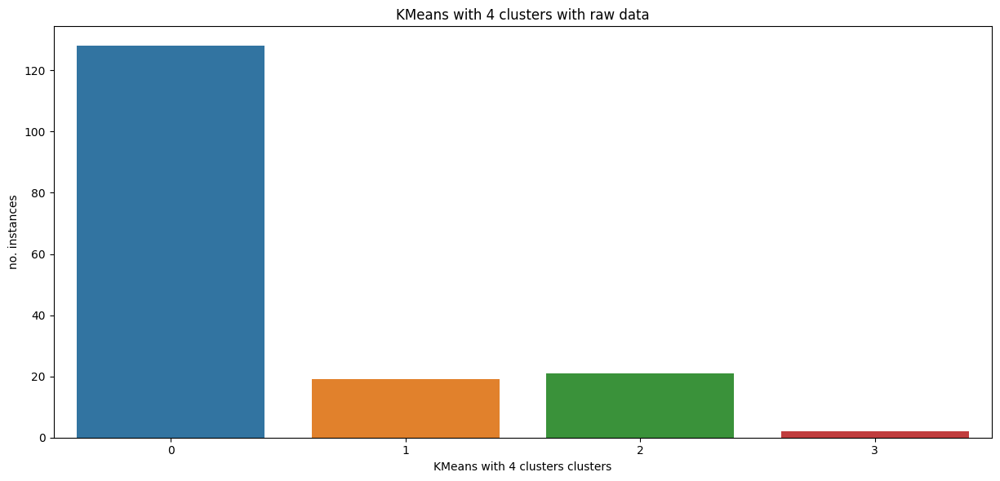

CPI                                   3   4   5
KMeans with 4 clusters Cluster Raw             
0                                   120   8   0
1                                     0   0  19
2                                     0  10  11
3                                     0   0   2


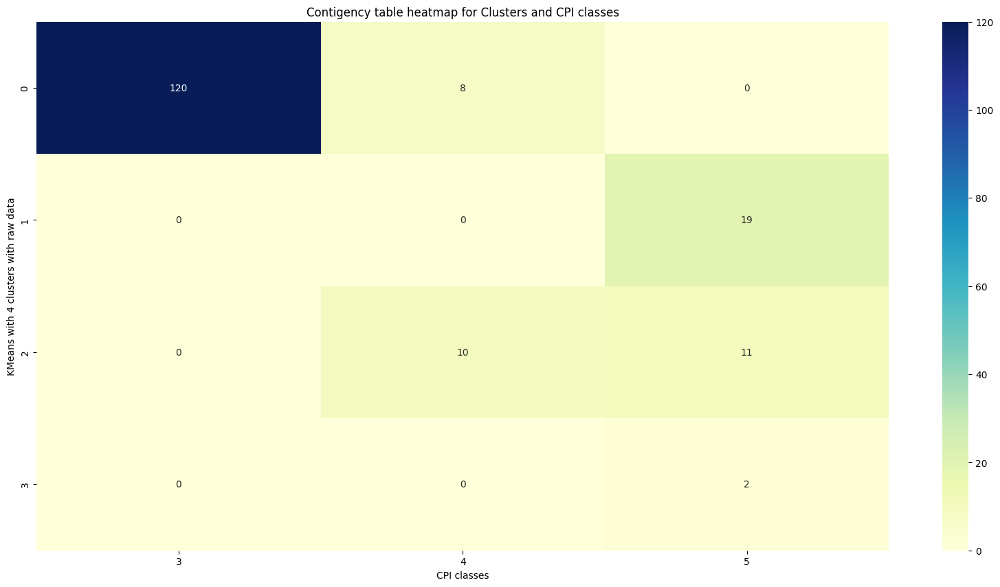

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


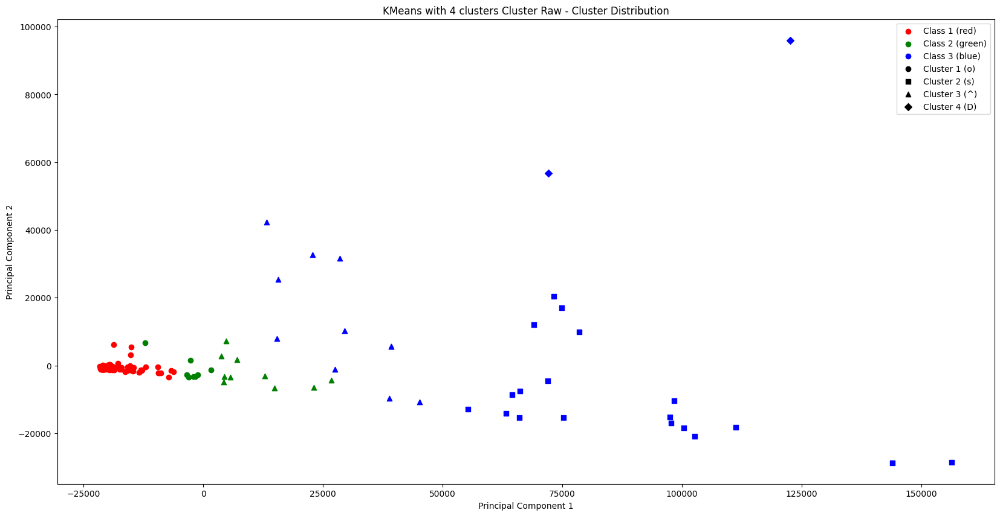

Apelare KMeans with 4 clusters Standardized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
KMeans with 4 clusters Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: Futu

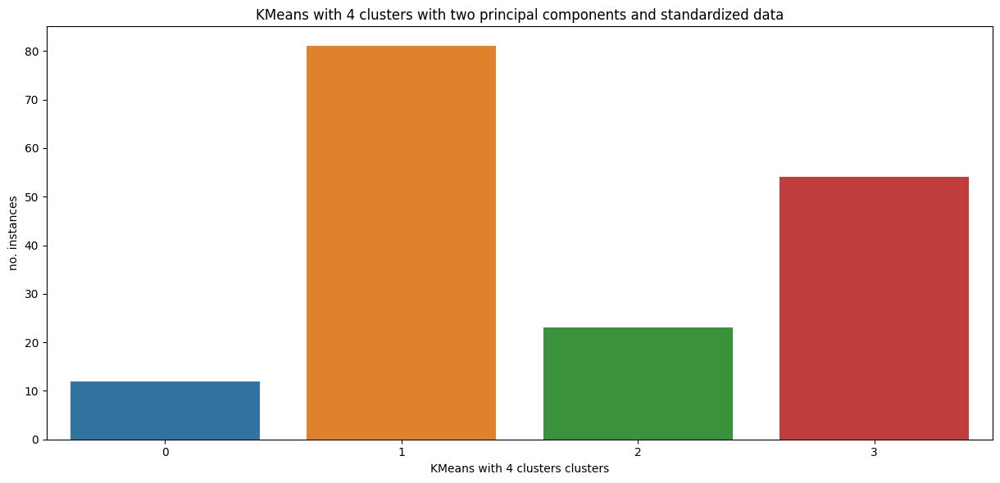

CPI                                           3  4   5
KMeans with 4 clusters Cluster Standardized           
0                                             4  3   5
1                                            69  9   3
2                                             0  0  23
3                                            47  6   1


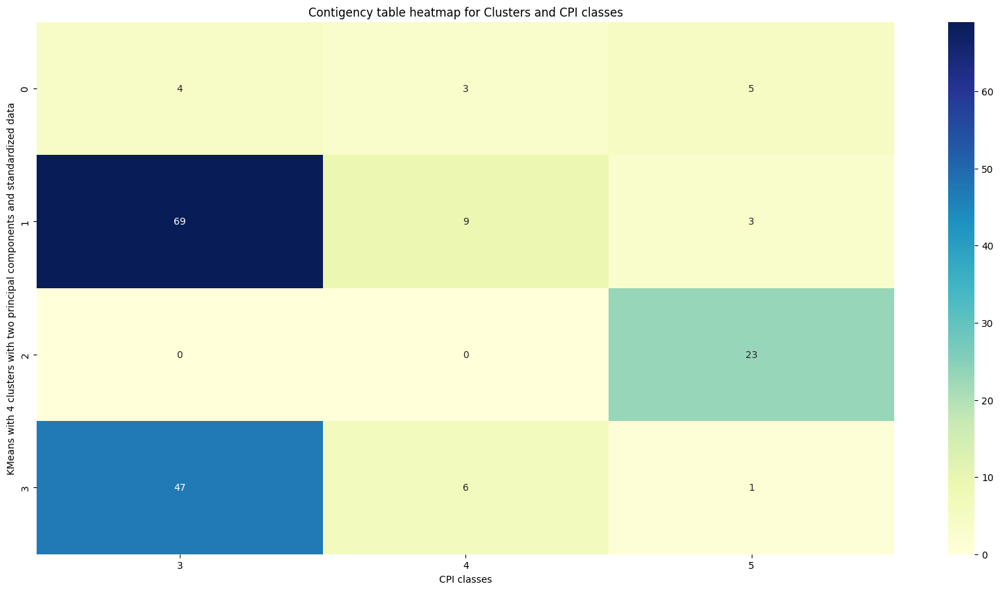

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


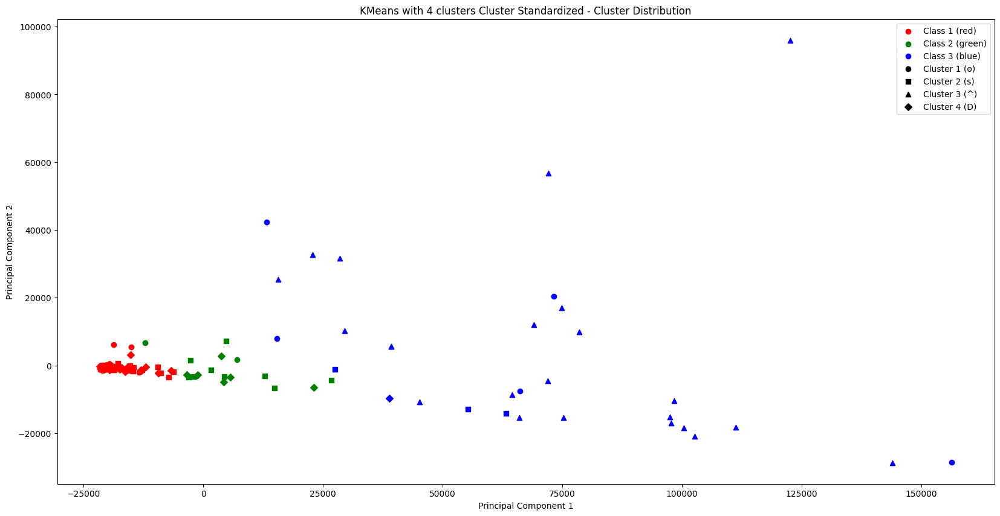

Apelare KMeans with 4 clusters Standardized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare KMeans with 4 clusters Normalized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
KMeans with 4 clusters Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_ol

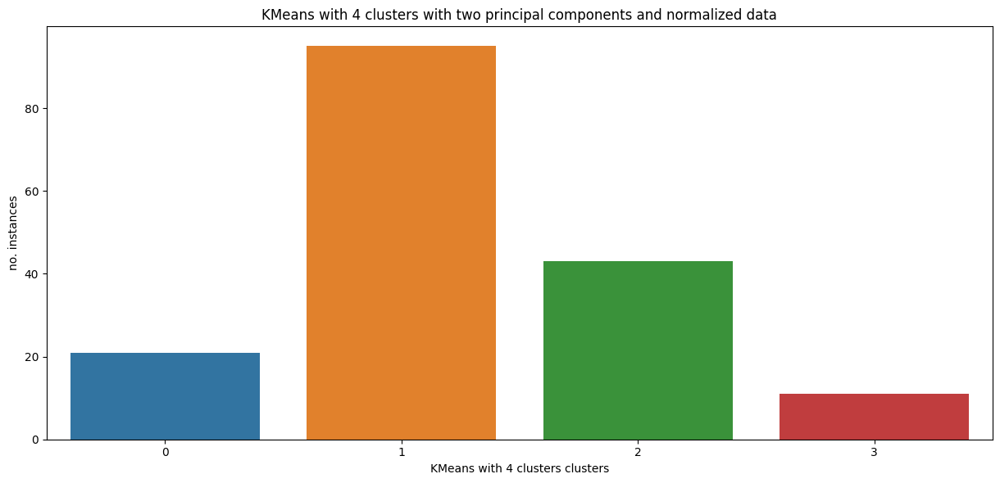

CPI                                         3  4   5
KMeans with 4 clusters Cluster Normalized           
0                                           8  3  10
1                                          80  8   7
2                                          28  4  11
3                                           4  3   4


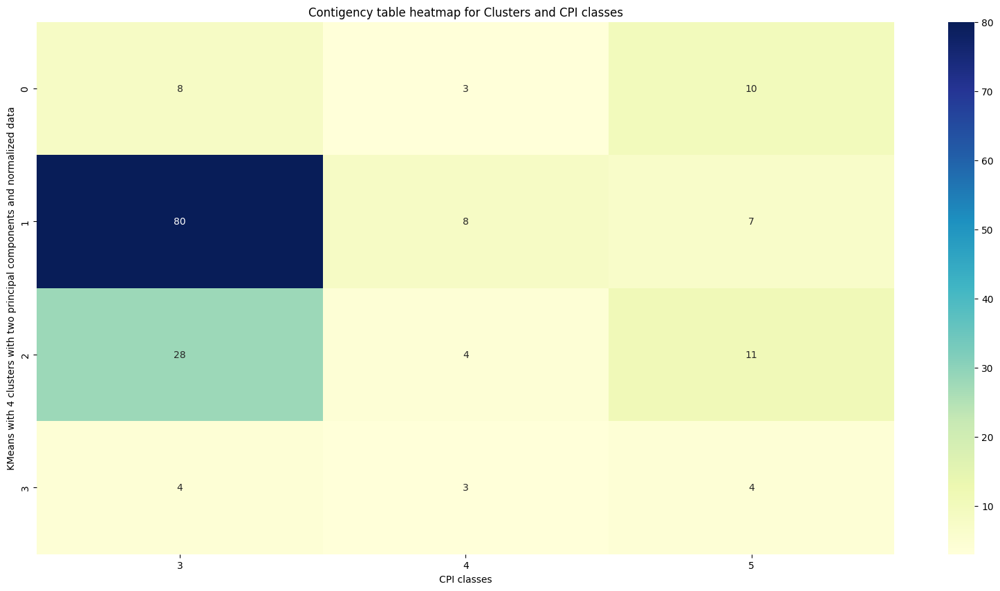

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


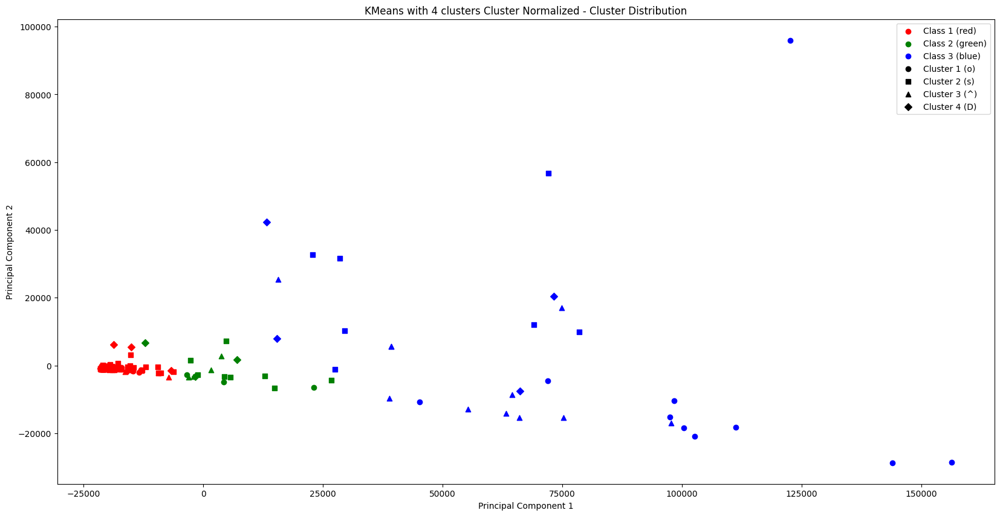

Apelare KMeans with 4 clusters Normalized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare AgglomerativeClustering with 3 clusters Raw
AgglomerativeClustering with 3 clusters Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: Futu

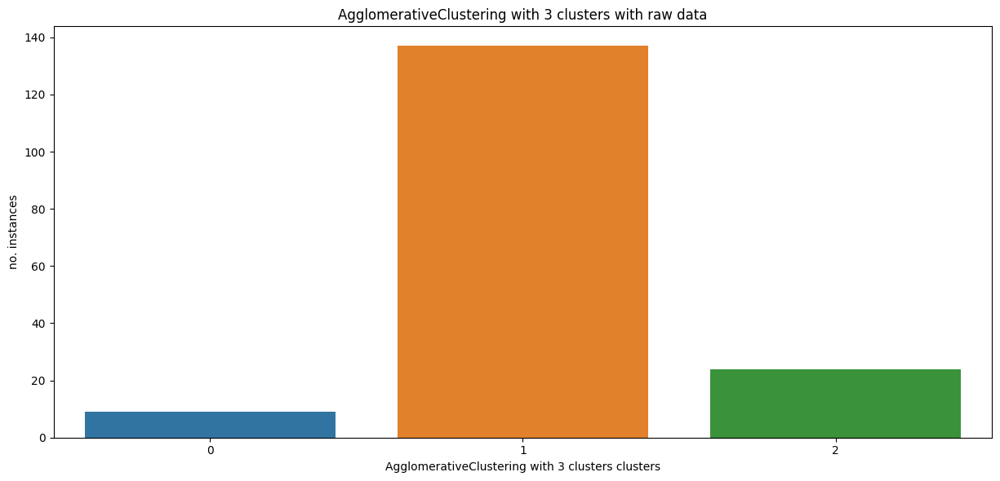

CPI                                                   3   4   5
AgglomerativeClustering with 3 clusters Cluster...             
0                                                     0   0   9
1                                                   120  16   1
2                                                     0   2  22


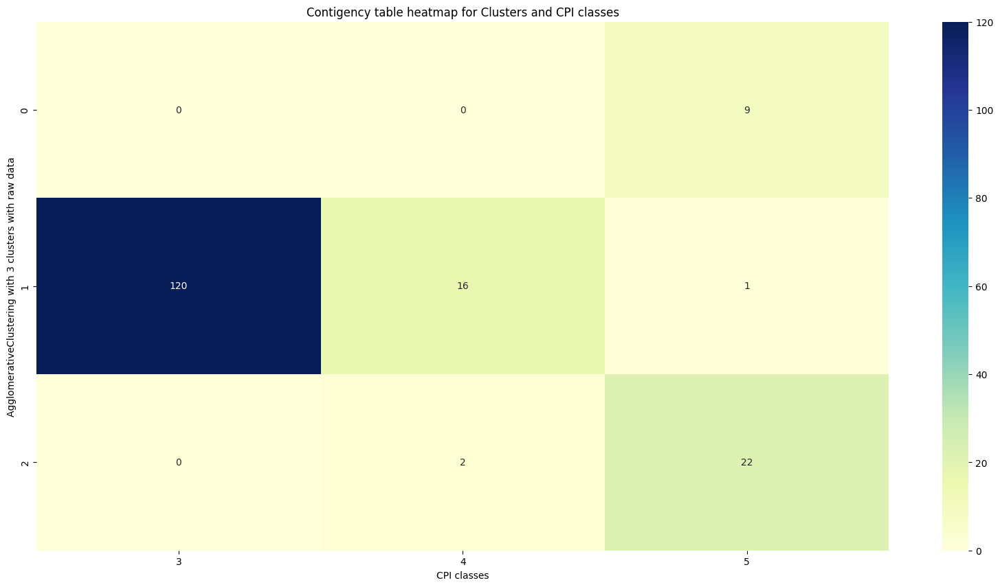

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


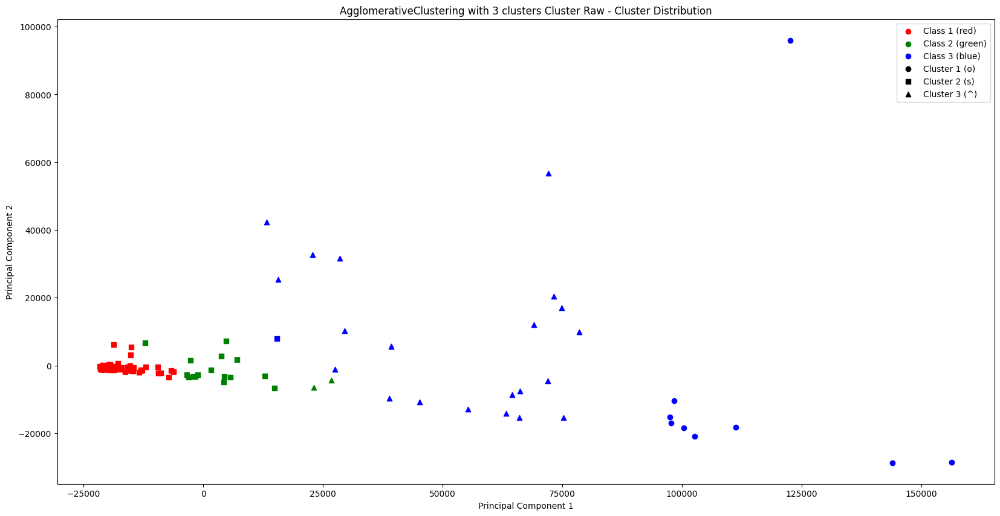

Apelare AgglomerativeClustering with 3 clusters Standardized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
AgglomerativeClustering with 3 clusters Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


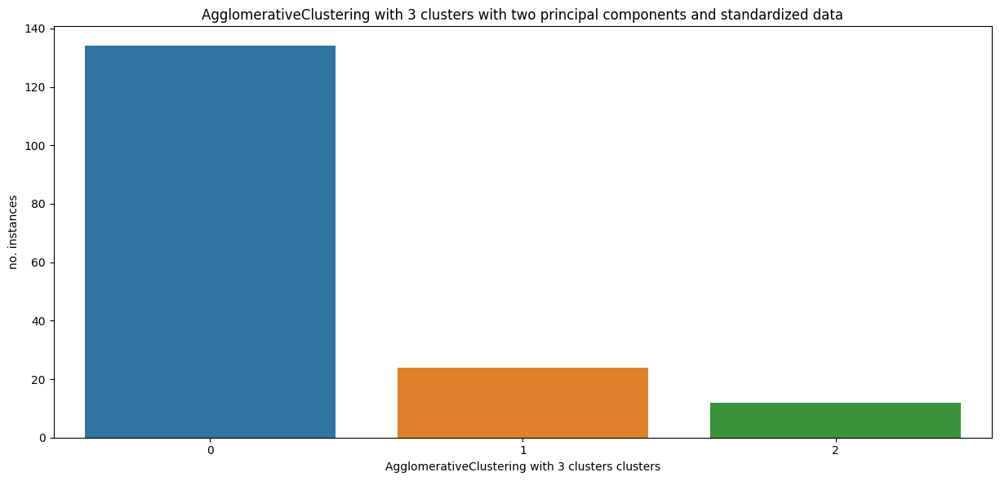

CPI                                                   3   4   5
AgglomerativeClustering with 3 clusters Cluster...             
0                                                   115  15   4
1                                                     2   0  22
2                                                     3   3   6


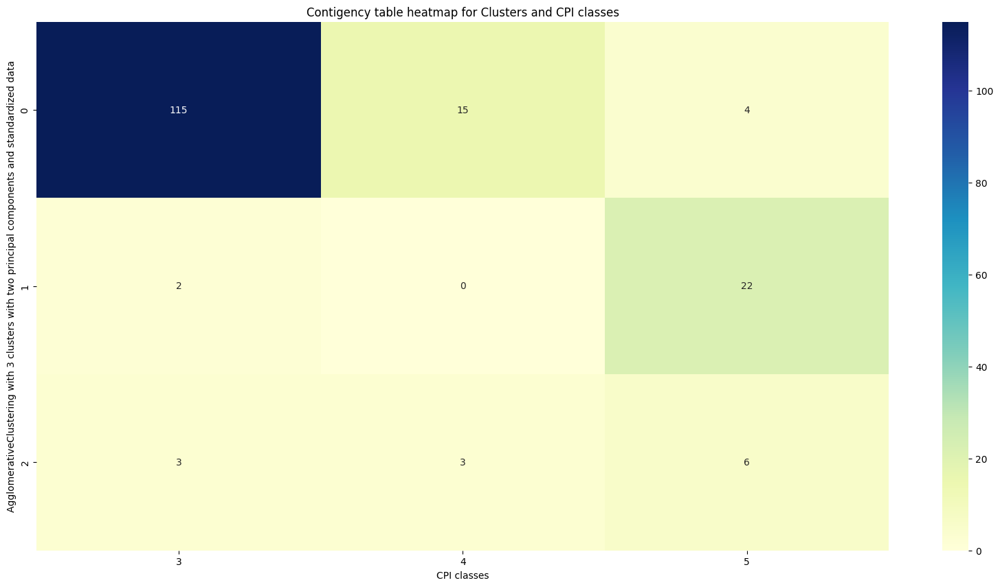

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


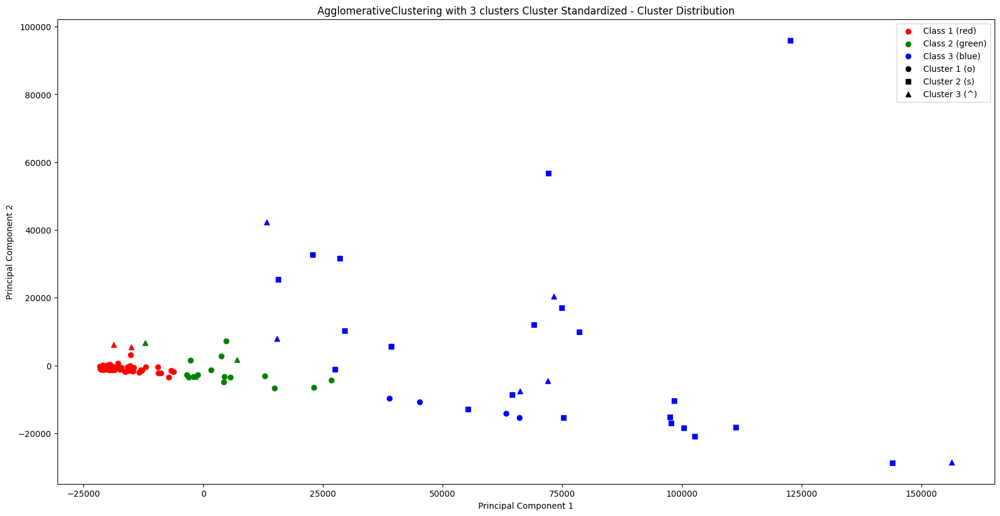

Apelare AgglomerativeClustering with 3 clusters Standardized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare AgglomerativeClustering with 3 clusters Normalized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
AgglomerativeClustering with 3 clusters Cluster Normalized C

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


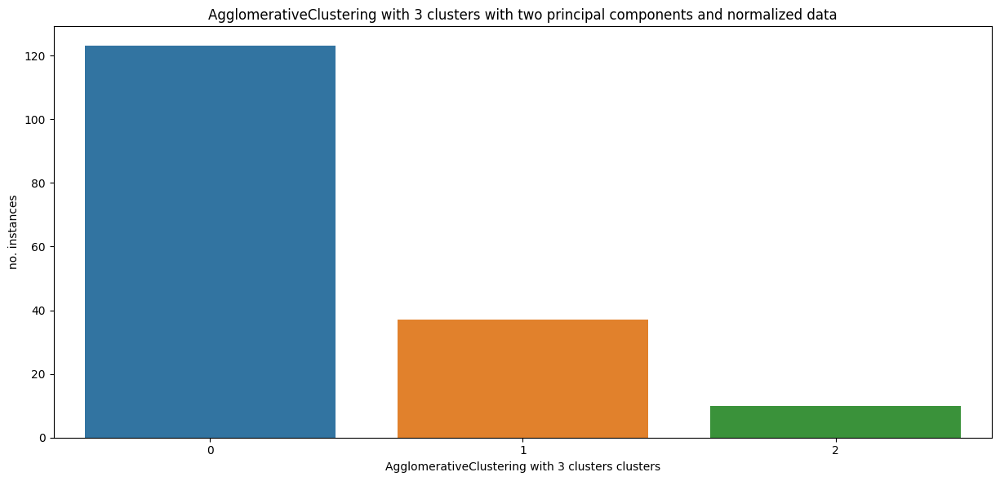

CPI                                                  3   4   5
AgglomerativeClustering with 3 clusters Cluster...            
0                                                   95  11  17
1                                                   22   4  11
2                                                    3   3   4


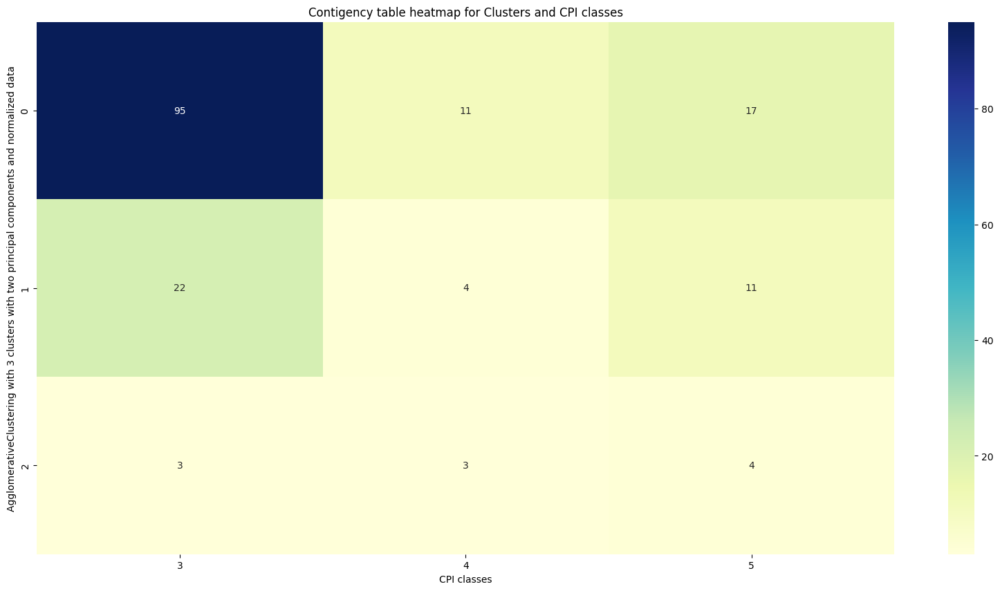

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


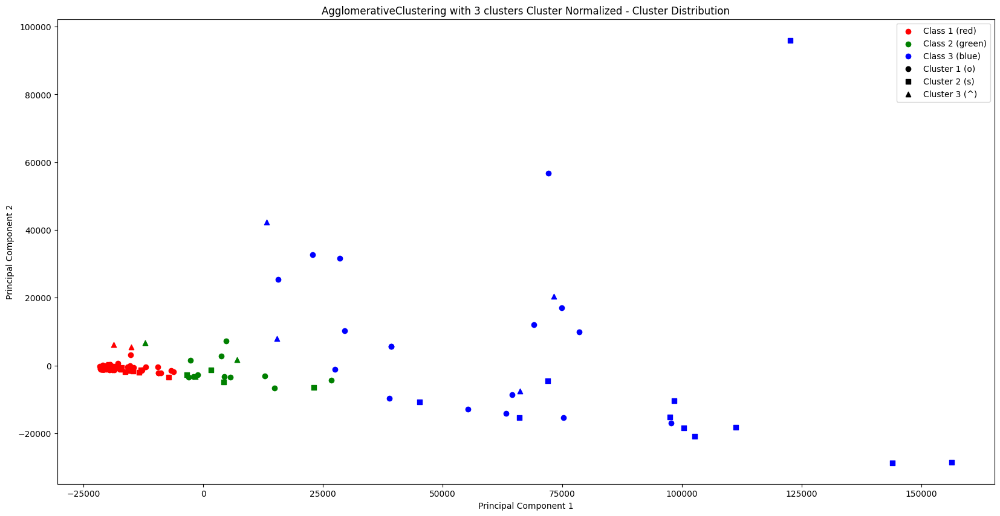

Apelare AgglomerativeClustering with 3 clusters Normalized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare AgglomerativeClustering with 4 clusters Raw
AgglomerativeClustering with 4 clusters Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


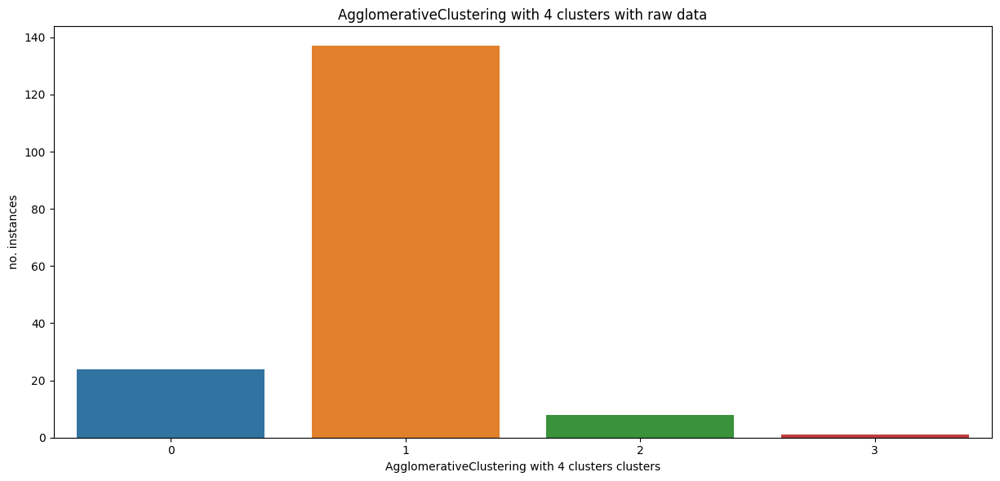

CPI                                                   3   4   5
AgglomerativeClustering with 4 clusters Cluster...             
0                                                     0   2  22
1                                                   120  16   1
2                                                     0   0   8
3                                                     0   0   1


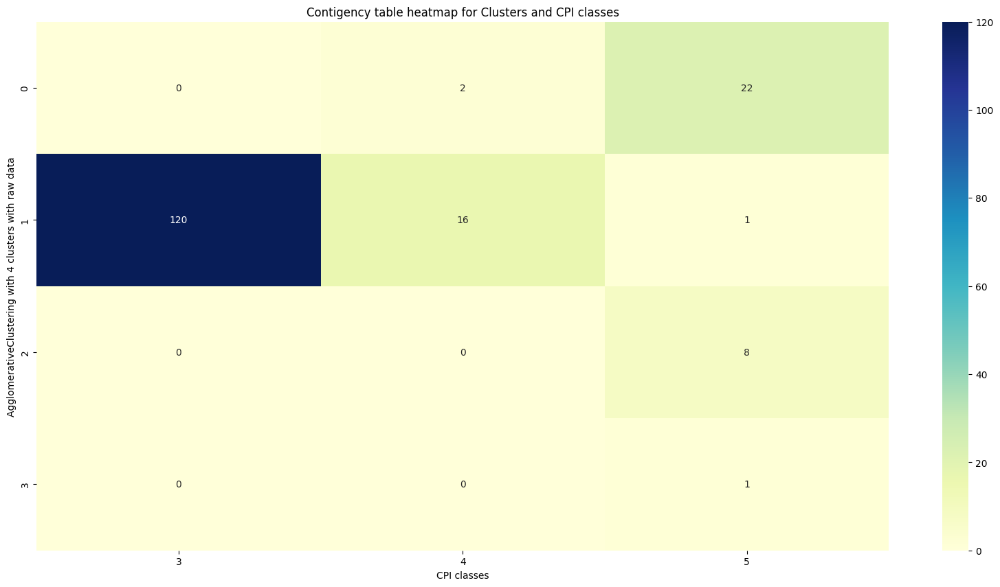

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


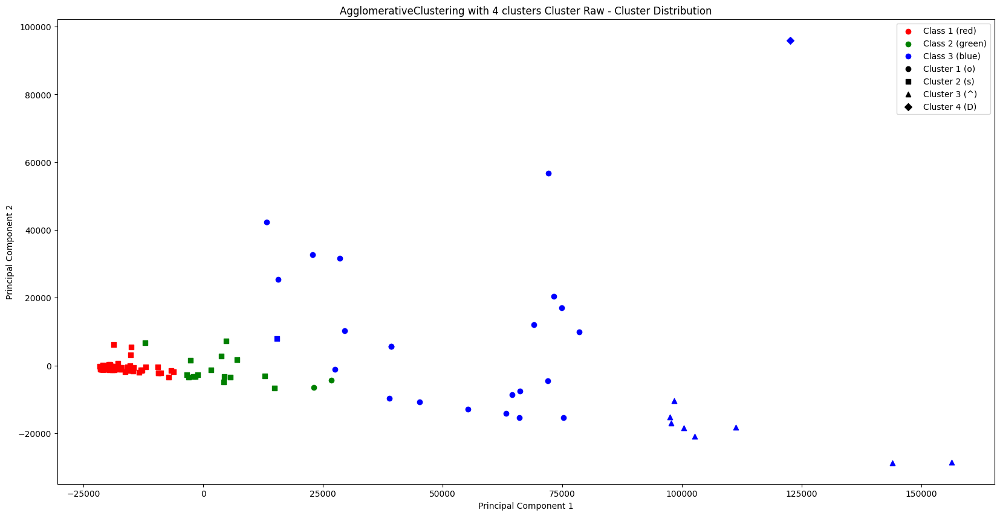

Apelare AgglomerativeClustering with 4 clusters Standardized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
AgglomerativeClustering with 4 clusters Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


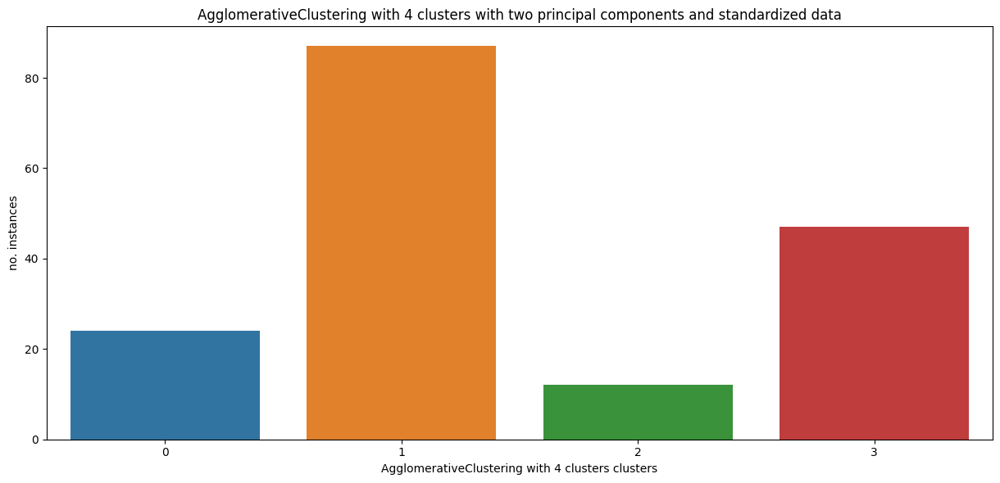

CPI                                                  3   4   5
AgglomerativeClustering with 4 clusters Cluster...            
0                                                    2   0  22
1                                                   72  11   4
2                                                    3   3   6
3                                                   43   4   0


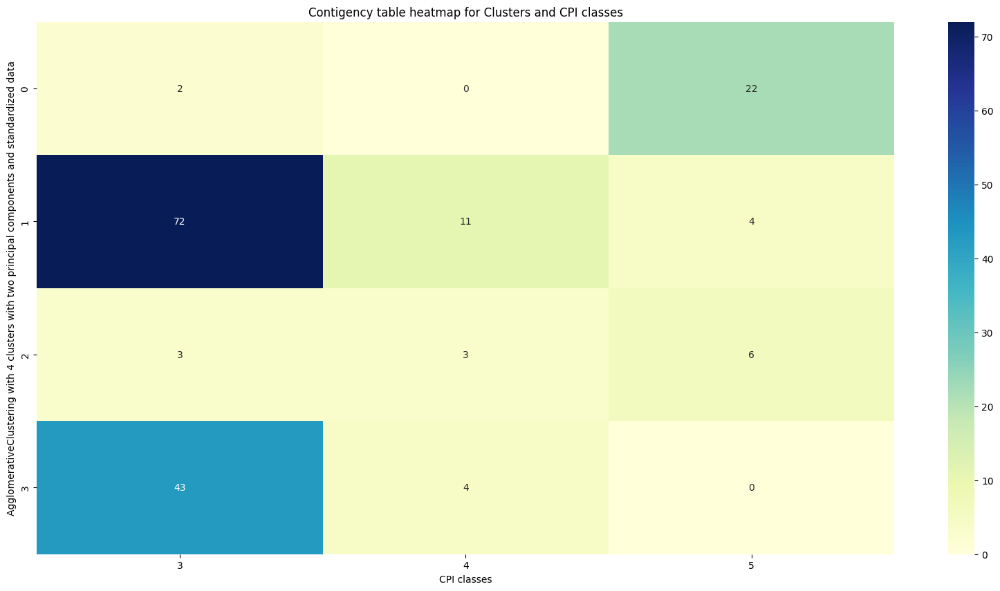

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


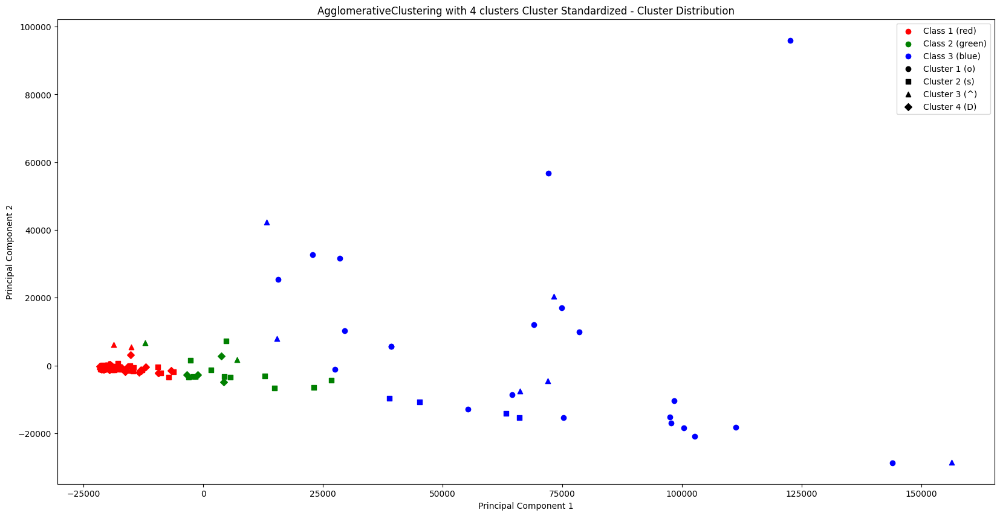

Apelare AgglomerativeClustering with 4 clusters Standardized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare AgglomerativeClustering with 4 clusters Normalized
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
AgglomerativeClustering with 4 clusters Cluster Normalized C

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


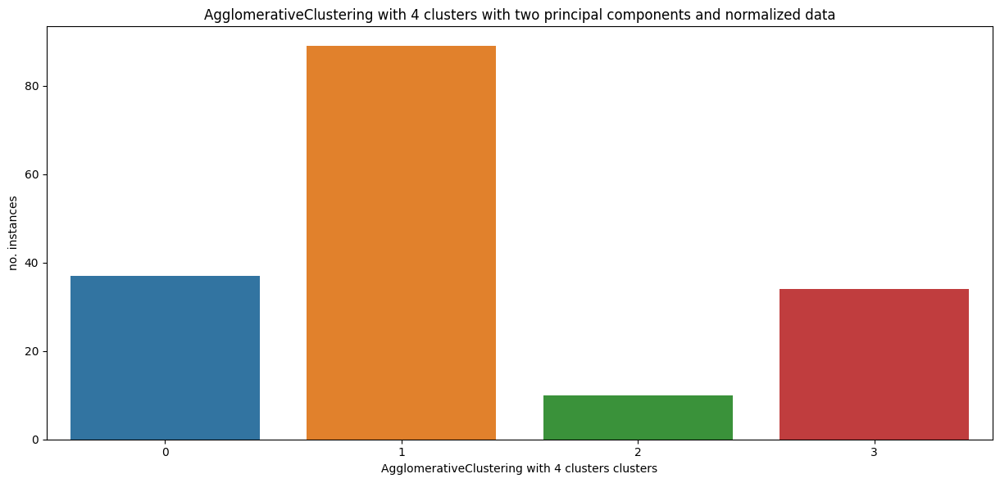

CPI                                                  3  4   5
AgglomerativeClustering with 4 clusters Cluster...           
0                                                   22  4  11
1                                                   73  7   9
2                                                    3  3   4
3                                                   22  4   8


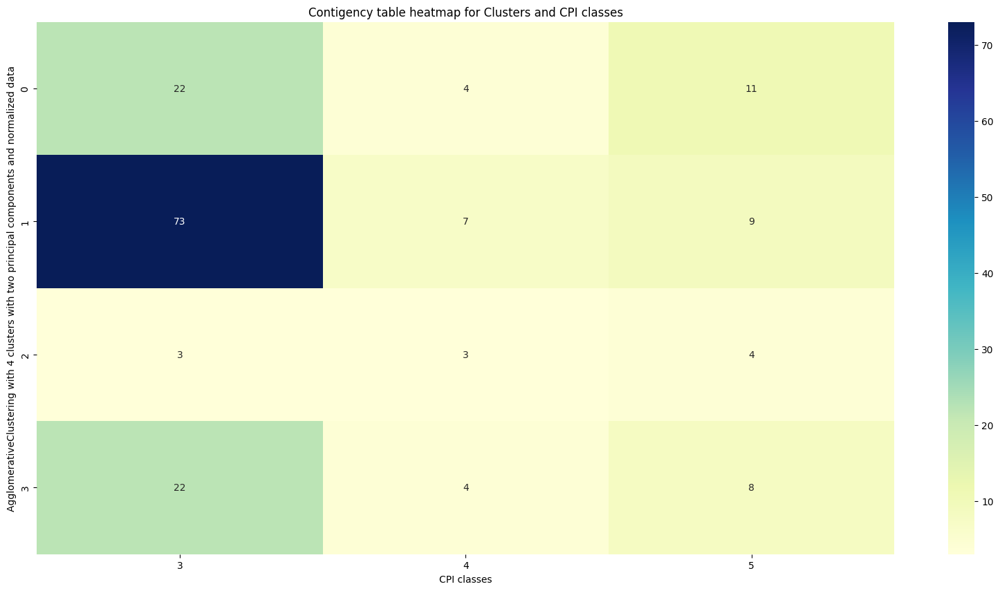

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


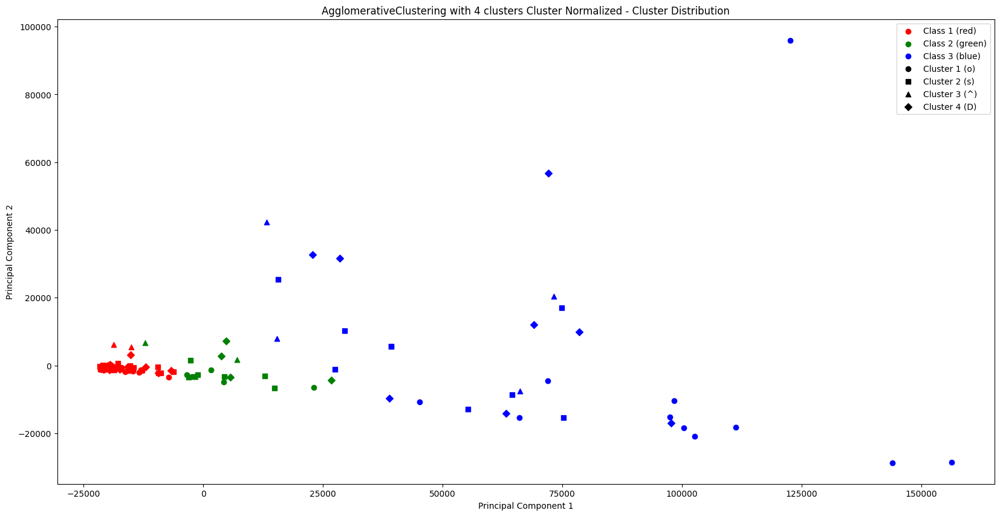

Apelare AgglomerativeClustering with 4 clusters Normalized 3 PCA
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  


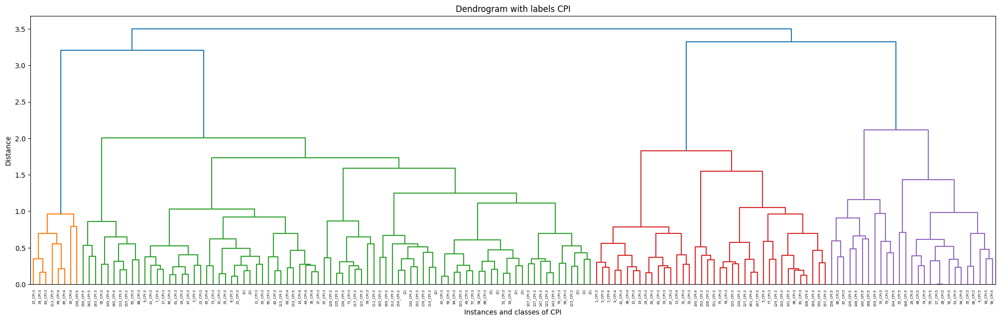

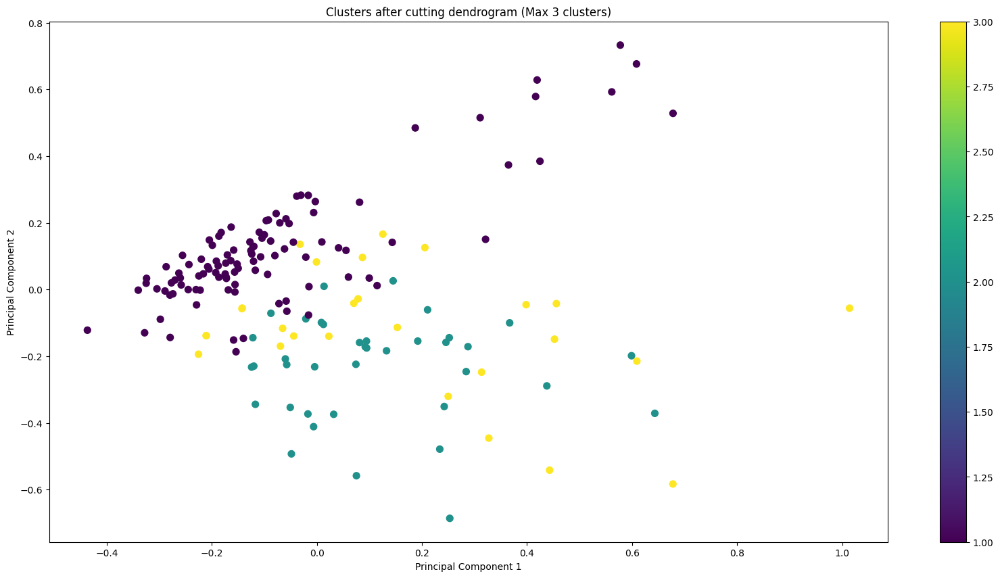

Metrics:
                                                    Silhouette Score  \
DBSCAN Raw                                                  0.380171   
DBSCAN Standardized                                        -0.342631   
DBSCAN Standardized 3 PCA                                  -0.595917   
OPTICS Raw                                                 -0.322364   
OPTICS Standardized                                        -0.516473   
OPTICS Standardized 3 PCA                                  -0.475606   
OPTICS Normalized                                          -0.483935   
OPTICS Normalized 3 PCA                                    -0.501382   
AffinityPropagation Raw                                     0.011765   
AffinityPropagation Standardized                           -0.429296   
AffinityPropagation Standardized 3 PCA                     -0.489053   
AffinityPropagation Normalized                              0.068073   
AffinityPropagation Normalized 3 PCA                   

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


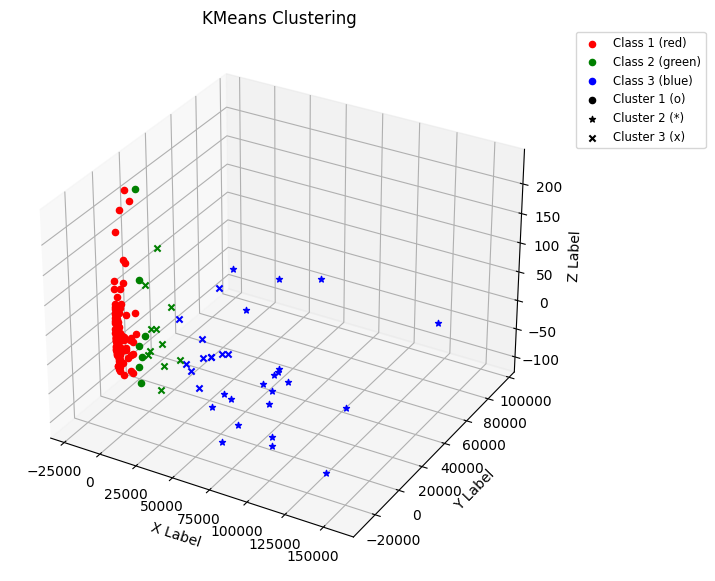

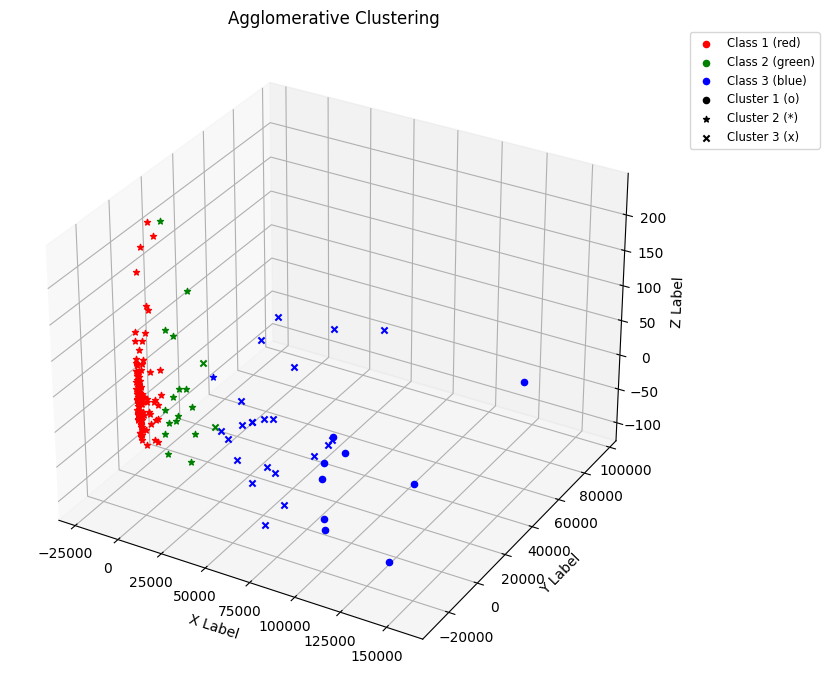

----------------------------------------------------------------------------------------------------
-----------------------------------------Standardized 3 PCA-----------------------------------------
----------------------------------------------------------------------------------------------------
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


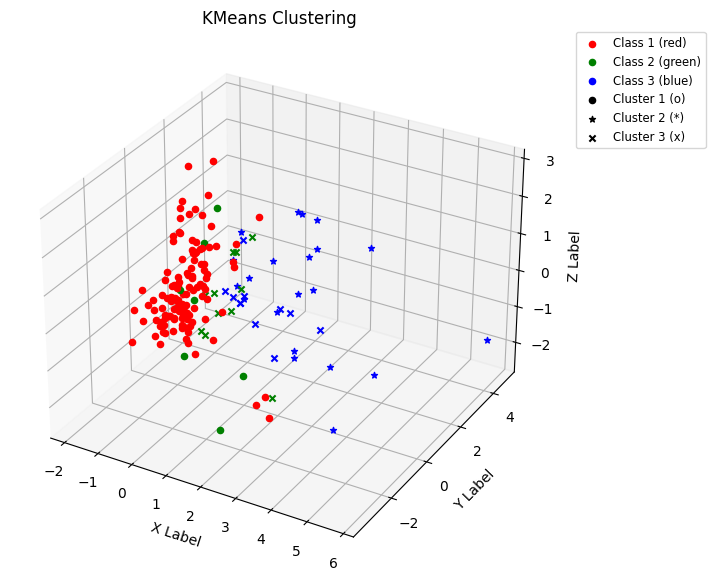

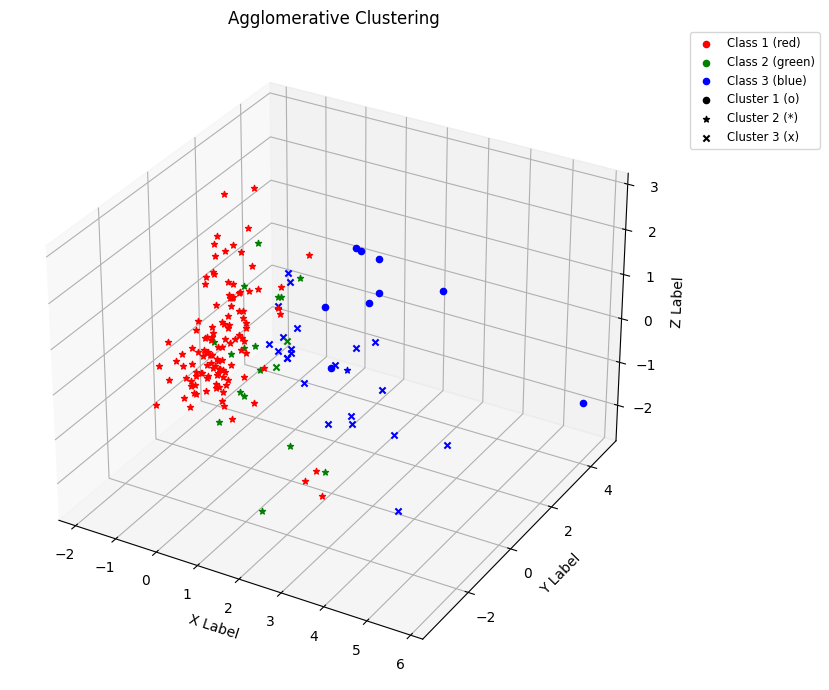

----------------------------------------------------------------------------------------------------
------------------------------------------Normalized 3 PCA------------------------------------------
----------------------------------------------------------------------------------------------------
         Temp       pH   Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


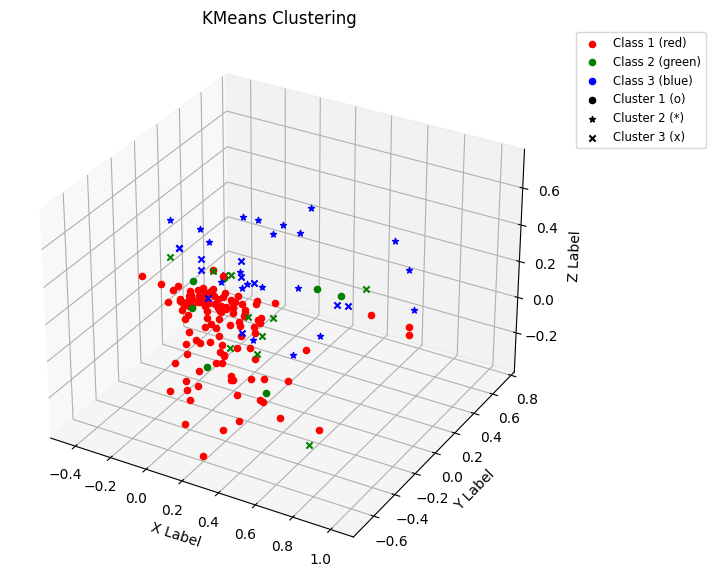

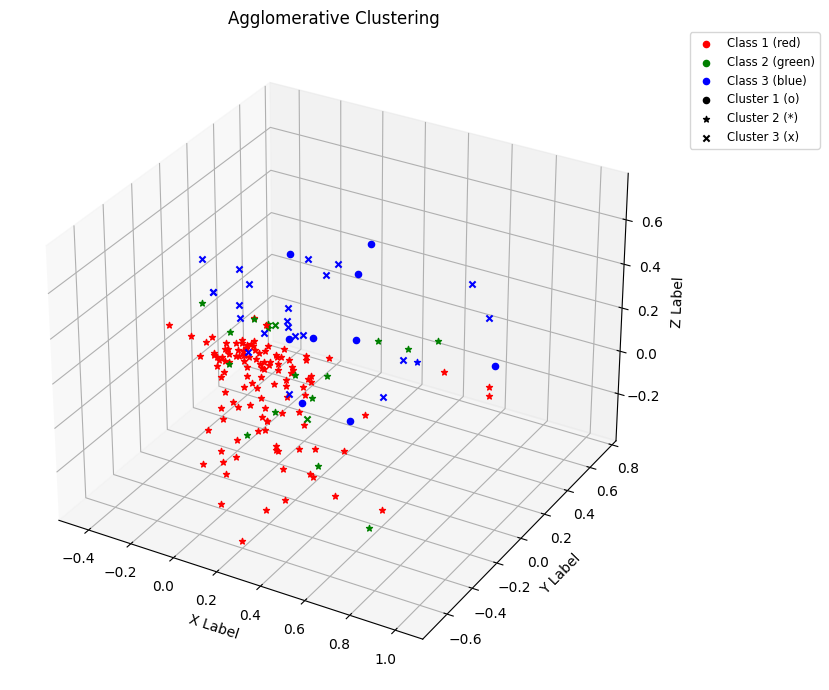

----------------------------------------------------------------------------------------------------
----------------------------------------------Data RAW----------------------------------------------
----------------------------------------------------------------------------------------------------
True Labels:
The number of instances for class 3 is 120
Class 3: [0, 1, 3, 5, 7, 8, 9, 10, 11, 12, 15, 17, 19, 20, 21, 22, 23, 24, 25, 29, 30, 31, 32, 33, 34, 37, 39, 40, 41, 42, 43, 46, 47, 49, 50, 51, 54, 56, 57, 58, 59, 60, 61, 62, 63, 65, 67, 68, 71, 72, 73, 75, 76, 77, 78, 80, 81, 82, 83, 84, 88, 89, 93, 95, 96, 97, 98, 99, 101, 102, 103, 105, 106, 107, 108, 109, 111, 112, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 139, 141, 142, 143, 144, 146, 147, 150, 151, 152, 153, 154, 155, 157, 163, 164, 165, 167, 169]

The number of instances for class 4 is 18
Class 4: [2, 6, 13, 14, 16, 36, 38, 44, 45, 64, 69, 85, 91, 100

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [8]:
CPI_Clustring = Cluster(False, cpi_classic_classification, 'CPI')

Apelare DBSCAN Raw
DBSCAN Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


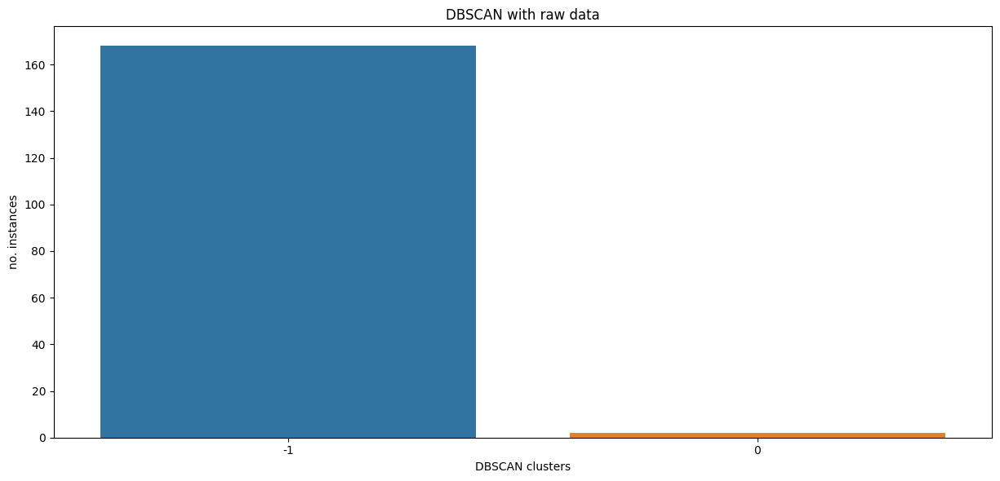

Index1               2   3  4
DBSCAN Cluster Raw           
-1                  65  97  6
 0                   2   0  0


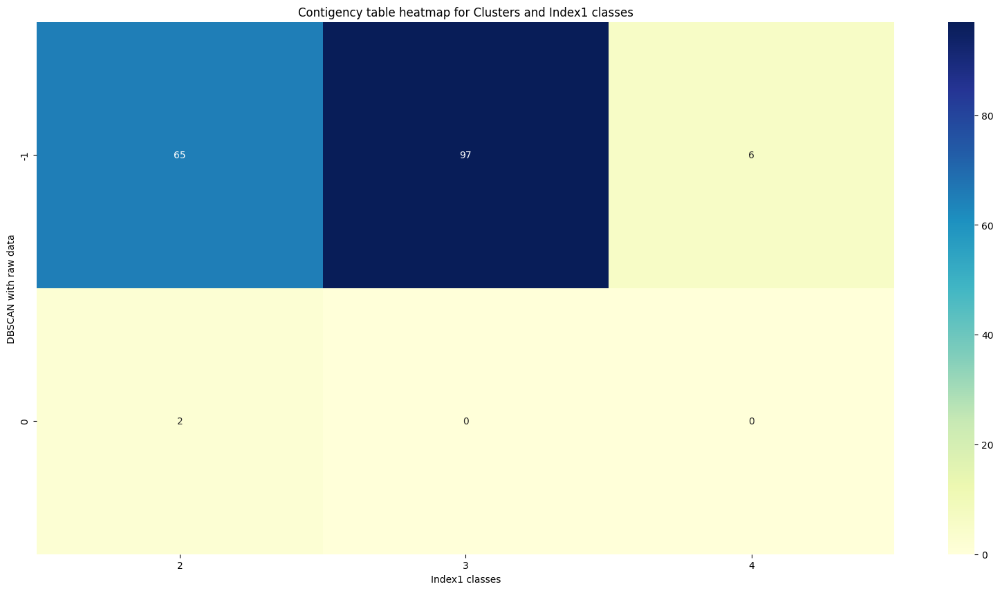

['Cluster 1 (o)']


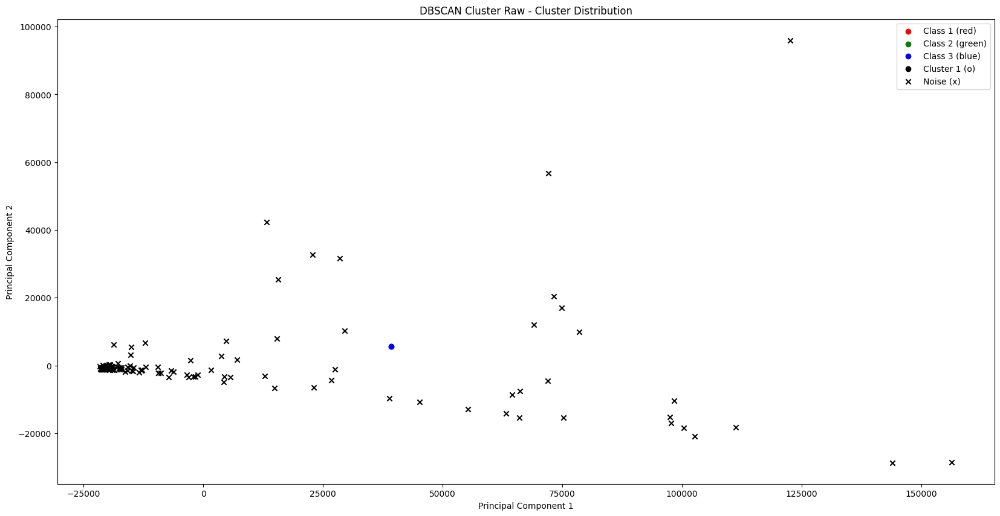

Apelare DBSCAN Standardized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
DBSCAN Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


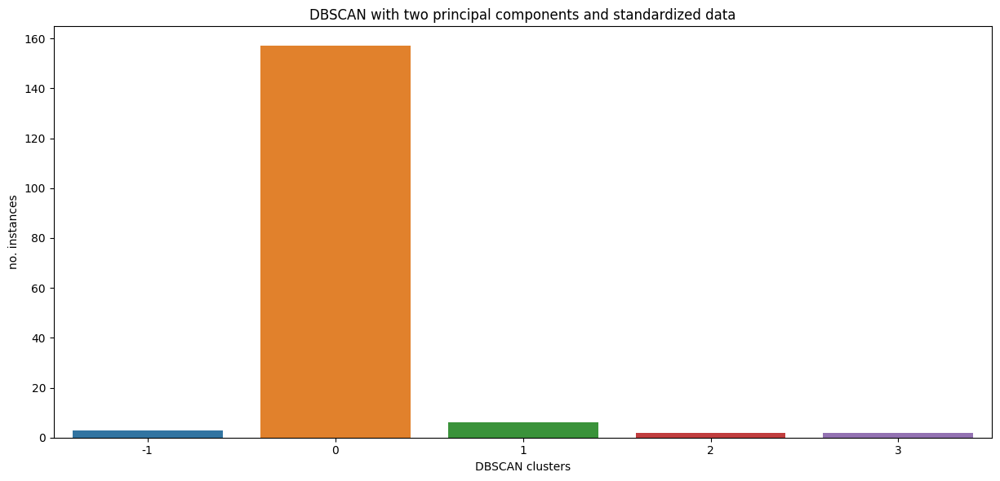

Index1                        2   3  4
DBSCAN Cluster Standardized           
-1                            0   3  0
 0                           66  85  6
 1                            0   6  0
 2                            0   2  0
 3                            1   1  0


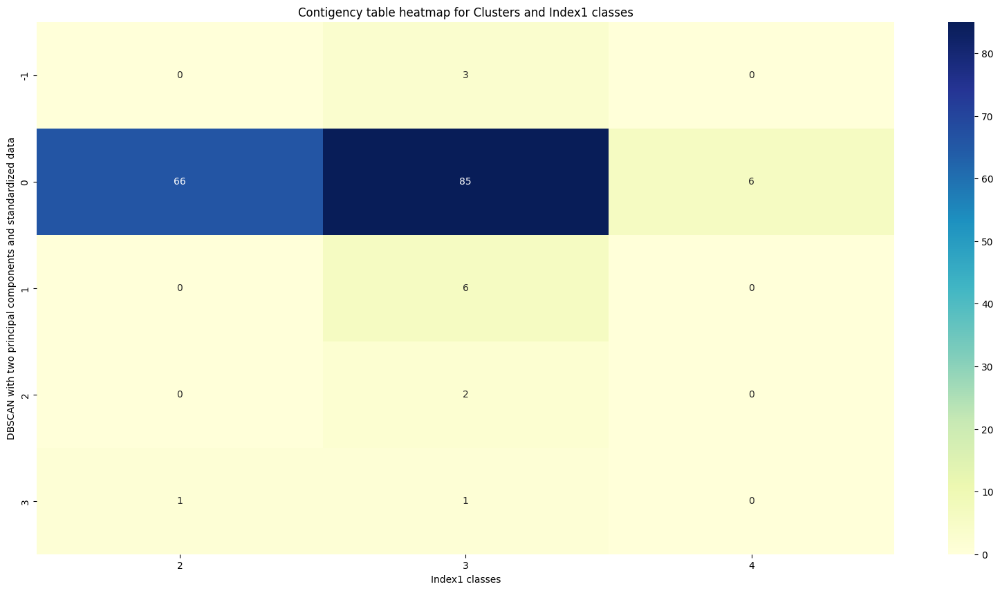

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']


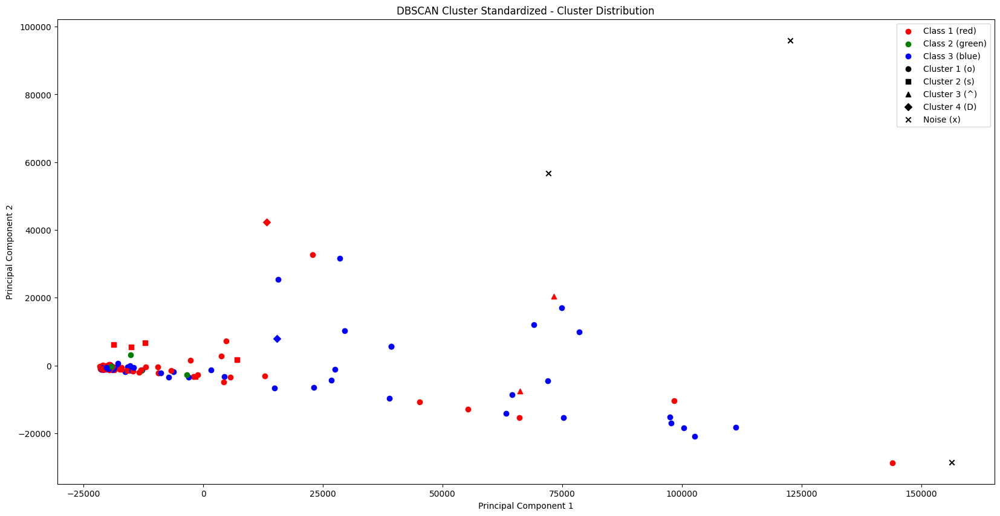

Apelare DBSCAN Standardized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare DBSCAN Normalized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
DBSCAN Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


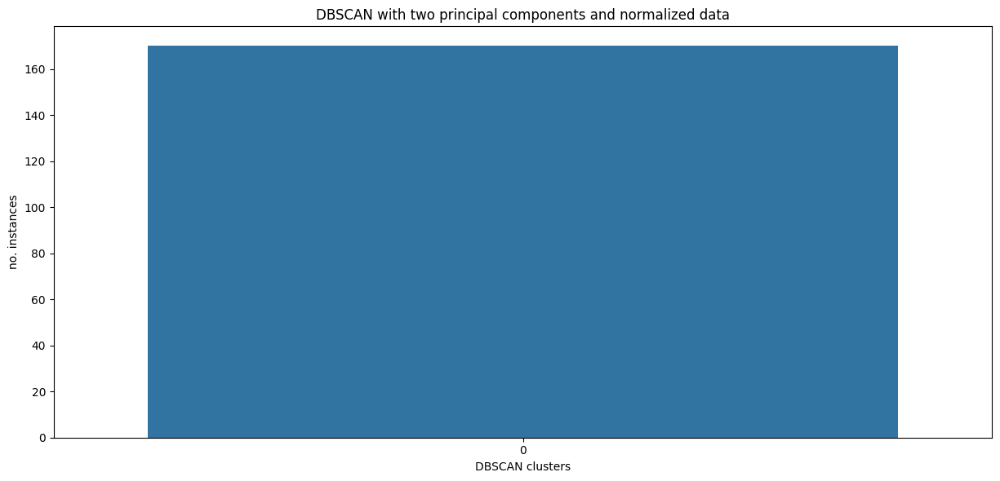

Index1                      2   3  4
DBSCAN Cluster Normalized           
0                          67  97  6


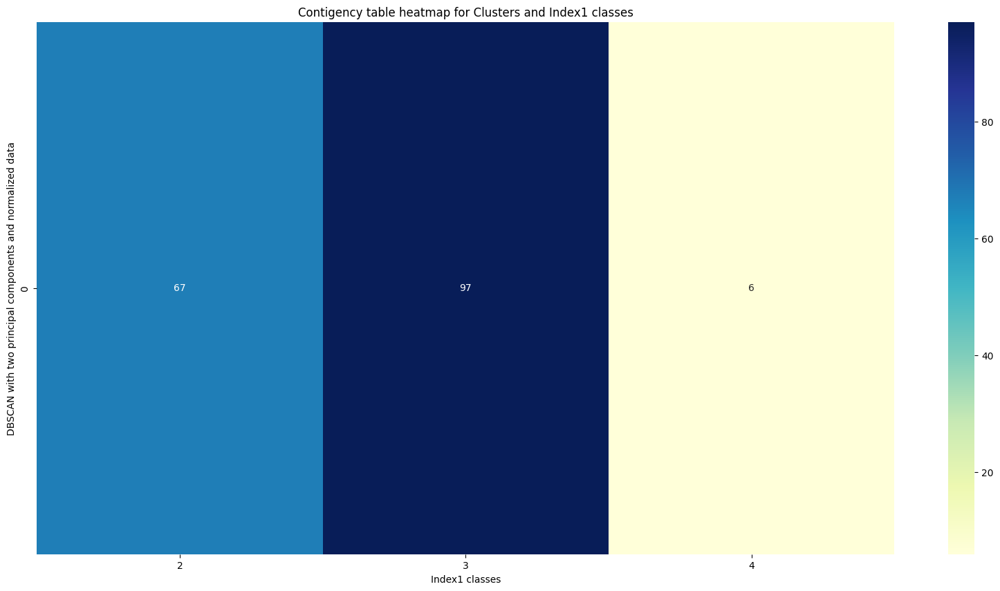

Apelare DBSCAN Normalized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare OPTICS Raw
OPTICS Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


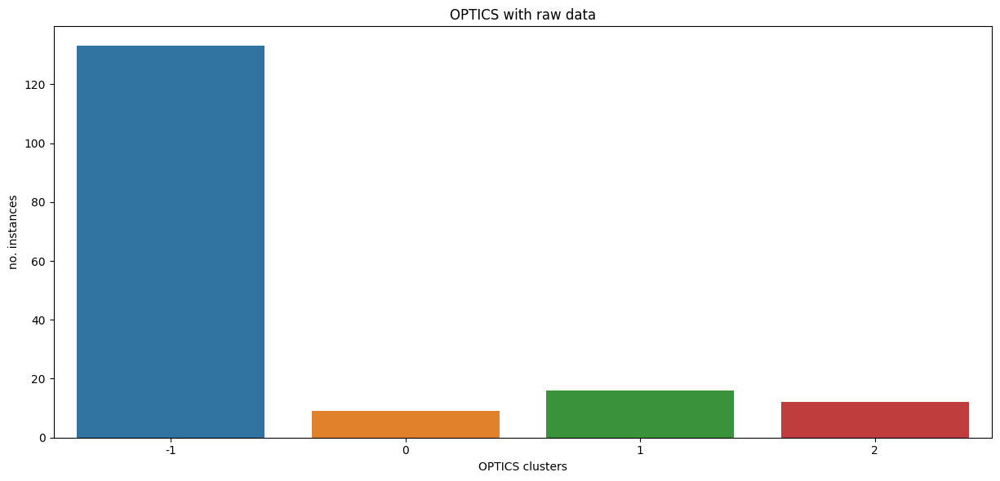

Index1               2   3  4
OPTICS Cluster Raw           
-1                  53  74  6
 0                   2   7  0
 1                   5  11  0
 2                   7   5  0


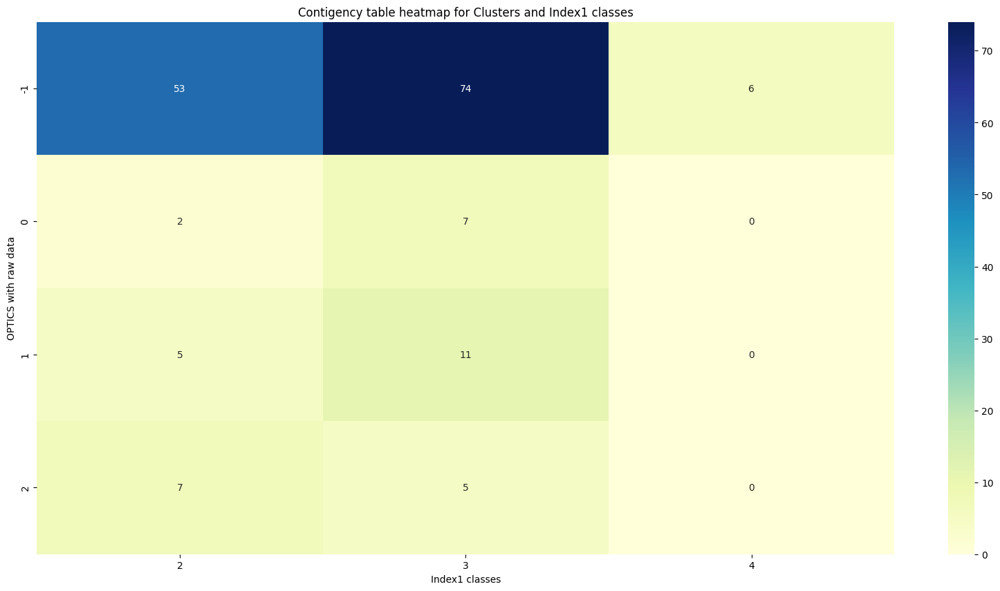

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']


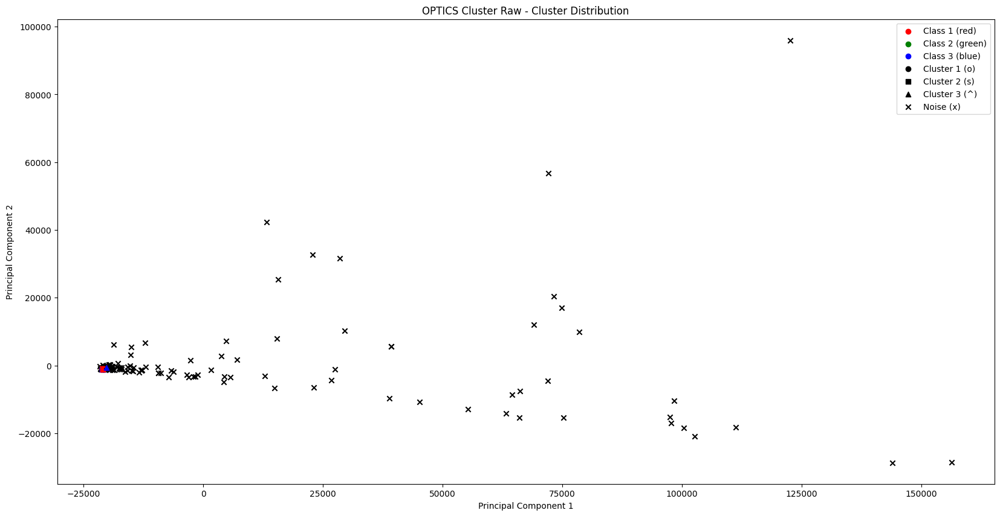

Apelare OPTICS Standardized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
OPTICS Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


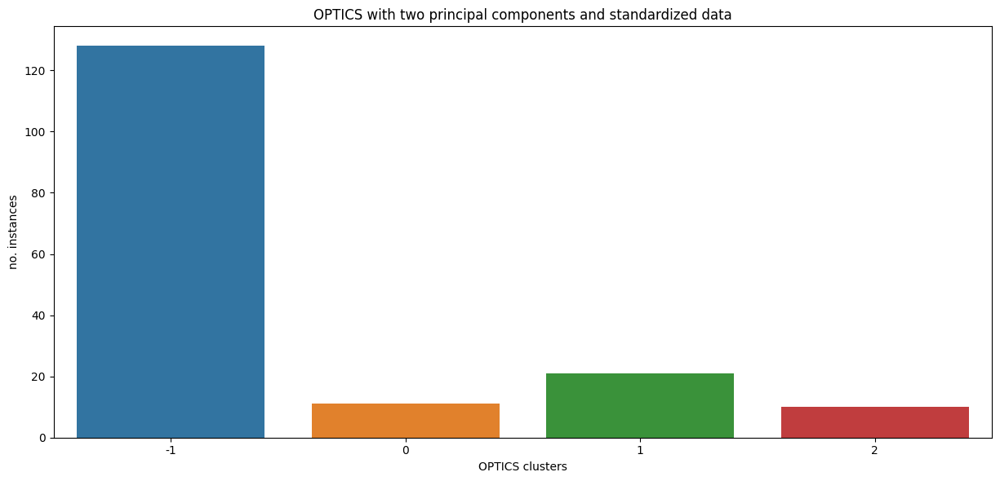

Index1                        2   3  4
OPTICS Cluster Standardized           
-1                           61  63  4
 0                            2   9  0
 1                            2  19  0
 2                            2   6  2


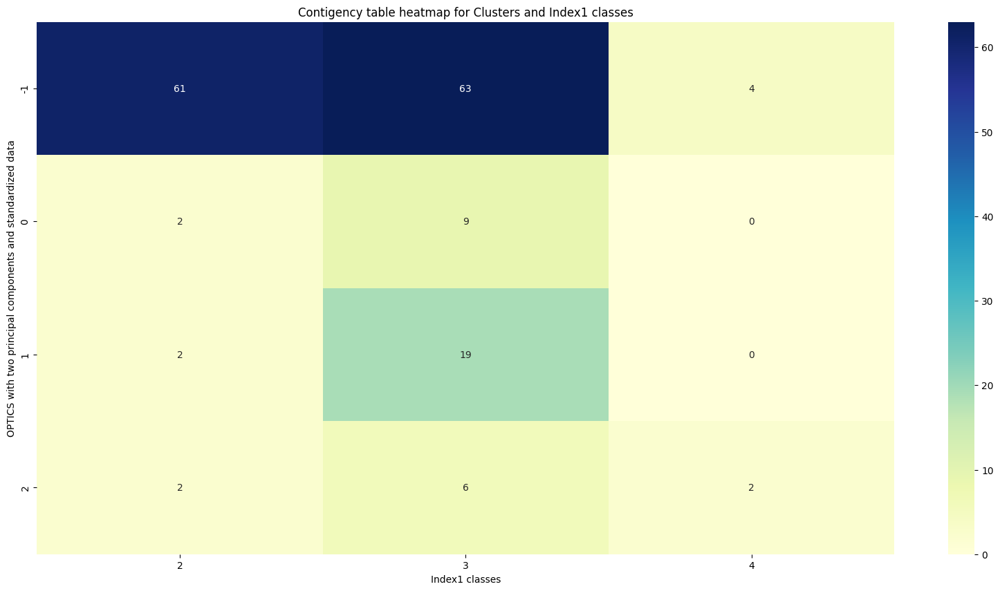

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']


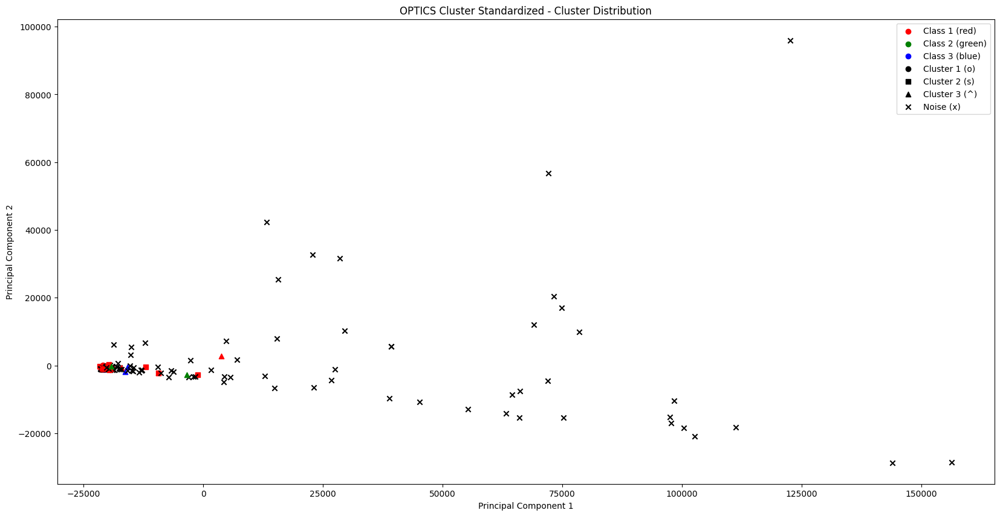

Apelare OPTICS Standardized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare OPTICS Normalized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
OPTICS Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


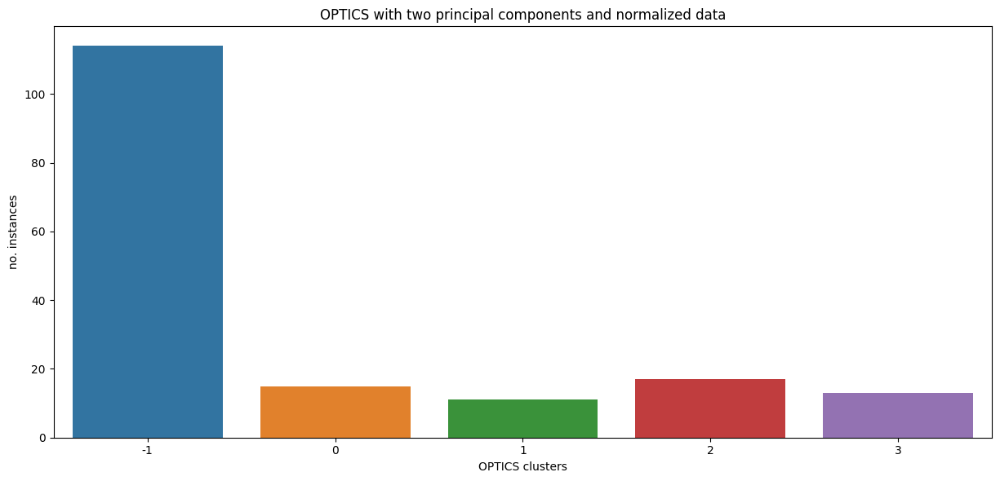

Index1                      2   3  4
OPTICS Cluster Normalized           
-1                         43  66  5
 0                          8   6  1
 1                          5   6  0
 2                          7  10  0
 3                          4   9  0


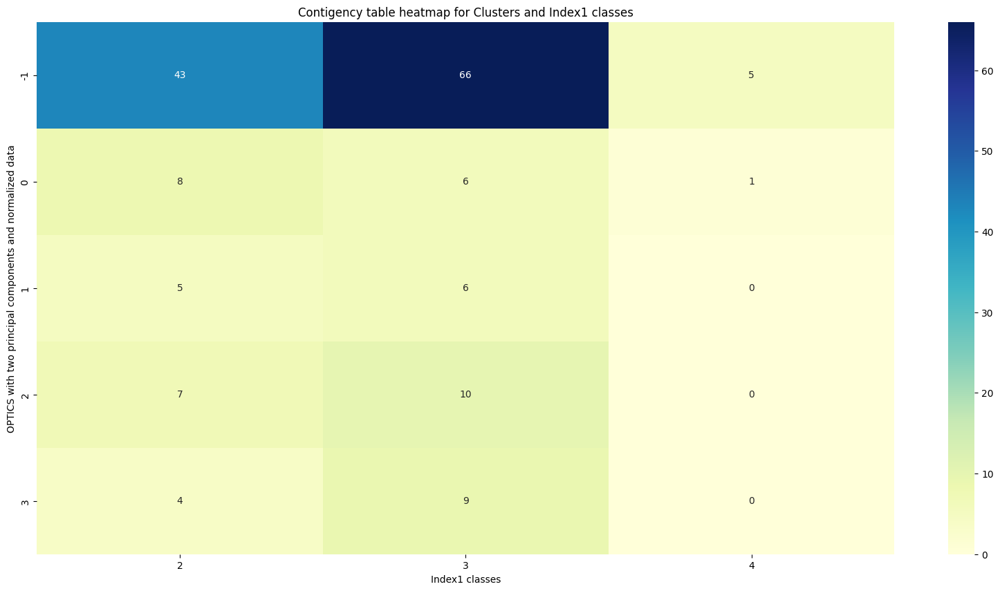

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']


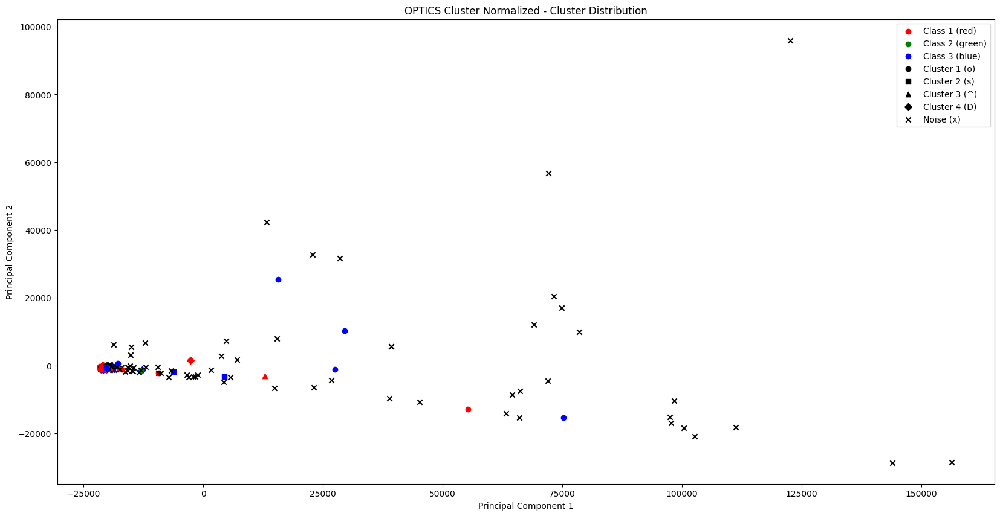

Apelare OPTICS Normalized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare AffinityPropagation Raw


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


AffinityPropagation Cluster Raw Cluster size distribution


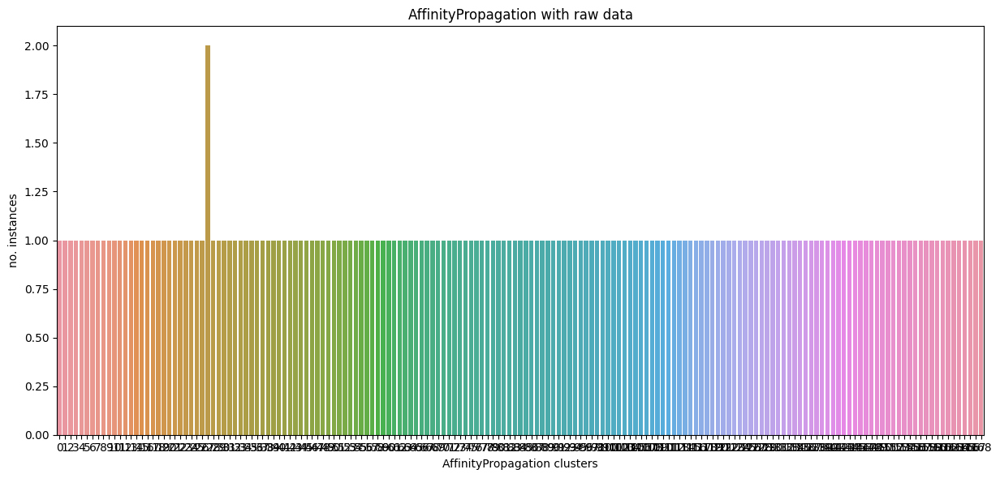

Index1                           2  3  4
AffinityPropagation Cluster Raw         
0                                0  1  0
1                                1  0  0
2                                0  1  0
3                                0  1  0
4                                1  0  0
...                             .. .. ..
164                              1  0  0
165                              0  1  0
166                              0  0  1
167                              0  1  0
168                              1  0  0

[169 rows x 3 columns]


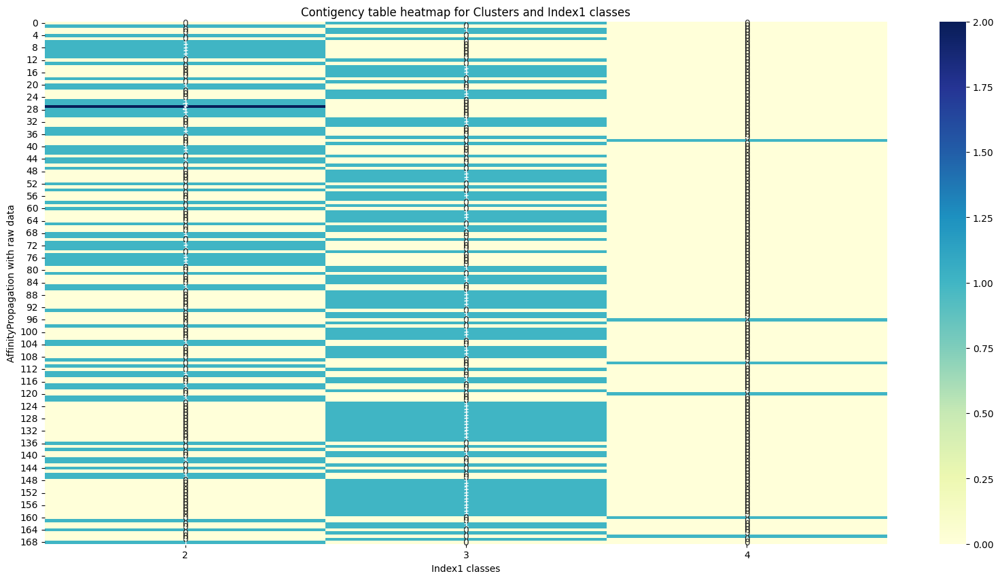

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


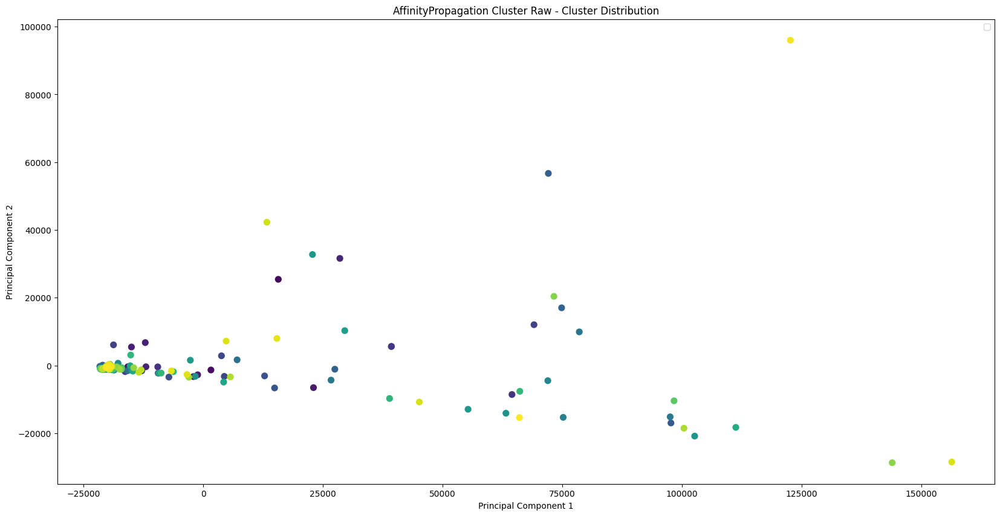

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


Apelare AffinityPropagation Standardized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
AffinityPropagation Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


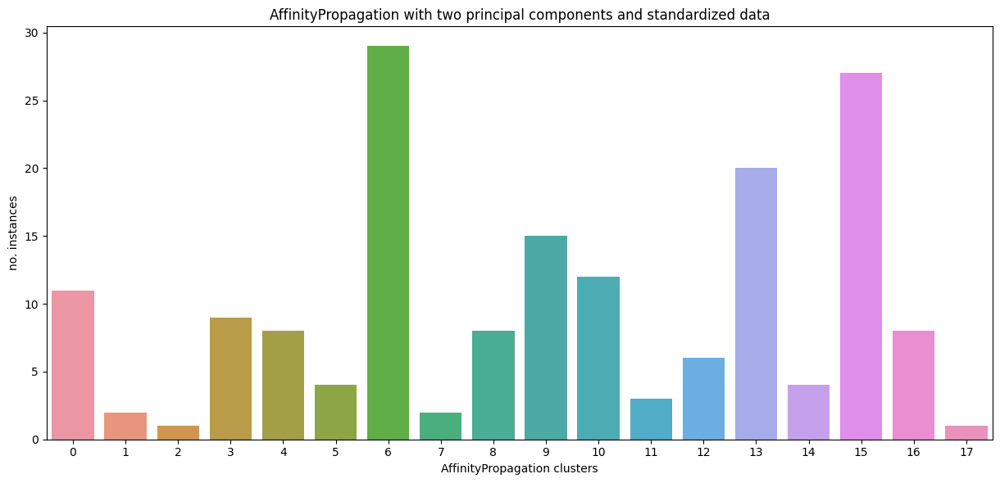

Index1                                     2   3  4
AffinityPropagation Cluster Standardized           
0                                          0  11  0
1                                          0   2  0
2                                          0   1  0
3                                          6   3  0
4                                          7   1  0
5                                          0   4  0
6                                         20   9  0
7                                          0   2  0
8                                          0   4  4
9                                         10   5  0
10                                         3   7  2
11                                         3   0  0
12                                         1   5  0
13                                         2  18  0
14                                         2   2  0
15                                         9  18  0
16                                         4   4  0
17          

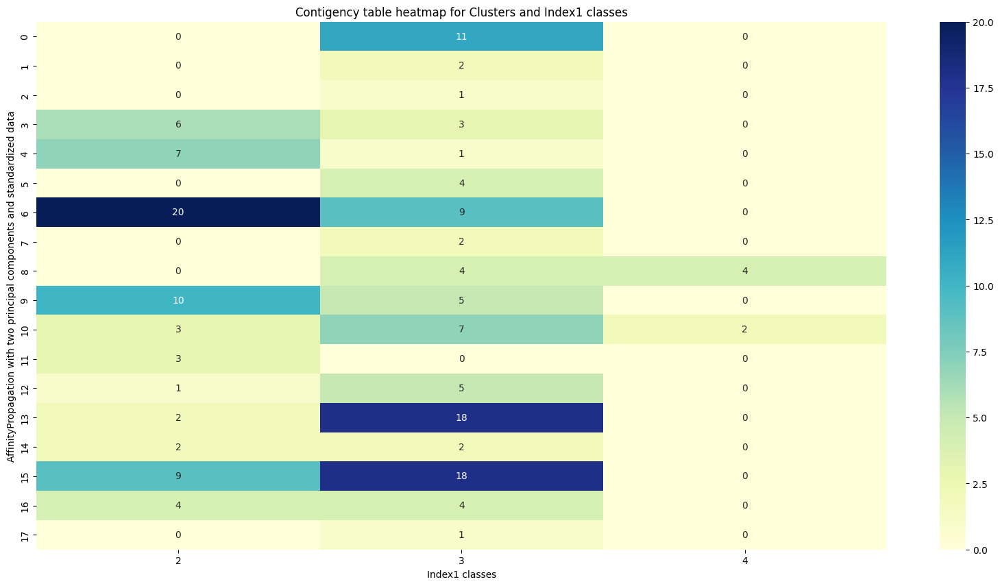

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


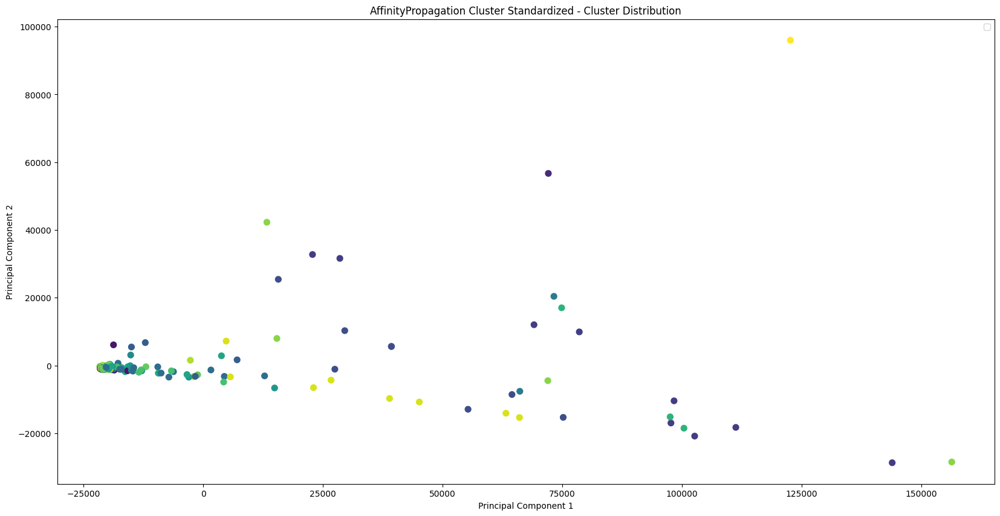

Apelare AffinityPropagation Standardized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare AffinityPropagation Normalized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
AffinityPropagation Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


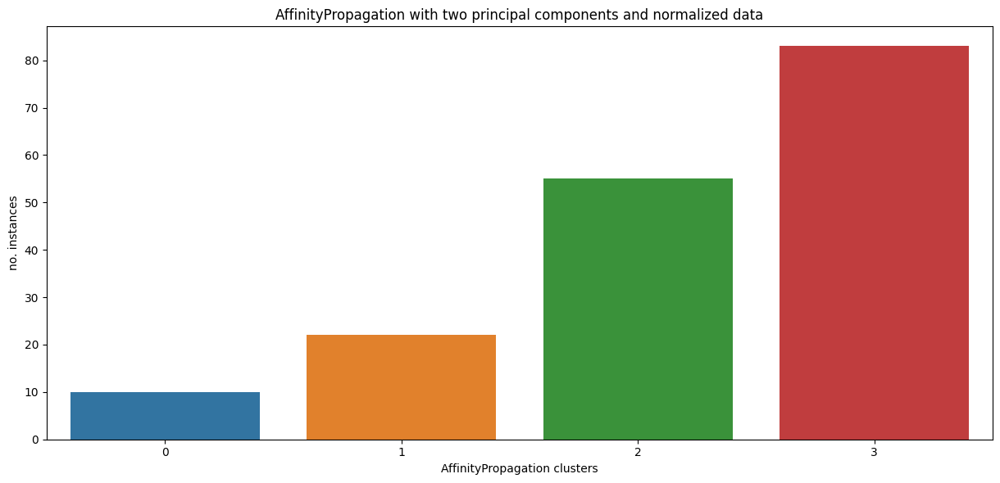

Index1                                   2   3  4
AffinityPropagation Cluster Normalized           
0                                        1   9  0
1                                        7  13  2
2                                       22  32  1
3                                       37  43  3


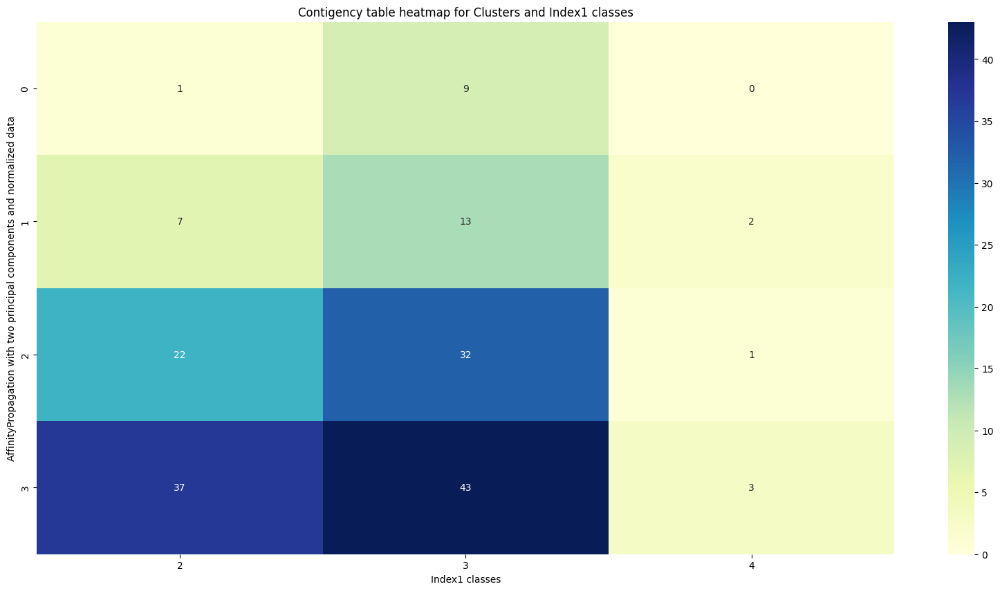

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


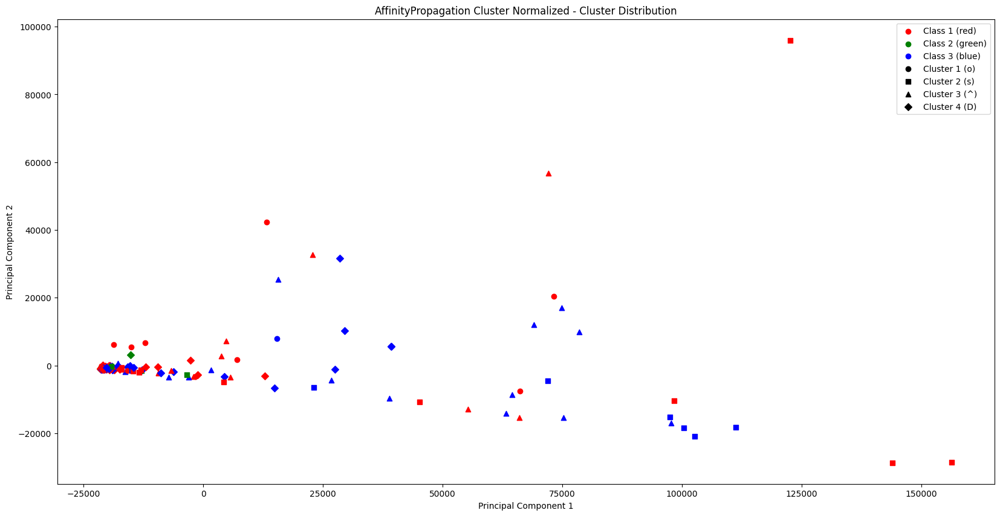

Apelare AffinityPropagation Normalized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare MeanShift Raw


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


MeanShift Cluster Raw Cluster size distribution


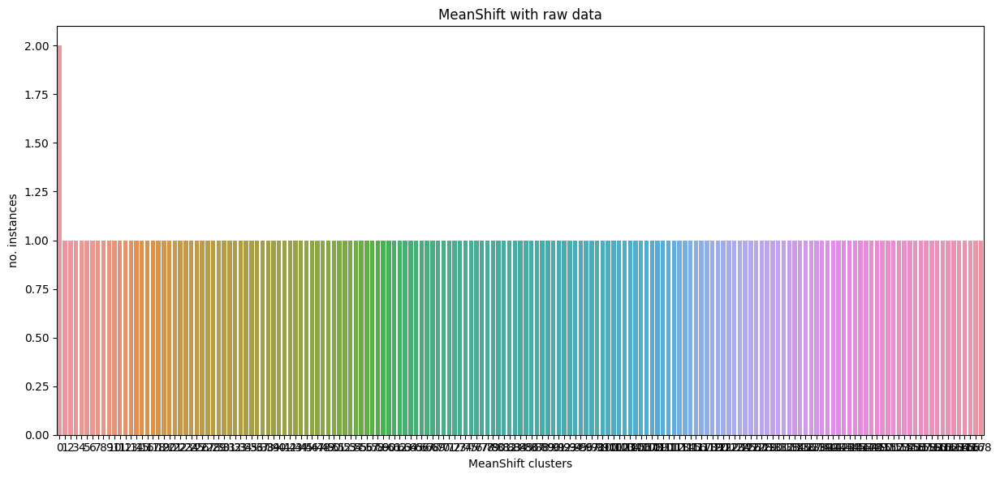

Index1                 2  3  4
MeanShift Cluster Raw         
0                      2  0  0
1                      1  0  0
2                      0  1  0
3                      0  0  1
4                      0  1  0
...                   .. .. ..
164                    1  0  0
165                    0  1  0
166                    0  1  0
167                    1  0  0
168                    0  1  0

[169 rows x 3 columns]


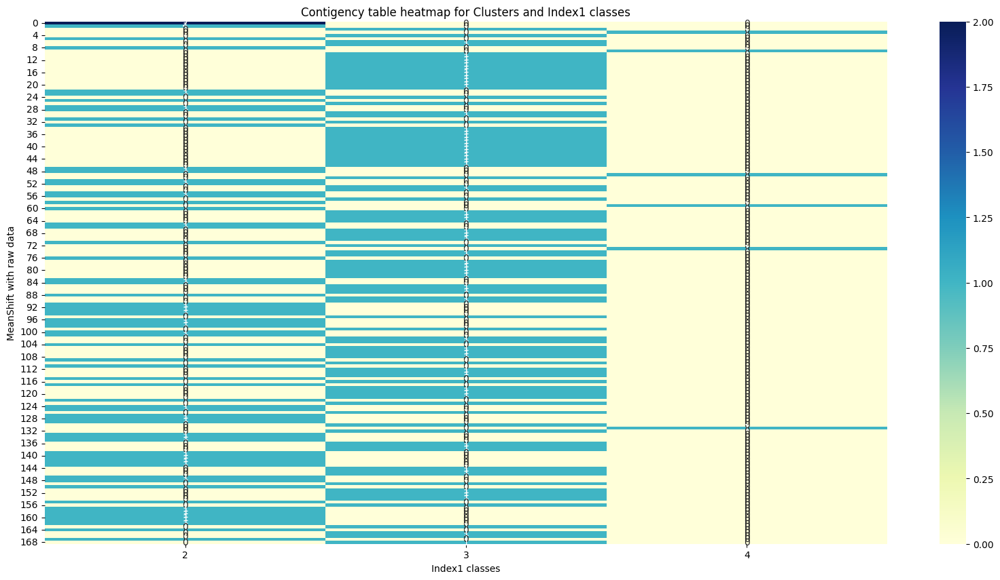

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


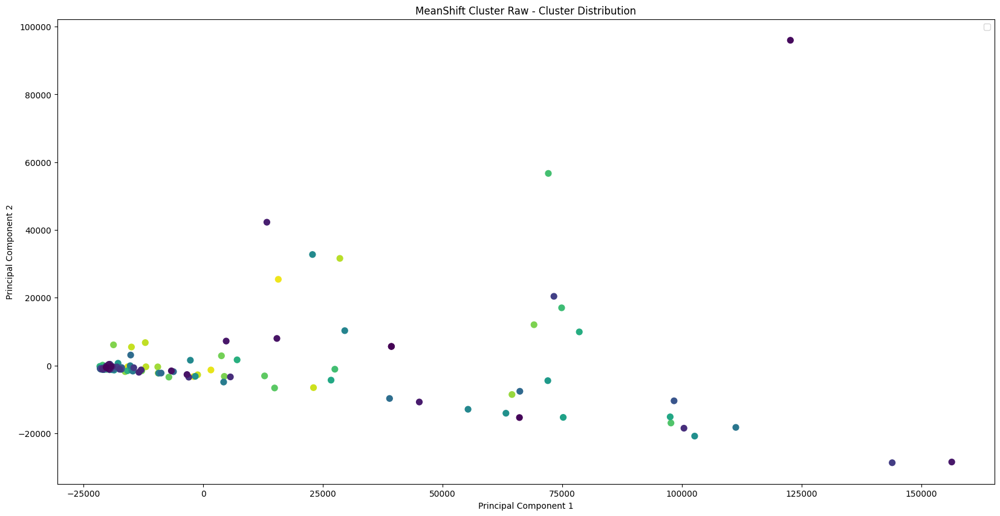

Apelare MeanShift Standardized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


MeanShift Cluster Standardized Cluster size distribution


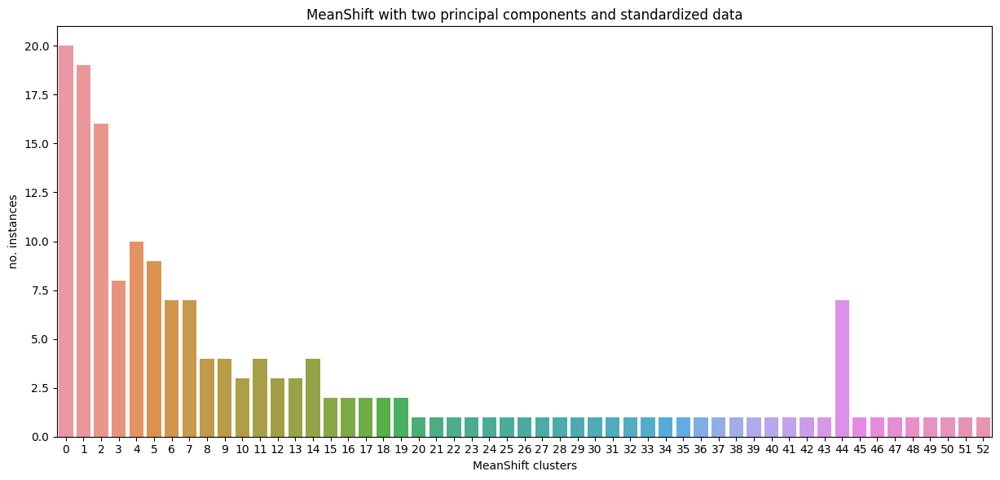

Index1                           2   3  4
MeanShift Cluster Standardized           
0                               13   7  0
1                                4  15  0
2                                1  15  0
3                                7   1  0
4                                2   6  2
5                                5   4  0
6                                3   4  0
7                                0   7  0
8                                2   2  0
9                                2   2  0
10                               0   2  1
11                               4   0  0
12                               1   2  0
13                               3   0  0
14                               0   4  0
15                               0   2  0
16                               0   2  0
17                               1   1  0
18                               0   2  0
19                               2   0  0
20                               0   1  0
21                               0

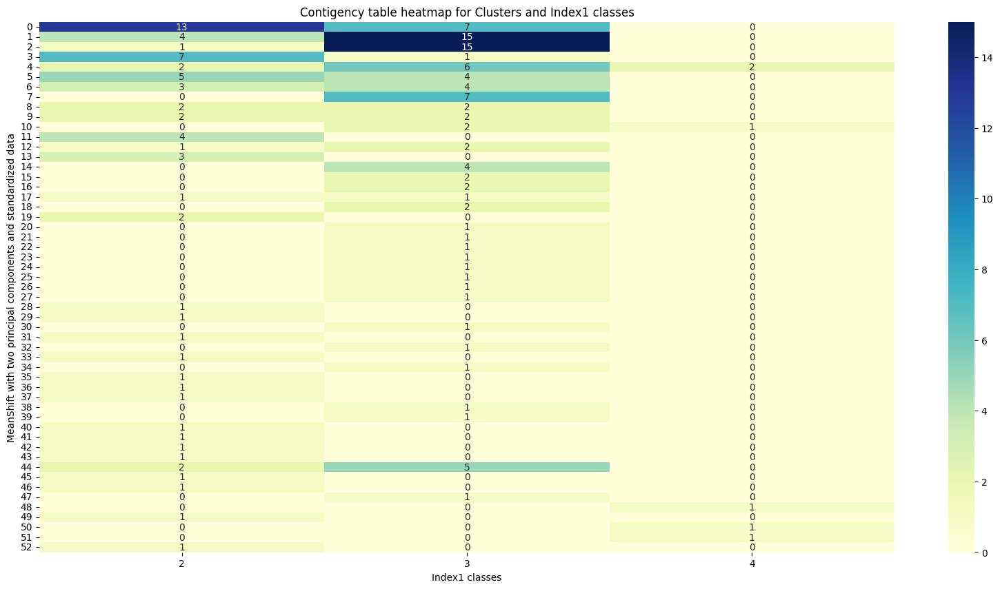

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


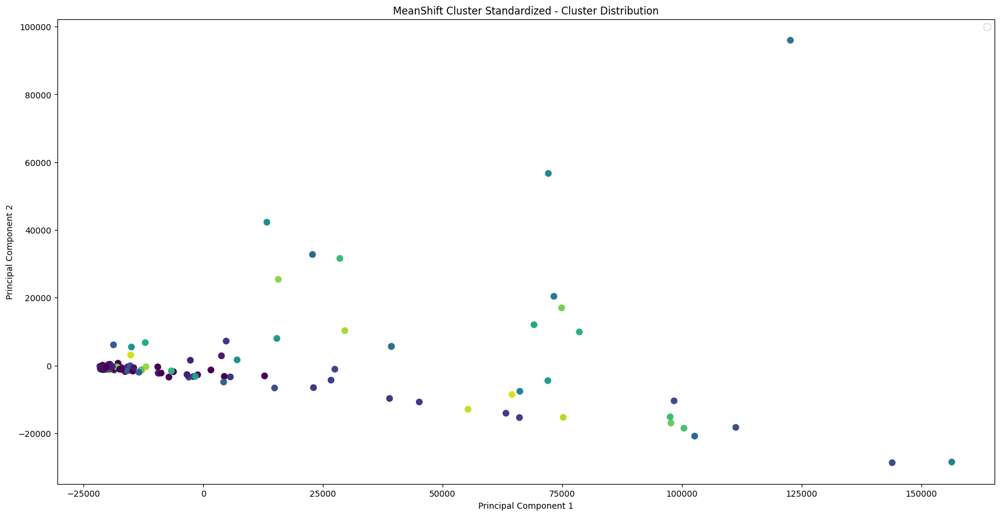

Apelare MeanShift Standardized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare MeanShift Normalized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
MeanShift Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


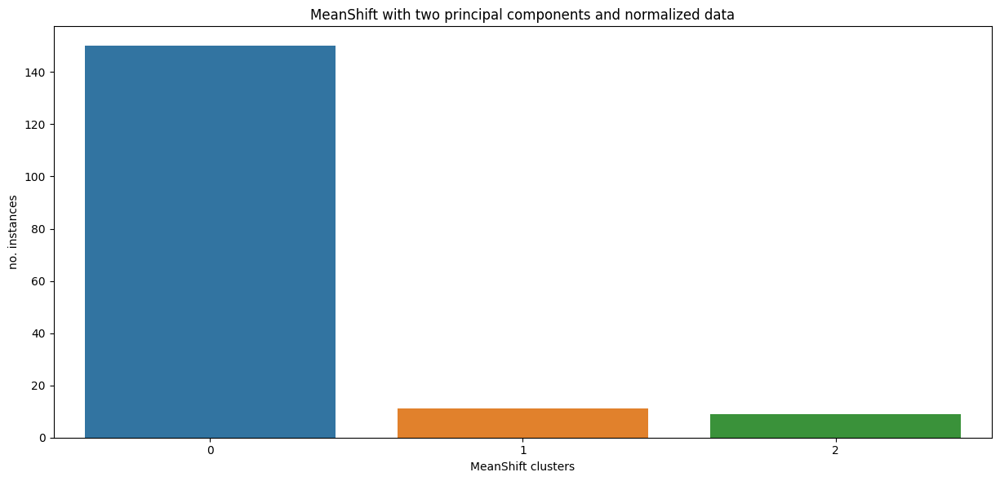

Index1                         2   3  4
MeanShift Cluster Normalized           
0                             63  81  6
1                              1  10  0
2                              3   6  0


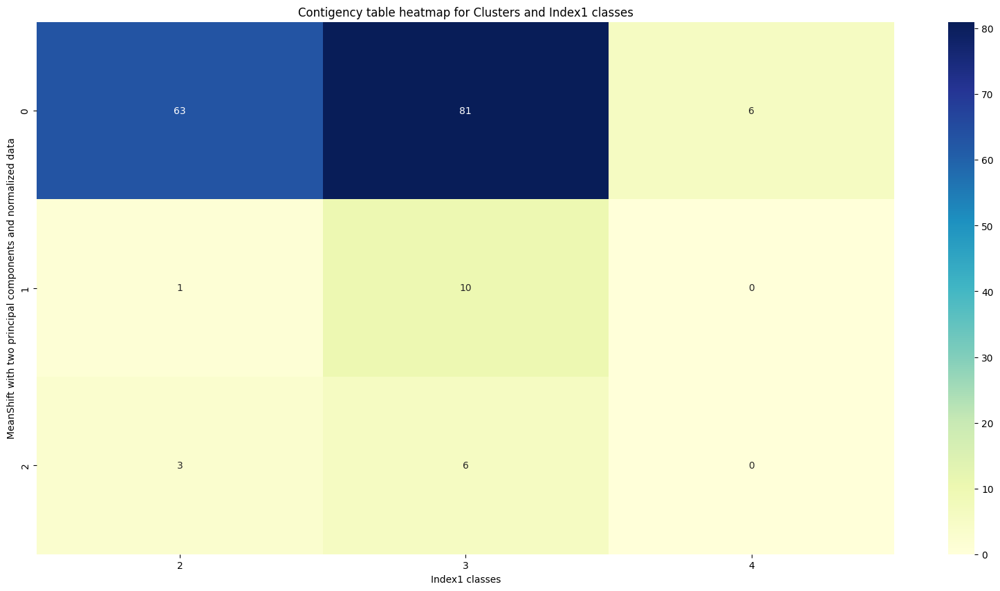

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


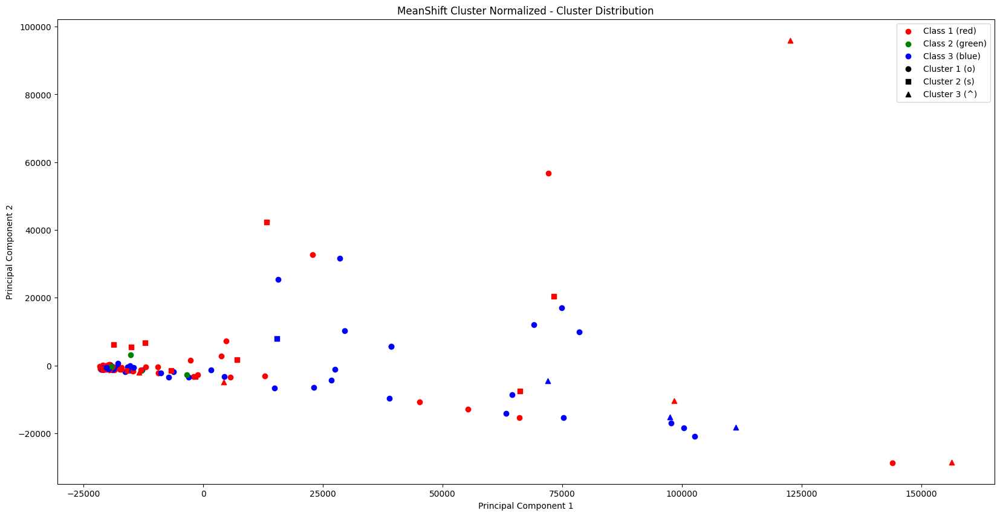

Apelare MeanShift Normalized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare KMeans with 3 clusters Raw
KMeans with 3 clusters Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: Futu

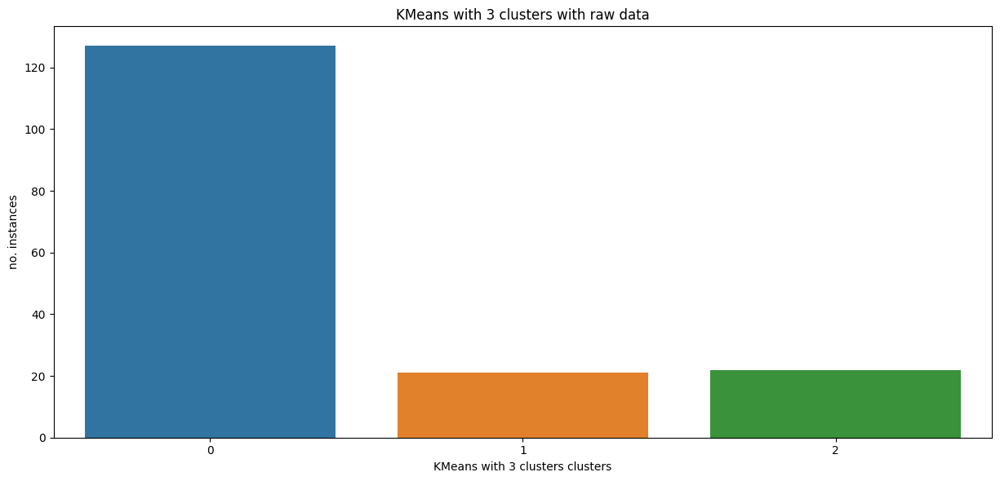

Index1                               2   3  4
KMeans with 3 clusters Cluster Raw           
0                                   42  79  6
1                                   12   9  0
2                                   13   9  0


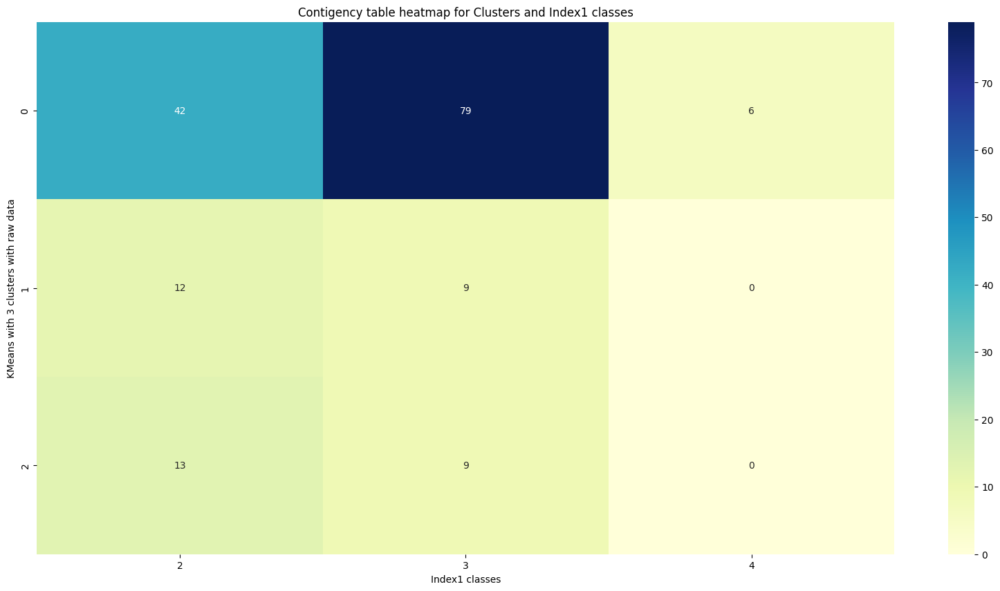

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


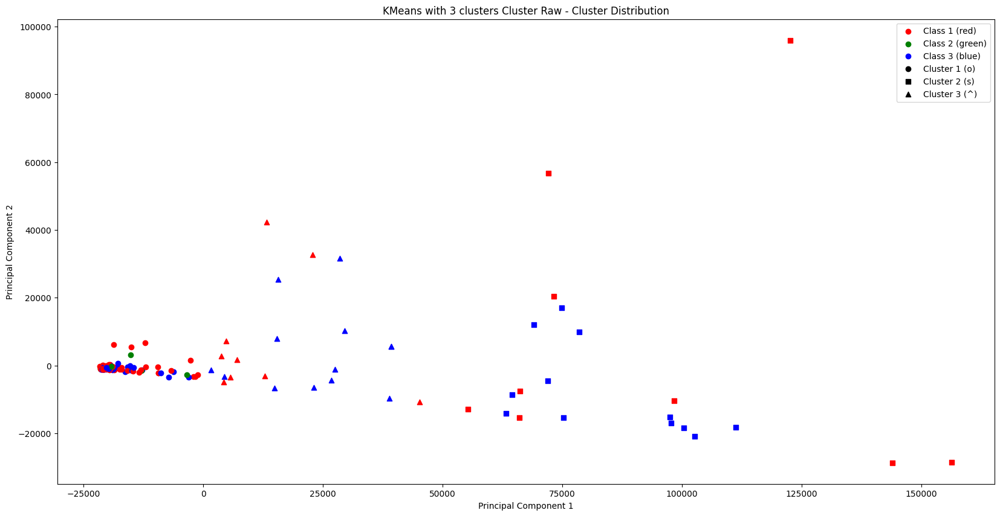

Apelare KMeans with 3 clusters Standardized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
KMeans with 3 clusters Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: Futu

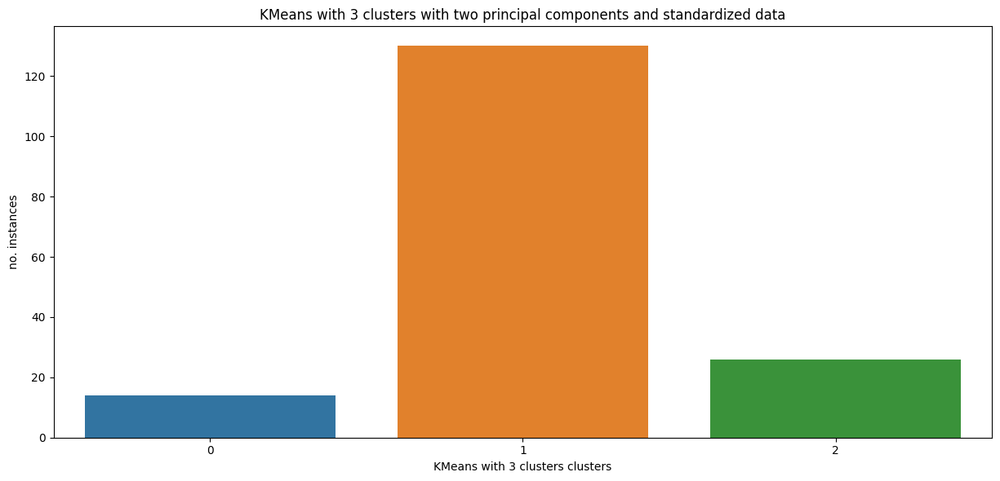

Index1                                        2   3  4
KMeans with 3 clusters Cluster Standardized           
0                                             1  13  0
1                                            48  76  6
2                                            18   8  0


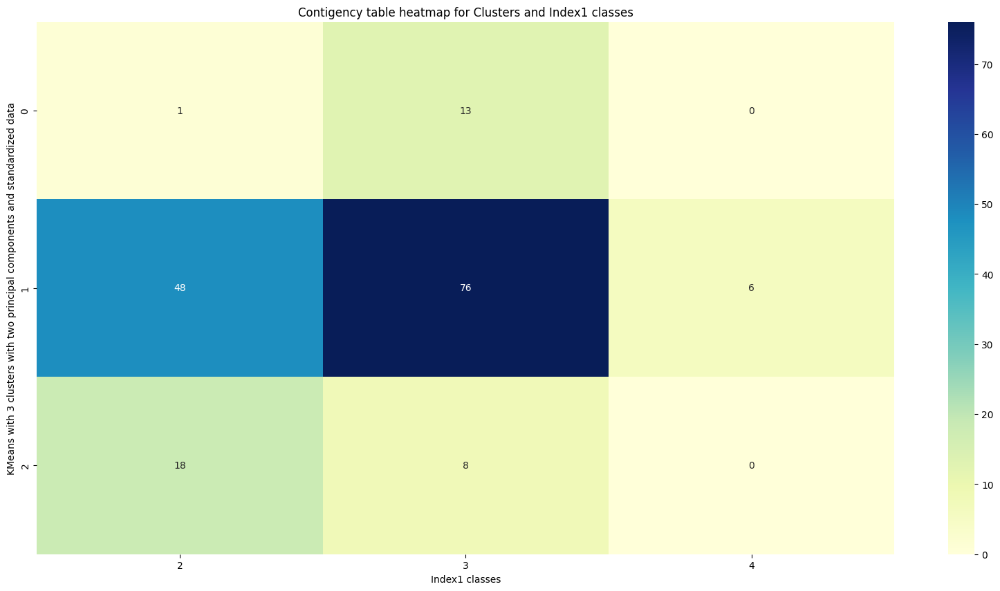

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


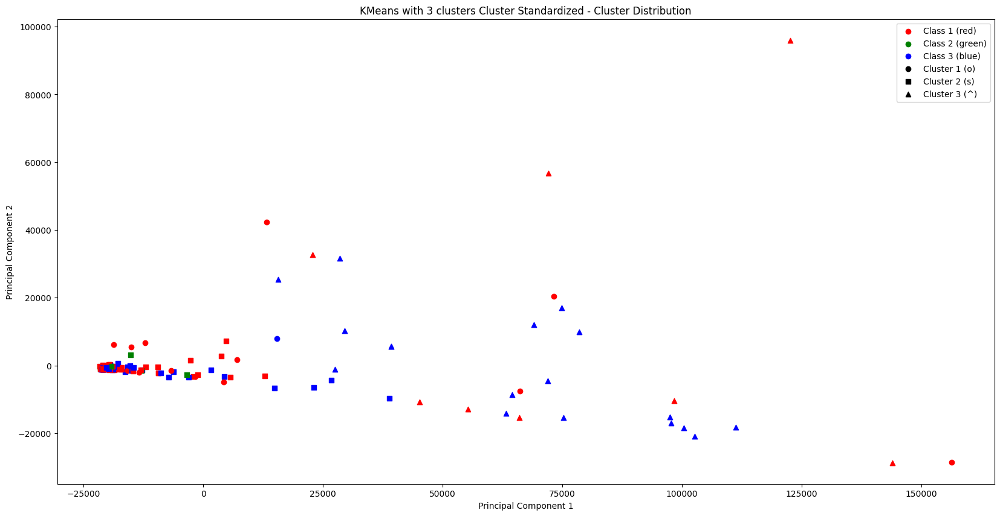

Apelare KMeans with 3 clusters Standardized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare KMeans with 3 clusters Normalized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
KMeans with 3 clusters Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_ol

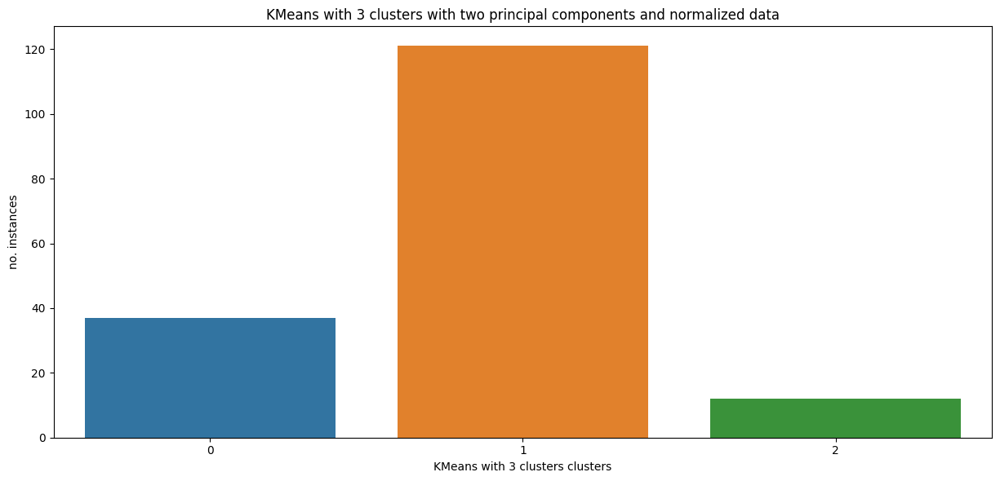

Index1                                      2   3  4
KMeans with 3 clusters Cluster Normalized           
0                                          11  24  2
1                                          55  62  4
2                                           1  11  0


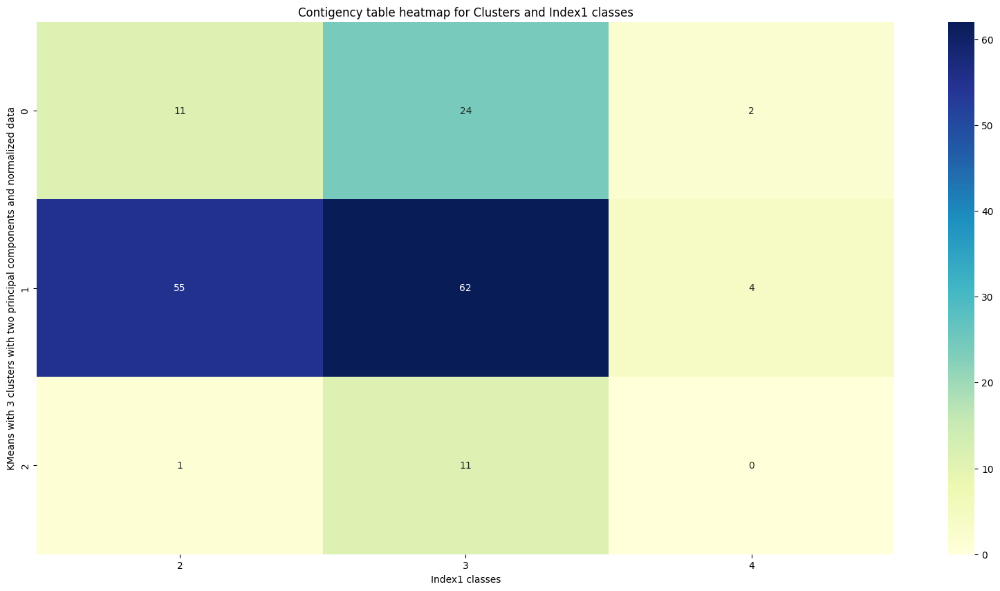

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


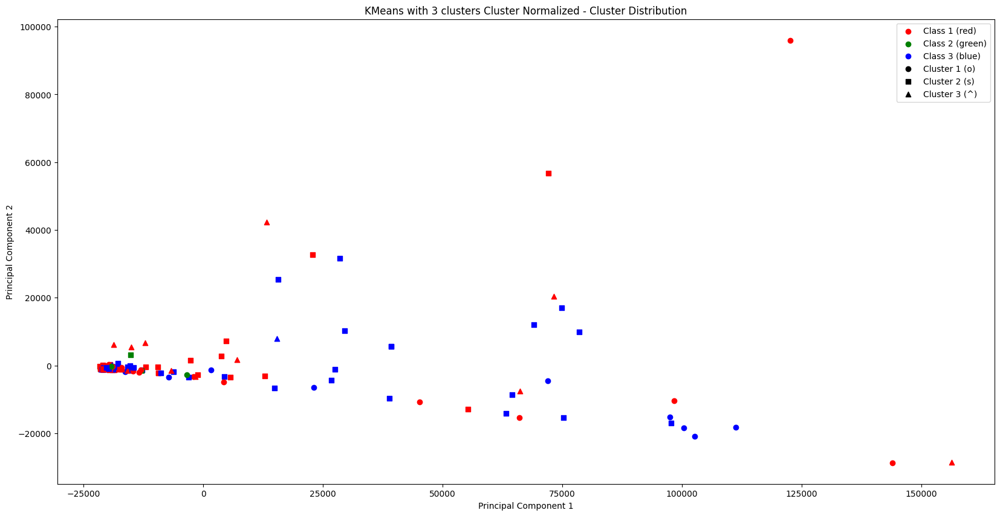

Apelare KMeans with 3 clusters Normalized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare KMeans with 4 clusters Raw


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans with 4 clusters Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


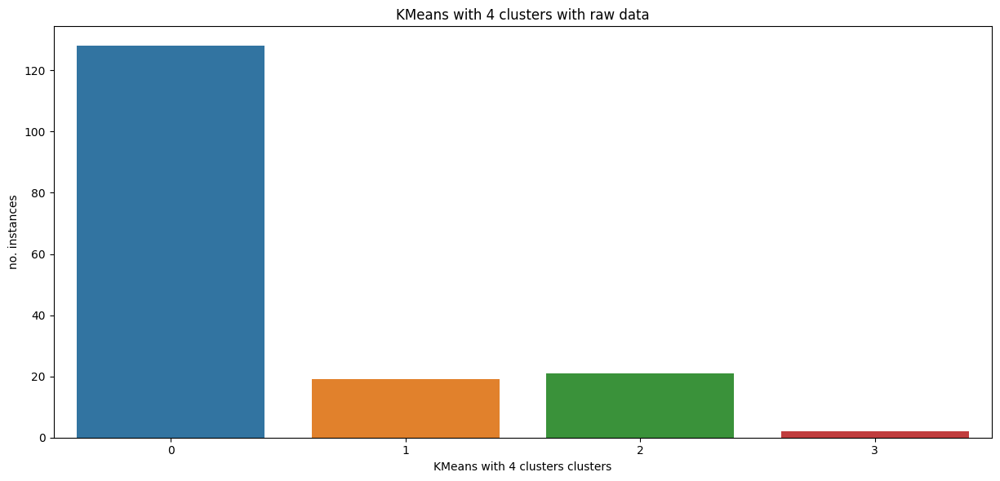

Index1                               2   3  4
KMeans with 4 clusters Cluster Raw           
0                                   43  79  6
1                                   12   7  0
2                                   12   9  0
3                                    0   2  0


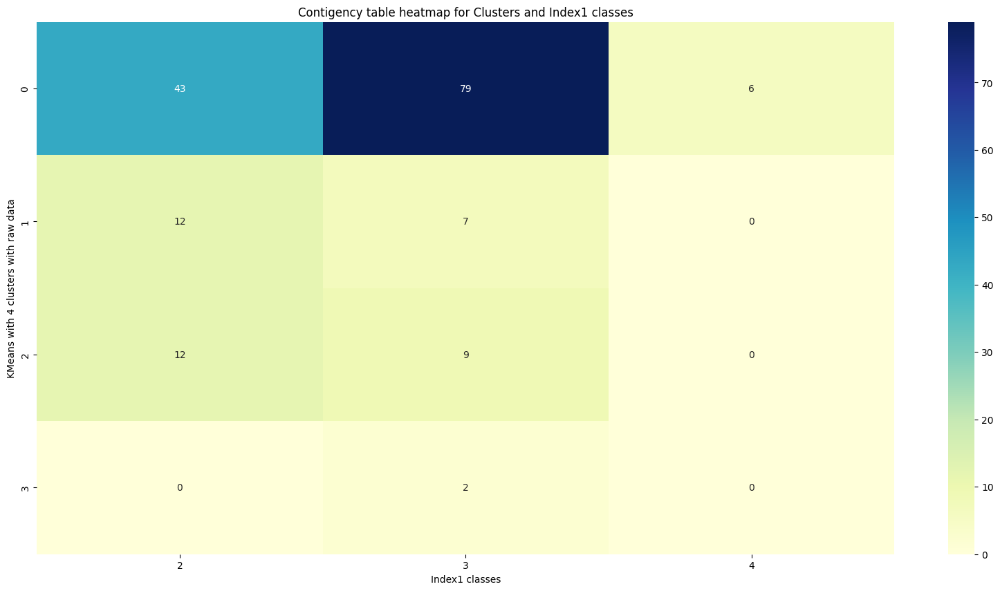

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


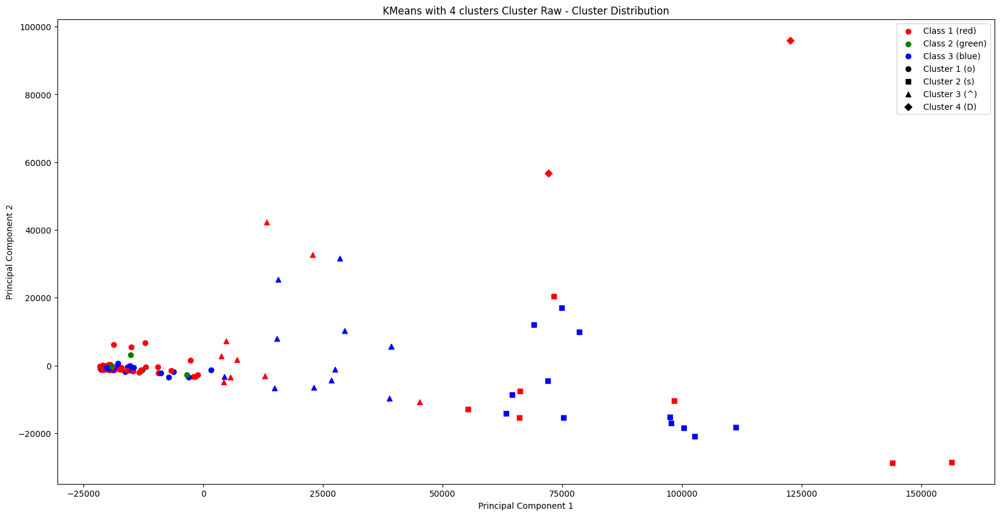

Apelare KMeans with 4 clusters Standardized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
KMeans with 4 clusters Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: Futu

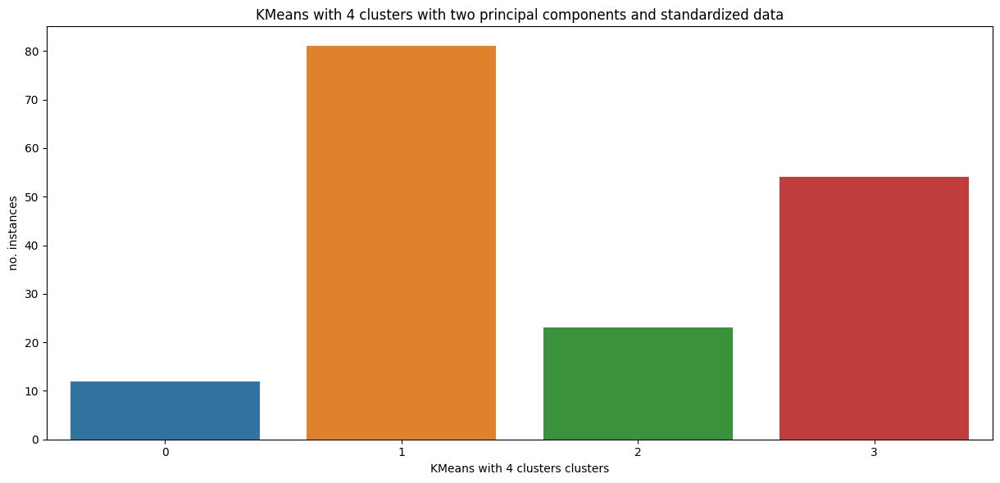

Index1                                        2   3  4
KMeans with 4 clusters Cluster Standardized           
0                                             1  11  0
1                                            42  39  0
2                                            16   7  0
3                                             8  40  6


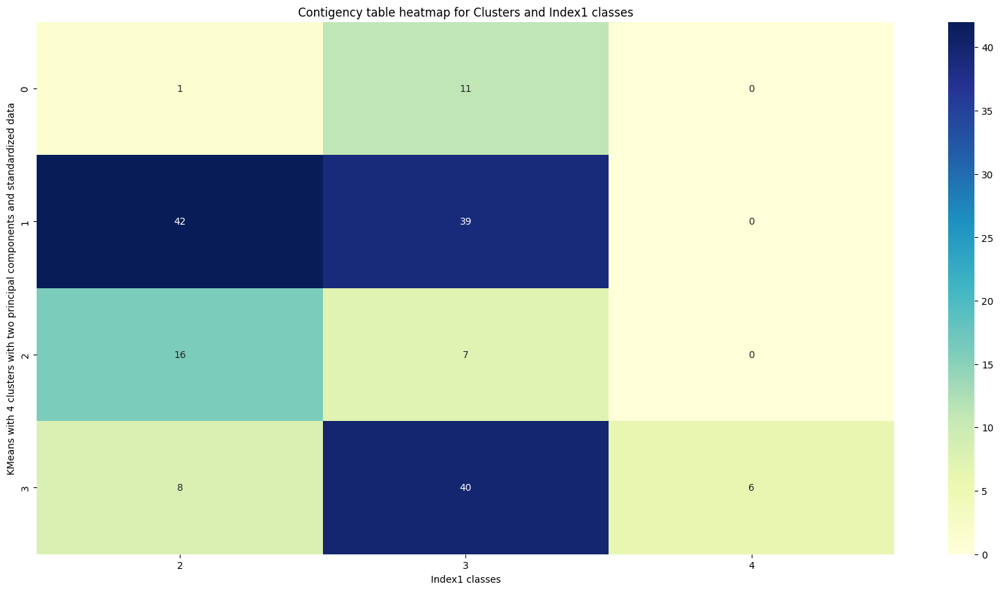

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


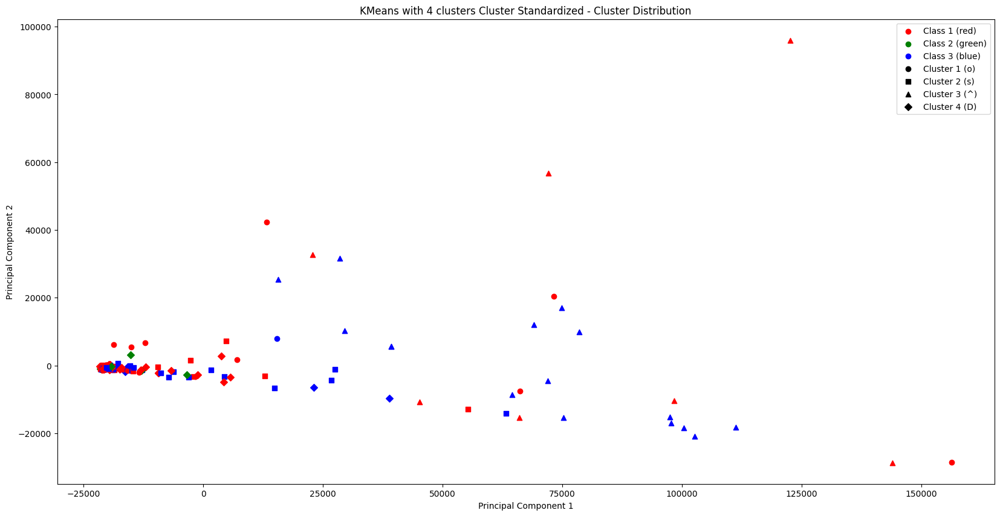

Apelare KMeans with 4 clusters Standardized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare KMeans with 4 clusters Normalized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
KMeans with 4 clusters Cluster Normalized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_ol

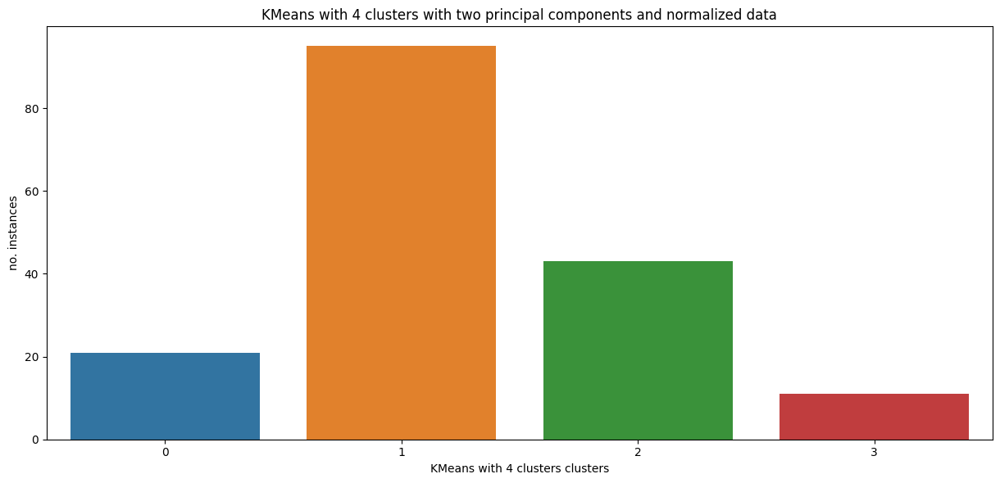

Index1                                      2   3  4
KMeans with 4 clusters Cluster Normalized           
0                                           7  12  2
1                                          39  53  3
2                                          20  22  1
3                                           1  10  0


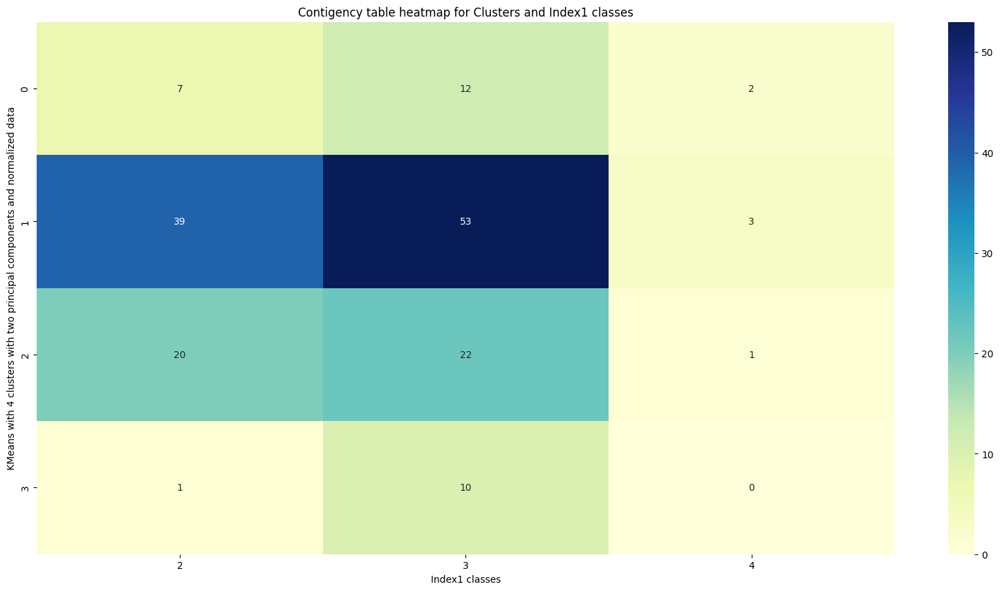

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


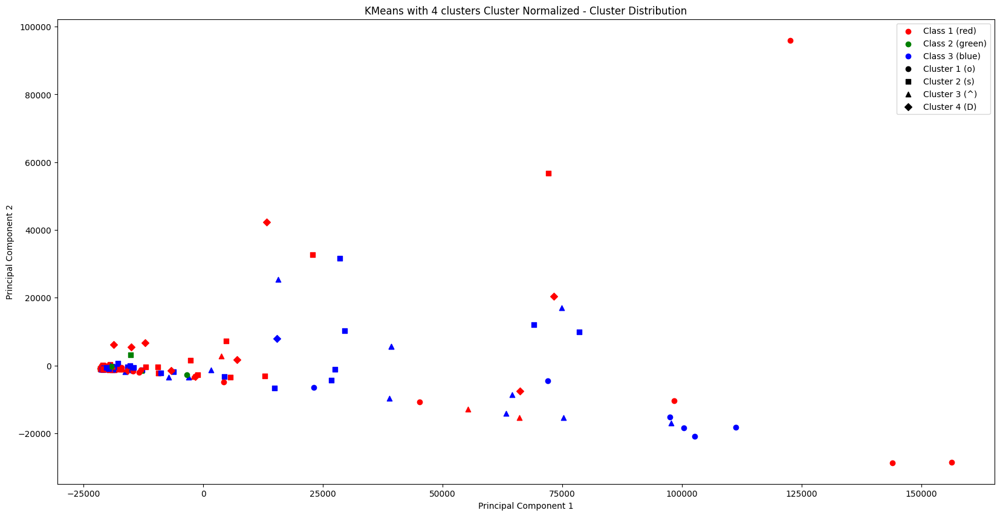

Apelare KMeans with 4 clusters Normalized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare AgglomerativeClustering with 3 clusters Raw
AgglomerativeClustering with 3 clusters Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: Futu

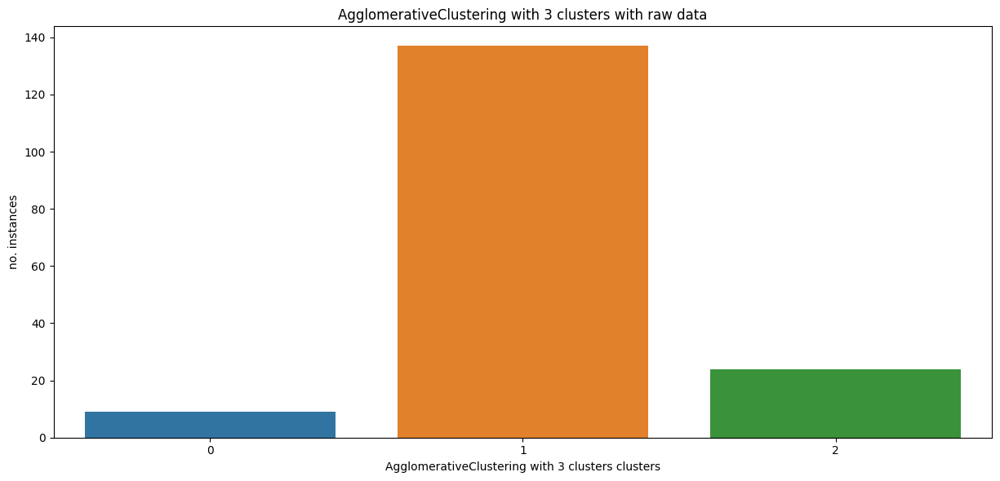

Index1                                               2   3  4
AgglomerativeClustering with 3 clusters Cluster...           
0                                                    5   4  0
1                                                   46  85  6
2                                                   16   8  0


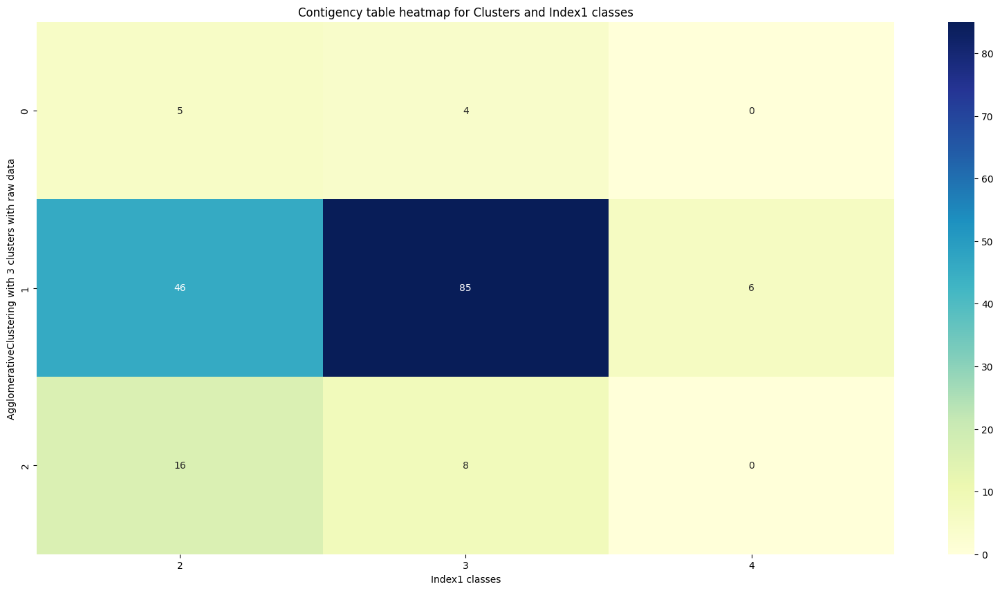

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


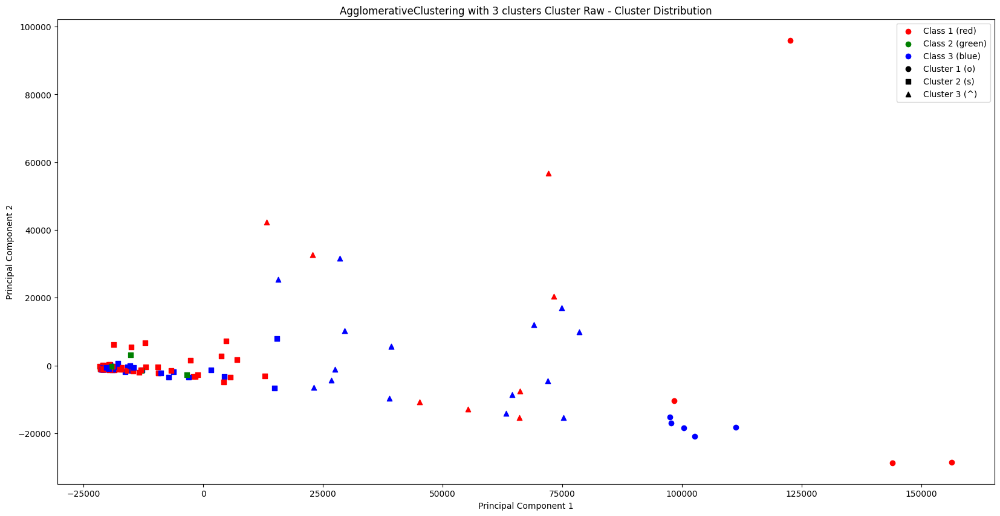

Apelare AgglomerativeClustering with 3 clusters Standardized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
AgglomerativeClustering with 3 clusters Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


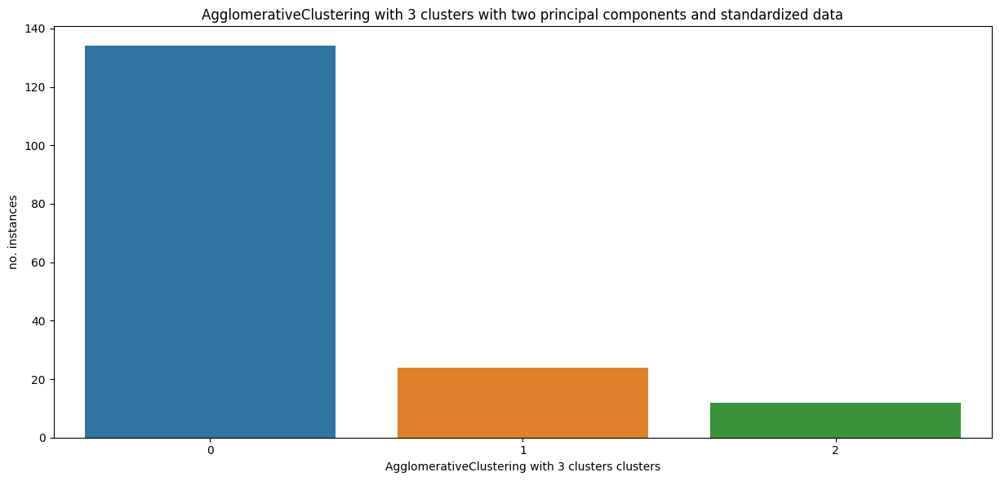

Index1                                               2   3  4
AgglomerativeClustering with 3 clusters Cluster...           
0                                                   47  81  6
1                                                   18   6  0
2                                                    2  10  0


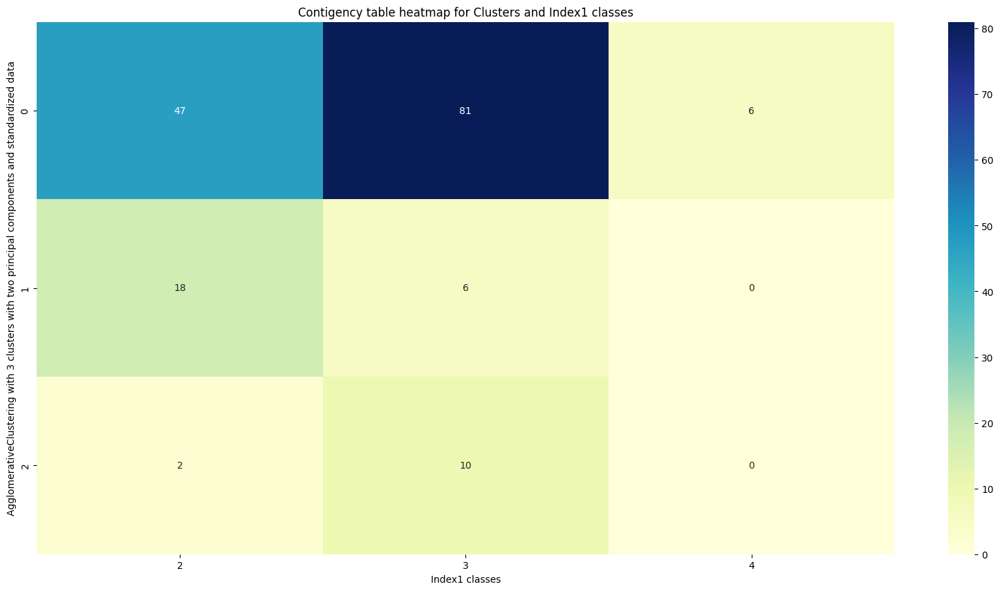

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


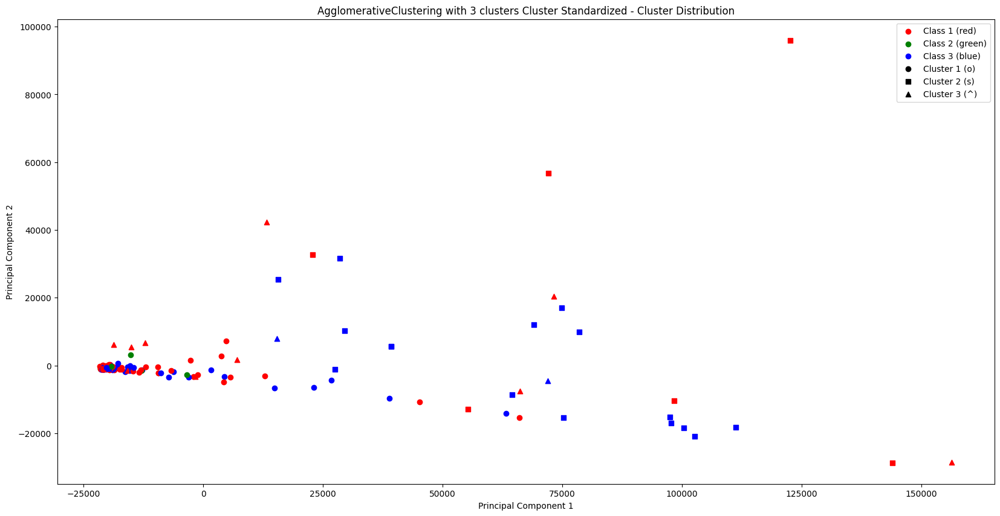

Apelare AgglomerativeClustering with 3 clusters Standardized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare AgglomerativeClustering with 3 clusters Normalized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
AgglomerativeClustering with 3 clusters Cluster Normalized C

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


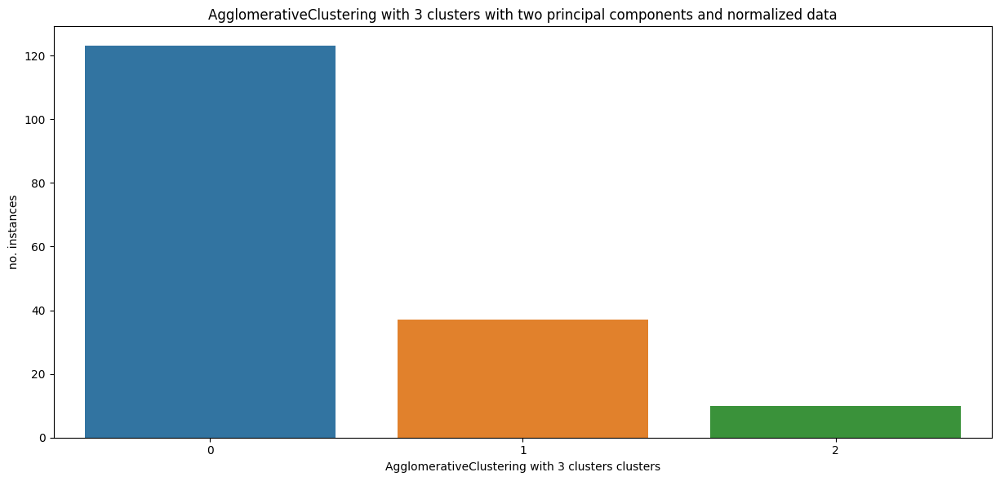

Index1                                               2   3  4
AgglomerativeClustering with 3 clusters Cluster...           
0                                                   55  64  4
1                                                   11  24  2
2                                                    1   9  0


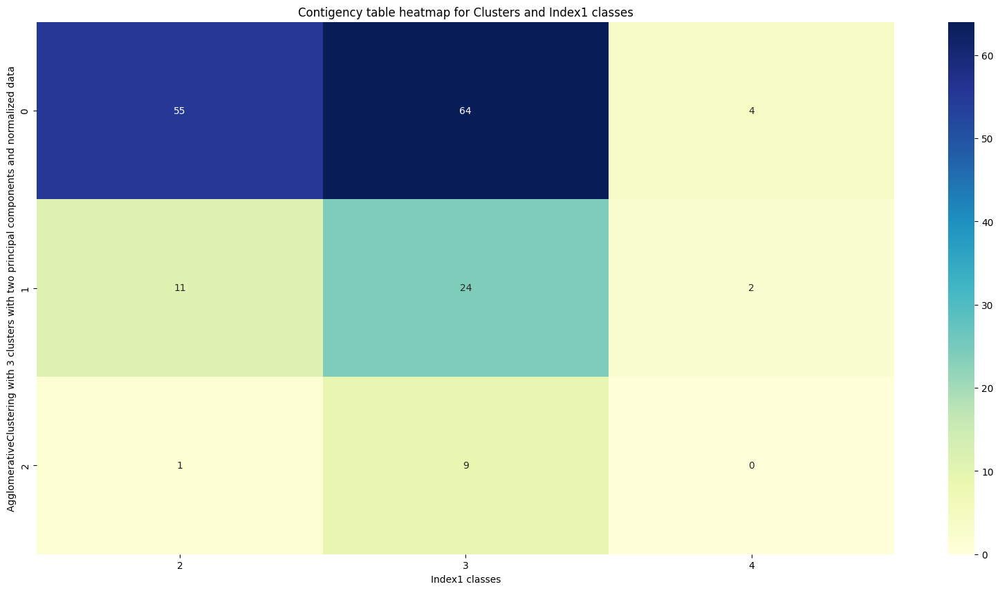

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)']
No noise


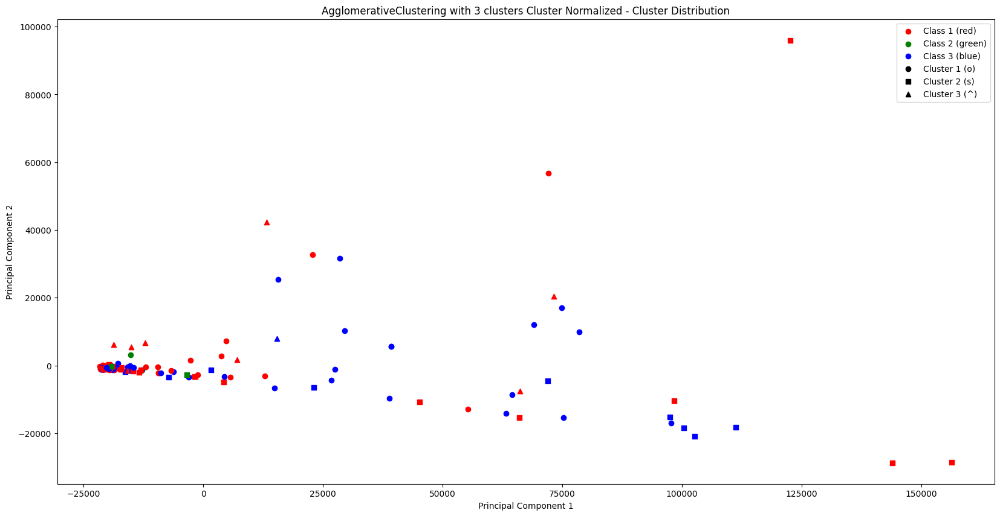

Apelare AgglomerativeClustering with 3 clusters Normalized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  
Apelare AgglomerativeClustering with 4 clusters Raw
AgglomerativeClustering with 4 clusters Cluster Raw Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


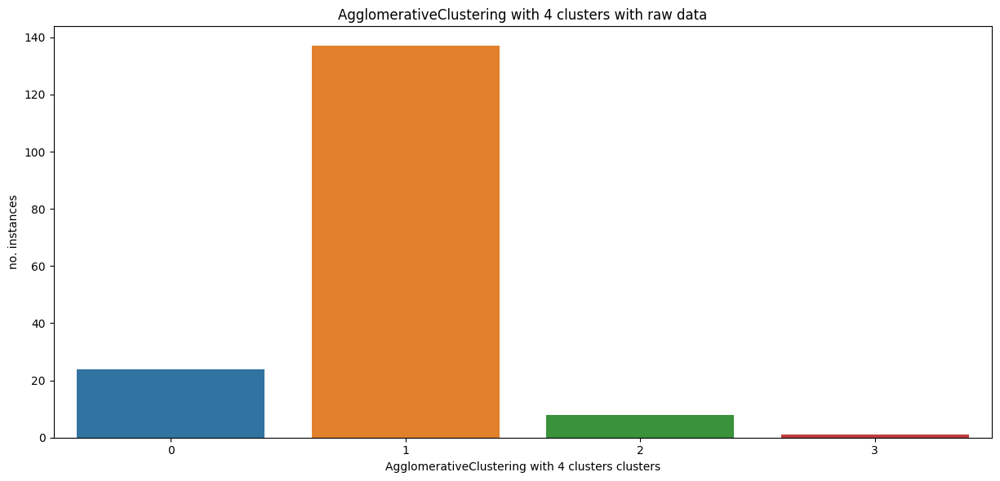

Index1                                               2   3  4
AgglomerativeClustering with 4 clusters Cluster...           
0                                                   16   8  0
1                                                   46  85  6
2                                                    5   3  0
3                                                    0   1  0


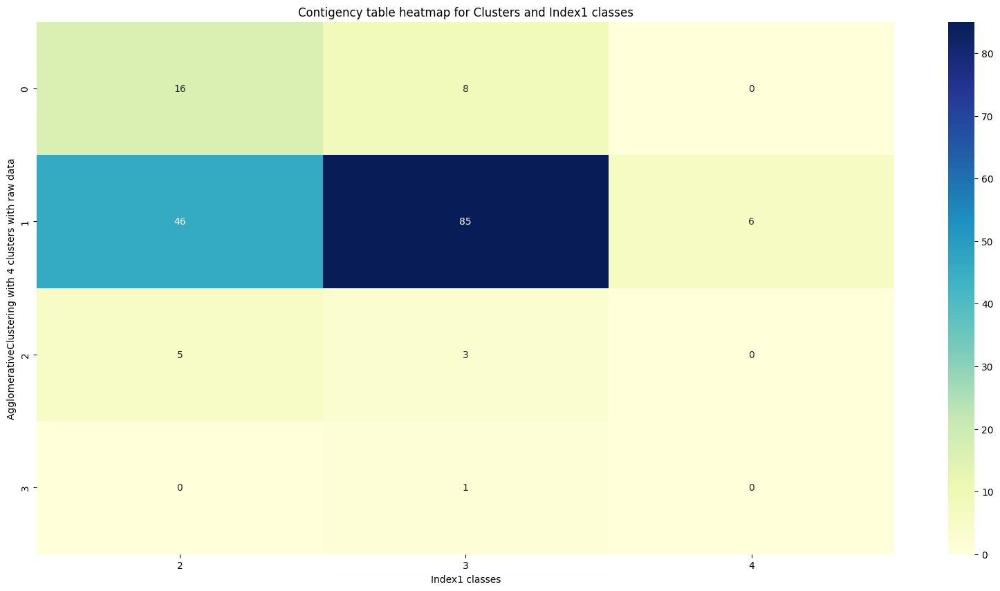

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


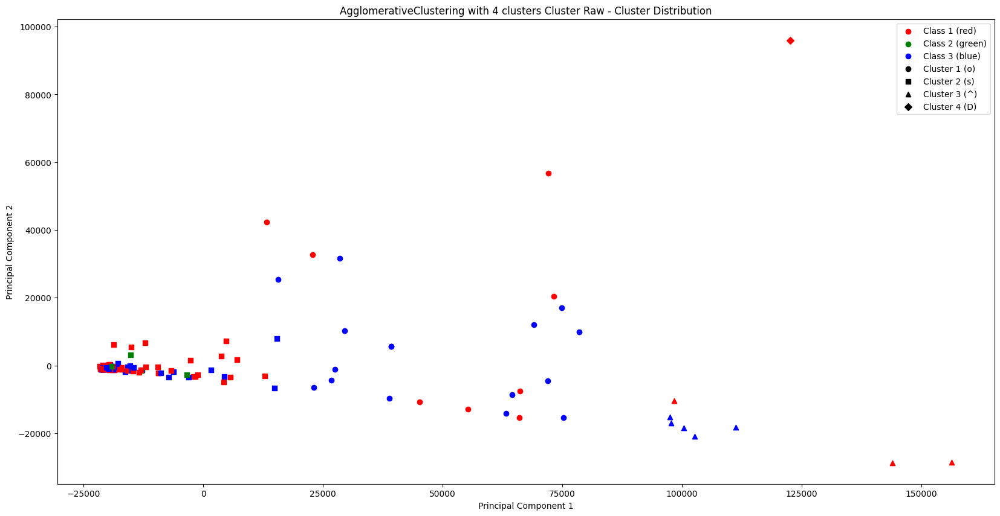

Apelare AgglomerativeClustering with 4 clusters Standardized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
AgglomerativeClustering with 4 clusters Cluster Standardized Cluster size distribution


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


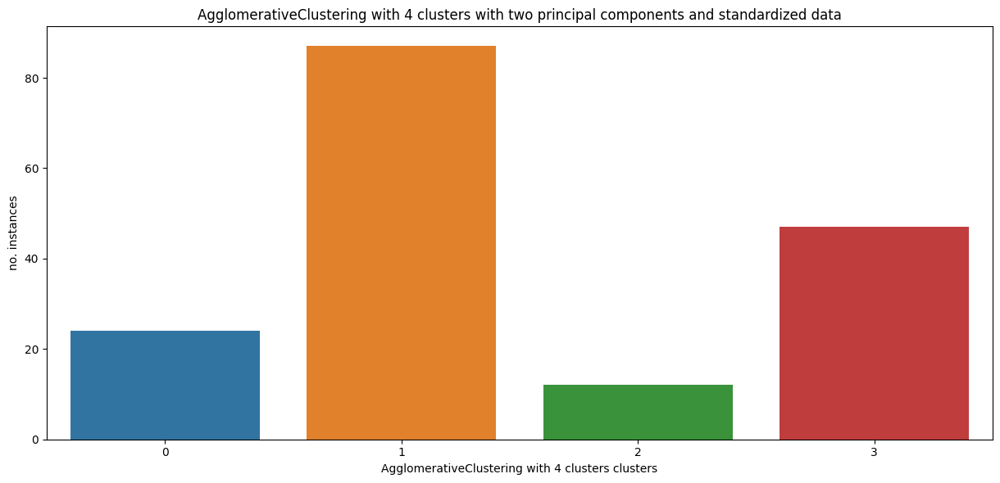

Index1                                               2   3  4
AgglomerativeClustering with 4 clusters Cluster...           
0                                                   18   6  0
1                                                   41  46  0
2                                                    2  10  0
3                                                    6  35  6


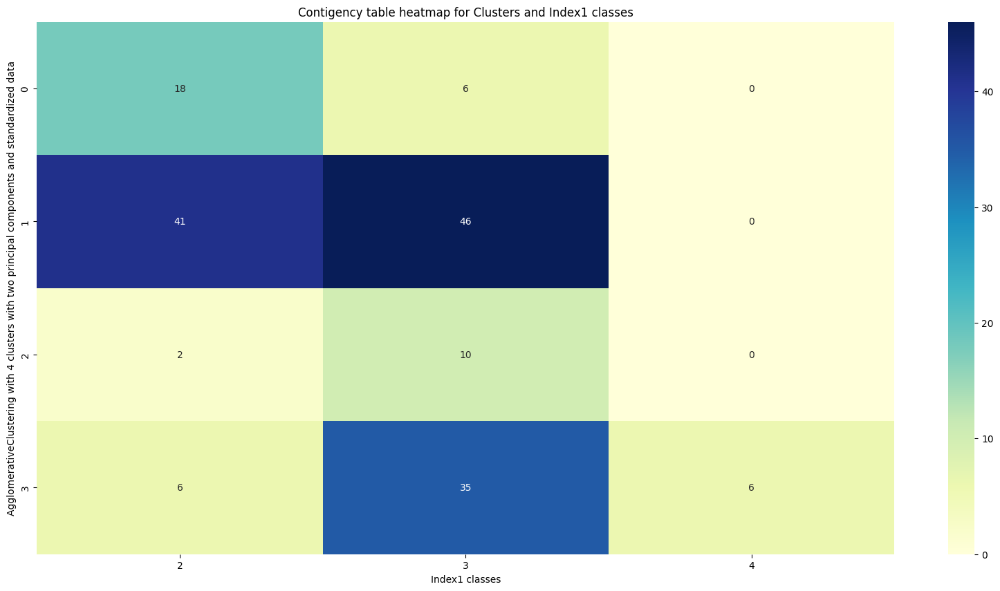

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


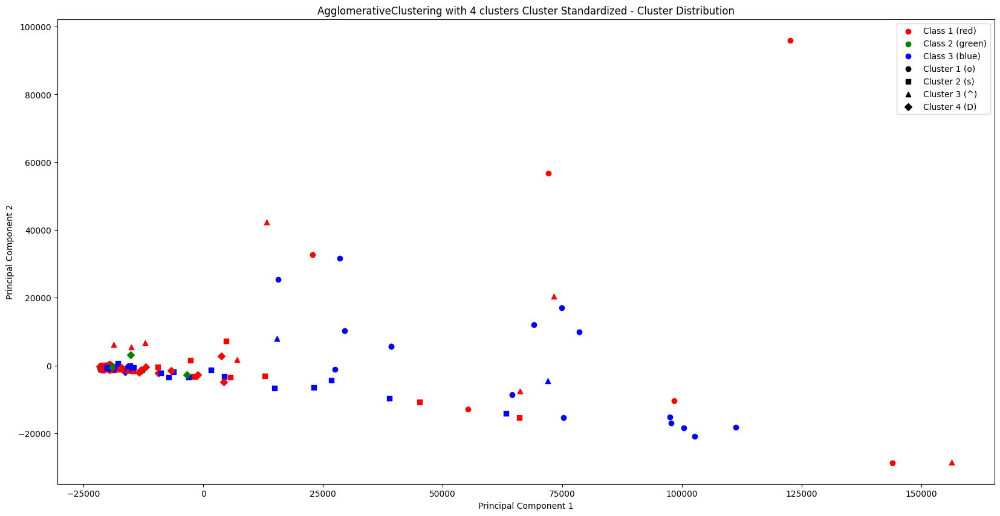

Apelare AgglomerativeClustering with 4 clusters Standardized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  
Apelare AgglomerativeClustering with 4 clusters Normalized
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
AgglomerativeClustering with 4 clusters Cluster Normalized C

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


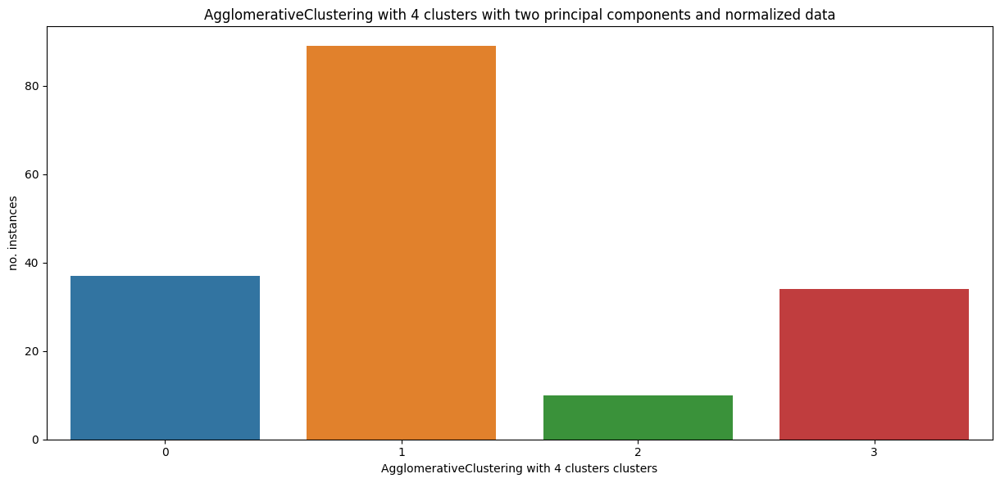

Index1                                               2   3  4
AgglomerativeClustering with 4 clusters Cluster...           
0                                                   11  24  2
1                                                   44  43  2
2                                                    1   9  0
3                                                   11  21  2


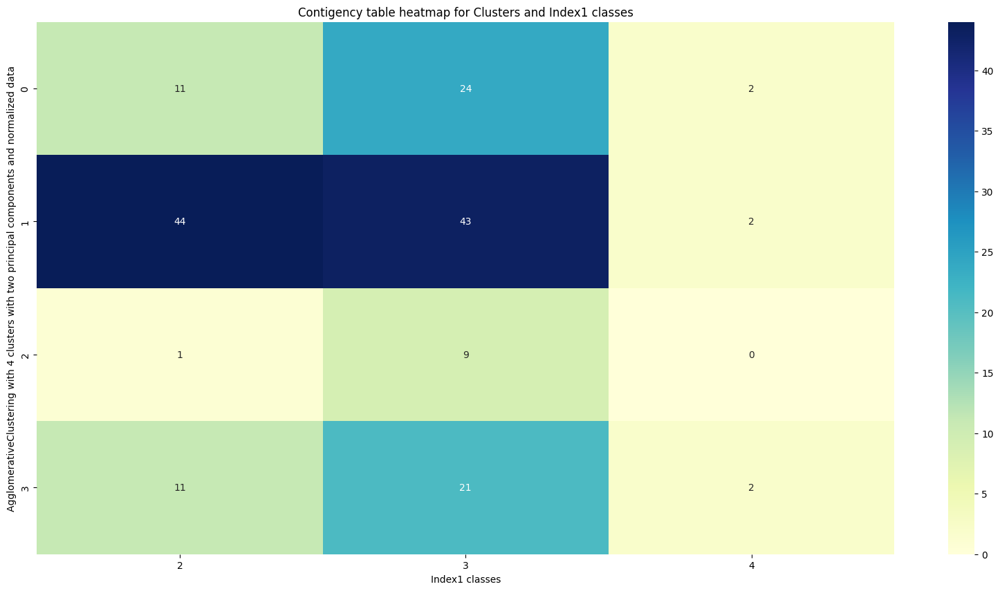

['Cluster 1 (o)', 'Cluster 2 (s)', 'Cluster 3 (^)', 'Cluster 4 (D)']
No noise


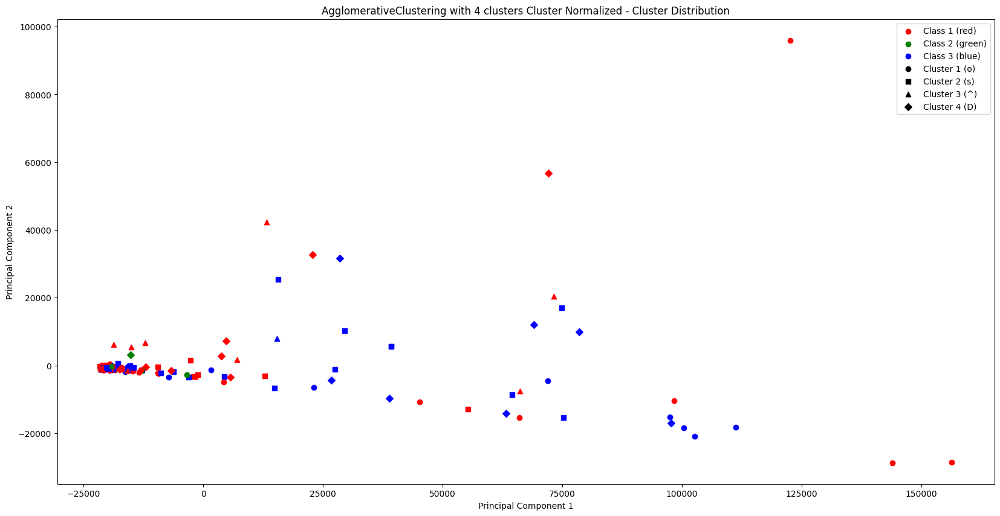

Apelare AgglomerativeClustering with 4 clusters Normalized 3 PCA
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  


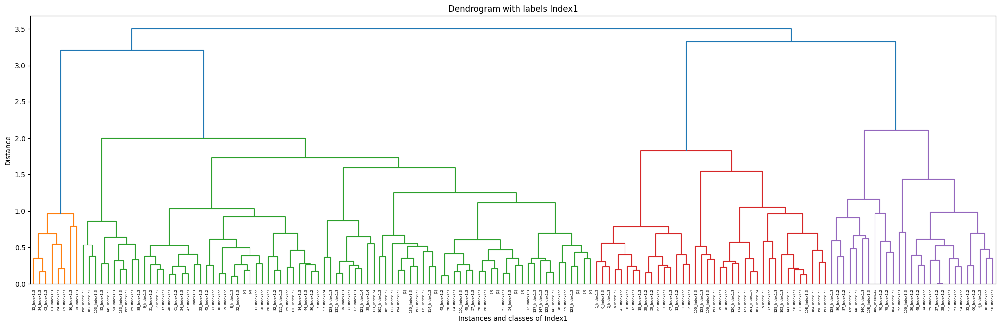

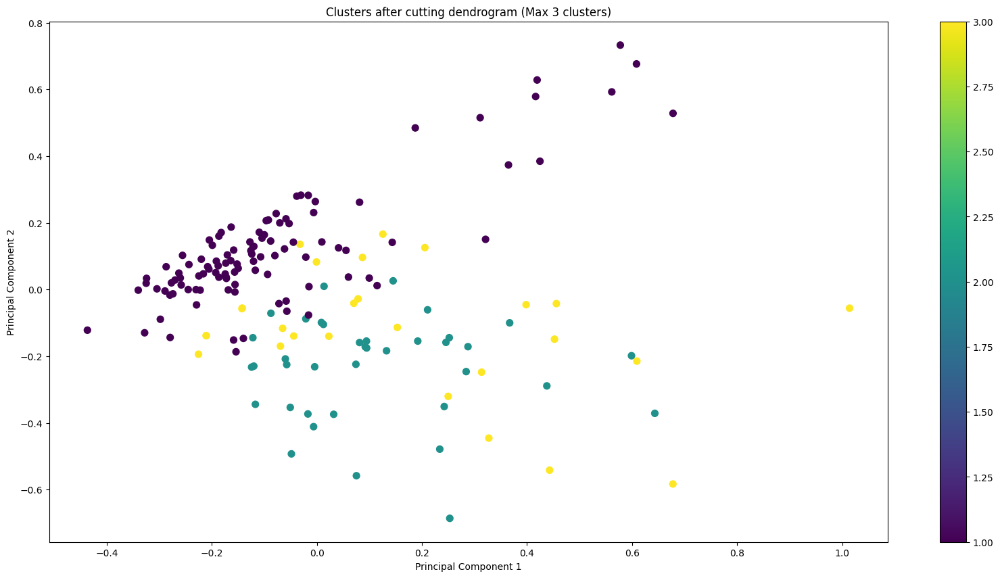

Metrics:
                                                    Silhouette Score  \
DBSCAN Raw                                                  0.380171   
DBSCAN Standardized                                        -0.342631   
DBSCAN Standardized 3 PCA                                  -0.595917   
OPTICS Raw                                                 -0.322364   
OPTICS Standardized                                        -0.516473   
OPTICS Standardized 3 PCA                                  -0.475606   
OPTICS Normalized                                          -0.483935   
OPTICS Normalized 3 PCA                                    -0.501382   
AffinityPropagation Raw                                     0.011765   
AffinityPropagation Standardized                           -0.429296   
AffinityPropagation Standardized 3 PCA                     -0.489053   
AffinityPropagation Normalized                              0.068073   
AffinityPropagation Normalized 3 PCA                   

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


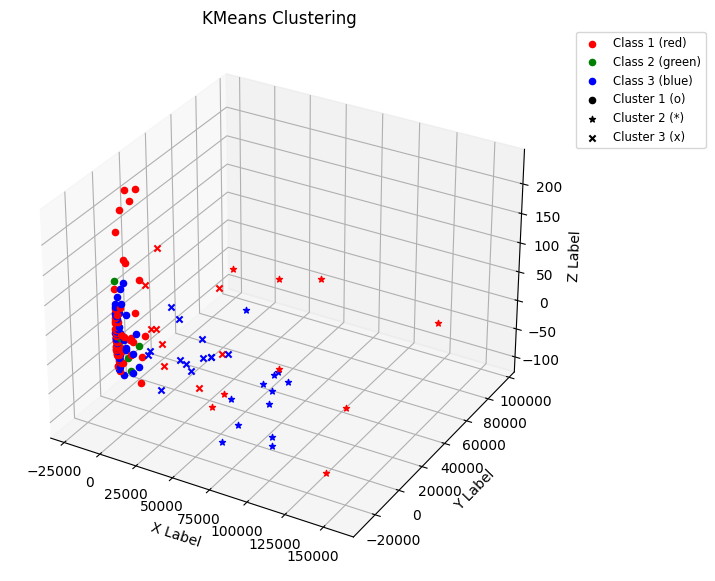

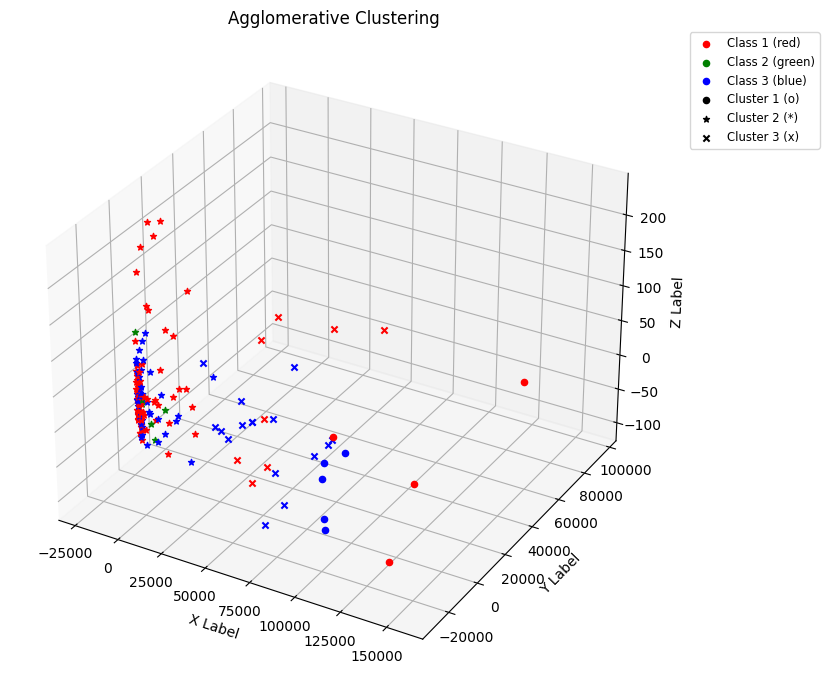

----------------------------------------------------------------------------------------------------
-----------------------------------------Standardized 3 PCA-----------------------------------------
----------------------------------------------------------------------------------------------------
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.180038 -0.340897      0.507729 -0.385606 -0.159358         0.097209   
PC2  0.006393  0.464866     -0.294101  0.385856 -0.433421         0.096698   
PC3  0.511297  0.271421     -0.100081 -0.331261 -0.070024         0.663895   

     Fecal coloform  Total coliform  
PC1        0.441388        0.463925  
PC2        0.355968        0.473878  
PC3       -0.314081       -0.029126  


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


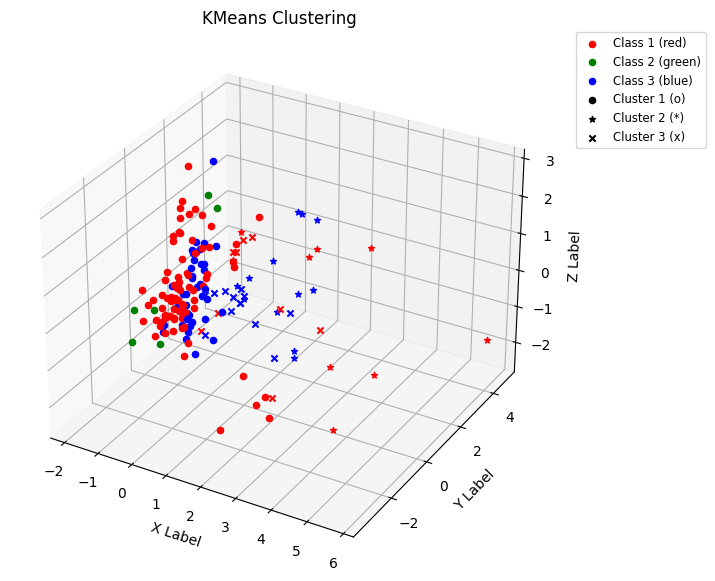

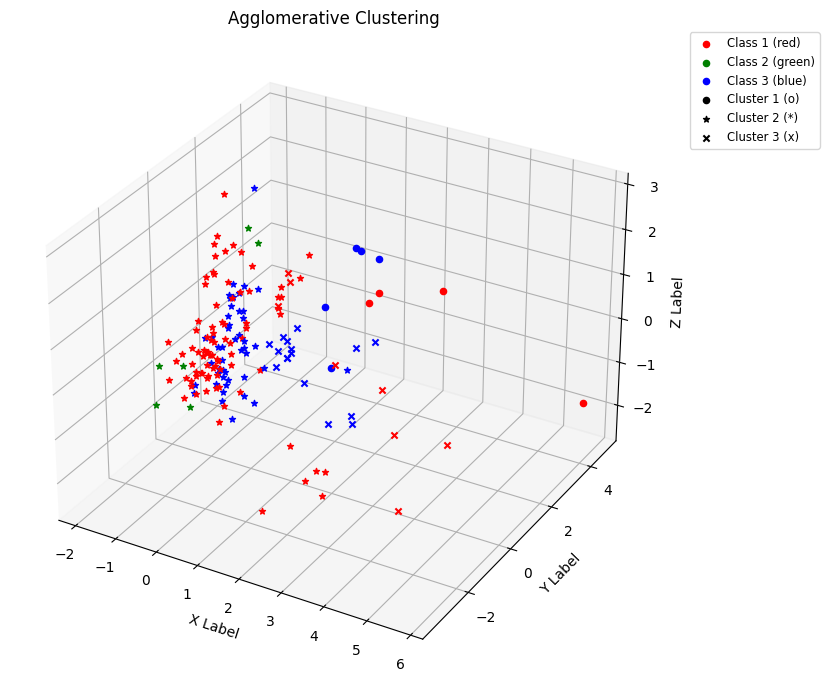

----------------------------------------------------------------------------------------------------
------------------------------------------Normalized 3 PCA------------------------------------------
----------------------------------------------------------------------------------------------------
         Temp        pH  Conductivity        DO       BOD  Nitrate+nitrite  \
PC1  0.202477 -0.270517      0.436734 -0.466869 -0.087288         0.514614   
PC2  0.001717 -0.470748      0.350760 -0.328920  0.106203        -0.715589   
PC3  0.014122  0.065519      0.006406  0.380314 -0.203803        -0.380851   

     Fecal coloform  Total coliform  
PC1        0.113480        0.437946  
PC2        0.054996       -0.144225  
PC3        0.258852        0.772813  


/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


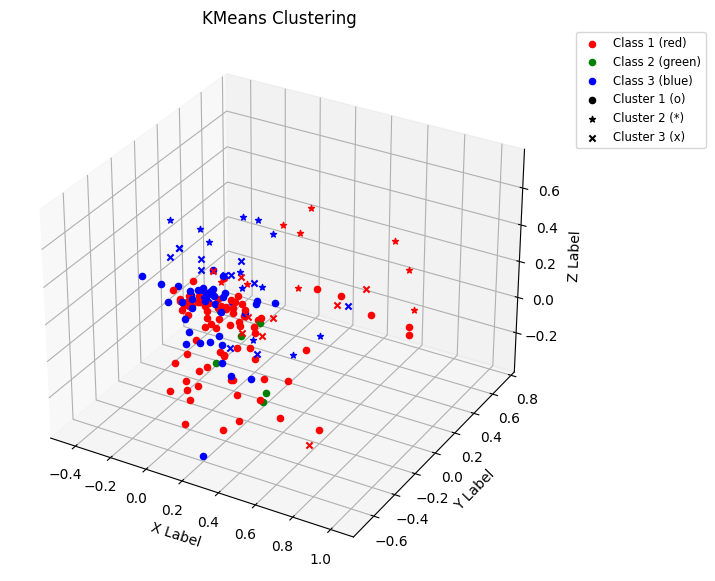

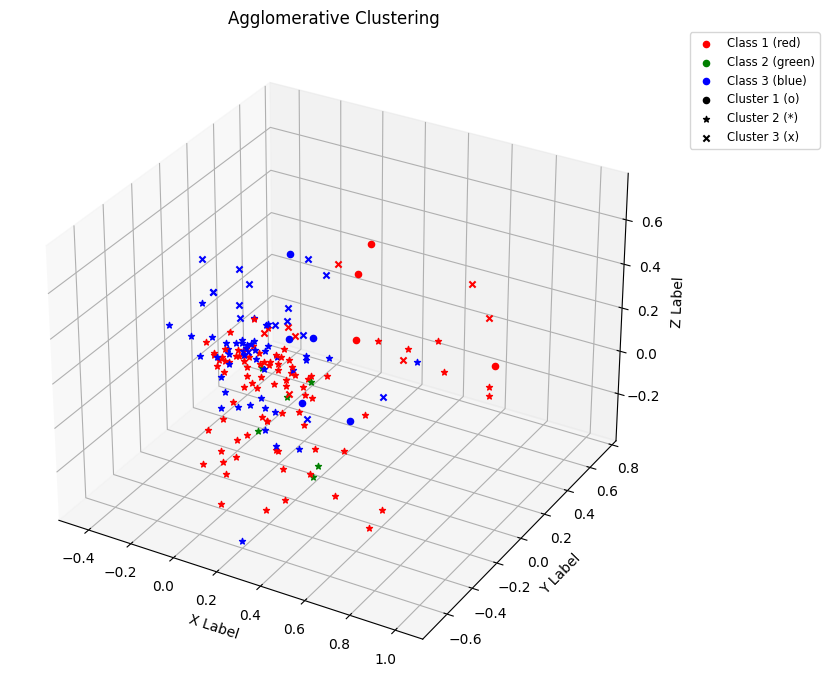

----------------------------------------------------------------------------------------------------
----------------------------------------------Data RAW----------------------------------------------
----------------------------------------------------------------------------------------------------
True Labels:
The number of instances for class 2 is 67
Class 2: [1, 4, 6, 7, 8, 9, 10, 11, 13, 18, 20, 21, 25, 26, 27, 28, 29, 30, 31, 35, 36, 37, 41, 42, 43, 45, 46, 48, 53, 55, 59, 61, 66, 69, 70, 72, 73, 74, 76, 77, 78, 79, 82, 86, 87, 94, 99, 104, 105, 110, 112, 114, 115, 118, 119, 122, 123, 137, 139, 142, 143, 145, 147, 148, 162, 165, 169]

The number of instances for class 3 is 97
Class 3: [0, 2, 3, 5, 12, 14, 15, 16, 17, 19, 22, 23, 24, 32, 33, 34, 38, 40, 44, 47, 49, 50, 51, 52, 54, 56, 57, 58, 60, 62, 63, 64, 65, 67, 68, 71, 75, 80, 81, 83, 84, 85, 88, 89, 90, 91, 92, 93, 95, 96, 98, 100, 101, 102, 103, 106, 107, 108, 109, 113, 116, 117, 120, 124, 125, 126, 127, 128, 129, 130, 13

/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/serbanmarin-eusebiu/Documents/sebi/.conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [9]:
BCWQI_Clustring = Cluster(False, bcwqi_classic_classification, 'Index1')